In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

43


In [168]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [167]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQR','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logisticQR')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [30]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [31]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [32]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [33]:
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,North America,NaN,2029.0,122.0,17683.0,NaN,1498794,90109.0,322243.0,NaN,NaN
1,816138,Europe,Europe,NaN,NaN,NaN,13992.0,NaN,1628576,152740.0,659698.0,NaN,NaN
2,185161,South America,South America,NaN,119.0,4.0,10114.0,NaN,310189,16388.0,108640.0,NaN,NaN
3,275484,Asia,Asia,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
4,39768,Africa,Africa,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN


In [34]:
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
224,275484,Asia,Total:,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
225,39768,Africa,Total:,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN
226,782,Australia/Oceania,Total:,NaN,10.0,NaN,20.0,NaN,8549,118.0,7649.0,NaN,NaN
227,55,NaN,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
228,406223,Europe,European Union,259.678532,0.0,0.0,9374.0,30668.973018,1099414,115622.0,577319.0,13655376.0,2469.203214


In [35]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,North America,NaN,2029.0,122.0,17683.0,NaN,1498794,90109.0,322243.0,NaN,NaN
1,816138,Europe,Europe,NaN,NaN,NaN,13992.0,NaN,1628576,152740.0,659698.0,NaN,NaN
2,185161,South America,South America,NaN,119.0,4.0,10114.0,NaN,310189,16388.0,108640.0,NaN,NaN
3,275484,Asia,Asia,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
4,39768,Africa,Africa,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN


In [36]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
90,601,Europe,Lithuania,18.0,0.0,0.0,17.0,67558.0,1479,50.0,828.0,183913.0,543.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


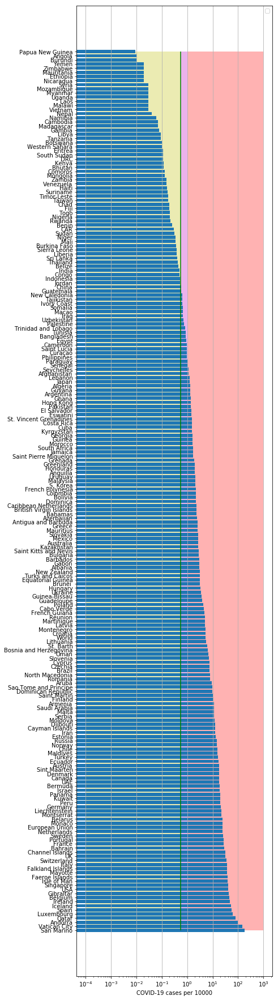

In [37]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


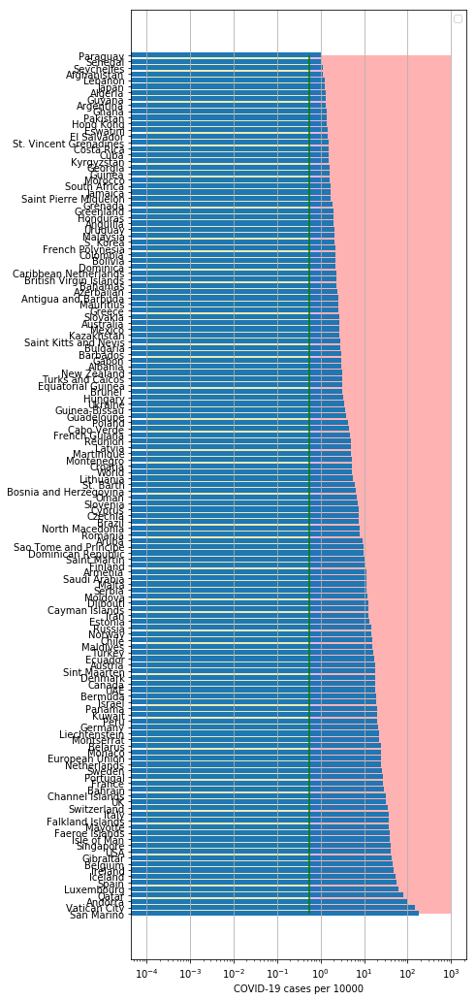

In [38]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

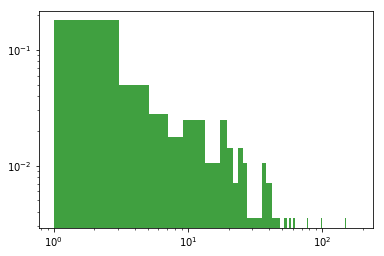

In [39]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [40]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
71 2020-05-06  253682   68466  25857.0
72 2020-05-07  256855   66866  26070.0
73 2020-05-08  260117   65410  26299.0
74 2020-05-09  262783   63148  26478.0
75 2020-05-10  264663   61603  26621.0
GB
          date   cases  active    death
70 2020-05-06  201101  170681  30076.0
71 2020-05-07  206715  175756  30615.0
72 2020-05-08  211364  179779  31241.0
73 2020-05-09  215260  183329  31587.0
74 2020-05-10  219183  186984  31855.0
IT
          date   cases  active    death
73 2020-05-06  214457   91528  29684.0
74 2020-05-07  215858   89624  29958.0
75 2020-05-08  217185   87961  30201.0
76 2020-05-09  218268   84842  30395.0
77 2020-05-10  219070   83324  30560.0
LT
          date   cases  active  death     tests
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1479.0     597   50.0  183913.0
62 2020-05-10  1479.0     601   50.0       NaN


PM
          date  cases  active  death
57 2020-05-06   7731  6654.0  218.0
58 2020-05-07   7868  6757.0  225.0
59 2020-05-08   8070  6953.0  231.0
60 2020-05-09   8282  3544.0  237.0
61 2020-05-10   8448  3517.0  244.0
PU
          date  cases   active   death
60 2020-05-06  54817  35757.0  1533.0
61 2020-05-07  58526  38511.0  1627.0
62 2020-05-08  61847  41121.0  1714.0
63 2020-05-09  65015  42955.0  1814.0
64 2020-05-10  67307  44069.0  1889.0
SB
          date  cases  active  death
57 2020-05-06   9791  7617.0  203.0
58 2020-05-07   9848  7482.0  206.0
59 2020-05-08   9943  7281.0  209.0
60 2020-05-09  10032  7087.0  213.0
61 2020-05-10  10114  6893.0  215.0
AG
          date   cases  active  death
63 2020-05-06  5208.0  3411.0  273.0
64 2020-05-07  5371.0  3488.0  282.0
65 2020-05-08  5611.0  3659.0  293.0
66 2020-05-09  5776.0  3748.0  300.0
67 2020-05-10  6034.0  3972.0  305.0
CT
          date  cases  active  death
67 2020-05-06   2119   433.0   85.0
68 2020-05-07   2125   398

In [41]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)

In [42]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.7713863680630821
intercept: -2.6425977251908446
slope: [0.11553762]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


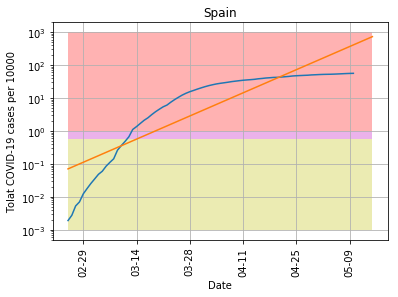

In [43]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [44]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8848390624788365
intercept: -4.222925877740365
slope: [0.12763131]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


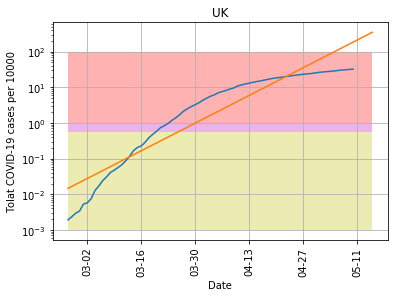

In [45]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [46]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9919059849095846
intercept: 1.8984021533673976
slope: [-0.05009046]


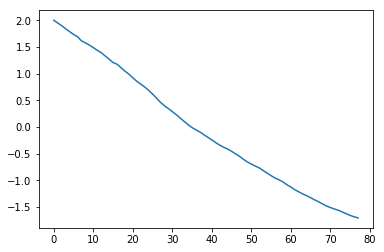

In [47]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


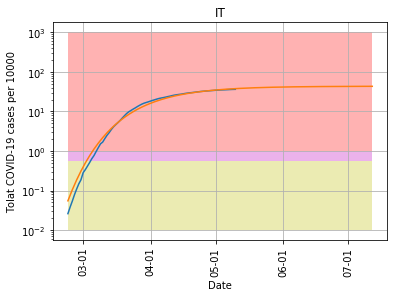

In [48]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [49]:
cs=y_pred11[-1]/10000.*populationIT

In [50]:
cs

261201.40804194566

In [51]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6867460880563652
intercept: -2.3257935249653503
slope: [0.08704081]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


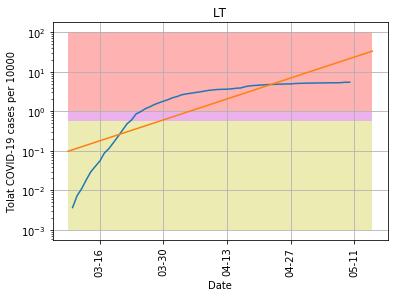

In [52]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [53]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9919059849095846
intercept: -6.052146300520456
slope: [0.1444734]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


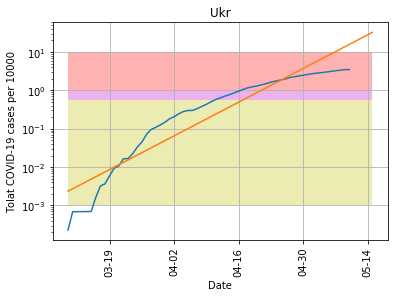

In [54]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


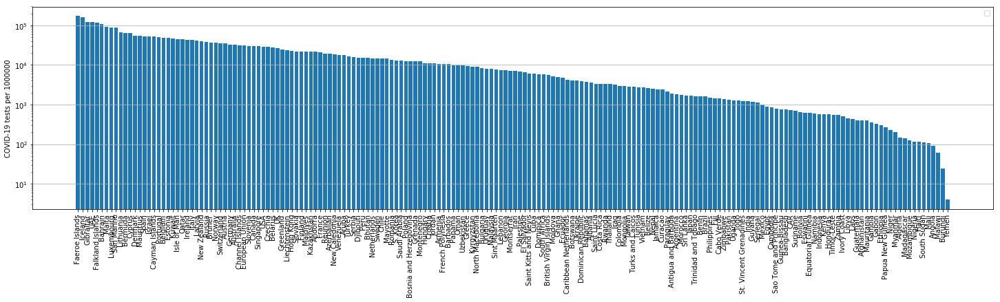

In [55]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [56]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9919059849095846
intercept: -3.7755438891753776
slope: [0.13389622]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


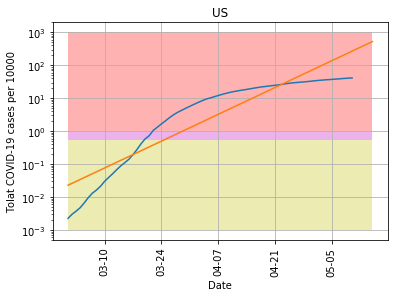

In [57]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [58]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
228  European Union  0.105167


(0, 0.15)

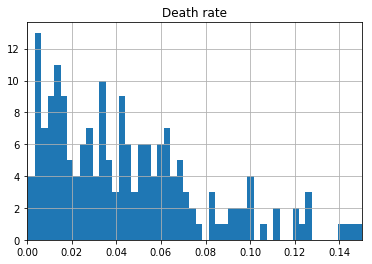

In [59]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

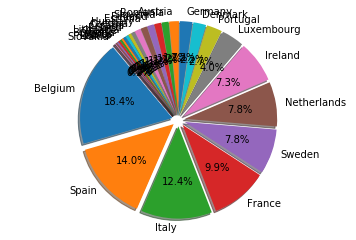

In [60]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [61]:
dfTTh.head()

,Country,Deathsper1Mpop
20,Belgium,747.0
8,Spain,569.0
10,Italy,505.0
12,France,404.0
29,Sweden,319.0


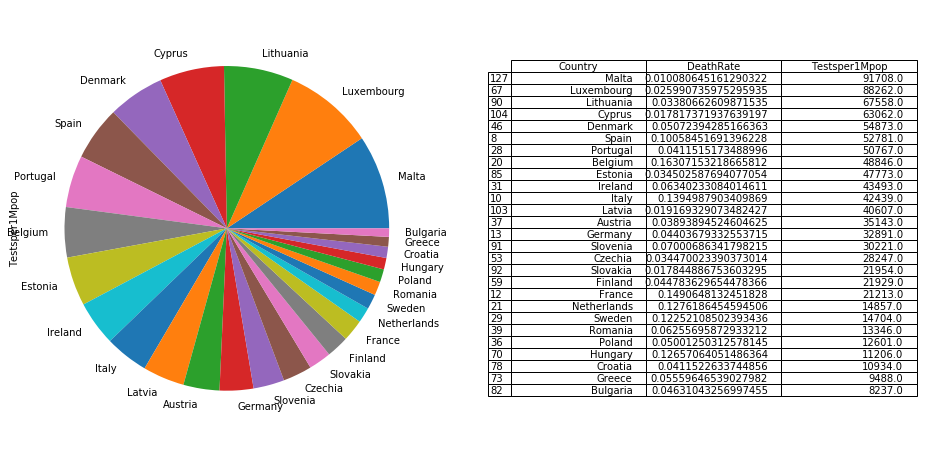

In [62]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

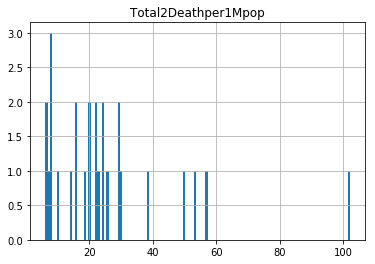

In [63]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [64]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5661.0,569.0
10,Italy,3623.0,505.0
12,France,2711.0,404.0
13,Germany,2051.0,90.0
20,Belgium,4580.0,747.0


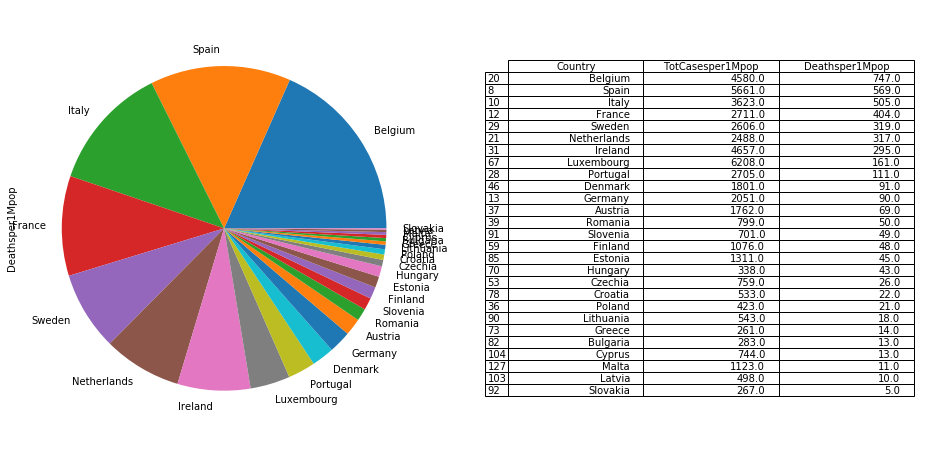

In [65]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [66]:
dfAll.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,North America,0.0,2029.0,122.0,17683.0,0.0,1498794,90109.0,322243.0,0.0,0.0
1,816138,Europe,Europe,0.0,0.0,0.0,13992.0,0.0,1628576,152740.0,659698.0,0.0,0.0
2,185161,South America,South America,0.0,119.0,4.0,10114.0,0.0,310189,16388.0,108640.0,0.0,0.0
3,275484,Asia,Asia,0.0,832.0,8.0,4987.0,0.0,669565,22197.0,371884.0,0.0,0.0
4,39768,Africa,Africa,0.0,2.0,0.0,235.0,0.0,64752,2301.0,22683.0,0.0,0.0


In [67]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.107255
10,Italy,0.085370
12,France,0.127799
13,Germany,0.062357
20,Belgium,0.093764


In [68]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.177231
 Netherlands             0.167463
      France             0.127799
       Spain             0.107255
     Ireland             0.107075
     Belgium             0.093764
       Italy             0.085370
  Luxembourg             0.070336
     Germany             0.062357
     Romania             0.059868
    Portugal             0.053283
     Austria             0.050138
     Finland             0.049067
     Croatia             0.048747
    Bulgaria             0.034357
      Poland             0.033569
     Denmark             0.032821
     Hungary             0.030162
      Greece             0.027508
     Estonia             0.027442
     Czechia             0.026870
    Slovenia             0.023196
      Latvia             0.012264
       Malta             0.012245
    Slovakia             0.012162
      Cyprus             0.011798
   Lithuania             0.008038


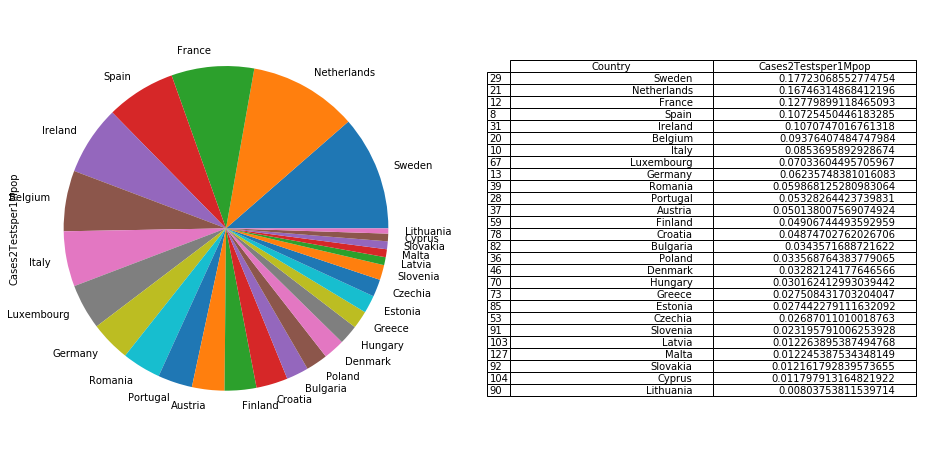

In [69]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [70]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
33,Qatar,0.000622,44348.000000
30,Singapore,0.000857,30016.000000
62,Bahrain,0.001619,108152.000000
94,Djibouti,0.002479,15490.000000
108,Maldives,0.003593,21784.000000
97,Hong Kong,0.003817,22448.000000
113,Guinea-Bissau,0.004132,762.000000
77,Uzbekistan,0.004136,9710.000000
68,Oman,0.005001,9791.000000
79,Guinea,0.005126,0.000000


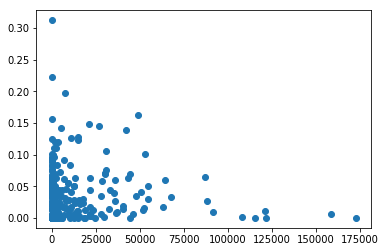

In [71]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


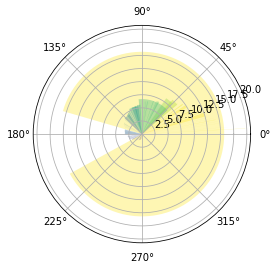

In [72]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

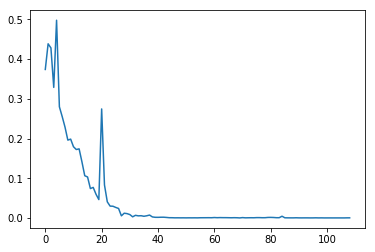

In [73]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [74]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


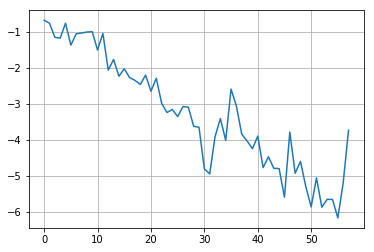

In [75]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

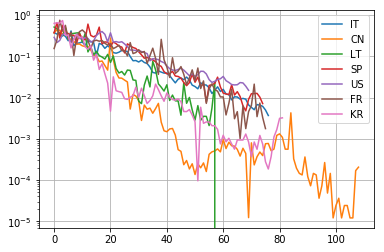

In [76]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

70 70
coefficient of determination: 0.9229926212823049
intercept: -7.800336237370322
slope: [-0.17674279]


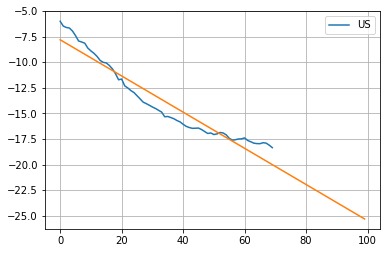

In [77]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

77 77
coefficient of determination: 0.9215985265431558
intercept: -8.992927165163174
slope: [-0.12957423]


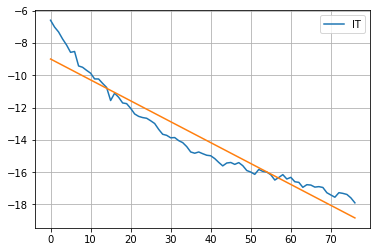

In [78]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [79]:
#model11.coef_

In [80]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

59 59
coefficient of determination: 0.9647456043658491
intercept: -14.5216885924475
slope: [-0.08855013]


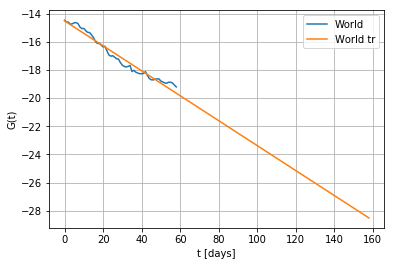

In [81]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

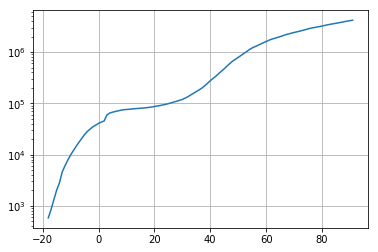

In [82]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [83]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 5.79108625e+06  3.02788315e+00 -3.27494613e+01  1.40215631e-02]


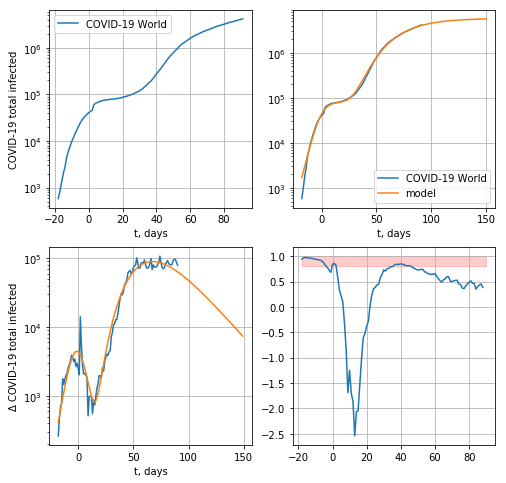

33537.79068609949


In [84]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

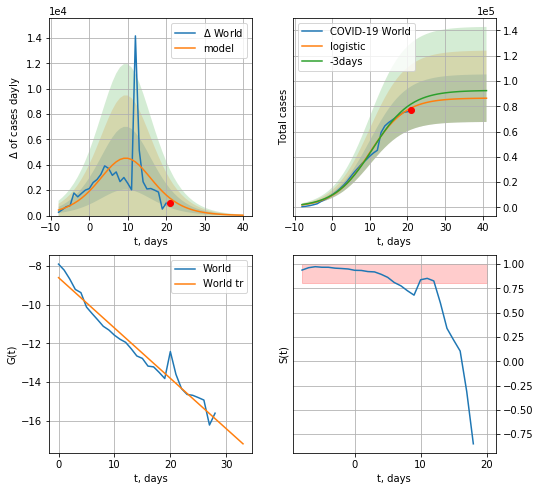

World data at: 2020-05-10
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +20 days
	 deltaDaycases:  30
	 total cases:  86343 ± 18806
	 total death:  5862 ± 3830
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


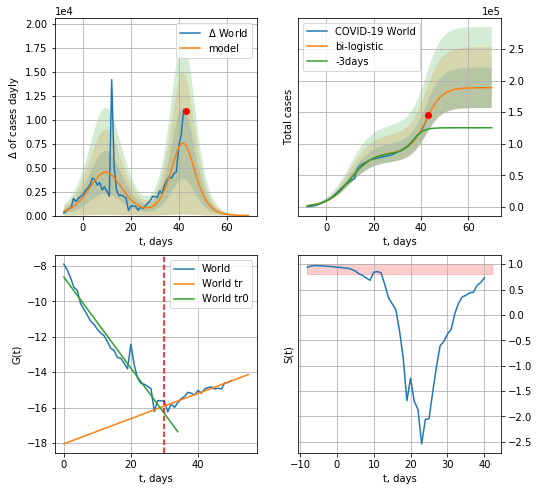

World data at: 2020-05-10
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +27 days
	 deltaDaycases:  9
	 total cases:  188673 ± 32060
	 total death:  12809 ± 6529
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


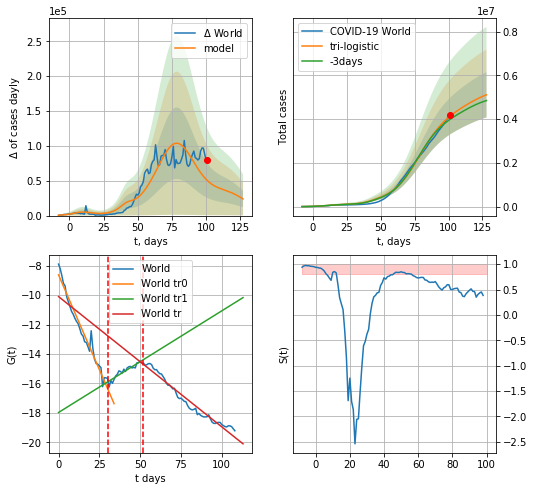

World data at: 2020-05-10
+3 day model MAPE: 0.03728252240245094
model: tri-logistic
coeffs:  [4.18992667e+06 9.70505417e-02 7.84961134e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.20241560661345998
forecast at the end of period: +27 days
	 deltaDaycases:  23910
	 total cases:  5109383 ± 1034219
	 total death:  346888 ± 210646
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.960985
 intercept: -10.102948
 slope: -0.088452


In [85]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

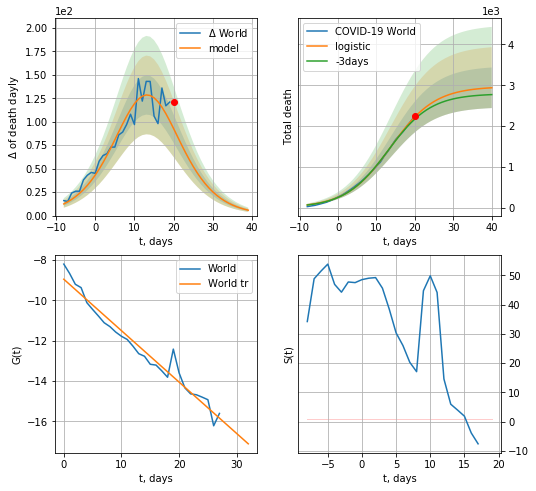

World data at: 2020-05-10
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +20 days
	 total death:  2938 ± 497
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


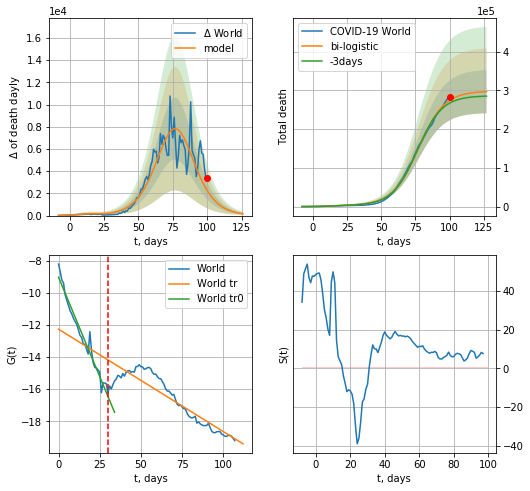

World data at: 2020-05-10
+3 day model MAPE: 0.0272628964948602
model: bi-logistic
coeffs:  [2.95133588e+05 1.06116554e-01 7.72128698e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.18768281161883535
forecast at the end of period: +27 days
	 deltaDaydeath:  165
	 total death:  296612 ± 55669
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.832343
 intercept: -12.265218
 slope: -0.063772


In [86]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [87]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


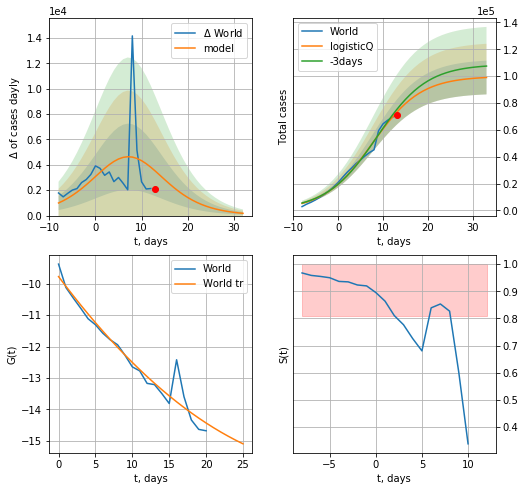

World data at: 2020-05-10
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +20 days
	 deltaDaycases: 178
	 total cases: 98986 ± 12567
	 total death: 6720 ± 2559
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


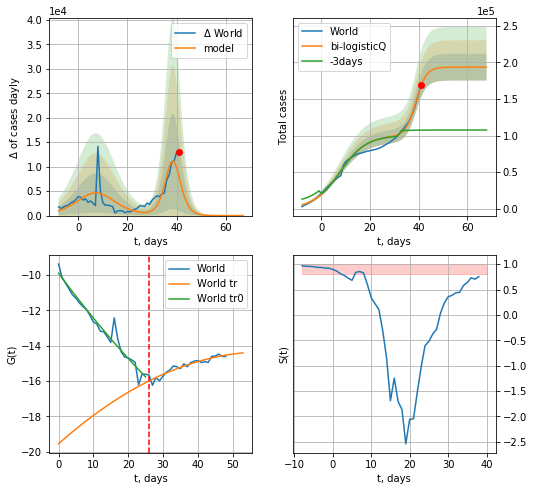

World data at: 2020-05-10
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 193620 ± 18335
	 total death: 13145 ± 3734
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


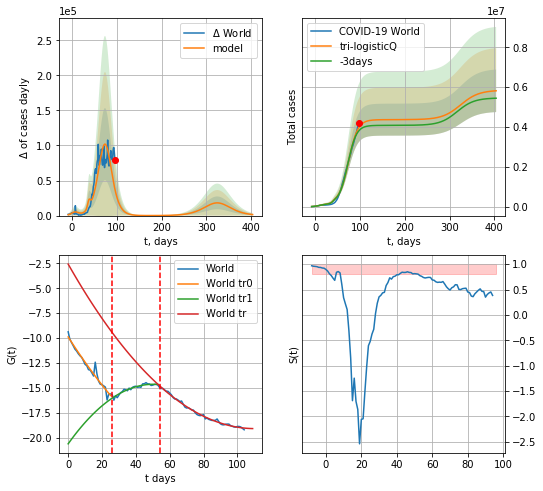

World data at: 2020-05-10
+3 day model MAPE: 0.043072
model: bi-logisticQ
coeffs: [ 4.17275126e+06  1.11332750e-06  7.44555825e+01 -8.76789162e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.183787
forecast at the end of period: +307 days
	 deltaDaycases: 1439
	 total cases: 5815039 ± 1068730
	 total death: 394796 ± 217675
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.992906
 intercept_: -2.57629205135294
 coeffs_: [ 0.         -0.2996187   0.00135873]


In [88]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in power


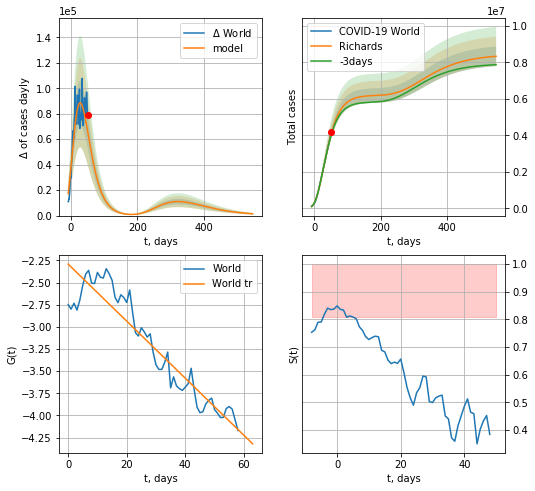

World data at: 2020-05-10
+3 day model MAPE: 0.017125
model: Richards
coeffs: [ 6.19172468e+06  2.94277053e+00 -8.18058853e+01  1.33006664e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.064427
forecast at the end of period: +497 days
	 deltaDaycases: 1416
	 total cases: 8327750 ± 536533
	 total death: 565390 ± 109279
trend coefficient of determination: 0.885278
 intercept: -2.291976
 slope: -0.032192


In [357]:
x = forecastRR("World",dfW[50:],d1,60*9-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [90]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


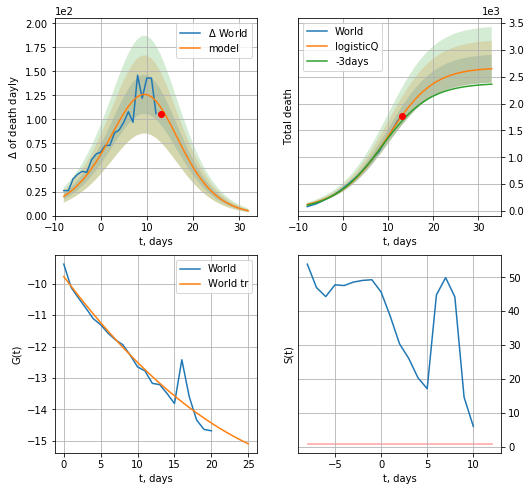

World data at: 2020-05-10
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +20 days
	 total death: 2650 ± 259
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


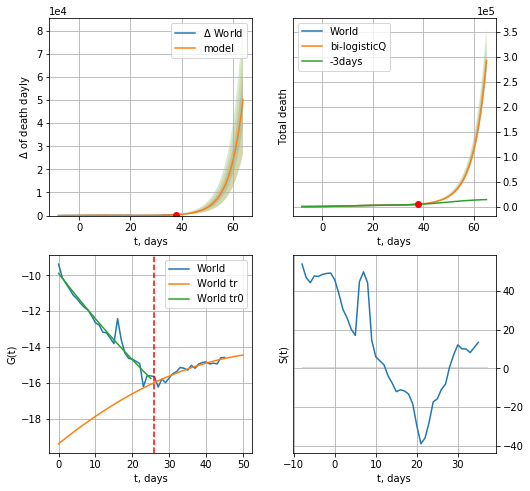

World data at: 2020-05-10
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +27 days
	 total death: 292414 ± 22396
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:432: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


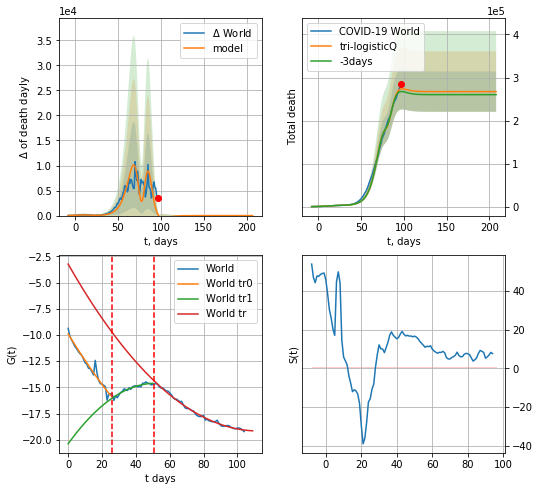

World data at: 2020-05-10
+3 day model MAPE: 0.023234
model: bi-logisticQ
coeffs: [-6.15748028e+06  4.92861828e-05  7.97020570e+01 -4.52378119e+03]
rational stdev: 0.175290
forecast at the end of period: +111 days
	 total death: 267231 ± 46842
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.993362
 intercept_: -3.2404818584223705
 coeffs_: [ 0.         -0.28329994  0.0012609 ]


In [91]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


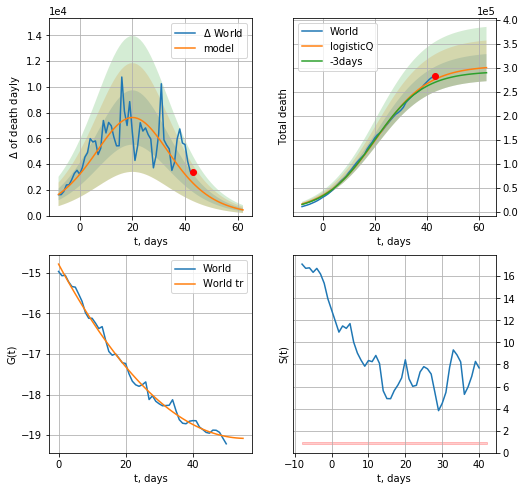

World data at: 2020-05-10
+3 day model MAPE: 0.024067
model: logisticQ
coeffs: [ 3.04824627e+05  6.11837392e-06  2.05094175e+01 -1.63245589e+04]
rational stdev: 0.094019
forecast at the end of period: +20 days
	 total death: 300581 ± 28260
trend coefficient of determination: 0.992920
 intercept_: -14.78486008789519
 coeffs_: [ 0.         -0.15392536  0.00137945]


In [92]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [93]:
#trend(dfSP,'SP',10)

In [94]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

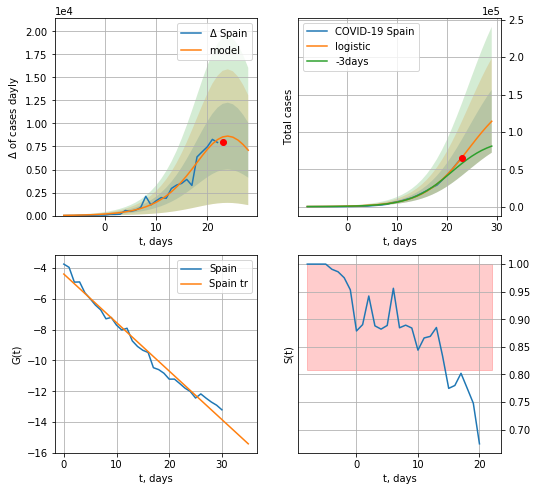

Spain data at: 2020-05-10
+3 day model MAPE: 0.17994225331219452
model: logistic
coeffs:  [1.55796358e+05 2.21769203e-01 2.44355993e+01]
rational stdev:  0.3682790859287634
forecast at the end of period: +6 days
	 deltaDaycases:  7092
	 total cases:  114270 ± 42083
	 total death:  11493 ± 12697
trend coefficient of determination: 0.981962
 intercept: -4.388643
 slope: -0.315050


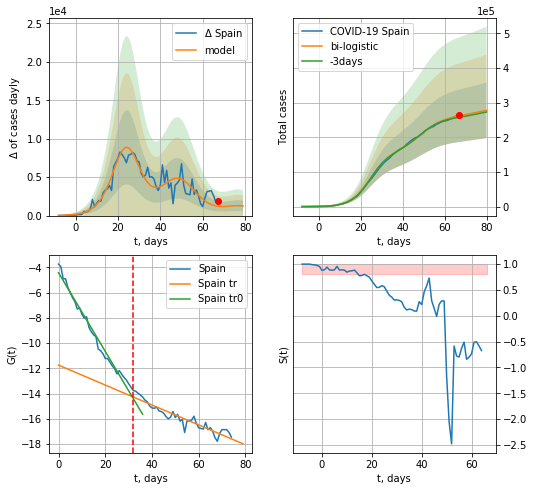

Spain data at: 2020-05-10
+3 day model MAPE: 0.01748305512330217
model: bi-logistic
coeffs:  [1.07283456e+05 1.74886050e-01 4.89230283e+01] [1.55796358e+05 2.21769203e-01 2.44355993e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.2883012551883367
forecast at the end of period: +13 days
	 deltaDaycases:  1247
	 total cases:  278029 ± 80156
	 total death:  27965 ± 24187
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.981698
 intercept: -4.427117
 slope: -0.311203
trend coefficient of determination: 0.880691
 intercept: -11.741267
 slope: -0.078852


In [95]:
vL = 32#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
71 2020-05-06  253682   68466  25857.0
72 2020-05-07  256855   66866  26070.0
73 2020-05-08  260117   65410  26299.0
74 2020-05-09  262783   63148  26478.0
75 2020-05-10  264663   61603  26621.0


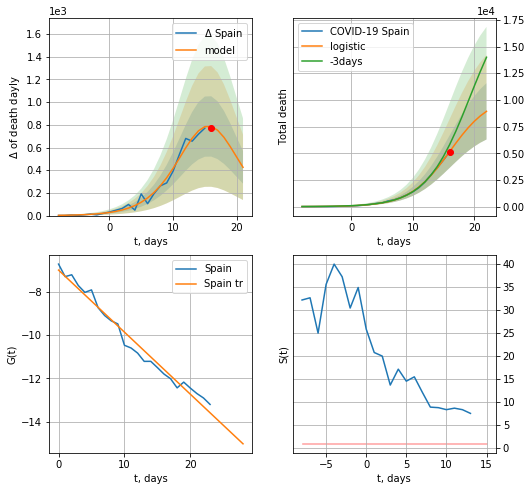

Spain data at: 2020-05-10
+3 day model MAPE: 0.15747030887395475
model: logistic
coeffs:  [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.29538659014568974
forecast at the end of period: +6 days
	 total death:  8928 ± 2637
trend coefficient of determination: 0.976452
 intercept: -6.992078
 slope: -0.287044


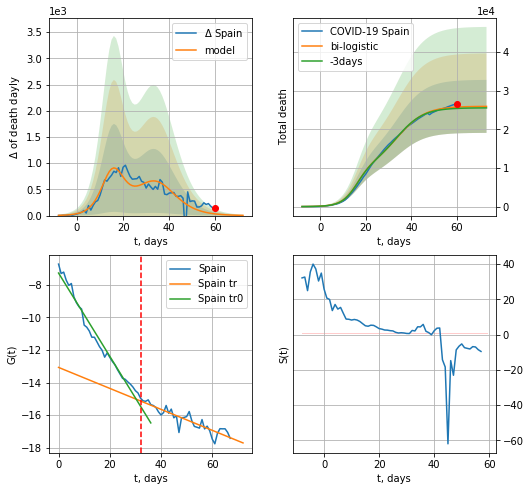

Spain data at: 2020-05-10
+3 day model MAPE: 0.013826426391221985
model: bi-logistic
coeffs:  [1.56022532e+04 1.66348479e-01 3.41574127e+01] [1.03877331e+04 3.04619794e-01 1.60547713e+01]
rational stdev:  0.2643472319827045
forecast at the end of period: +13 days
	 deltaDaydeath:  4
	 total death:  25965 ± 6863
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.975844
 intercept: -7.265510
 slope: -0.256124
trend coefficient of determination: 0.820404
 intercept: -13.071156
 slope: -0.064531


In [96]:
vL = 32#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


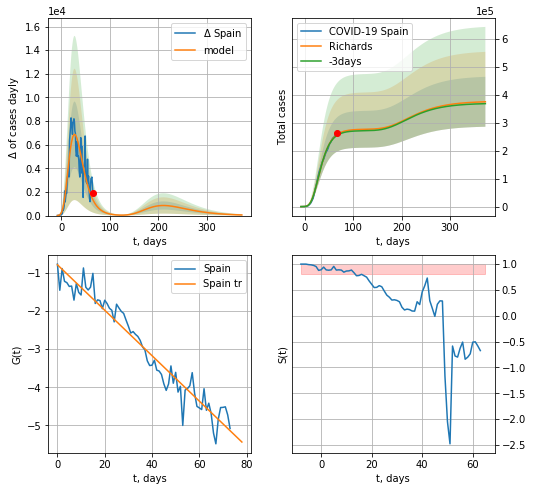

Spain data at: 2020-05-10
+3 day model MAPE: 0.012039
model: Richards
coeffs: [ 2.77226295e+05  6.32830155e+00 -3.92004472e+01  1.07094414e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.238139
forecast at the end of period: +307 days
	 deltaDaycases: 53
	 total cases: 375378 ± 89392
	 total death: 37757 ± 26974
trend coefficient of determination: 0.942194
 intercept: -0.785617
 slope: -0.059621


In [358]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:72: RuntimeWarning: divide by zero encountered in true_divide


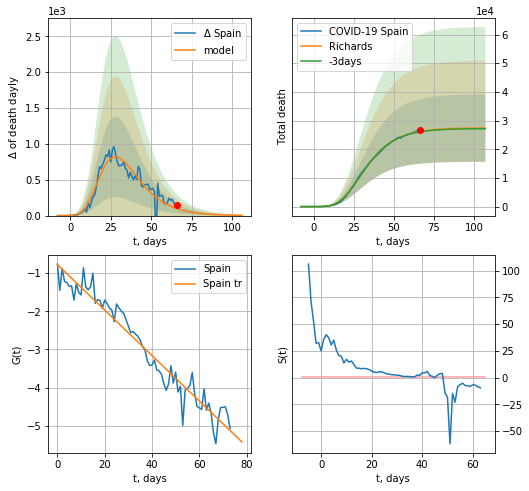

Spain data at: 2020-05-10
+3 day model MAPE: 0.006140
model: Richards
coeffs: [ 2.74395111e+04  8.48126985e+00 -2.86317705e+01  9.60940613e-03]
rational stdev: 0.429136
forecast at the end of period: +41 days
	 total death: 27394 ± 11755
trend coefficient of determination: 0.941886
 intercept: -0.778555
 slope: -0.059502


In [359]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


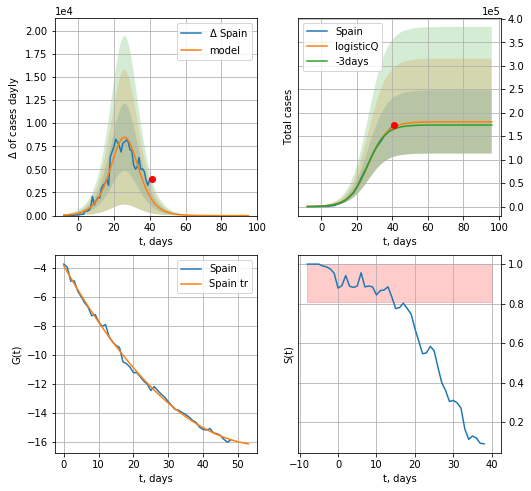

Spain data at: 2020-05-10
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 180489 ± 67394
	 total death: 18154 ± 20335
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


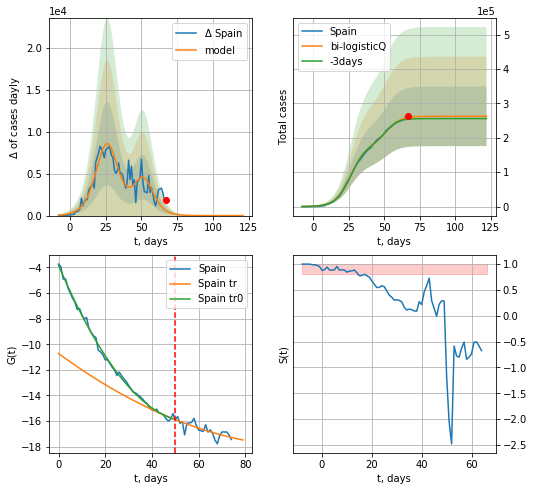

Spain data at: 2020-05-10
+3 day model MAPE: 0.020969
model: bi-logisticQ
coeffs: [ 8.21308130e+04  2.03839778e-06  5.17515410e+01 -1.02401067e+05]
rational stdev: 0.329897
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 262620 ± 86637
	 total death: 26415 ± 26142
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.595319
 intercept_: -10.721859175241683
 coeffs_: [ 0.         -0.1337872   0.00061152]


In [99]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


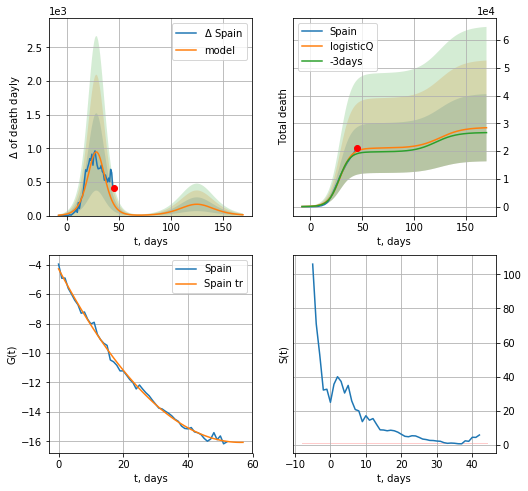

Spain data at: 2020-05-10
+3 day model MAPE: 0.052146
model: logisticQ
coeffs: [ 2.10785072e+04  2.45976331e-06  2.87220026e+01 -7.30294753e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.426167
forecast at the end of period: +125 days
	 total death: 28416 ± 12110
trend coefficient of determination: 0.997093
 intercept_: -4.2745317106494545
 coeffs_: [ 0.         -0.41935329  0.00372528]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:344: RuntimeWarning: divide by zero encountered in true_divide


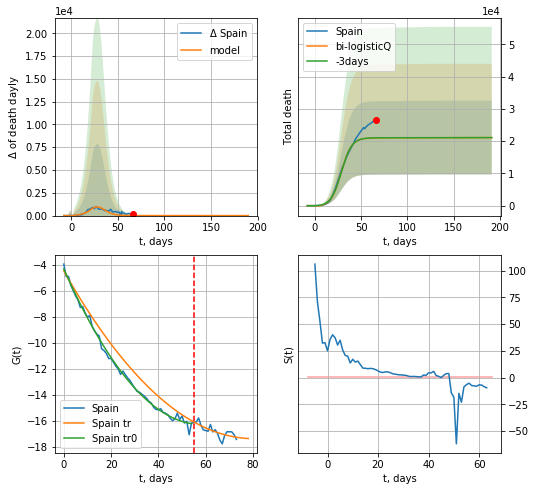

Spain data at: 2020-05-10
+3 day model MAPE: 0.001744
model: bi-logisticQ
coeffs: [-2.73479620e+02 -3.61843242e-02  2.38156925e+01 -1.36981591e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.542250
forecast at the end of period: +125 days
	 total death: 21078 ± 11429
bi-logisticQ approximation splitting point: 55
trend coefficient of determination: 0.995977
 intercept_: -4.321307017900119
 coeffs_: [ 0.         -0.41196694  0.00354831]
trend coefficient of determination: 0.598078
 intercept_: -4.478462747745999
 coeffs_: [ 0.         -0.32114707  0.00199939]


In [100]:
x = forecastRRR('Spain',dfSP[1:55],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=55)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


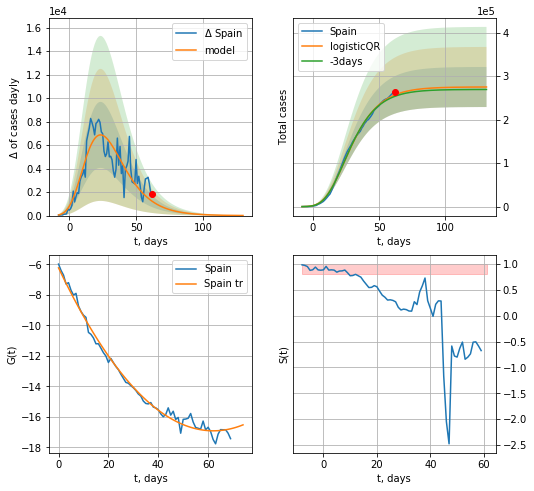

Spain data at: 2020-05-10
+3 day model MAPE: 0.012896188519020567
model: logisticQR
coeffs:  [ 2.75278301e+05  3.36946502e-02 -8.09463498e+01 -1.34944846e+03
  1.36409604e-03]
rational stdev:  0.16742717178480787
forecast at the end of period: +69 days
	 deltaDaycases:  8
	 total cases:  275168 ± 46070
	 total death:  27677 ± 13901
trend coefficient of determination: 0.990678
 intercept_: -6.237251026610699
 coeffs_: [ 0.         -0.34397761  0.00276891]


In [101]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

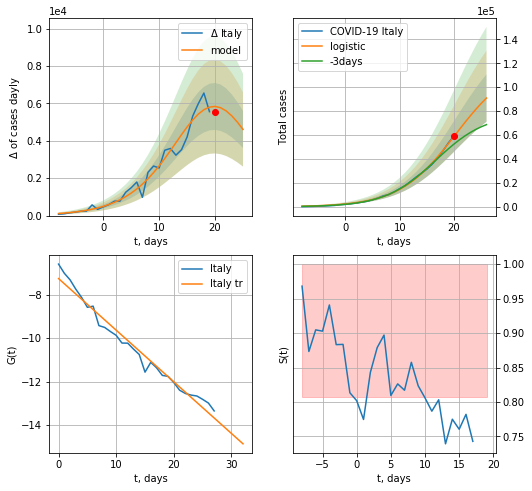

Italy data at: 2020-05-10
+3 day model MAPE: 0.1545703725042627
model: logistic
coeffs:  [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.21800555140478417
forecast at the end of period: +6 days
	 deltaDaycases:  4608
	 total cases:  90938 ± 19825
	 total death:  12685 ± 8296
trend coefficient of determination: 0.973351
 intercept: -7.256152
 slope: -0.237823


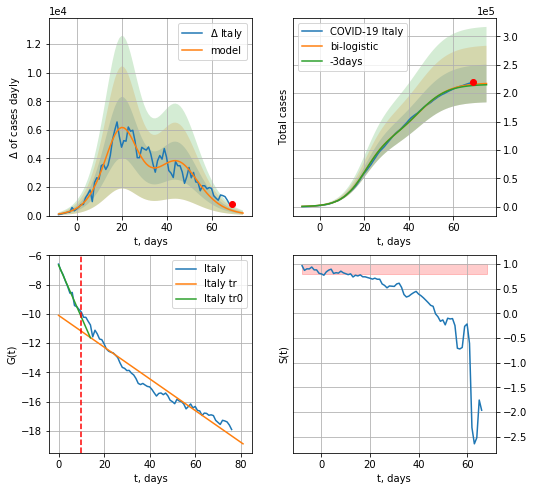

Italy data at: 2020-05-10
+3 day model MAPE: 0.009357338145109669
model: bi-logistic
coeffs:  [9.66754432e+04 1.50768548e-01 4.53209206e+01] [1.21492367e+05 1.92504372e-01 2.03342758e+01]
rational stdev:  0.1531464383316601
forecast at the end of period: +6 days
	 deltaDaycases:  175
	 total cases:  217075 ± 33244
	 total death:  30281 ± 13912
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.940601
 intercept: -10.097027
 slope: -0.108492


In [102]:
x = forecast('Italy',dfIT[:-6-dT],d1,7*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,7*7-dT,x,1.0)

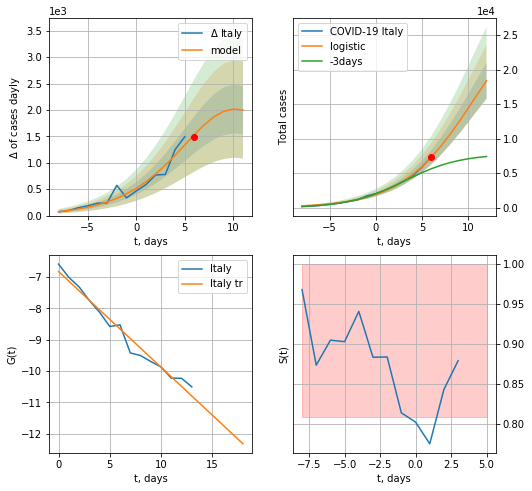

Italy data at: 2020-05-10
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +6 days
	 deltaDaycases:  1996
	 total cases:  18391 ± 2599
	 total death:  2565 ± 1087
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


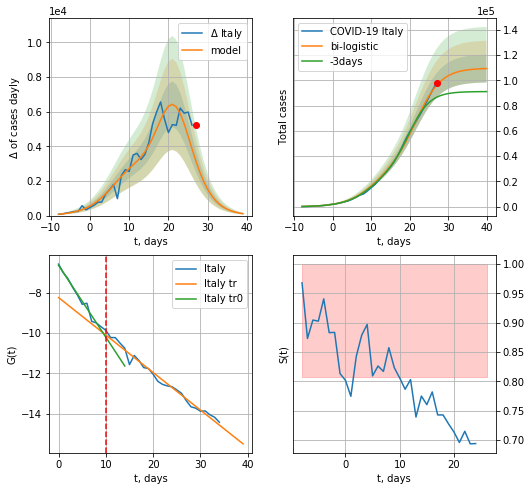

Italy data at: 2020-05-10
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +13 days
	 deltaDaycases:  109
	 total cases:  109265 ± 10969
	 total death:  15242 ± 4590
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


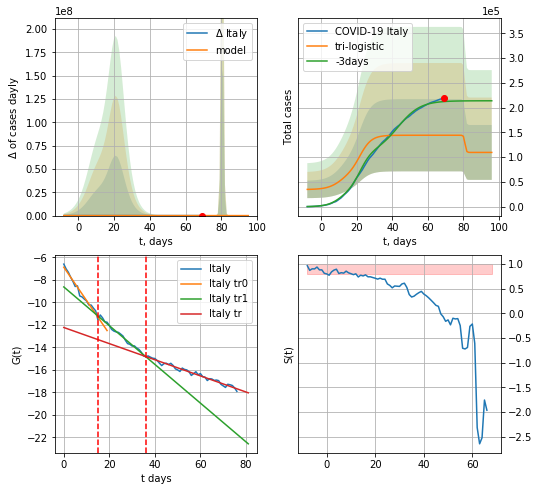

Italy data at: 2020-05-10
+3 day model MAPE: 0.32107049527485
model: tri-logistic
coeffs:  [ 3.46776167e+04 -2.84347567e+00  8.09680571e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.5055663128762915
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  109573 ± 55396
	 total death:  15285 ± 23182
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.973170
 intercept: -12.228449
 slope: -0.071706


In [103]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

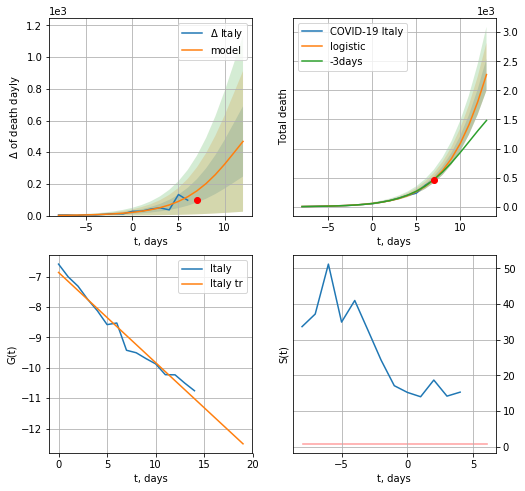

Italy data at: 2020-05-10
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +6 days
	 total death:  2271 ± 272
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


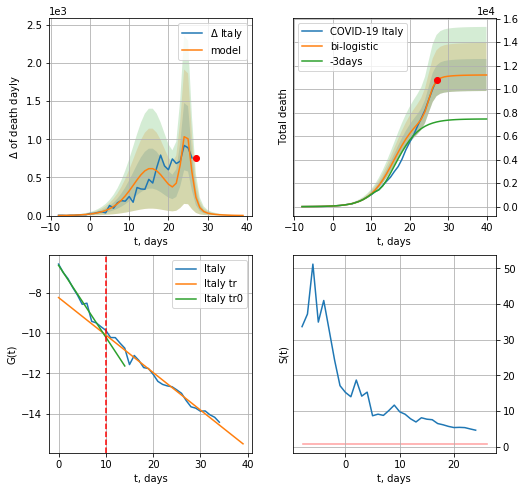

Italy data at: 2020-05-10
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +13 days
	 deltaDaydeath:  1
	 total death:  11206 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


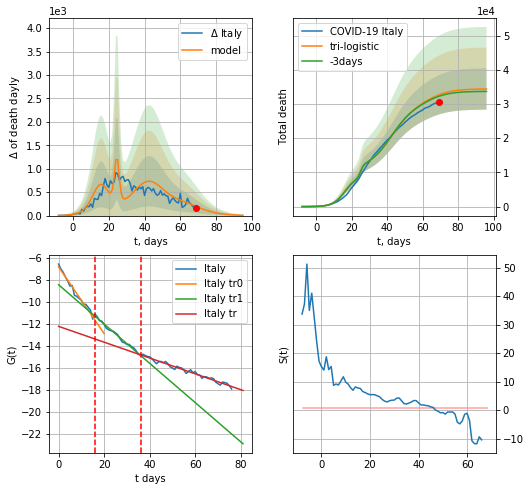

Italy data at: 2020-05-10
+3 day model MAPE: 0.013566187192177271
model: tri-logistic
coeffs:  [1.85712583e+04 1.52269101e-01 4.26233813e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.17579208195848176
forecast at the end of period: +27 days
	 deltaDaydeath:  6
	 total death:  34385 ± 6044
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.973170
 intercept: -12.228449
 slope: -0.071706


In [104]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


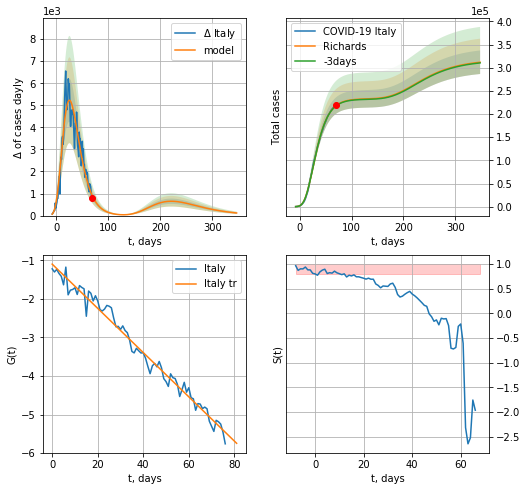

Italy data at: 2020-05-10
+3 day model MAPE: 0.003090
model: Richards
coeffs: [ 2.33198704e+05  5.10618578e+00 -4.63617173e+01  1.20129703e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.081523
forecast at the end of period: +279 days
	 deltaDaycases: 118
	 total cases: 311930 ± 25429
	 total death: 43513 ± 10641
trend coefficient of determination: 0.980718
 intercept: -1.099566
 slope: -0.057342


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


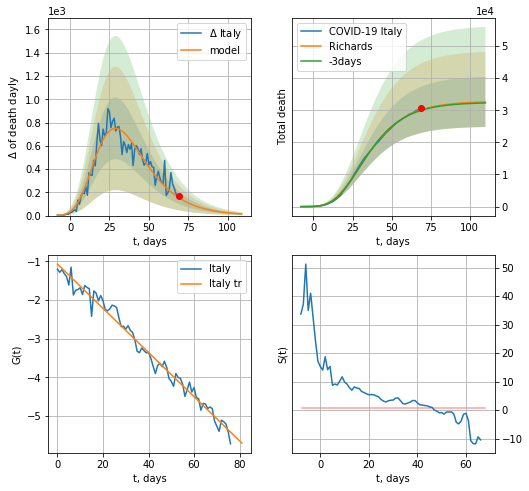

Italy data at: 2020-05-10
+3 day model MAPE: 0.006126
model: Richards
coeffs: [ 3.27922538e+04  7.21568109e+00 -4.68082433e+01  8.64648673e-03]
rational stdev: 0.239002
forecast at the end of period: +41 days
	 total death: 32579 ± 7786
trend coefficient of determination: 0.980400
 intercept: -1.072670
 slope: -0.057095


In [360]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


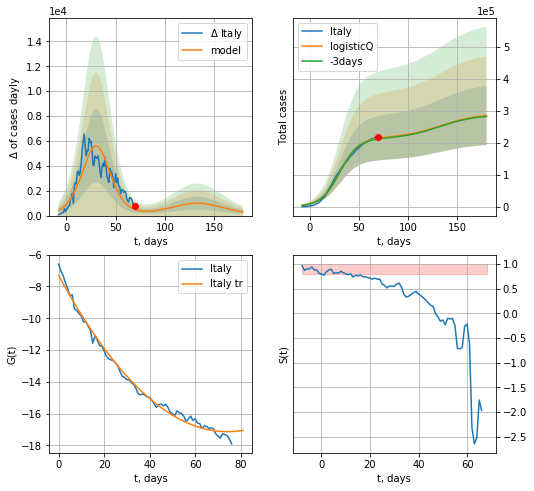

Italy data at: 2020-05-10
+3 day model MAPE: 0.011545
model: logisticQ
coeffs: [ 2.14912282e+05  6.25733270e-07  3.05076908e+01 -1.66106478e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323947
forecast at the end of period: +111 days
	 deltaDaycases: 295
	 total cases: 285033 ± 92335
	 total death: 39761 ± 38641
trend coefficient of determination: 0.991363
 intercept_: -7.2903921858534595
 coeffs_: [ 0.         -0.26579128  0.00179242]


In [106]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


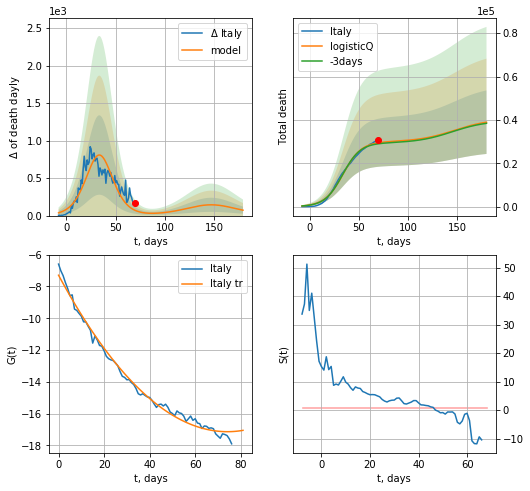

Italy data at: 2020-05-10
+3 day model MAPE: 0.015867
model: logisticQ
coeffs: [ 2.98885223e+04  6.23205426e-07  3.37692815e+01 -1.73333939e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376206
forecast at the end of period: +111 days
	 total death: 38951 ± 14653
trend coefficient of determination: 0.991363
 intercept_: -7.2903921858534595
 coeffs_: [ 0.         -0.26579128  0.00179242]


In [107]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [108]:
dT

43

FR
          date     cases  active    death
81 2020-05-06  174191.0   94410  25809.0
82 2020-05-07  174791.0   93777  25987.0
83 2020-05-08  176079.0   94067  26230.0
84 2020-05-09  176658.0   94310  26310.0
85 2020-05-10  176970.0   94373  26380.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


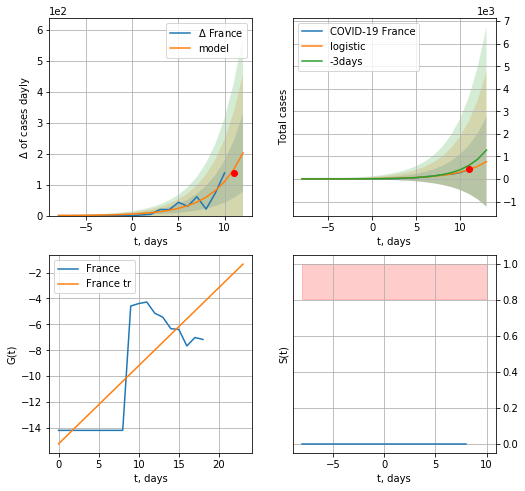

France data at: 2020-05-10
+3 day model MAPE: 0.3579011645535763
model: logistic
coeffs:  [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  2.5989080654975822
forecast at the end of period: +2 days
	 deltaDaycases:  203
	 total cases:  767 ± 1993
	 total death:  114 ± 888
trend coefficient of determination: 0.603781
 intercept: -15.217380
 slope: 0.602806


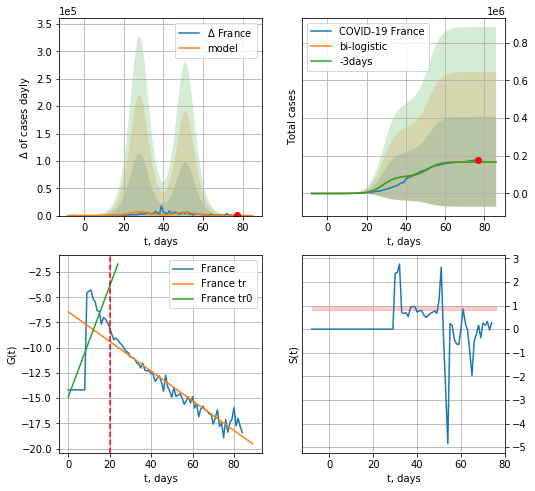

France data at: 2020-05-10
+3 day model MAPE: 0.013104063760316836
model: bi-logistic
coeffs:  [7.71603294e+04 3.14570770e-01 5.15739508e+01] [9.13757357e+04 3.09894510e-01 2.83979795e+01]
rational stdev:  1.4131996012934214
forecast at the end of period: +9 days
	 deltaDaycases:  0
	 total cases:  168534 ± 238172
	 total death:  25122 ± 106507
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.576236
 intercept: -14.895009
 slope: 0.549077
trend coefficient of determination: 0.946391
 intercept: -6.431894
 slope: -0.147118


In [109]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,7*7-dT-4,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT-4,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [110]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

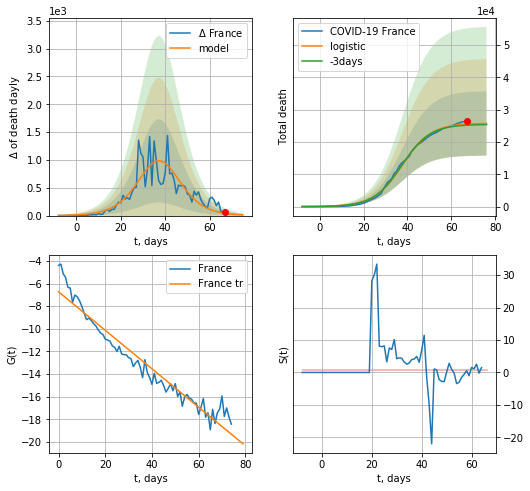

France data at: 2020-05-10
+3 day model MAPE: 0.013370771118159624
model: logistic
coeffs:  [2.57992805e+04 1.52656497e-01 3.76675015e+01]
rational stdev:  0.3869173578145533
forecast at the end of period: +9 days
	 total death:  25725 ± 9953
trend coefficient of determination: 0.938237
 intercept: -6.727404
 slope: -0.170142


In [111]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*8-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


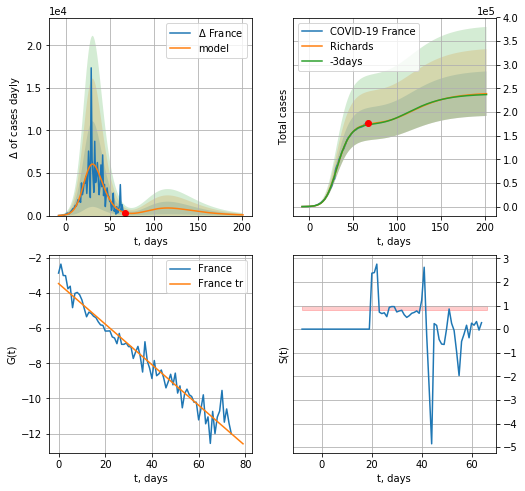

France data at: 2020-05-10
+3 day model MAPE: 0.007324
model: Richards
coeffs: [1.76921581e+05 2.42732526e-01 2.44356509e+01 4.70527537e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.197083
forecast at the end of period: +135 days
	 deltaDaycases: 86
	 total cases: 238824 ± 47068
	 total death: 35600 ± 21048
trend coefficient of determination: 0.954039
 intercept: -3.461296
 slope: -0.115515


In [361]:
x = forecastRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


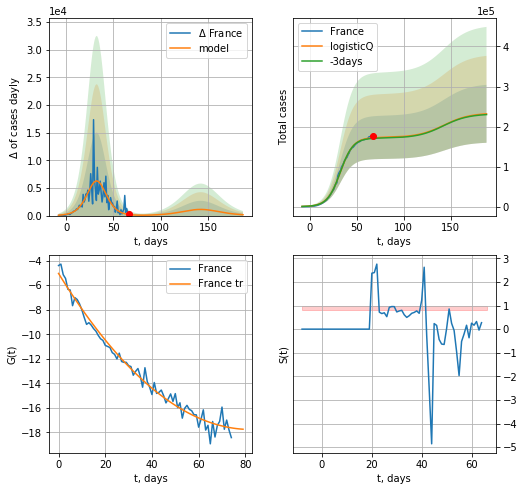

France data at: 2020-05-10
+3 day model MAPE: 0.008897
model: logisticQ
coeffs: [ 1.72786571e+05  1.68340817e-06  3.27355013e+01 -8.61744941e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312194
forecast at the end of period: +121 days
	 deltaDaycases: 157
	 total cases: 231822 ± 72373
	 total death: 34556 ± 32364
trend coefficient of determination: 0.980953
 intercept_: -5.040837969295351
 coeffs_: [ 0.         -0.30878162  0.00187363]


In [113]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


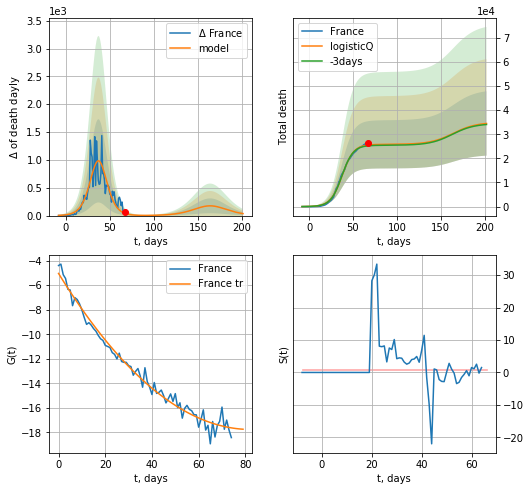

France data at: 2020-05-10
+3 day model MAPE: 0.013402
model: logisticQ
coeffs: [ 2.57981948e+04  1.60513958e-06  3.76674002e+01 -9.50502285e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387061
forecast at the end of period: +135 days
	 total death: 34460 ± 13338
trend coefficient of determination: 0.980953
 intercept_: -5.040837969295351
 coeffs_: [ 0.         -0.30878162  0.00187363]


In [114]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [115]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [116]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


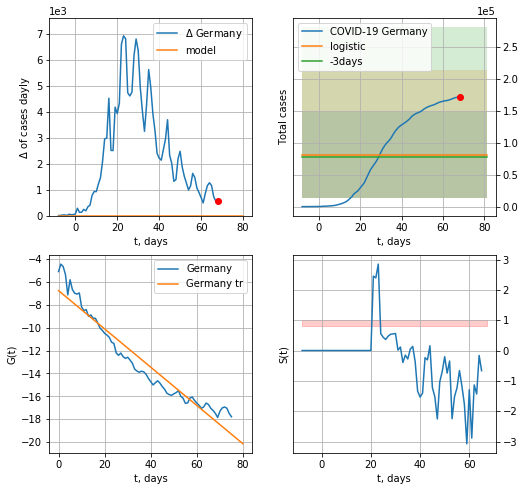

Germany data at: 2020-05-10
+3 day model MAPE: 0.04764688662534435
model: logistic
coeffs:  [ 8.07147793e+04 -3.62117641e+00  1.15729477e+02]
rational stdev:  0.8284297909879335
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  80714 ± 66866
	 total death:  3554 ± 8832
trend coefficient of determination: 0.928616
 intercept: -6.756605
 slope: -0.167484


In [117]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


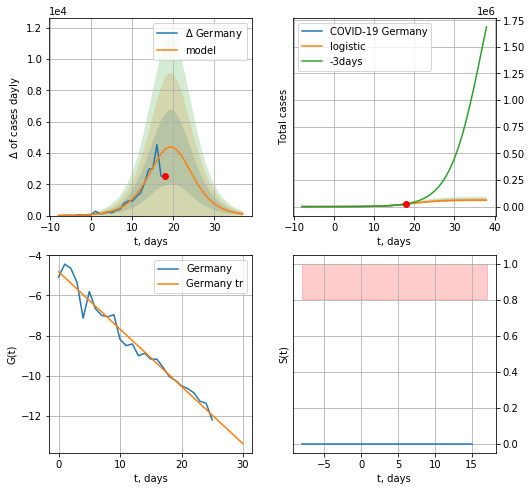

Germany data at: 2020-05-10
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +20 days
	 deltaDaycases:  111
	 total cases:  61300 ± 10454
	 total death:  2699 ± 1380
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


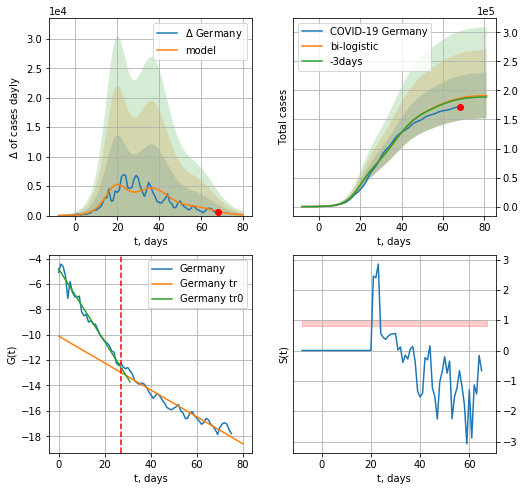

Germany data at: 2020-05-10
+3 day model MAPE: 0.010009212257560856
model: bi-logistic
coeffs:  [1.04276990e+05 1.71092837e-01 3.71135352e+01] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.205720160409164
forecast at the end of period: +13 days
	 deltaDaycases:  124
	 total cases:  191298 ± 39354
	 total death:  8424 ± 5198
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.933027
 intercept: -10.101543
 slope: -0.106162


In [118]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
72 2020-05-06  168162   20987  7275.0
73 2020-05-07  169430   20338  7392.0
74 2020-05-08  170588   19778  7510.0
75 2020-05-09  171324   20475  7549.0
76 2020-05-10  171879   18710  7569.0


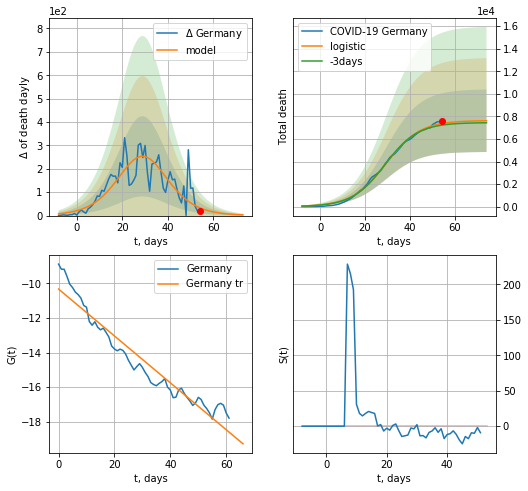

Germany data at: 2020-05-10
+3 day model MAPE: 0.019562503323806615
model: logistic
coeffs:  [7.63763525e+03 1.32807790e-01 2.93494932e+01]
rational stdev:  0.36411054319142117
forecast at the end of period: +20 days
	 total death:  7617 ± 2773
trend coefficient of determination: 0.929065
 intercept: -10.322735
 slope: -0.135693


In [119]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


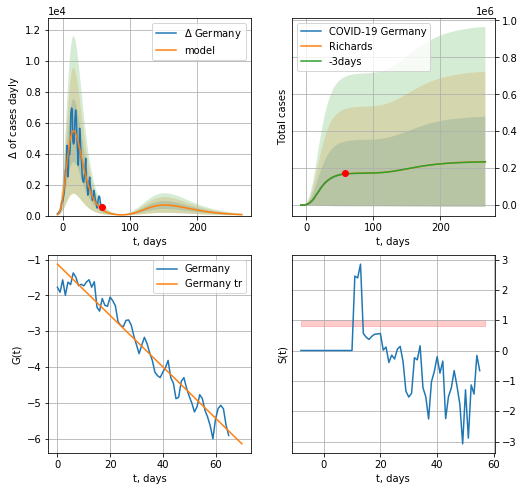

Germany data at: 2020-05-10
+3 day model MAPE: 0.004693
model: Richards
coeffs: [ 1.74153348e+05  5.96318086e+00 -3.26089338e+01  1.44565479e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 1.033271
forecast at the end of period: +209 days
	 deltaDaycases: 61
	 total cases: 235160 ± 242984
	 total death: 10355 ± 32098
trend coefficient of determination: 0.951227
 intercept: -1.127836
 slope: -0.071642


In [362]:
x = forecastRR('Germany',dfGR[10:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


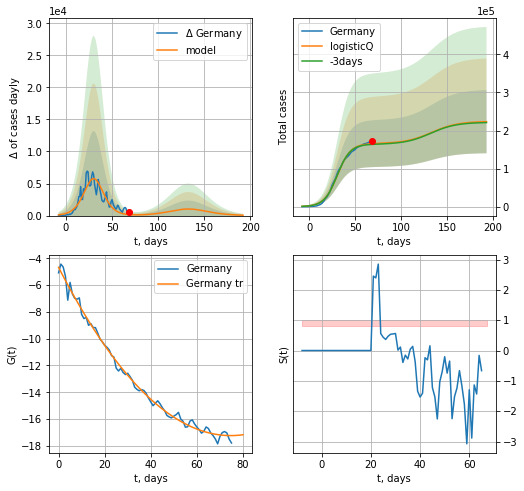

Germany data at: 2020-05-10
+3 day model MAPE: 0.010937
model: logisticQ
coeffs: [ 1.65476592e+05  8.90621301e-07  3.05407574e+01 -1.56351873e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371872
forecast at the end of period: +125 days
	 deltaDaycases: 62
	 total cases: 223214 ± 83007
	 total death: 9829 ± 10965
trend coefficient of determination: 0.993229
 intercept_: -4.675373921462606
 coeffs_: [ 0.         -0.33625088  0.00225035]


In [121]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


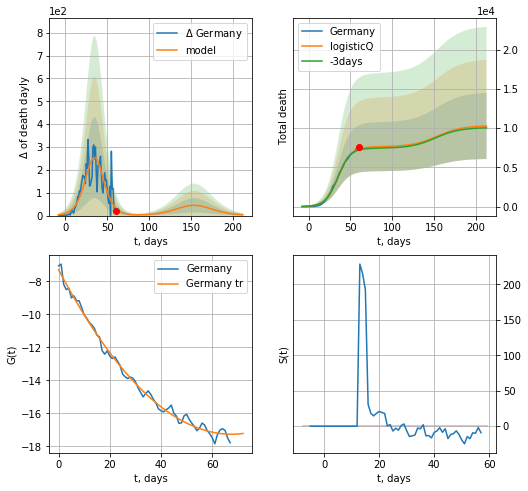

Germany data at: 2020-05-10
+3 day model MAPE: 0.019799
model: logisticQ
coeffs: [ 7.63087636e+03  1.06215385e-05  3.53371385e+01 -1.24794095e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409805
forecast at the end of period: +153 days
	 total death: 10281 ± 4213
trend coefficient of determination: 0.992301
 intercept_: -7.2956012688549965
 coeffs_: [ 0.         -0.29531685  0.00218619]


In [122]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

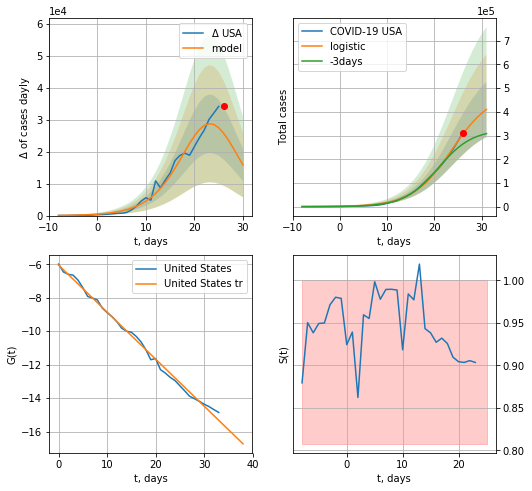

USA data at: 2020-05-10
+3 day model MAPE: 0.19535827238289116
model: logistic
coeffs:  [4.82026100e+05 2.38779089e-01 2.37021772e+01]
rational stdev:  0.2829911701138887
forecast at the end of period: +5 days
	 deltaDaycases:  15846
	 total cases:  410210 ± 116085
	 total death:  24231 ± 20571
trend coefficient of determination: 0.994973
 intercept: -6.048067
 slope: -0.281243


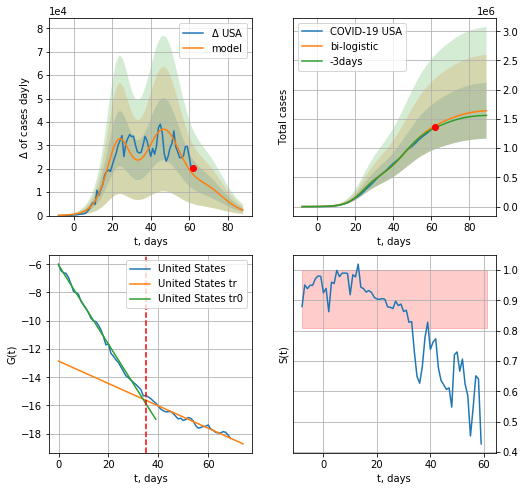

USA data at: 2020-05-10
+3 day model MAPE: 0.027989050936412387
model: bi-logistic
coeffs:  [9.39515402e+05 1.51521368e-01 4.70498068e+01] [4.82026100e+05 2.38779089e-01 2.37021772e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.2909763671738146
forecast at the end of period: +27 days
	 deltaDaycases:  2337
	 total cases:  1641224 ± 477557
	 total death:  96947 ± 84627
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995079
 intercept: -6.063262
 slope: -0.279862
trend coefficient of determination: 0.953903
 intercept: -12.861951
 slope: -0.079097


In [123]:
vL=35
x = forecast('USA',dfUS[:vL],d1,16*3-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

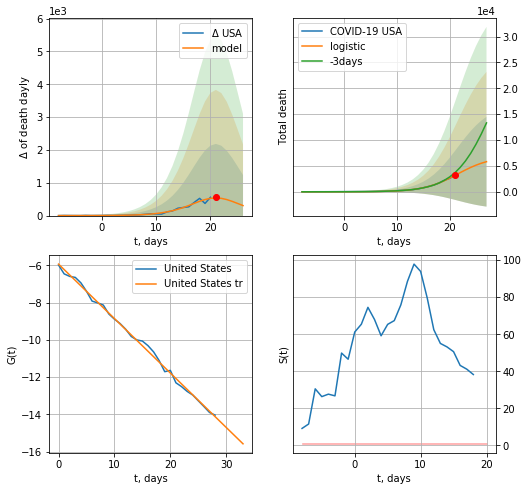

USA data at: 2020-05-10
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +6 days
	 total death:  5815 ± 8682
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


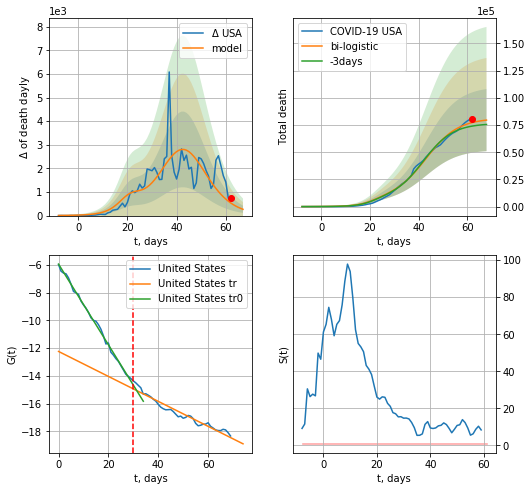

USA data at: 2020-05-10
+3 day model MAPE: 0.045686034476102144
model: bi-logistic
coeffs:  [7.43988462e+04 1.50864810e-01 4.30193663e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.35902172176128144
forecast at the end of period: +6 days
	 deltaDaydeath:  266
	 total death:  79554 ± 28561
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.944860
 intercept: -12.244910
 slope: -0.089938


In [124]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


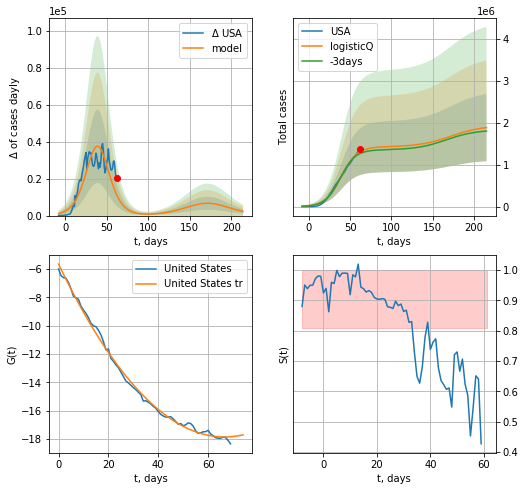

USA data at: 2020-05-10
+3 day model MAPE: 0.034809
model: logisticQ
coeffs: [ 1.42759205e+06  1.00582170e-06  3.93713079e+01 -1.04637819e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.425062
forecast at the end of period: +153 days
	 deltaDaycases: 2269
	 total cases: 1887054 ± 802114
	 total death: 111469 ± 142143
trend coefficient of determination: 0.996429
 intercept_: -5.645014192478751
 coeffs_: [ 0.         -0.36694451  0.00275673]


In [125]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


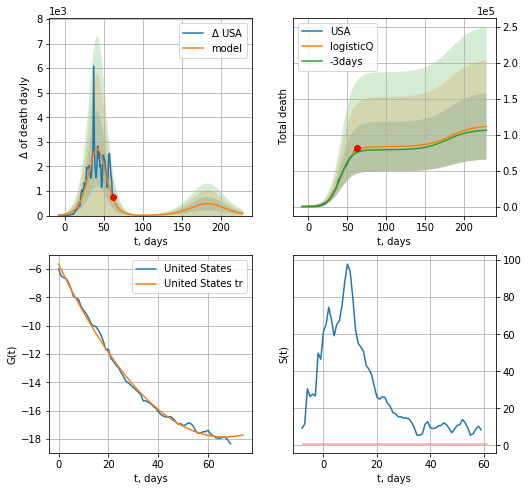

USA data at: 2020-05-10
+3 day model MAPE: 0.038262
model: logisticQ
coeffs: [ 8.32333494e+04  2.05491146e-06  4.19452120e+01 -6.37526510e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413619
forecast at the end of period: +167 days
	 total death: 111371 ± 46065
trend coefficient of determination: 0.996429
 intercept_: -5.645014192478751
 coeffs_: [ 0.         -0.36694451  0.00275673]


In [126]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


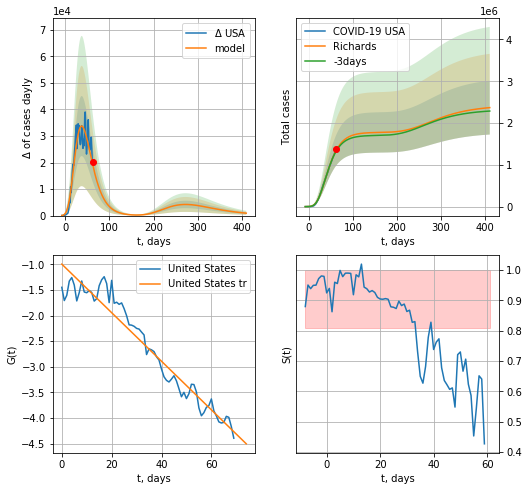

USA data at: 2020-05-10
+3 day model MAPE: 0.015323
model: Richards
coeffs: [ 1.77757670e+06  3.92368187e+00 -4.57118884e+01  1.32404843e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.271790
forecast at the end of period: +349 days
	 deltaDaycases: 912
	 total cases: 2368525 ± 643741
	 total death: 139909 ± 114077
trend coefficient of determination: 0.939530
 intercept: -0.993775
 slope: -0.047456


In [371]:
x = forecastRR('USA',dfUS[:],d1,7*56-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


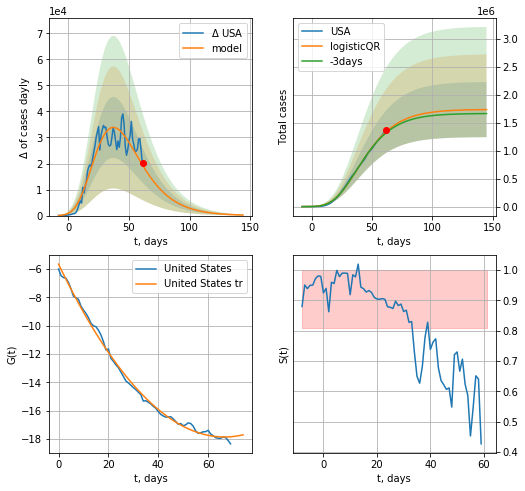

USA data at: 2020-05-10
+3 day model MAPE: 0.016201066349999852
model: logisticQR
coeffs:  [ 1.73517727e+06  1.79654602e-02 -8.89136437e+01 -9.29416175e+02
  2.70507787e-03]
rational stdev:  0.2840728876861139
forecast at the end of period: +83 days
	 deltaDaycases:  208
	 total cases:  1731997 ± 492013
	 total death:  102309 ± 87189
trend coefficient of determination: 0.996429
 intercept_: -5.645014192478751
 coeffs_: [ 0.         -0.36694451  0.00275673]


In [128]:
x = forecastQR('USA',dfUS[:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
70 2020-05-06  201101  170681  30076.0
71 2020-05-07  206715  175756  30615.0
72 2020-05-08  211364  179779  31241.0
73 2020-05-09  215260  183329  31587.0
74 2020-05-10  219183  186984  31855.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


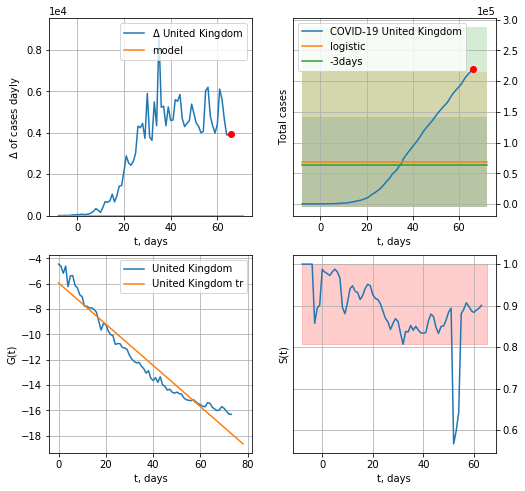

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.09725747991062157
model: logistic
coeffs:  [ 6.88357468e+04 -4.70881741e+00  1.32564534e+02]
rational stdev:  1.063183611048636
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  68835 ± 73185
	 total death:  10004 ± 31908
trend coefficient of determination: 0.944641
 intercept: -5.934671
 slope: -0.162996


In [129]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


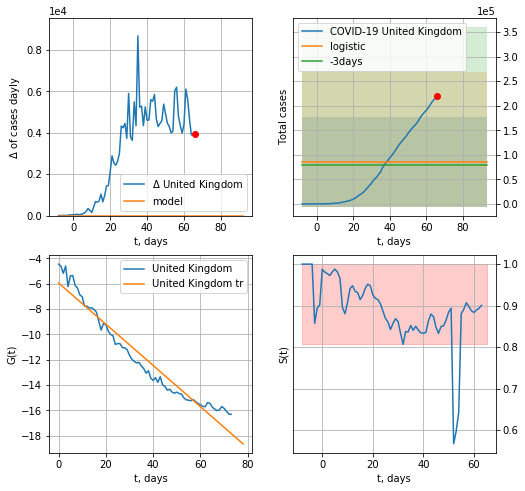

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.0972574799106215
model: logistic
coeffs:  [ 6.88357468e+04 -4.70881741e+00  1.32564534e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.063183611048636
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  86044 ± 91481
	 total death:  12505 ± 39885
trend coefficient of determination: 0.944641
 intercept: -5.934671
 slope: -0.162996


In [130]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


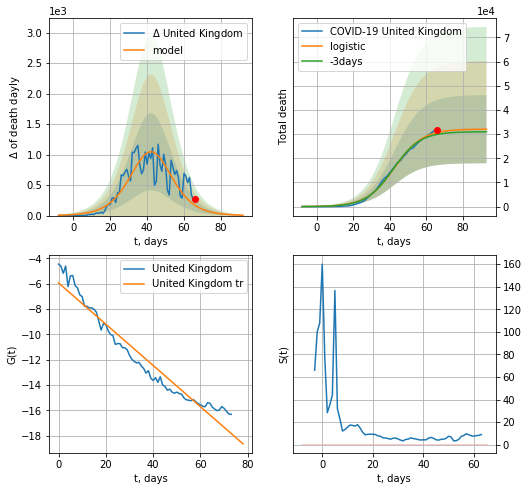

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.027060388370982635
model: logistic
coeffs:  [3.20852760e+04 1.30641013e-01 4.25818986e+01]
rational stdev:  0.4402721432307569
forecast at the end of period: +27 days
	 total death:  32041 ± 14106
trend coefficient of determination: 0.944641
 intercept: -5.934671
 slope: -0.162996


In [131]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


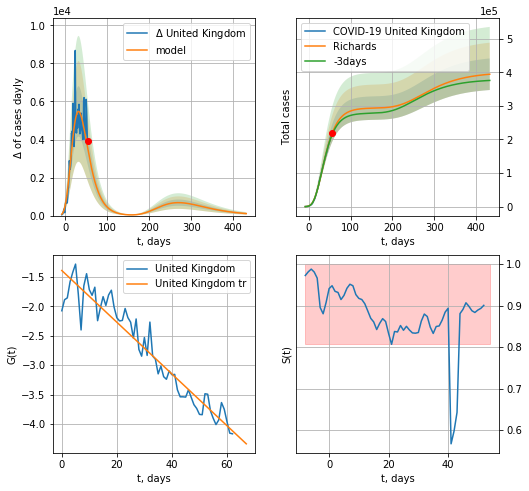

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.018625
model: Richards
coeffs: [ 2.93785631e+05  4.42016138e+00 -5.53145247e+01  1.15313559e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119110
forecast at the end of period: +377 days
	 deltaDaycases: 104
	 total cases: 394097 ± 46940
	 total death: 57276 ± 20466
trend coefficient of determination: 0.916142
 intercept: -1.393837
 slope: -0.043891


In [364]:
x = forecastRR('United Kingdom',dfGB[11:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


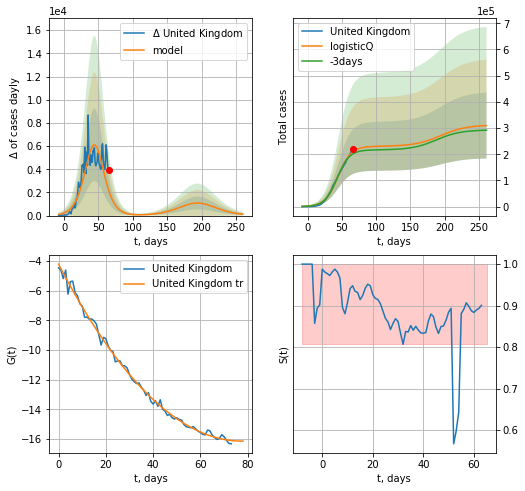

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.040346
model: logisticQ
coeffs: [ 2.30192435e+05  1.20807433e-06  4.45255615e+01 -8.77602297e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405709
forecast at the end of period: +195 days
	 deltaDaycases: 118
	 total cases: 309488 ± 125562
	 total death: 44979 ± 54745
trend coefficient of determination: 0.995662
 intercept_: -4.199218929350129
 coeffs_: [ 0.         -0.30763521  0.00198149]


In [133]:
x = forecastRRR('United Kingdom',dfGB[:],d1,34*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: divide by zero encountered in true_divide


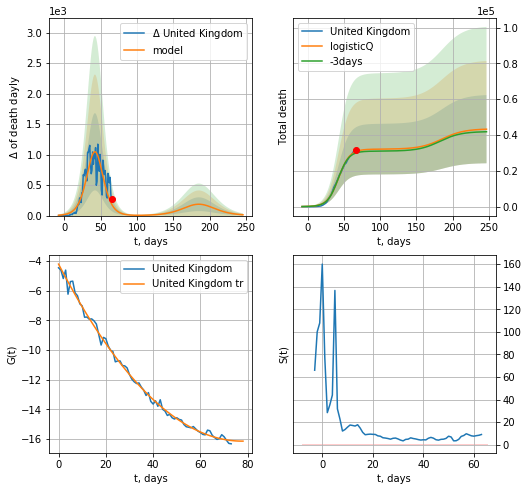

United Kingdom data at: 2020-05-10
+3 day model MAPE: 0.027097
model: logisticQ
coeffs: [ 3.20821153e+04  1.31722335e-06  4.25806415e+01 -9.91232518e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440301
forecast at the end of period: +181 days
	 total death: 43247 ± 19041
trend coefficient of determination: 0.995662
 intercept_: -4.199218929350129
 coeffs_: [ 0.         -0.30763521  0.00198149]


In [134]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [135]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [136]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [137]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [138]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [139]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [140]:
dT

43

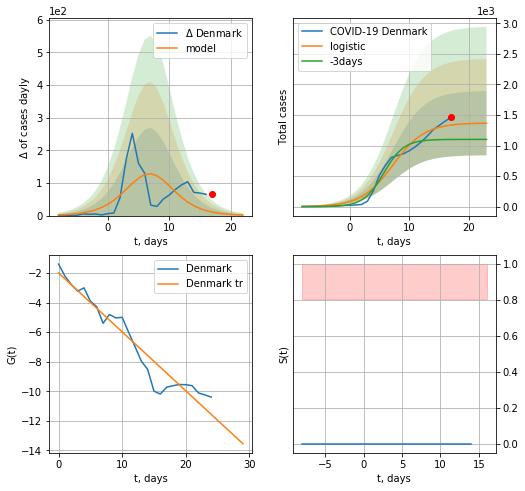

Denmark data at: 2020-05-10
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  1365 ± 525
	 total death:  69 ± 79
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


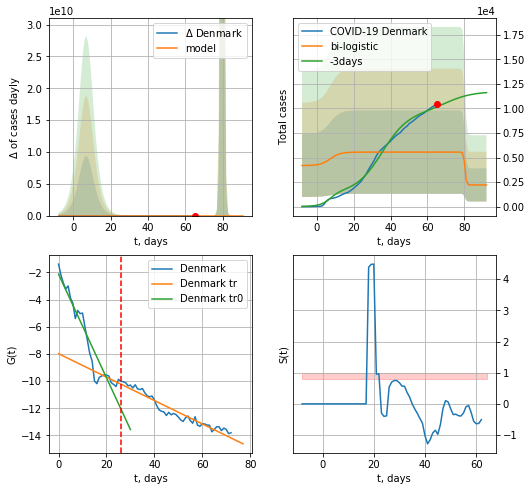

Denmark data at: 2020-05-10
+3 day model MAPE: 0.45772728214590946
model: bi-logistic
coeffs:  [ 3.34740706e+03 -2.59204797e+00  8.03538377e+01] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7658470789732471
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2206 ± 1689
	 total death:  111 ± 255
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.930303
 intercept: -7.983019
 slope: -0.086169


In [141]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


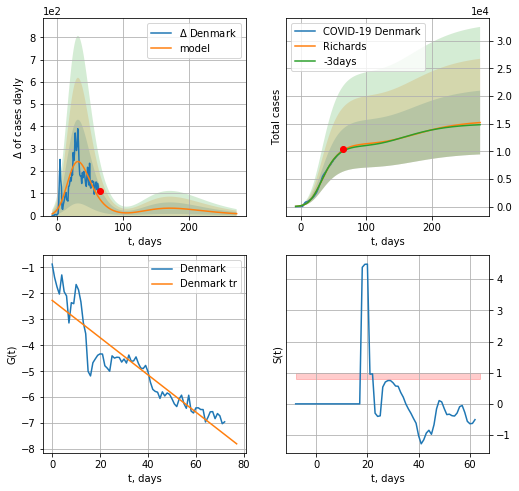

Denmark data at: 2020-05-10
+3 day model MAPE: 0.015576
model: Richards
coeffs: [1.14546513e+04 2.50543335e-01 1.09260103e+01 2.59037855e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.379190
forecast at the end of period: +209 days
	 deltaDaycases: 8
	 total cases: 15194 ± 5761
	 total death: 770 ± 875
trend coefficient of determination: 0.860533
 intercept: -2.269555
 slope: -0.071771


In [365]:
x = forecastRR('Denmark',dfDK[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


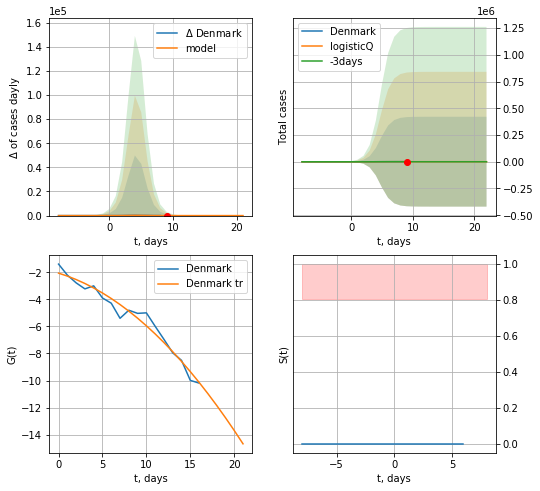

Denmark data at: 2020-05-10
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 43 ± 62857
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


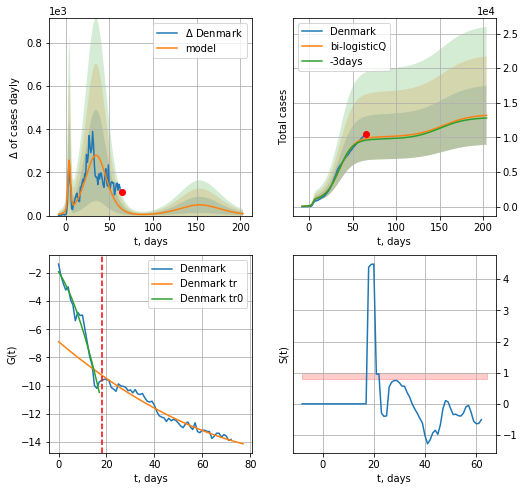

Denmark data at: 2020-05-10
+3 day model MAPE: 0.027177
model: bi-logisticQ
coeffs: [ 9.21178300e+03  7.46588360e-07  3.53140440e+01 -1.62618417e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322924
forecast at the end of period: +139 days
	 deltaDaycases: 8
	 total cases: 13190 ± 4259
	 total death: 669 ± 648
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.962216
 intercept_: -6.876200478757689
 coeffs_: [ 0.         -0.14322096  0.00063906]


In [143]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
70 2020-05-06   7996    7748  216.0
71 2020-05-07   8034    7785  217.0
72 2020-05-08   8070    7820  218.0
73 2020-05-09   8099    7848  219.0
74 2020-05-10   8105    7854  219.0


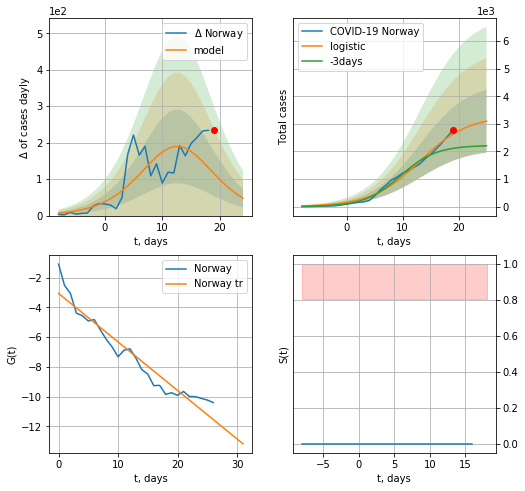

Norway data at: 2020-05-10
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +6 days
	 deltaDaycases:  47
	 total cases:  3100 ± 1139
	 total death:  83 ± 91
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


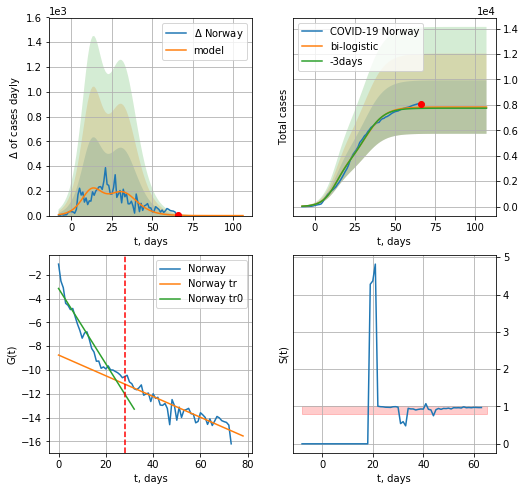

Norway data at: 2020-05-10
+3 day model MAPE: 0.010782874569819816
model: bi-logistic
coeffs:  [4.52758977e+03 1.61922550e-01 3.19983101e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2684168534202446
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  7825 ± 2100
	 total death:  211 ± 169
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.837758
 intercept: -8.744864
 slope: -0.087229


In [144]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

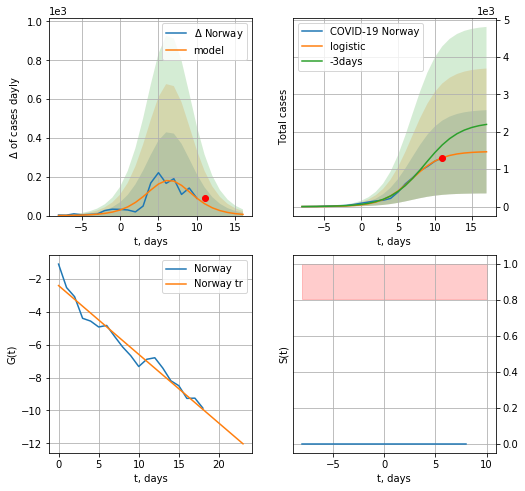

Norway data at: 2020-05-10
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +6 days
	 deltaDaycases:  6
	 total cases:  1465 ± 1112
	 total death:  39 ± 88
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


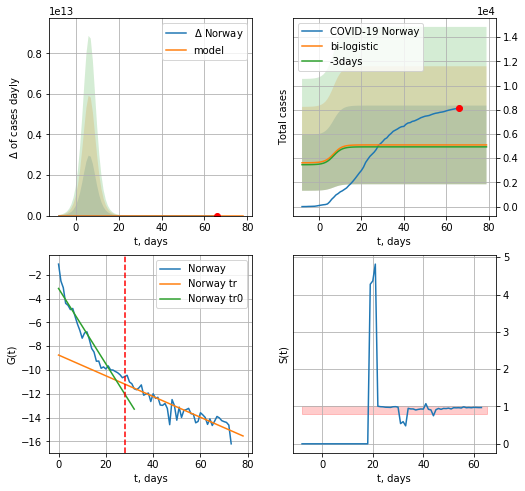

Norway data at: 2020-05-10
+3 day model MAPE: 0.0322969278557206
model: bi-logistic
coeffs:  [ 3.21679352e+03 -2.60368472e+00  1.11254720e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.6378085929156249
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  5093 ± 3248
	 total death:  137 ± 262
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.837758
 intercept: -8.744864
 slope: -0.087229


In [145]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


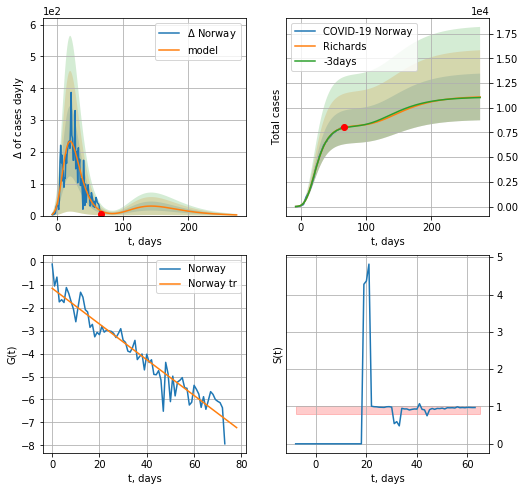

Norway data at: 2020-05-10
+3 day model MAPE: 0.004968
model: Richards
coeffs: [ 8.20325431e+03  9.94619514e-01 -1.12281326e+01  8.09696180e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.212955
forecast at the end of period: +209 days
	 deltaDaycases: 2
	 total cases: 11096 ± 2363
	 total death: 299 ± 191
trend coefficient of determination: 0.929254
 intercept: -1.146059
 slope: -0.078004


In [366]:
x = forecastRR('Norway',dfNG[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


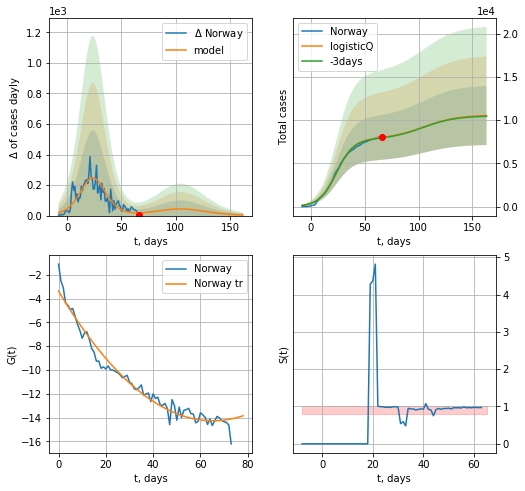

Norway data at: 2020-05-10
+3 day model MAPE: 0.008259
model: logisticQ
coeffs: [ 7.83257281e+03  9.05897663e-07  2.40265043e+01 -1.38877034e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324088
forecast at the end of period: +97 days
	 deltaDaycases: 4
	 total cases: 10538 ± 3415
	 total death: 284 ± 276
trend coefficient of determination: 0.965454
 intercept_: -3.3657298333296444
 coeffs_: [ 0.         -0.33420197  0.00256073]


In [147]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

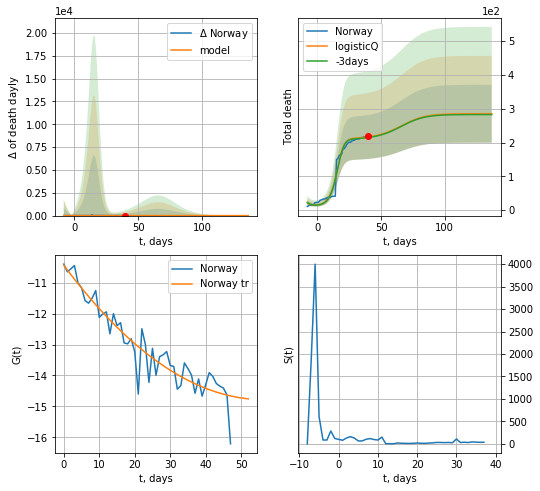

Norway data at: 2020-05-10
+3 day model MAPE: 0.008474
model: logisticQ
coeffs: [ 2.10698710e+02  9.76335657e-03  1.49489357e+01 -1.76002029e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300119
forecast at the end of period: +97 days
	 total death: 285 ± 85
trend coefficient of determination: 0.887395
 intercept_: -10.436622088800949
 coeffs_: [ 0.         -0.15404475  0.00136541]


In [148]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

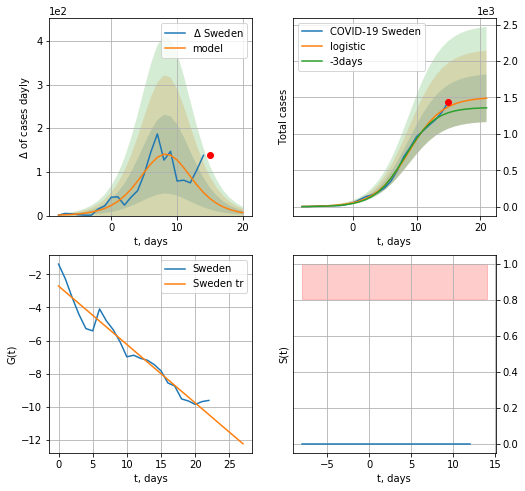

Sweden data at: 2020-05-10
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +6 days
	 deltaDaycases:  6
	 total cases:  1489 ± 326
	 total death:  182 ± 119
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


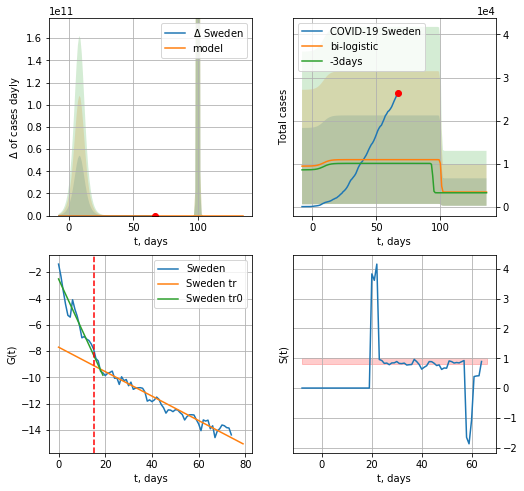

Sweden data at: 2020-05-10
+3 day model MAPE: 0.085935510488596
model: bi-logistic
coeffs:  [ 7.52429851e+03 -3.50274209e+00  1.00574618e+02] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9427007733812209
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  3385 ± 3191
	 total death:  414 ± 1170
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.949807
 intercept: -7.696383
 slope: -0.092958


In [149]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
71 2020-05-06  23918   16903  2941.0
72 2020-05-07  24623   16612  3040.0
73 2020-05-08  25265   17119  3175.0
74 2020-05-09  25921   17730  3220.0
75 2020-05-10  26322   18126  3225.0


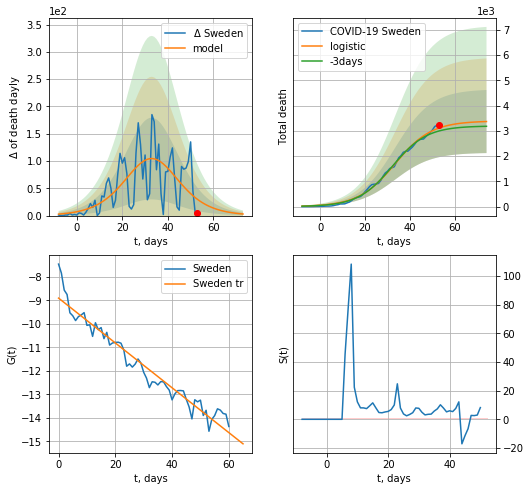

Sweden data at: 2020-05-10
+3 day model MAPE: 0.041073830815149356
model: logistic
coeffs:  [3.39358379e+03 1.23210042e-01 3.33528433e+01]
rational stdev:  0.37078932777036244
forecast at the end of period: +21 days
	 total death:  3371 ± 1249
trend coefficient of determination: 0.942754
 intercept: -8.898911
 slope: -0.095409


In [150]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


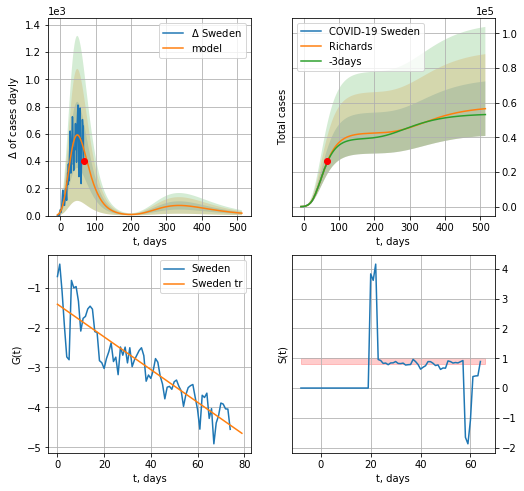

Sweden data at: 2020-05-10
+3 day model MAPE: 0.011638
model: Richards
coeffs: [ 4.25436730e+04  1.06939602e+00 -3.75808237e+01  3.60572664e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.278366
forecast at the end of period: +447 days
	 deltaDaycases: 17
	 total cases: 56551 ± 15742
	 total death: 6928 ± 5785
trend coefficient of determination: 0.810990
 intercept: -1.413123
 slope: -0.040980


In [367]:
x = forecastRR('Sweden',dfSW[:],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


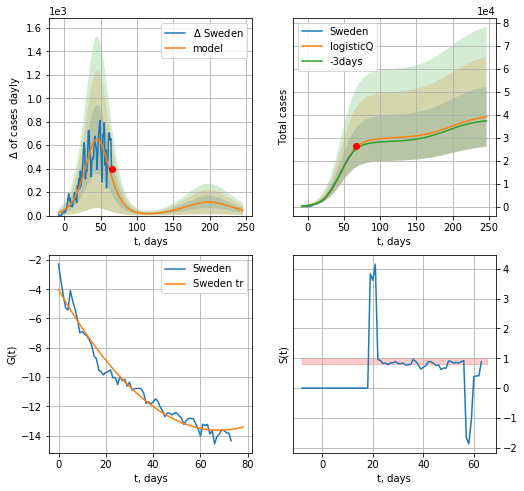

Sweden data at: 2020-05-10
+3 day model MAPE: 0.028933
model: logisticQ
coeffs: [ 2.97190132e+04  1.41182507e-06  4.56405158e+01 -6.19921841e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333578
forecast at the end of period: +181 days
	 deltaDaycases: 45
	 total cases: 39113 ± 13047
	 total death: 4792 ± 4795
trend coefficient of determination: 0.967374
 intercept_: -4.025001456822464
 coeffs_: [ 0.         -0.28332354  0.00208824]


In [152]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


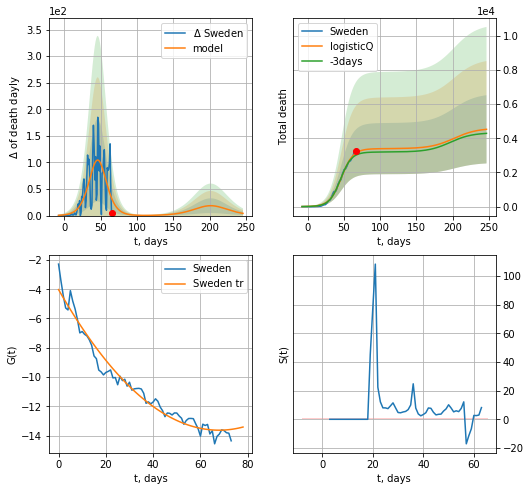

Sweden data at: 2020-05-10
+3 day model MAPE: 0.041148
model: logisticQ
coeffs: [ 3.39109939e+03  1.96436007e-06  4.63385262e+01 -6.27494817e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.441527
forecast at the end of period: +181 days
	 total death: 4522 ± 1996
trend coefficient of determination: 0.967374
 intercept_: -4.025001456822464
 coeffs_: [ 0.         -0.28332354  0.00208824]


In [153]:
x = forecastRRR('Sweden',dfSW[1:],d1,32*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

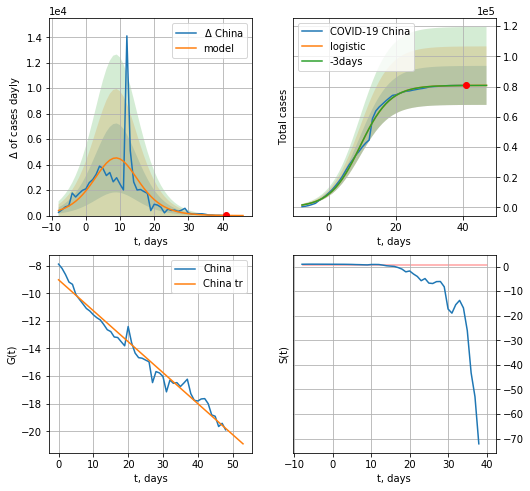

China data at: 2020-05-10
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  80793 ± 12903
	 total death:  4514 ± 2162
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


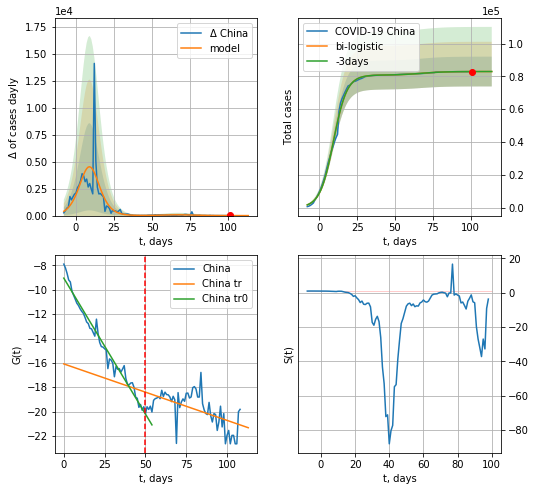

China data at: 2020-05-10
+3 day model MAPE: 0.00016657214460923022
model: bi-logistic
coeffs:  [2.16999940e+03 1.28797070e-01 6.75924838e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10940750408686241
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  82974 ± 9078
	 total death:  4636 ± 1521
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.332227
 intercept: -16.085574
 slope: -0.046396


In [154]:
x = forecast('China',dfCN[:50],d1,7*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [155]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

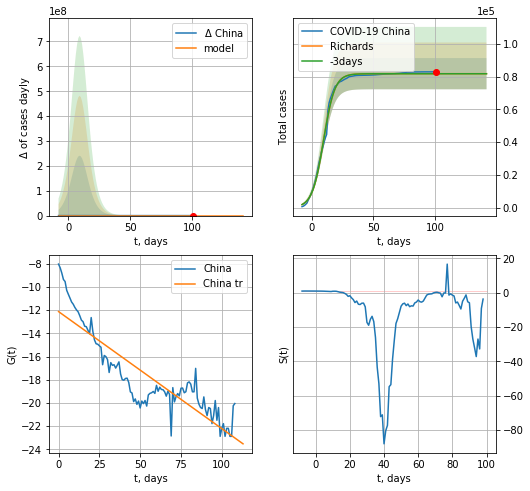

China data at: 2020-05-10
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4569 ± 1596
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


In [368]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

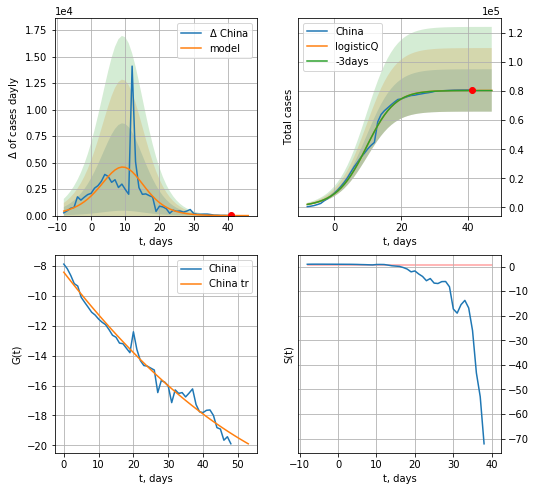

China data at: 2020-05-10
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +6 days
	 deltaDaycases: 1
	 total cases: 80414 ± 14556
	 total death: 4493 ± 2439
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


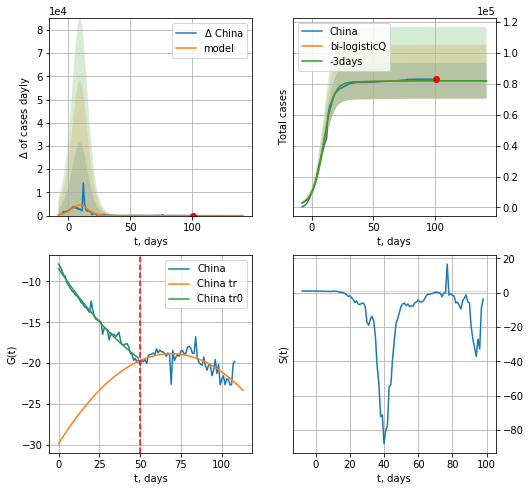

China data at: 2020-05-10
+3 day model MAPE: 0.000736
model: bi-logisticQ
coeffs: [ 1.45612333e+03  7.40393790e-04  2.48764353e+01 -1.26372000e-02]
rational stdev: 0.141513
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 81873 ± 11586
	 total death: 4574 ± 1941
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.526418
 intercept_: -29.87332138325043
 coeffs_: [ 0.          0.31969111 -0.00231713]


In [157]:
x = forecastRRR('China',dfCN[:50],d1,7*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [158]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
81 2020-05-06  10810  1135.0  256.0
82 2020-05-07  10822  1082.0  256.0
83 2020-05-08  10840  1016.0  256.0
84 2020-05-09  10874  1008.0  256.0
85 2020-05-10  10909  1021.0  256.0


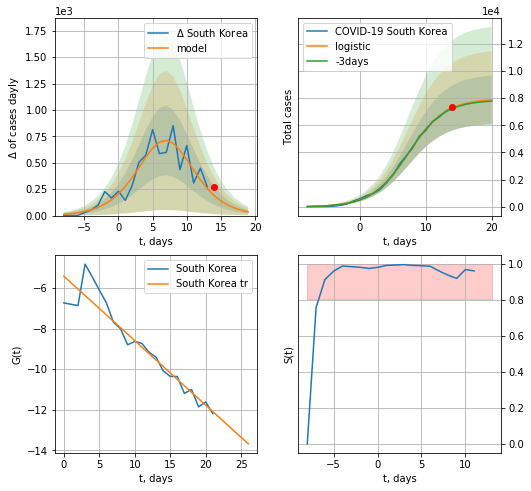

South Korea data at: 2020-05-10
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +6 days
	 deltaDaycases:  35
	 total cases:  7857 ± 1788
	 total death:  184 ± 125
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


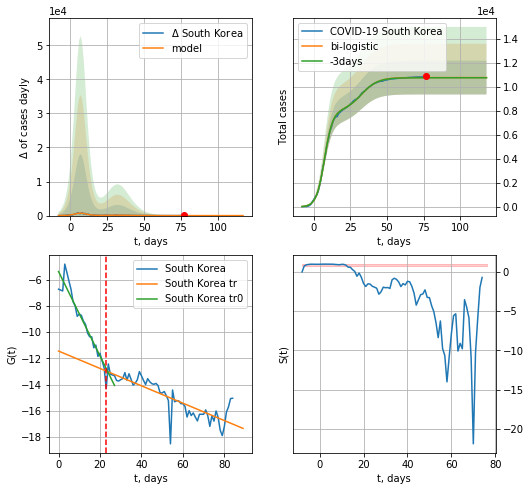

South Korea data at: 2020-05-10
+3 day model MAPE: 0.0016083474199482639
model: bi-logistic
coeffs:  [2.81276404e+03 1.77147004e-01 3.25399567e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.13050216197245224
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  10753 ± 1403
	 total death:  252 ± 98
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.707057
 intercept: -11.444926
 slope: -0.066171


In [160]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [161]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

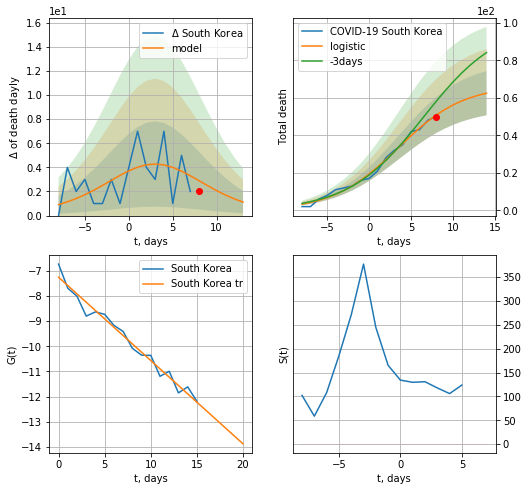

South Korea data at: 2020-05-10
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +6 days
	 total death:  62 ± 11
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


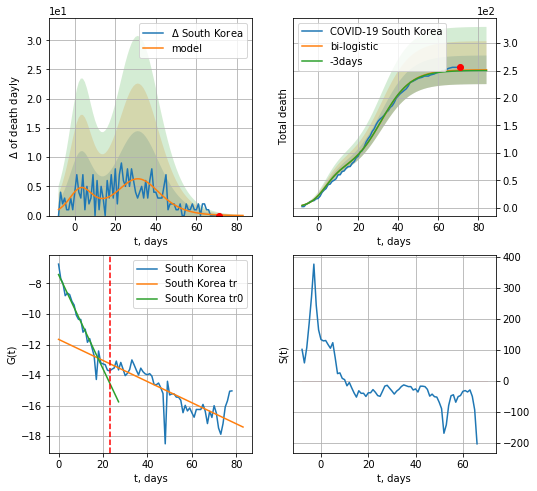

South Korea data at: 2020-05-10
+3 day model MAPE: 0.0050644919476604214
model: bi-logistic
coeffs:  [1.85014753e+02 1.35956507e-01 3.16604077e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10374143006964406
forecast at the end of period: +13 days
	 deltaDaydeath:  0
	 total death:  251 ± 26
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.676485
 intercept: -11.662208
 slope: -0.069234


In [162]:
x = forecast('South Korea',dfKR[6:23],d1,7*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


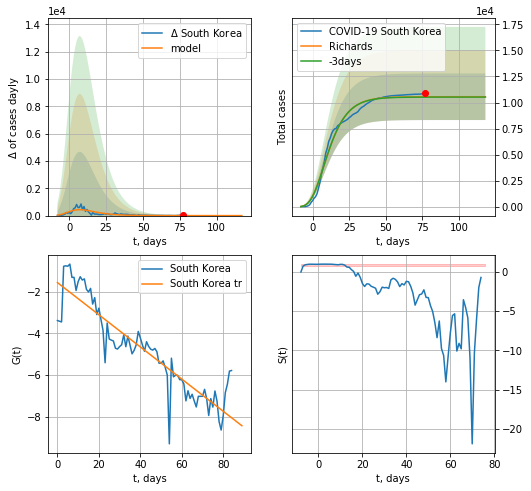

South Korea data at: 2020-05-10
+3 day model MAPE: 0.003019
model: Richards
coeffs: [ 1.05598838e+04  2.99837264e+01 -4.23359616e+01  3.73555466e-03]
rational stdev: 0.211306
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 10559 ± 2231
	 total death: 247 ± 156
trend coefficient of determination: 0.821113
 intercept: -1.560761
 slope: -0.077102


In [369]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


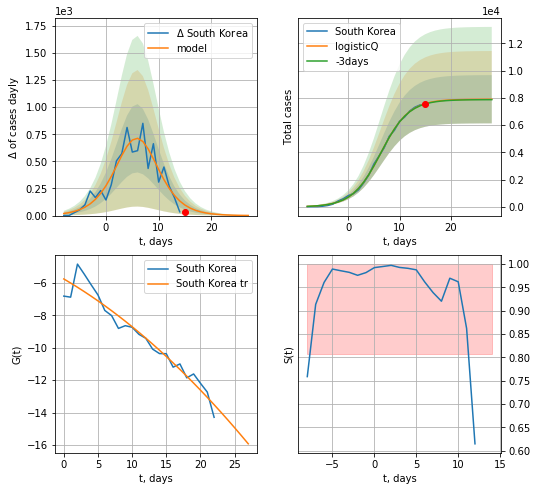

South Korea data at: 2020-05-10
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 7.90024888e+03  7.99722084e-05  6.33808286e+00 -4.52403663e+03]
rational stdev: 0.223765
forecast at the end of period: +13 days
	 deltaDaycases: 1
	 total cases: 7897 ± 1767
	 total death: 185 ± 124
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


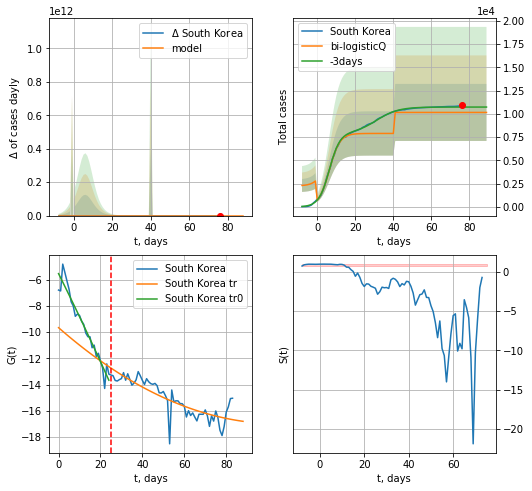

South Korea data at: 2020-05-10
+3 day model MAPE: 0.053760
model: bi-logisticQ
coeffs: [ 2.26048923e+03  2.95045927e+00  4.02940282e+01 -7.58624442e-01]
rational stdev: 0.301860
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 10160 ± 3067
	 total death: 238 ± 215
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936575
 intercept_: -5.550309986859278
 coeffs_: [ 0.         -0.32029791 -0.00074495]
trend coefficient of determination: 0.714722
 intercept_: -9.663346936391516
 coeffs_: [ 0.         -0.13969277  0.00066637]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp


In [164]:
vL=25
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

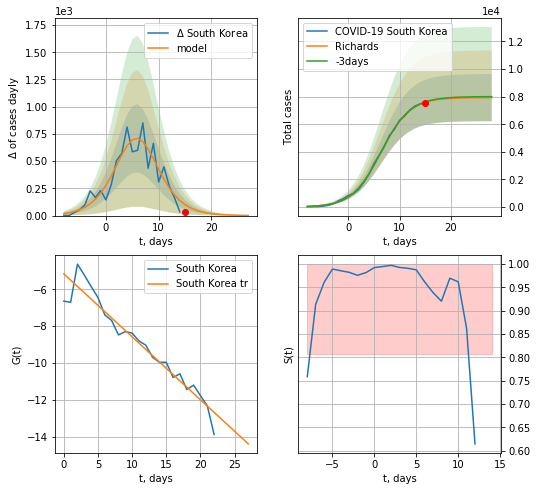

South Korea data at: 2020-05-10
+3 day model MAPE: 0.005302
model: Richards
coeffs: [7.93327913e+03 3.71274932e-01 6.16788537e+00 9.53222659e-01]
rational stdev: 0.215580
forecast at the end of period: +13 days
	 deltaDaycases: 1
	 total cases: 7929 ± 1709
	 total death: 186 ± 120
trend coefficient of determination: 0.927975
 intercept: -5.164068
 slope: -0.341524


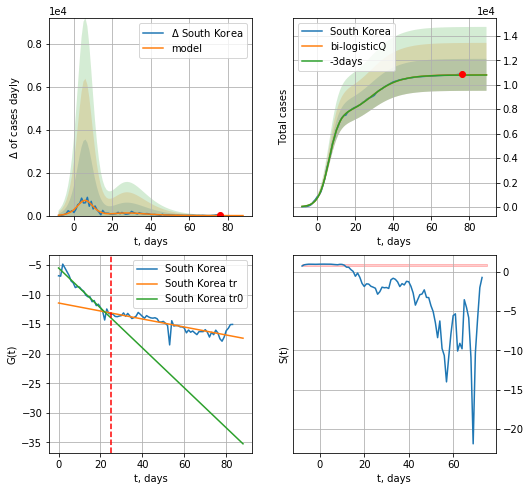

South Korea data at: 2020-05-10
+3 day model MAPE: 0.001528
model: bi-logisticQ
coeffs: [2.88317841e+03 1.13999799e+00 9.37947593e+00 1.04265306e-01]
rational stdev: 0.120888
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 10814 ± 1307
	 total death: 253 ± 91
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.698863
 intercept: -11.412799
 slope: -0.067733


In [370]:
vL=25
x = forecastRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


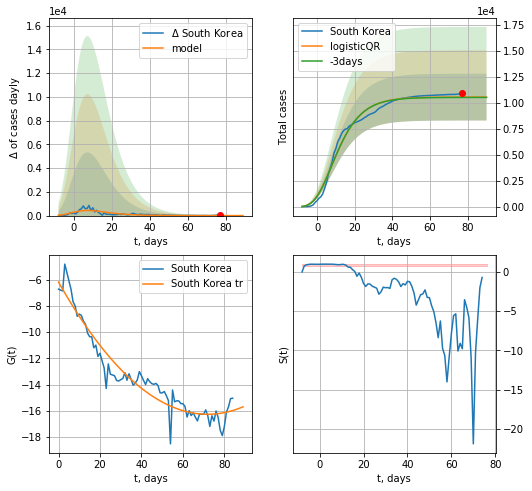

South Korea data at: 2020-05-10
+3 day model MAPE: 0.0030800147217789047
model: logisticQR
coeffs:  [ 1.05529071e+04  1.49346198e-01 -6.68187078e+01 -2.22678220e+03
  3.23694921e-04]
rational stdev:  0.21305002691166094
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  10552 ± 2248
	 total death:  247 ± 157
trend coefficient of determination: 0.923178
 intercept_: -6.195263770601228
 coeffs_: [ 0.         -0.2798081   0.00194485]


In [166]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
104 2020-05-06  20198   18544   20.0
105 2020-05-07  20939   19207   20.0
106 2020-05-08  21707   19647   20.0
107 2020-05-09  22460   20144   20.0
108 2020-05-10  23336   20595   20.0


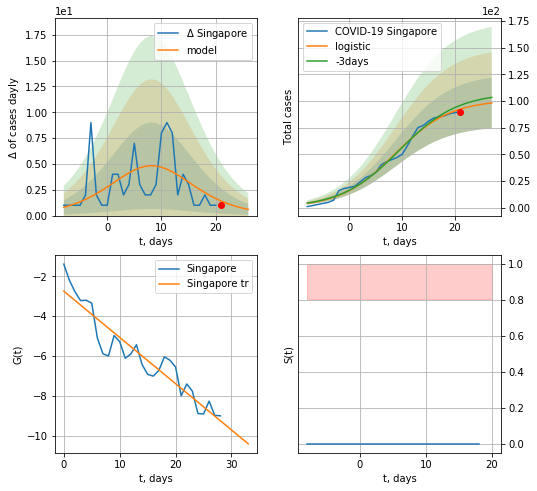

Singapore data at: 2020-05-10
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  98 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


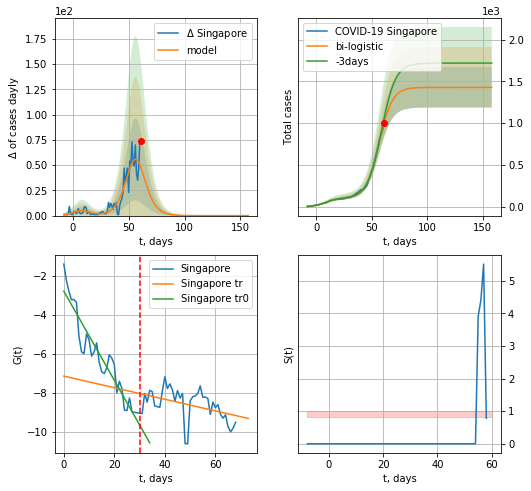

Singapore data at: 2020-05-10
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +97 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


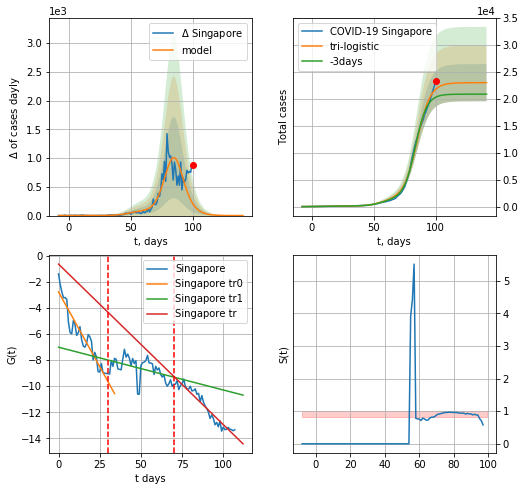

Singapore data at: 2020-05-10
+3 day model MAPE: 0.07673787005505575
model: tri-logistic
coeffs:  [2.15168268e+04 1.87473928e-01 8.49502794e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.15011339943691102
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  22944 ± 3444
	 total death:  19 ± 8
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.930370
 intercept: -0.638178
 slope: -0.123035


In [170]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


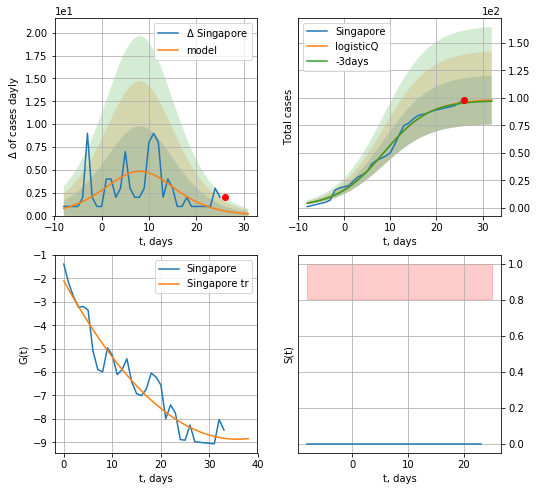

Singapore data at: 2020-05-10
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +6 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


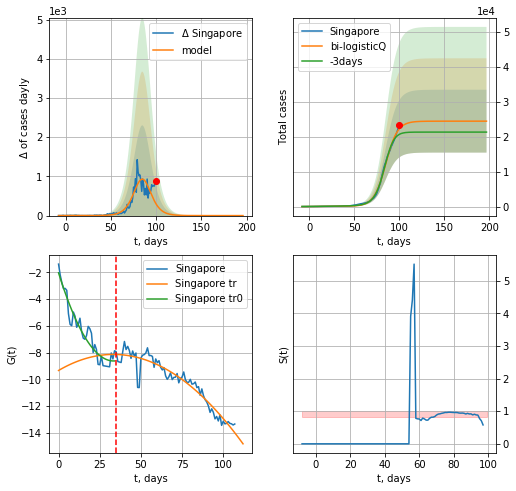

Singapore data at: 2020-05-10
+3 day model MAPE: 0.082634
model: bi-logisticQ
coeffs: [ 2.43015307e+04  8.91490365e-06  8.50656959e+01 -1.71154817e+04]
S.Korea scenario coeffs: [0.35, 0.5, 4.0, 1.0]
rational stdev: 0.367683
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 24400 ± 8971
	 total death: 20 ± 22
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.911928
 intercept_: -9.338538109232399
 coeffs_: [ 0.          0.07205367 -0.00108044]


In [171]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=[0.35,.5,4.,1.],vL=vL)

In [172]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


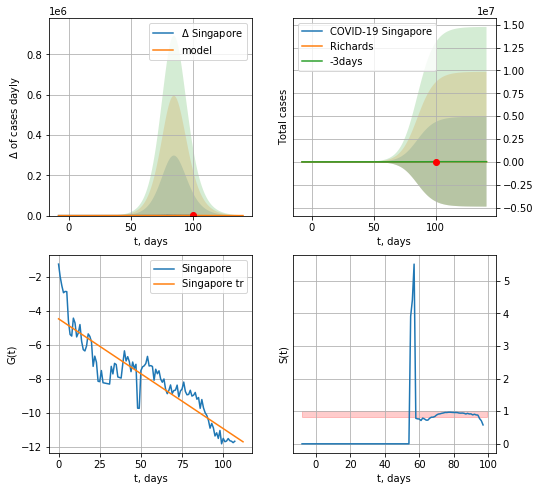

Singapore data at: 2020-05-10
+3 day model MAPE: 0.081348
model: Richards
coeffs: [2.52512579e+04 1.63819544e-01 8.36806346e+01 8.33281563e-01]
rational stdev: 194.600318
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 25239 ± 4911546
	 total death: 21 ± 12259
trend coefficient of determination: 0.805205
 intercept: -4.480018
 slope: -0.064417


In [173]:
x = forecastRR('Singapore',dfSG[:],d1,12*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


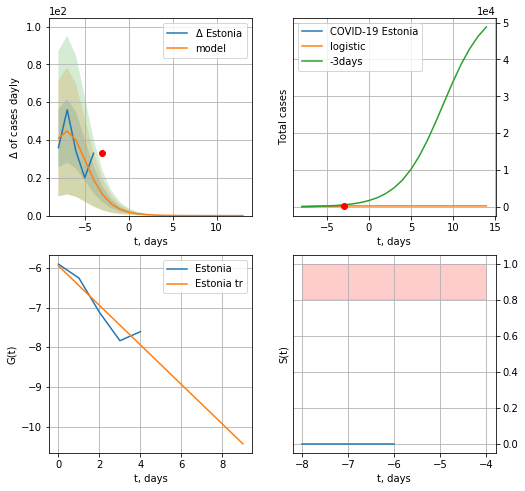

Estonia data at: 2020-05-10
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


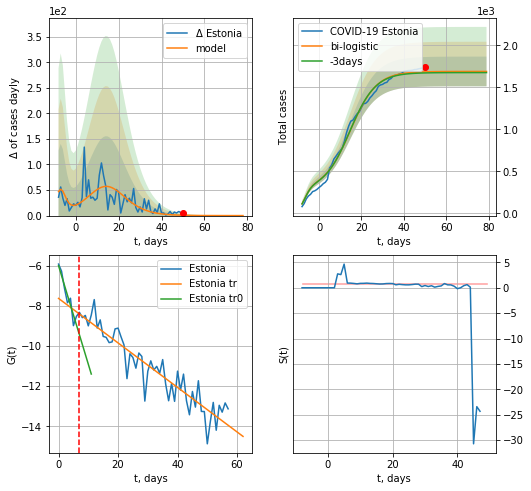

Estonia data at: 2020-05-10
+3 day model MAPE: 0.007716665495702222
model: bi-logistic
coeffs:  [1.41098182e+03 1.62275506e-01 1.47244354e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.10475739961325425
forecast at the end of period: +29 days
	 deltaDaycases:  0
	 total cases:  1688 ± 176
	 total death:  58 ± 18
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.857733
 intercept: -7.618255
 slope: -0.111101


In [174]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


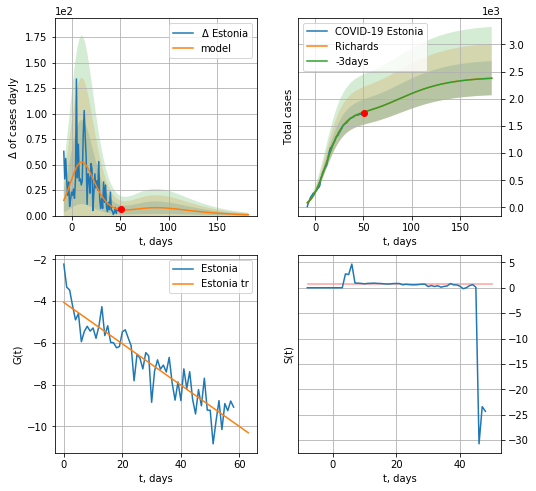

Estonia data at: 2020-05-10
+3 day model MAPE: 0.000395
model: Richards
coeffs: [1.76435719e+03 2.16304753e-01 3.03517250e+00 4.56883071e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.132059
forecast at the end of period: +132 days
	 deltaDaycases: 0
	 total cases: 2377 ± 314
	 total death: 82 ± 32
trend coefficient of determination: 0.851741
 intercept: -4.060314
 slope: -0.099142


In [175]:
x = forecastRR('Estonia',dfES[:],d1,7*25-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


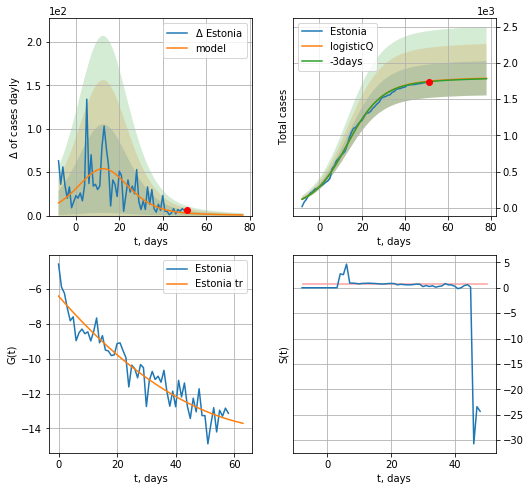

Estonia data at: 2020-05-10
+3 day model MAPE: 0.003832
model: logisticQ
coeffs: [ 1.72464119e+03  1.65379976e-06  1.29828923e+01 -7.52176872e+04]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.132176
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1787 ± 236
	 total death: 61 ± 24
trend coefficient of determination: 0.899005
 intercept_: -6.421919816459271
 coeffs_: [ 0.         -0.19232548  0.00121825]


In [176]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date  cases  active  death
60 2020-05-06  909.0     427   18.0
61 2020-05-07  928.0     446   18.1
62 2020-05-08  930.0     448   18.2
63 2020-05-09  939.0     457   18.3
64 2020-05-10  939.0     457   18.0


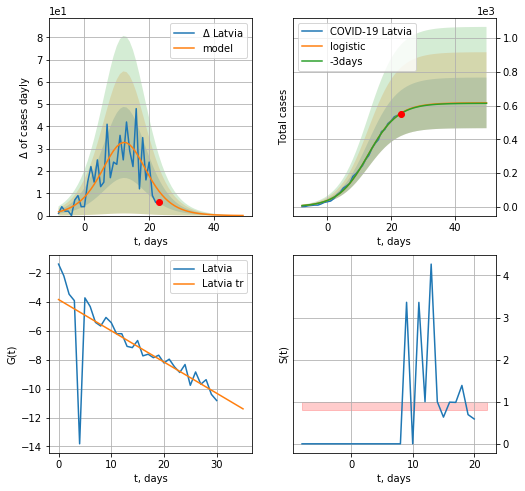

Latvia data at: 2020-05-10
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  615 ± 150
	 total death:  11 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

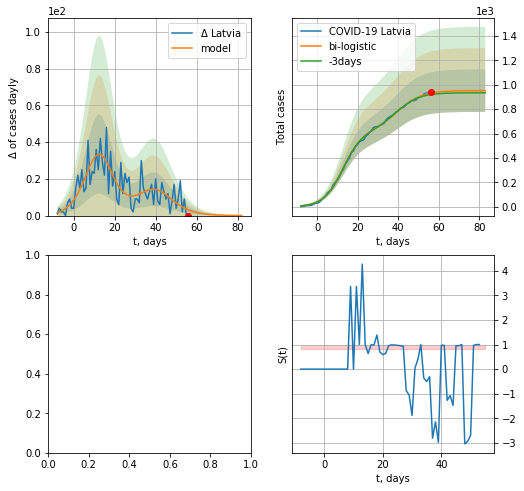

In [177]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


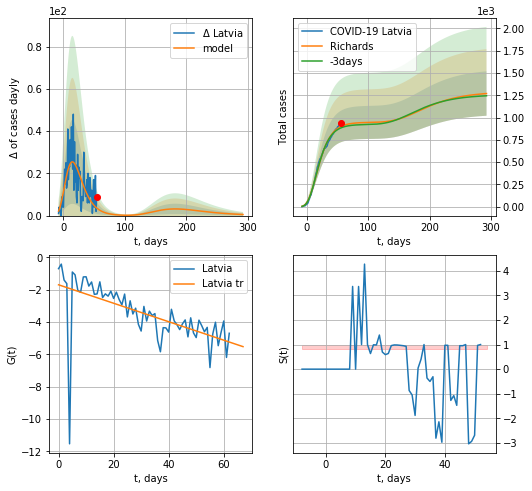

Latvia data at: 2020-05-09
+3 day model MAPE: 0.017800
model: Richards
coeffs: [ 9.47095715e+02  1.11433597e+01 -5.36193995e+01  6.57830989e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.196279
forecast at the end of period: +238 days
	 deltaDaycases: 0
	 total cases: 1269 ± 249
	 total death: 24 ± 14
trend coefficient of determination: 0.352566
 intercept: -1.695544
 slope: -0.057072


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


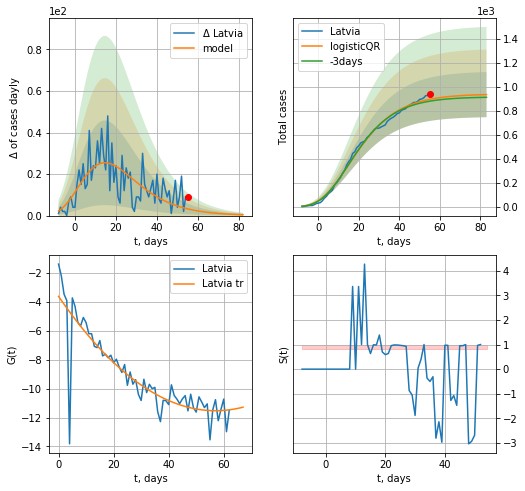

Latvia data at: 2020-05-09
+3 day model MAPE: 0.018162460547429166
model: logisticQR
coeffs:  [ 9.41490962e+02  4.44606984e-02 -8.44378595e+01 -1.38792586e+03
  1.10032431e-03]
rational stdev:  0.2012567763106529
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  936 ± 188
	 total death:  18 ± 10
trend coefficient of determination: 0.757841
 intercept_: -3.6146837749662577
 coeffs_: [ 0.         -0.2776324   0.00243583]


In [458]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


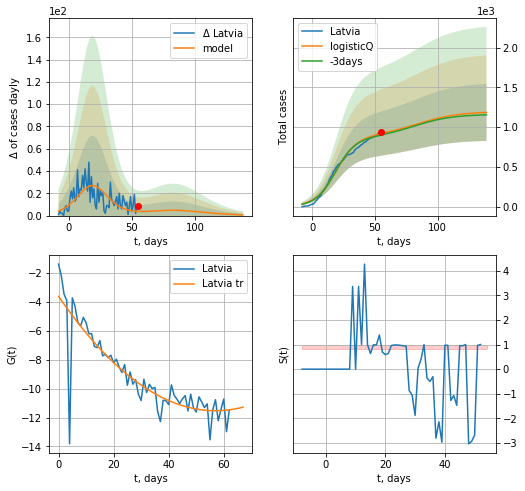

Latvia data at: 2020-05-09
+3 day model MAPE: 0.020898
model: logisticQ
coeffs: [ 8.83921937e+02  5.84837509e-07  1.91923173e+01 -2.06125173e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.302263
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 1186 ± 358
	 total death: 22 ± 19
trend coefficient of determination: 0.757841
 intercept_: -3.6146837749662577
 coeffs_: [ 0.         -0.2776324   0.00243583]


In [383]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


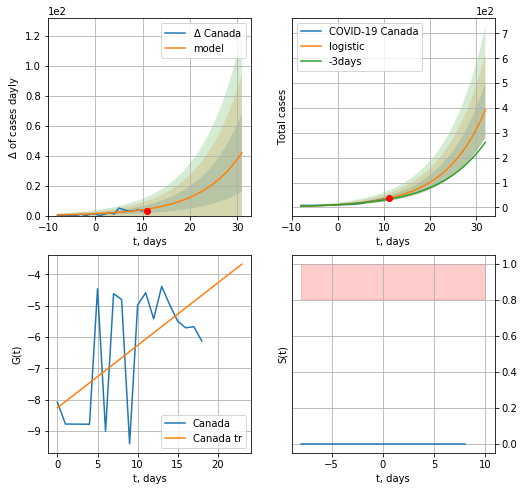

Canada data at: 2020-05-10
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  27 ± 22
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


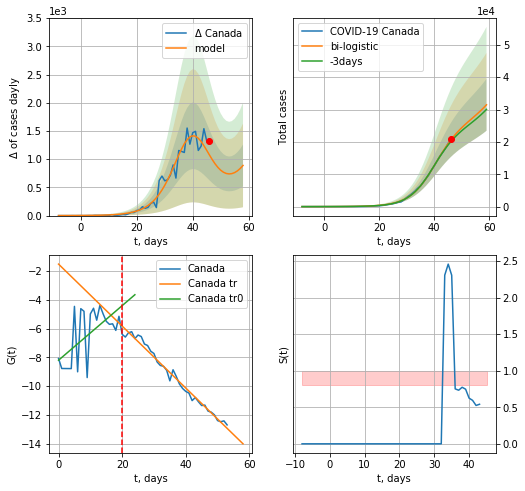

Canada data at: 2020-05-10
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +13 days
	 deltaDaycases:  888
	 total cases:  31457 ± 8019
	 total death:  2225 ± 1701
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


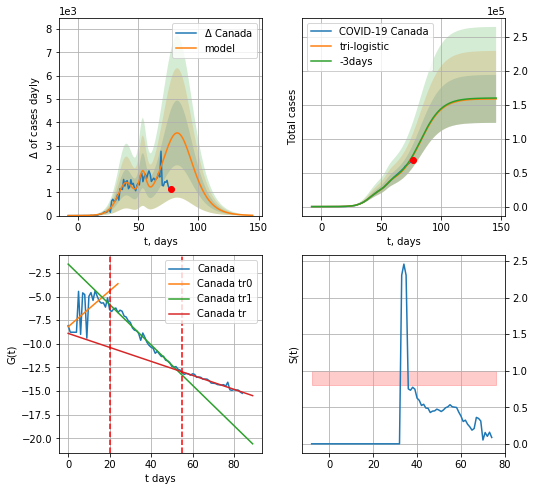

Canada data at: 2020-05-10
+3 day model MAPE: 0.015368551268817303
model: tri-logistic
coeffs:  [9.57836694e+03 5.00918650e-01 5.43159878e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22263503568273033
forecast at the end of period: +69 days
	 deltaDaycases:  11
	 total cases:  158835 ± 35362
	 total death:  11235 ± 7503
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.955183
 intercept: -8.899658
 slope: -0.073952


In [178]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
81 2020-05-06  63496.0   31093  4232.0
82 2020-05-07  64922.0   31542  4408.0
83 2020-05-08  66434.0   31459  4569.0
84 2020-05-09  67702.0   31760  4693.0
85 2020-05-10  68848.0   31882  4870.0


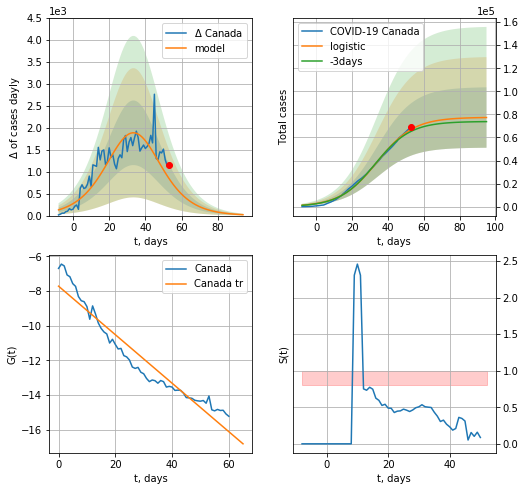

Canada data at: 2020-05-10
+3 day model MAPE: 0.02665579307659332
model: logistic
coeffs:  [7.74887680e+04 9.72766898e-02 3.38911434e+01]
rational stdev:  0.33874276871058245
forecast at the end of period: +42 days
	 deltaDaycases:  20
	 total cases:  77286 ± 26180
	 total death:  5466 ± 5554
trend coefficient of determination: 0.928849
 intercept: -7.719951
 slope: -0.140081


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


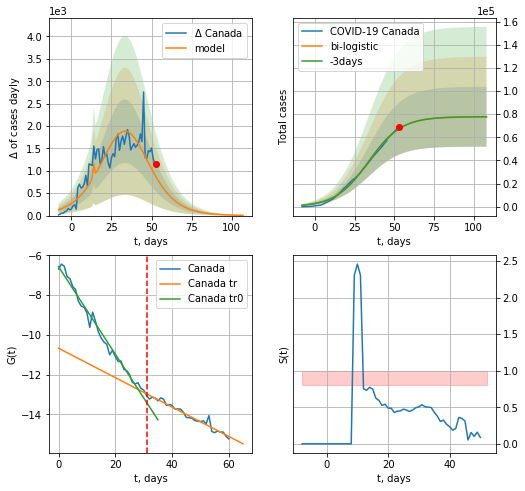

Canada data at: 2020-05-10
+3 day model MAPE: 0.0014650740846868832
model: bi-logistic
coeffs:  [379.62842847   4.00763994  14.35895609] [7.74887680e+04 9.72766898e-02 3.38911434e+01]
rational stdev:  0.33256350665600604
forecast at the end of period: +55 days
	 deltaDaycases:  5
	 total cases:  77811 ± 25877
	 total death:  5504 ± 5491
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.955183
 intercept: -10.674513
 slope: -0.073952


In [179]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

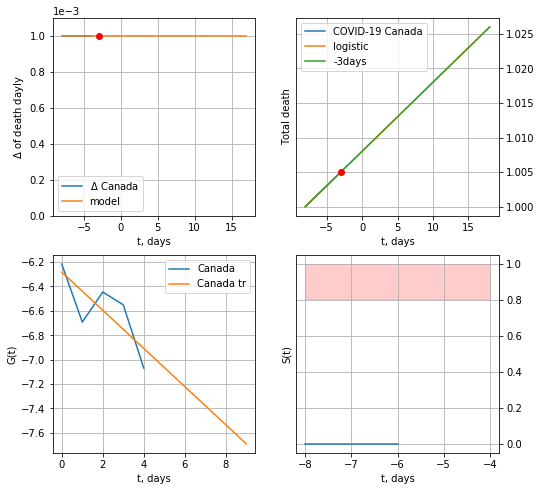

Canada data at: 2020-05-10
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


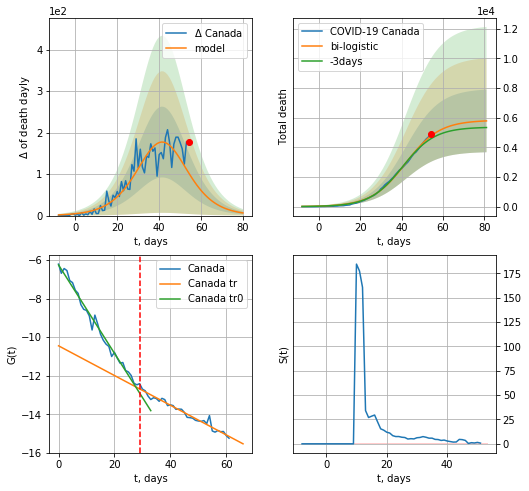

Canada data at: 2020-05-10
+3 day model MAPE: 0.042695888635657916
model: bi-logistic
coeffs:  [5.82428516e+03 1.21794637e-01 4.19157239e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.36558878927000416
forecast at the end of period: +27 days
	 deltaDaydeath:  6
	 total death:  5775 ± 2111
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.962900
 intercept: -10.449515
 slope: -0.076920


In [180]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


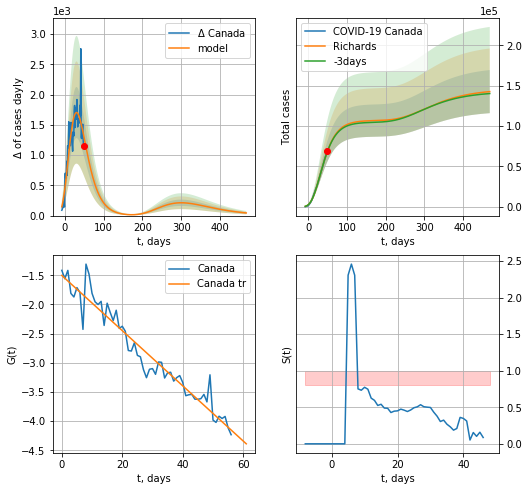

Canada data at: 2020-05-10
+3 day model MAPE: 0.005324
model: Richards
coeffs: [ 1.07078231e+05  3.50860928e+00 -7.03671613e+01  1.24108988e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.187180
forecast at the end of period: +420 days
	 deltaDaycases: 43
	 total cases: 142835 ± 26735
	 total death: 10103 ± 5673
trend coefficient of determination: 0.935289
 intercept: -1.503217
 slope: -0.047323


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


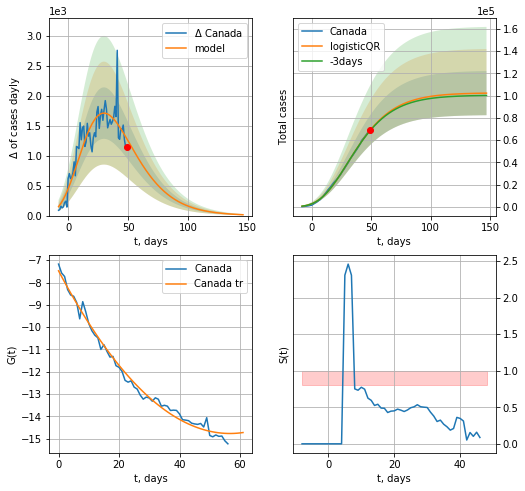

Canada data at: 2020-05-10
+3 day model MAPE: 0.0062969400697273775
model: logisticQR
coeffs:  [ 1.02379744e+05  1.00623262e-02 -1.08054622e+02 -7.89356357e+02
  4.73061666e-03]
rational stdev:  0.1940762655535093
forecast at the end of period: +98 days
	 deltaDaycases:  14
	 total cases:  102129 ± 19820
	 total death:  7224 ± 4206
trend coefficient of determination: 0.989599
 intercept_: -7.476472913225786
 coeffs_: [ 0.         -0.25743244  0.00227088]


In [181]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


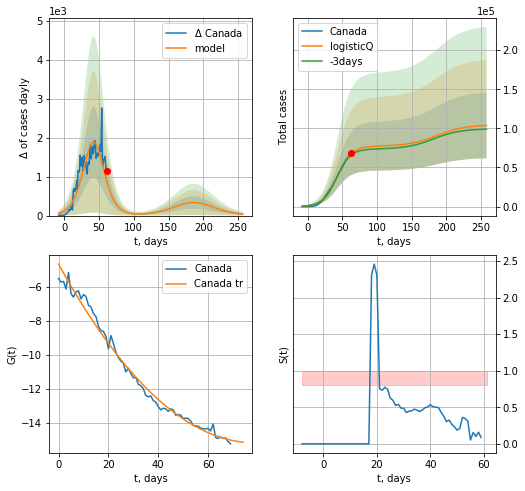

Canada data at: 2020-05-10
+3 day model MAPE: 0.027275
model: logisticQ
coeffs: [ 7.71357614e+04  1.20292922e-06  4.27768441e+01 -8.13941708e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405025
forecast at the end of period: +196 days
	 deltaDaycases: 38
	 total cases: 103673 ± 41990
	 total death: 7333 ± 8910
trend coefficient of determination: 0.987355
 intercept_: -4.648773653111215
 coeffs_: [ 0.         -0.26707924  0.00169376]


In [182]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
65 2020-05-06  26182   23017  1089.0
66 2020-05-07  26715   23352  1105.0
67 2020-05-08  27268   23732  1114.0
68 2020-05-09  27406   23781  1126.0
69 2020-05-10  27581   23897  1135.0


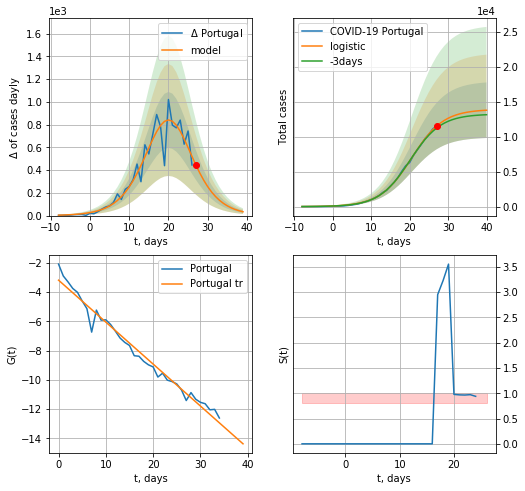

Portugal data at: 2020-05-10
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +13 days
	 deltaDaycases:  33
	 total cases:  13818 ± 3980
	 total death:  568 ± 490
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


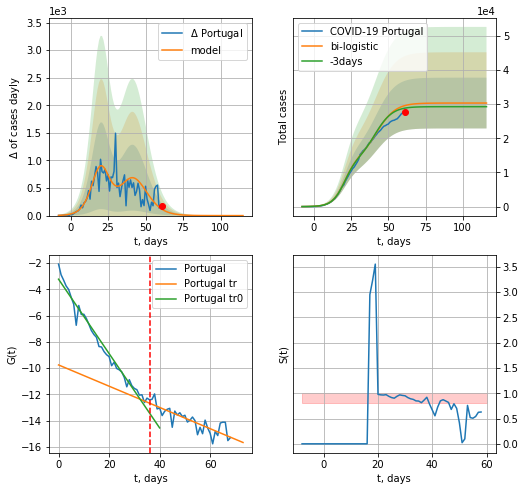

Portugal data at: 2020-05-10
+3 day model MAPE: 0.027230303955570738
model: bi-logistic
coeffs:  [1.30857050e+04 1.75928724e-01 4.11238461e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.24507599369410896
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  30300 ± 7425
	 total death:  1246 ± 916
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.705571
 intercept: -9.752268
 slope: -0.080823


In [183]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


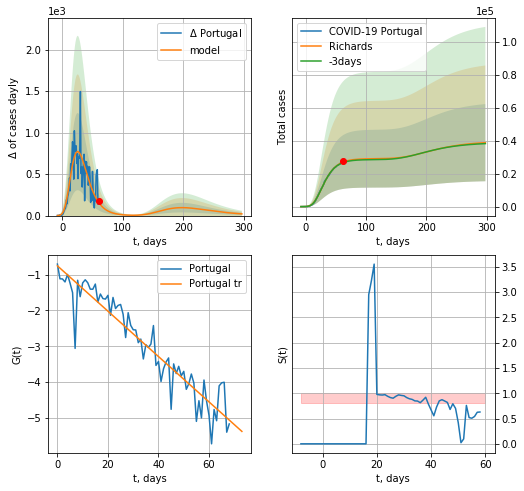

Portugal data at: 2020-05-10
+3 day model MAPE: 0.012464
model: Richards
coeffs: [ 2.91718132e+04  7.12843652e+00 -3.76309298e+01  1.01280038e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.603364
forecast at the end of period: +237 days
	 deltaDaycases: 20
	 total cases: 38872 ± 23454
	 total death: 1599 ± 2894
trend coefficient of determination: 0.884939
 intercept: -0.755688
 slope: -0.063248


In [184]:
x = forecastRR('Portugal',dfPT[:],d1,40*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


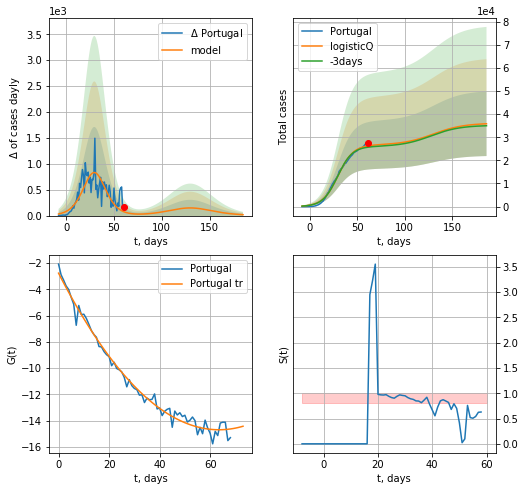

Portugal data at: 2020-05-10
+3 day model MAPE: 0.022654
model: logisticQ
coeffs: [ 2.66560221e+04  8.97629326e-07  2.98626742e+01 -1.38907039e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389701
forecast at the end of period: +125 days
	 deltaDaycases: 17
	 total cases: 35820 ± 13959
	 total death: 1474 ± 1723
trend coefficient of determination: 0.985916
 intercept_: -2.768050254810431
 coeffs_: [ 0.         -0.37537388  0.00295611]


In [185]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

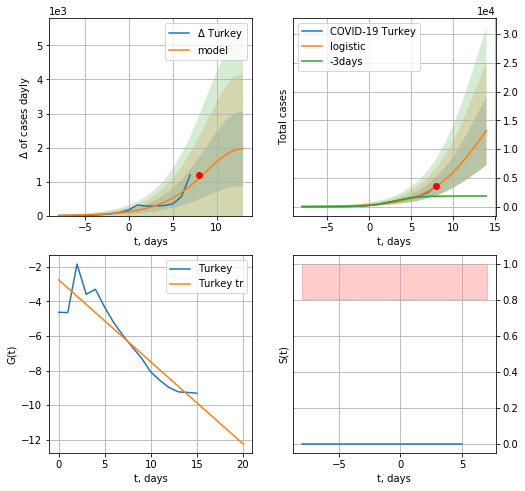

Turkey data at: 2020-05-10
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +6 days
	 deltaDaycases:  1970
	 total cases:  13211 ± 6013
	 total death:  360 ± 491
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


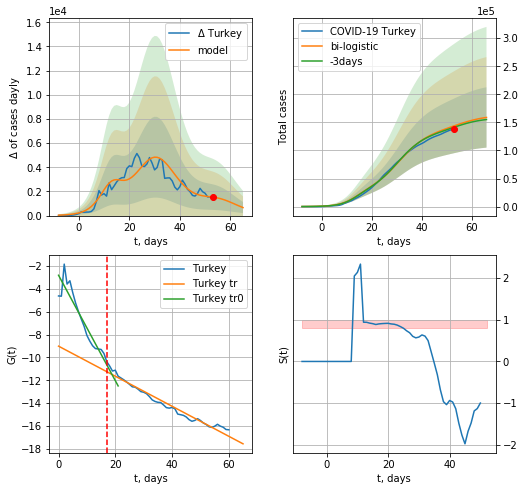

Turkey data at: 2020-05-10
+3 day model MAPE: 0.01749550949035352
model: bi-logistic
coeffs:  [1.10994159e+05 1.71019636e-01 3.08250005e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.33845467098813137
forecast at the end of period: +13 days
	 deltaDaycases:  664
	 total cases:  158797 ± 53745
	 total death:  4335 ± 4401
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.963580
 intercept: -9.018193
 slope: -0.131504


In [186]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


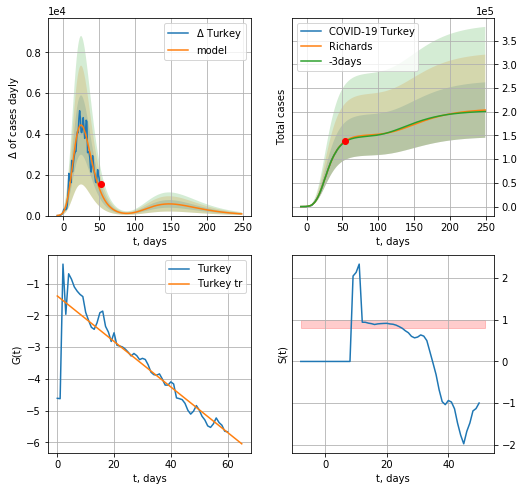

Turkey data at: 2020-05-10
+3 day model MAPE: 0.009269
model: Richards
coeffs: [ 1.51665356e+05  8.44566811e-01 -2.26319928e+00  9.88434921e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.287004
forecast at the end of period: +196 days
	 deltaDaycases: 83
	 total cases: 203652 ± 58448
	 total death: 5560 ± 4787
trend coefficient of determination: 0.781247
 intercept: -1.391033
 slope: -0.071672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


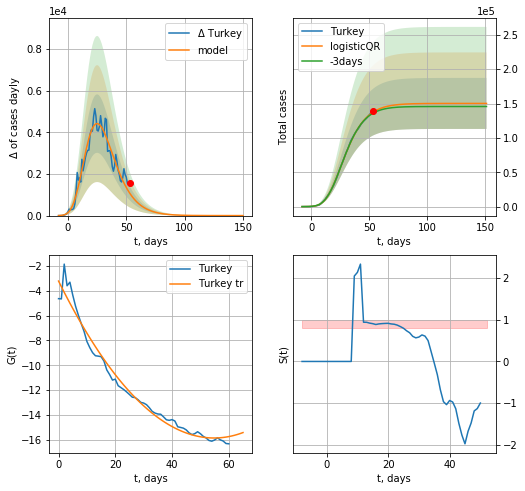

Turkey data at: 2020-05-10
+3 day model MAPE: 0.011667162193436728
model: logisticQR
coeffs:  [ 1.50154944e+05  1.62428357e-02 -4.10063387e+01 -3.66768660e+02
  1.08153343e-02]
rational stdev:  0.24721609793761648
forecast at the end of period: +98 days
	 deltaDaycases:  0
	 total cases:  150154 ± 37120
	 total death:  4099 ± 3040
trend coefficient of determination: 0.977258
 intercept_: -3.206588445992443
 coeffs_: [ 0.         -0.46218176  0.00421726]


In [187]:
x = forecastRR('Turkey',dfTR[:],d1,28*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


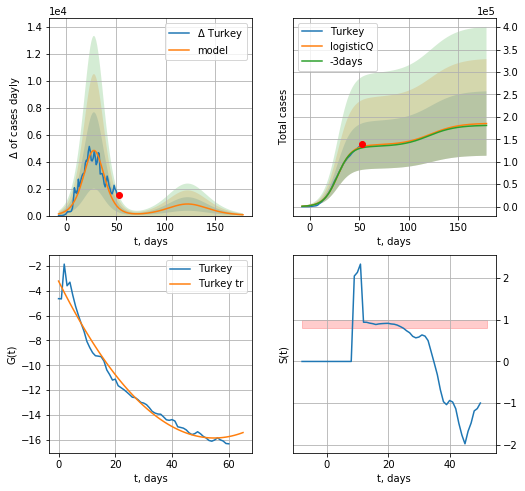

Turkey data at: 2020-05-10
+3 day model MAPE: 0.020280
model: logisticQ
coeffs: [ 1.37317165e+05  1.78824889e-06  2.81320849e+01 -7.88497561e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387705
forecast at the end of period: +126 days
	 deltaDaycases: 63
	 total cases: 185076 ± 71755
	 total death: 5053 ± 5877
trend coefficient of determination: 0.977258
 intercept_: -3.206588445992443
 coeffs_: [ 0.         -0.46218176  0.00421726]


In [188]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [189]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.019169329073482427

In [190]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

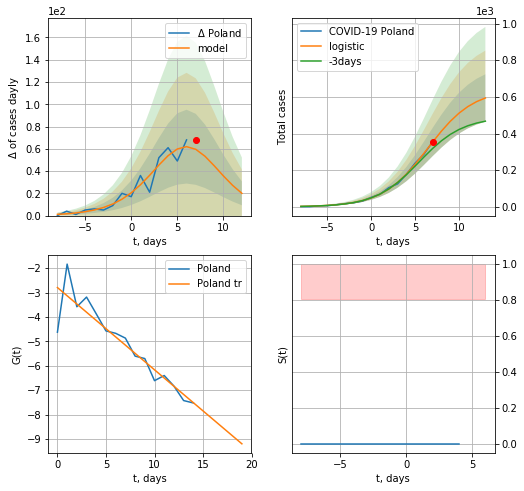

Poland data at: 2020-05-10
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  593 ± 129
	 total death:  29 ± 18
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


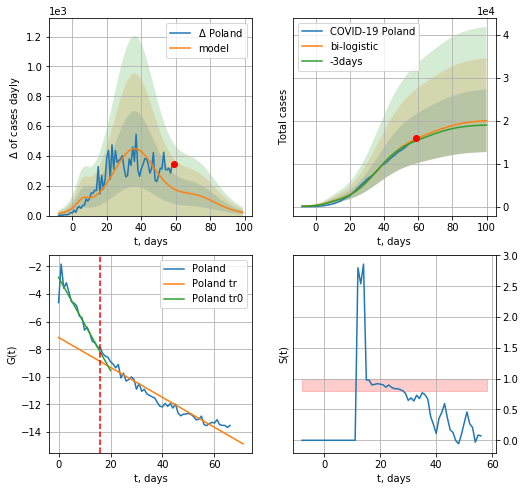

Poland data at: 2020-05-10
+3 day model MAPE: 0.030282318315406717
model: bi-logistic
coeffs:  [1.56266952e+04 1.12869587e-01 3.63893445e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.364261634904504
forecast at the end of period: +41 days
	 deltaDaycases:  21
	 total cases:  19989 ± 7281
	 total death:  999 ± 1091
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.933702
 intercept: -7.147285
 slope: -0.108465


In [191]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


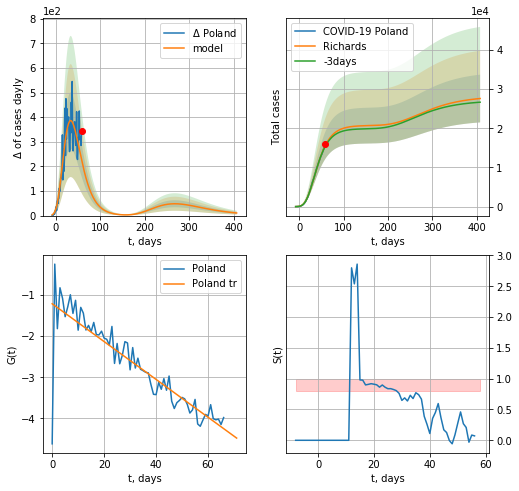

Poland data at: 2020-05-10
+3 day model MAPE: 0.014893
model: Richards
coeffs: [ 2.07058271e+04  3.51344715e+00 -4.87416058e+01  1.45329689e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.220817
forecast at the end of period: +349 days
	 deltaDaycases: 10
	 total cases: 27582 ± 6090
	 total death: 1379 ± 913
trend coefficient of determination: 0.760530
 intercept: -1.212473
 slope: -0.045963


In [192]:
x =  forecastRR('Poland',dfPL[:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


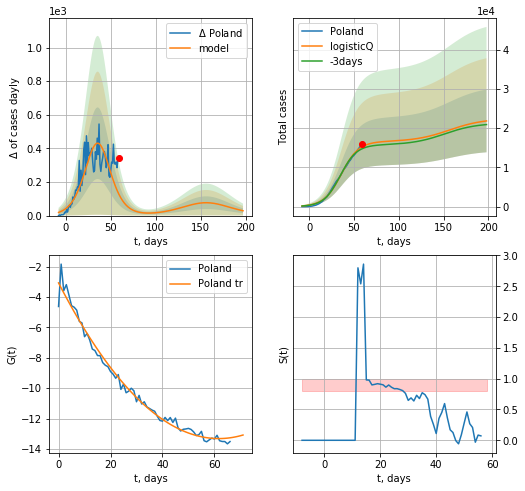

Poland data at: 2020-05-10
+3 day model MAPE: 0.034470
model: logisticQ
coeffs: [ 1.65775142e+04  1.17446367e-06  3.58933939e+01 -8.83986353e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365858
forecast at the end of period: +139 days
	 deltaDaycases: 28
	 total cases: 21847 ± 7993
	 total death: 1092 ± 1198
trend coefficient of determination: 0.984907
 intercept_: -3.0724867349704894
 coeffs_: [ 0.         -0.33229955  0.00269408]


In [193]:
x =  forecastRRR('Poland',dfPL[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
74 2020-05-06  16310.0    5434  239.0
75 2020-05-07  16381.0    5268  240.0
76 2020-05-08  16436.0    4962  245.0
77 2020-05-09  16454.0    4831  247.0
78 2020-05-10  16477.0    4795  252.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


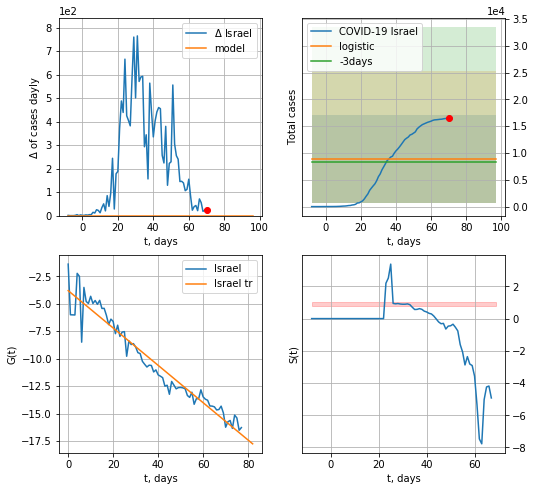

Israel data at: 2020-05-10
+3 day model MAPE: 0.05490088917830893
model: logistic
coeffs:  [ 7.09773504e+03 -3.58769039e+00  1.05257172e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9264245698383055
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  8872 ± 8219
	 total death:  135 ± 375
trend coefficient of determination: 0.935460
 intercept: -3.801944
 slope: -0.170244


In [194]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


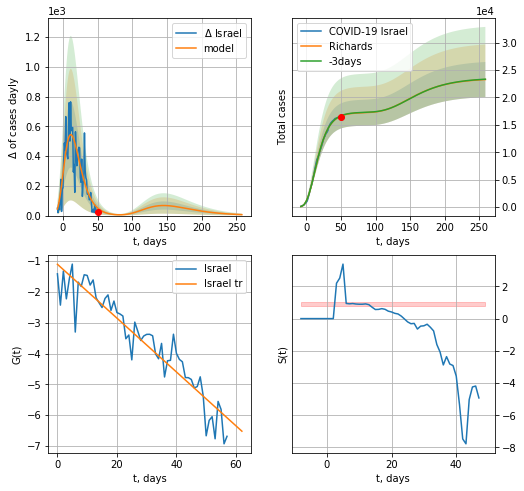

Israel data at: 2020-05-10
+3 day model MAPE: 0.002522
model: Richards
coeffs: [ 1.72384114e+04  7.40936173e+00 -3.97244065e+01  1.16675351e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.137684
forecast at the end of period: +209 days
	 deltaDaycases: 6
	 total cases: 23269 ± 3203
	 total death: 355 ± 146
trend coefficient of determination: 0.884465
 intercept: -1.101959
 slope: -0.087411


In [195]:
x = forecastRR('Israel',dfIS[20:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


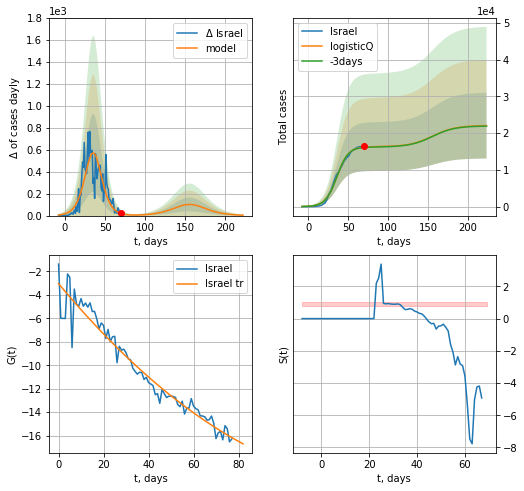

Israel data at: 2020-05-10
+3 day model MAPE: 0.005831
model: logisticQ
coeffs: [ 1.63103636e+04  9.80995793e-07  3.57158386e+01 -1.42658269e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.406388
forecast at the end of period: +153 days
	 deltaDaycases: 3
	 total cases: 22037 ± 8955
	 total death: 337 ± 410
trend coefficient of determination: 0.943245
 intercept_: -3.0508548978351175
 coeffs_: [ 0.         -0.22955247  0.00077031]


In [196]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


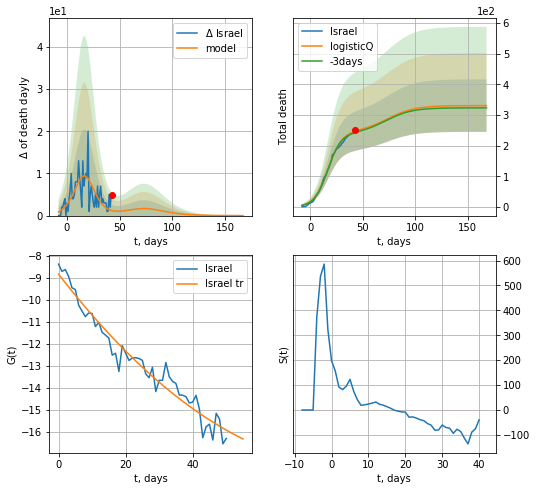

Israel data at: 2020-05-10
+3 day model MAPE: 0.017738
model: logisticQ
coeffs: [ 2.44303914e+02  2.59129697e-06  1.68721143e+01 -5.89282997e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258966
forecast at the end of period: +125 days
	 total death: 330 ± 85
trend coefficient of determination: 0.952643
 intercept_: -8.838668792231896
 coeffs_: [ 0.         -0.19617088  0.00109779]


In [197]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


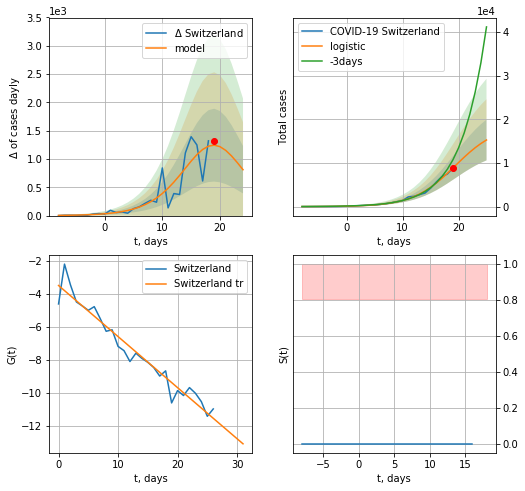

Switzerland data at: 2020-05-10
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +6 days
	 deltaDaycases:  810
	 total cases:  15272 ± 4674
	 total death:  923 ± 847
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


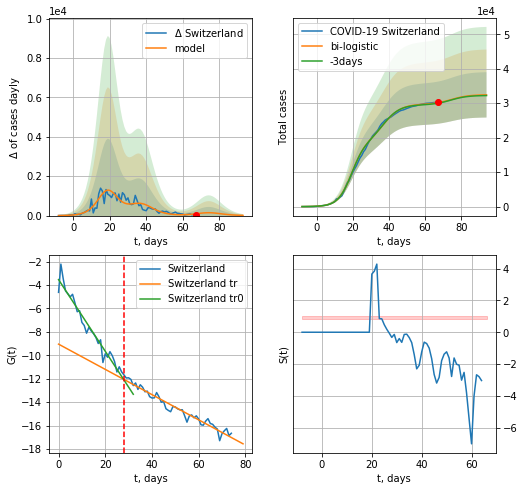

Switzerland data at: 2020-05-10
+3 day model MAPE: 0.005060800233774771
model: bi-logistic
coeffs:  [1.10125777e+04 2.11168903e-01 3.73796006e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2027000369667747
forecast at the end of period: +27 days
	 deltaDaycases:  10
	 total cases:  32425 ± 6572
	 total death:  1961 ± 1192
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.955391
 intercept: -9.044318
 slope: -0.107685


In [198]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*7-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


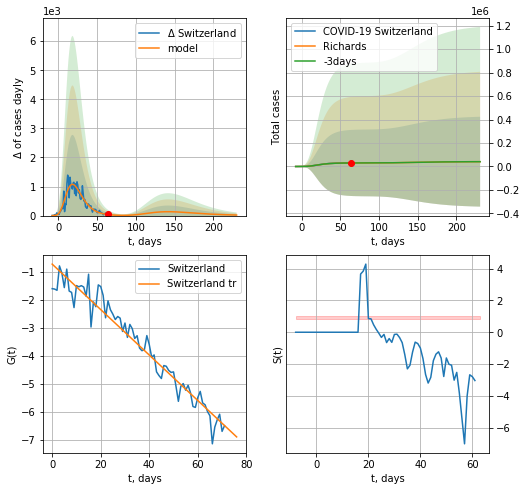

Switzerland data at: 2020-05-10
+3 day model MAPE: 0.001166
model: Richards
coeffs: [ 3.05333768e+04  6.17794003e+00 -2.44384953e+01  1.56270745e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 9.326448
forecast at the end of period: +167 days
	 deltaDaycases: 18
	 total cases: 41023 ± 382606
	 total death: 2481 ± 69416
trend coefficient of determination: 0.946532
 intercept: -0.728525
 slope: -0.081092


In [199]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*30-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


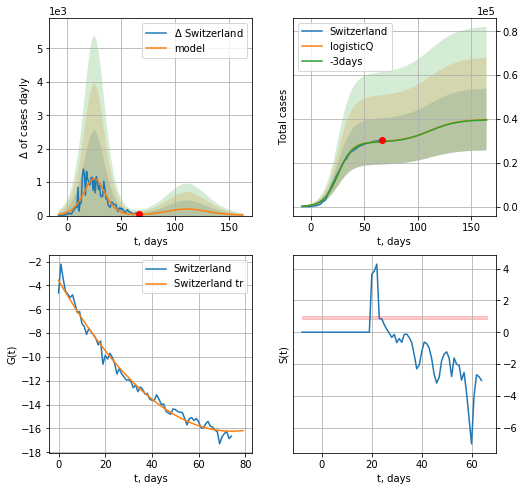

Switzerland data at: 2020-05-10
+3 day model MAPE: 0.005415
model: logisticQ
coeffs: [ 2.94989985e+04  1.00903040e-06  2.55652809e+01 -1.49034860e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354740
forecast at the end of period: +97 days
	 deltaDaycases: 14
	 total cases: 39754 ± 14102
	 total death: 2404 ± 2558
trend coefficient of determination: 0.985656
 intercept_: -3.5754480638508515
 coeffs_: [ 0.         -0.34099835  0.00229718]


In [200]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [201]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
57 2020-05-06  13691.0   10955  340.0
58 2020-05-07  14195.0   11128  361.0
59 2020-05-08  14710.0   11425  376.0
60 2020-05-09  15232.0   11781  391.0
61 2020-05-10  15232.0   11781  391.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

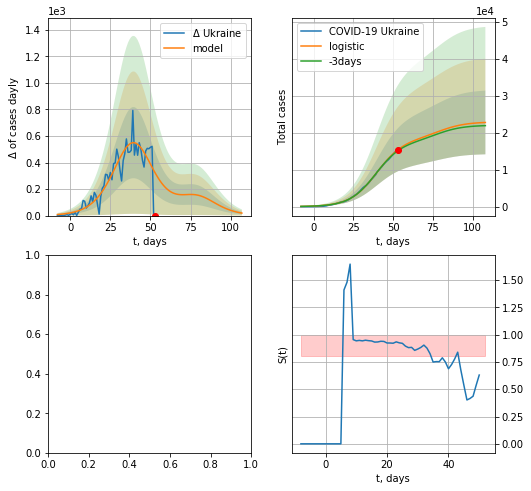

In [202]:
dfUR = read_df(pd.DataFrame(),"Ukr")
x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

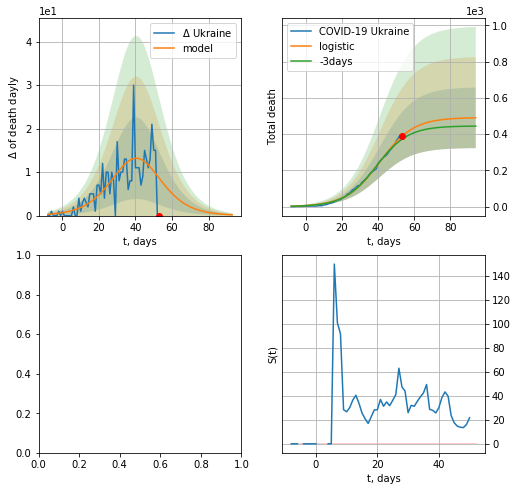

In [203]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


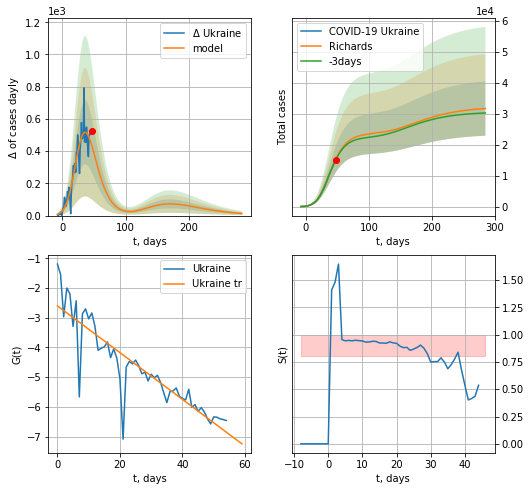

Ukraine data at: 2020-05-09
+3 day model MAPE: 0.007930
model: Richards
coeffs: [2.37027001e+04 2.14202345e-01 1.97978942e+01 3.20482818e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.277293
forecast at the end of period: +238 days
	 deltaDaycases: 13
	 total cases: 31718 ± 8795
	 total death: 810 ± 673
trend coefficient of determination: 0.786528
 intercept: -2.599520
 slope: -0.078736


In [474]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*40-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


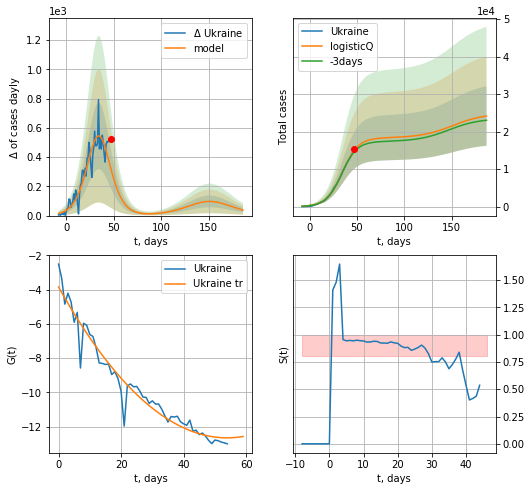

Ukraine data at: 2020-05-09
+3 day model MAPE: 0.027131
model: logisticQ
coeffs: [ 1.83414551e+04  4.46719225e-06  3.47220029e+01 -2.65831503e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327945
forecast at the end of period: +140 days
	 deltaDaycases: 37
	 total cases: 24148 ± 7919
	 total death: 617 ± 607
trend coefficient of determination: 0.947011
 intercept_: -3.8512882281401737
 coeffs_: [ 0.         -0.32667671  0.00303001]


In [387]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [74]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

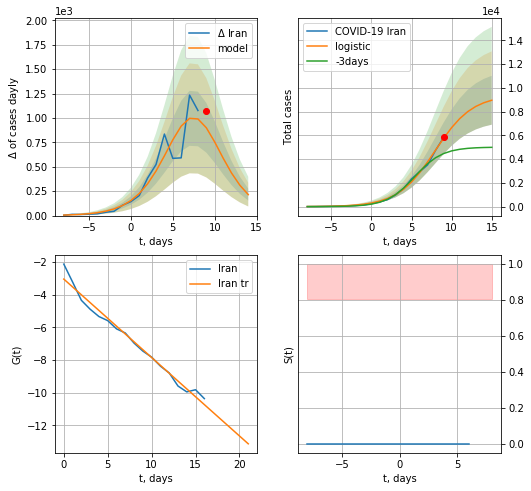

Iran data at: 2020-05-10
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +6 days
	 deltaDaycases:  214
	 total cases:  8956 ± 2057
	 total death:  552 ± 380
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


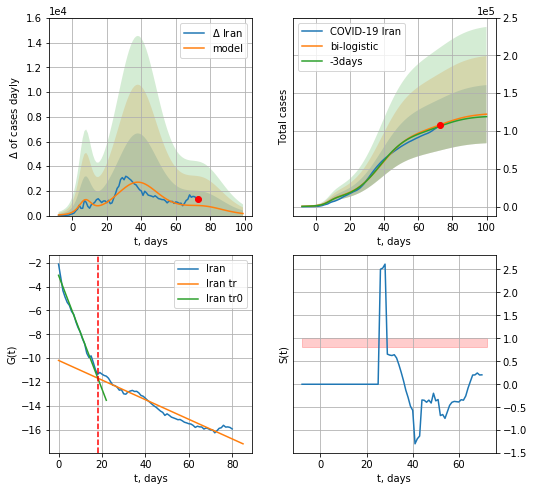

Iran data at: 2020-05-10
+3 day model MAPE: 0.01737727997366302
model: bi-logistic
coeffs:  [9.14538266e+04 1.17151615e-01 3.82932895e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3145877980609076
forecast at the end of period: +27 days
	 deltaDaycases:  168
	 total cases:  122253 ± 38459
	 total death:  7544 ± 7119
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.938598
 intercept: -10.194571
 slope: -0.082260


In [204]:
x = forecast('Iran',dfIN[:18],d1,7*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


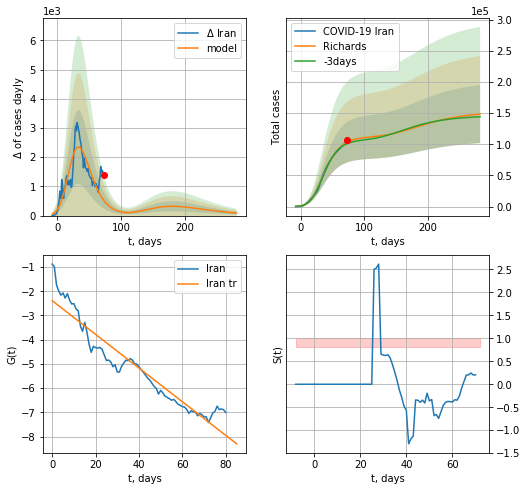

Iran data at: 2020-05-10
+3 day model MAPE: 0.022366
model: Richards
coeffs: [1.12106263e+05 2.76436962e-01 1.03577745e+01 2.29097510e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.314067
forecast at the end of period: +209 days
	 deltaDaycases: 88
	 total cases: 148459 ± 46626
	 total death: 9161 ± 8631
trend coefficient of determination: 0.908038
 intercept: -2.389808
 slope: -0.069509


In [205]:
x = forecastRR('Iran',dfIN[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


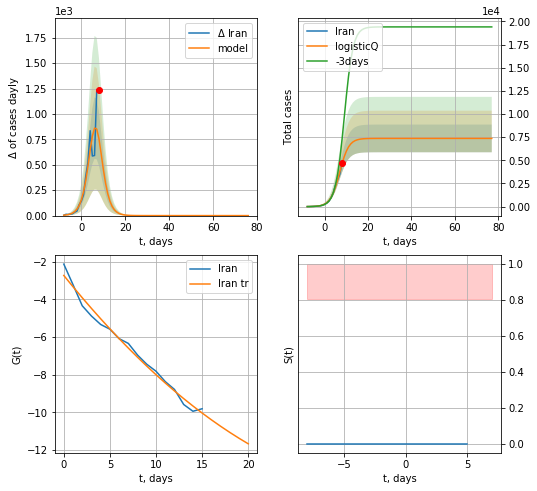

Iran data at: 2020-05-10
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 454 ± 276
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


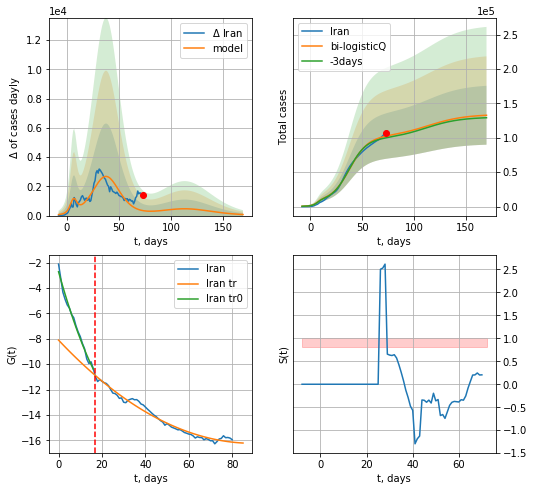

Iran data at: 2020-05-10
+3 day model MAPE: 0.025295
model: bi-logisticQ
coeffs: [ 9.38651958e+04  6.74737299e-07  3.79127390e+01 -1.67752959e+05]
S.Korea scenario coeffs: [0.35, 0.5, 3, 1]
rational stdev: 0.322361
forecast at the end of period: +97 days
	 deltaDaycases: 72
	 total cases: 132784 ± 42804
	 total death: 8193 ± 7923
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.978648
 intercept_: -8.102992959299144
 coeffs_: [ 0.         -0.18148083  0.0010137 ]


In [206]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,3,1])
xx = forecast2RRR('Iran',dfIN[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,3,1],vL=17)

RS
          date     cases  active   death
67 2020-05-06  165929.0  143065  1537.0
68 2020-05-07  177160.0  151732  1625.0
69 2020-05-08  187859.0  159528  1723.0
70 2020-05-09  198676.0  164933  1827.0
71 2020-05-10  209688.0  173467  1915.0


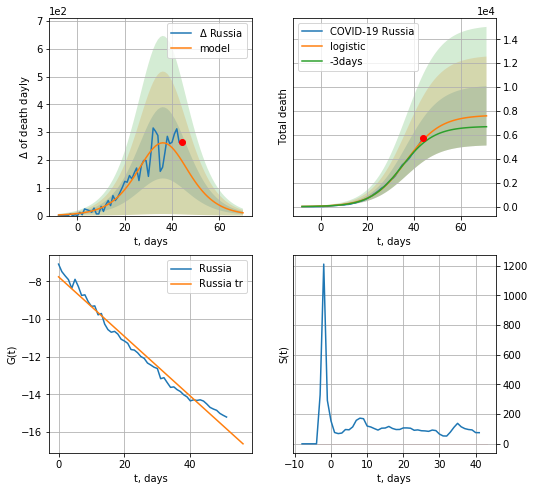

Russia data at: 2020-05-10
+3 day model MAPE: 0.05800297831727548
model: logistic
coeffs:  [7.66221612e+03 1.36682074e-01 3.66345574e+01]
rational stdev:  0.32659448247669987
forecast at the end of period: +27 days
	 total death:  7592 ± 2479
trend coefficient of determination: 0.979944
 intercept: -7.751910
 slope: -0.158379


In [207]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

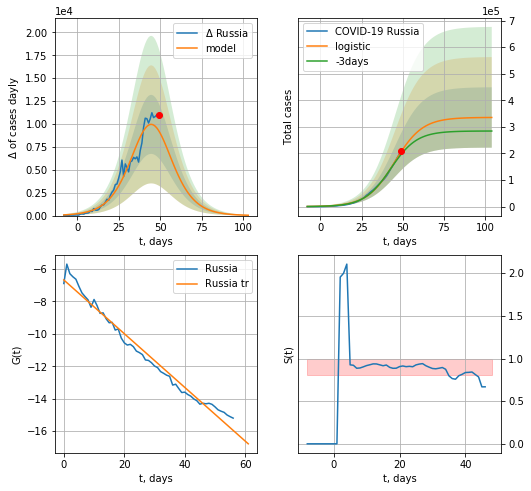

Russia data at: 2020-05-10
+3 day model MAPE: 0.055647590388071475
model: logistic
coeffs:  [3.35639989e+05 1.18772476e-01 4.50665076e+01]
rational stdev:  0.33871259392606873
forecast at the end of period: +55 days
	 deltaDaycases:  38
	 total cases:  335334 ± 113581
	 total death:  3062 ± 3111
trend coefficient of determination: 0.977702
 intercept: -6.679814
 slope: -0.165651


In [208]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


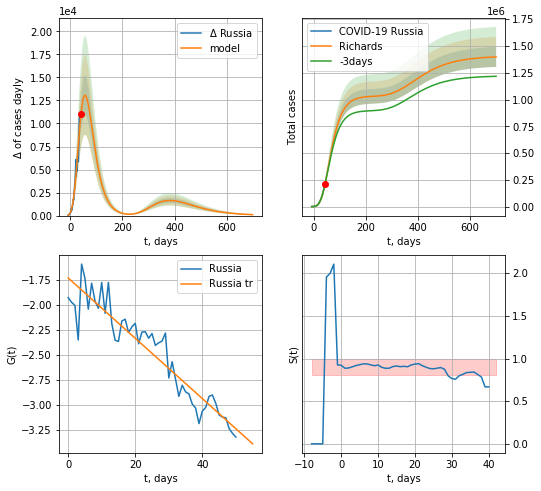

Russia data at: 2020-05-10
+3 day model MAPE: 0.015267
model: Richards
coeffs: [ 1.03225608e+06  1.13725153e+00 -4.26077034e+01  3.07135218e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.066788
forecast at the end of period: +657 days
	 deltaDaycases: 99
	 total cases: 1398003 ± 93370
	 total death: 12767 ± 2558
trend coefficient of determination: 0.879995
 intercept: -1.732965
 slope: -0.030124


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


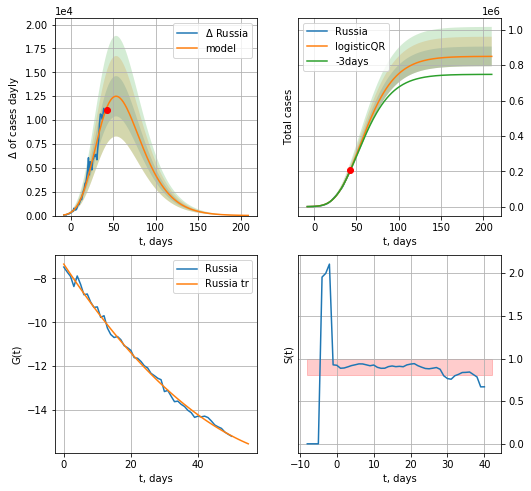

Russia data at: 2020-05-10
+3 day model MAPE: 0.01663481977019721
model: logisticQR
coeffs:  [ 8.49781238e+05  7.76653074e-03 -1.14037354e+02 -3.54776641e+02
  8.99851073e-03]
rational stdev:  0.06541274565295285
forecast at the end of period: +167 days
	 deltaDaycases:  16
	 total cases:  849517 ± 55569
	 total death:  7758 ± 1522
trend coefficient of determination: 0.996138
 intercept_: -7.3432778006704345
 coeffs_: [ 0.         -0.23274083  0.00151937]


In [209]:
x = forecastRR('Russia',dfRS[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


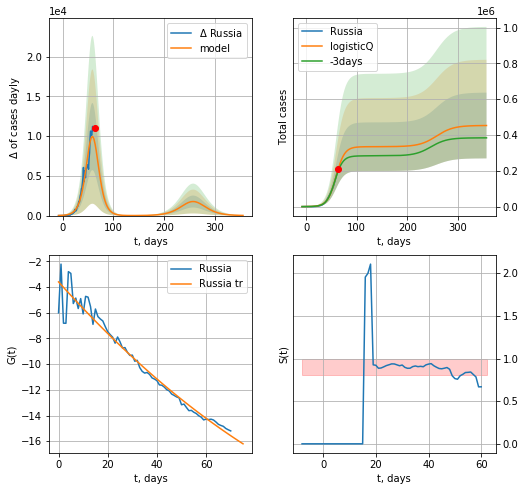

Russia data at: 2020-05-10
+3 day model MAPE: 0.055953
model: logisticQ
coeffs: [ 3.34781307e+05  4.91325088e-06  5.90223645e+01 -2.41587900e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.405366
forecast at the end of period: +293 days
	 deltaDaycases: 19
	 total cases: 453027 ± 183641
	 total death: 4137 ± 5031
trend coefficient of determination: 0.958505
 intercept_: -3.5935551745844485
 coeffs_: [ 0.         -0.2128757   0.00059641]


In [210]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

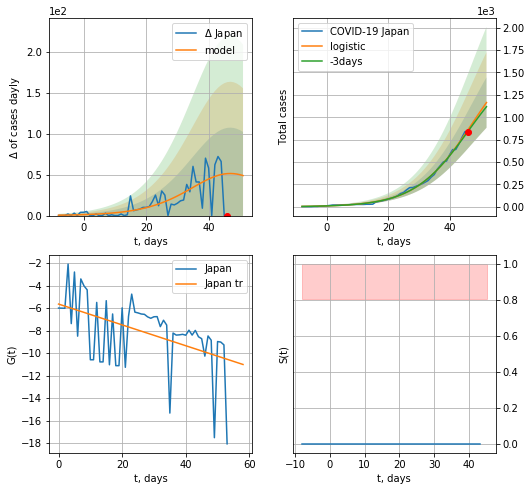

Japan data at: 2020-05-10
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +6 days
	 deltaDaycases:  48
	 total cases:  1163 ± 281
	 total death:  46 ± 33
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


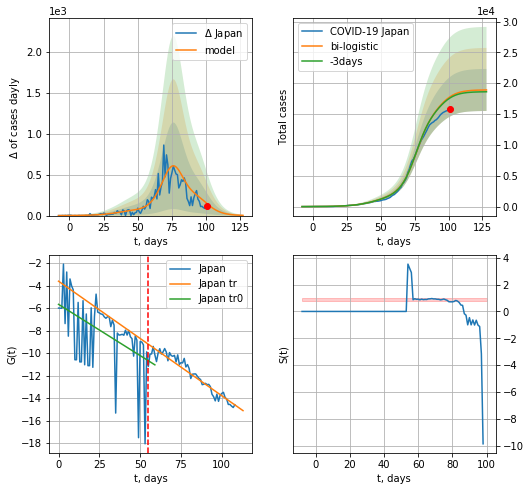

Japan data at: 2020-05-10
+3 day model MAPE: 0.011028235158314444
model: bi-logistic
coeffs:  [1.36447007e+04 1.70214233e-01 7.62052303e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.18013636215609385
forecast at the end of period: +27 days
	 deltaDaycases:  2
	 total cases:  18907 ± 3405
	 total death:  747 ± 403
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.906364
 intercept: -3.614641
 slope: -0.101814


In [211]:
x = forecast('Japan',dfJP[:55],d1,7*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

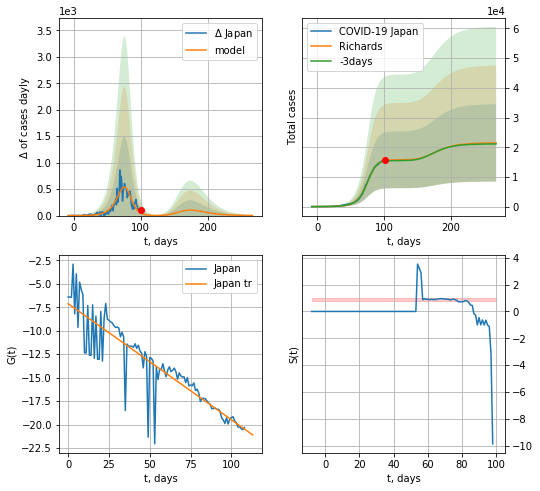

Japan data at: 2020-05-10
+3 day model MAPE: 0.013316
model: Richards
coeffs: [1.57762660e+04 1.01396663e-01 7.91888010e+01 1.58924049e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.606935
forecast at the end of period: +167 days
	 deltaDaycases: 1
	 total cases: 21460 ± 13025
	 total death: 848 ± 1544
trend coefficient of determination: 0.798742
 intercept: -7.123425
 slope: -0.123536


In [212]:
x = forecastRR('Japan',dfJP[:],d1,30*7-dT,addpred=True,xcoef=RkoreaCoeffs)

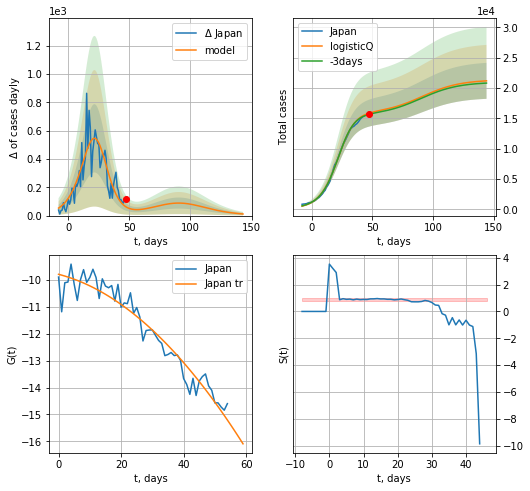

Japan data at: 2020-05-10
+3 day model MAPE: 0.012549
model: logisticQ
coeffs: [ 1.57624217e+04  6.68159174e-04  2.07723369e+01 -1.83808401e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.139875
forecast at the end of period: +97 days
	 deltaDaycases: 11
	 total cases: 21171 ± 2961
	 total death: 837 ± 351
trend coefficient of determination: 0.935817
 intercept_: -9.788763423707586
 coeffs_: [ 0.         -0.03000039 -0.00130173]


In [213]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


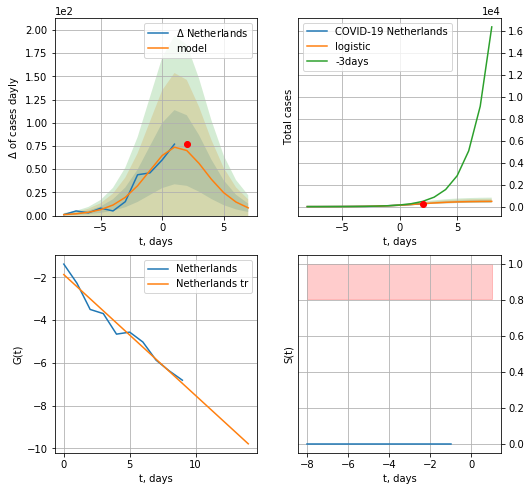

Netherlands data at: 2020-05-10
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  477 ± 113
	 total death:  60 ± 42
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


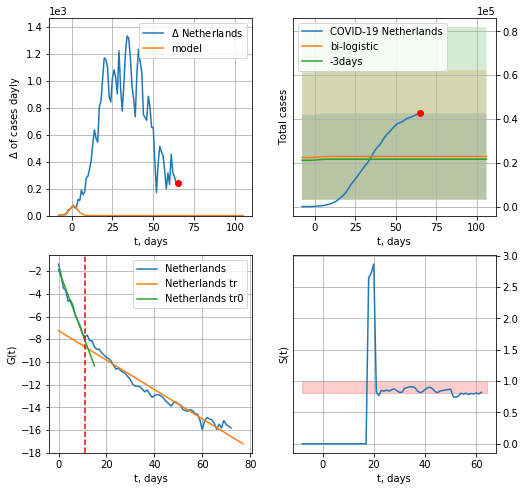

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.058532421804356104
model: bi-logistic
coeffs:  [ 1.79189691e+04 -4.03461770e+00  1.28021249e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8614539164104029
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  22886 ± 19715
	 total death:  2920 ± 7546
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.956144
 intercept: -7.249608
 slope: -0.129369


In [215]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,7*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
69 2020-05-06  41319   35865  5204.0
70 2020-05-07  41774   36236  5288.0
71 2020-05-08  42093   36484  5359.0
72 2020-05-09  42382   36710  5422.0
73 2020-05-10  42627   36937  5440.0


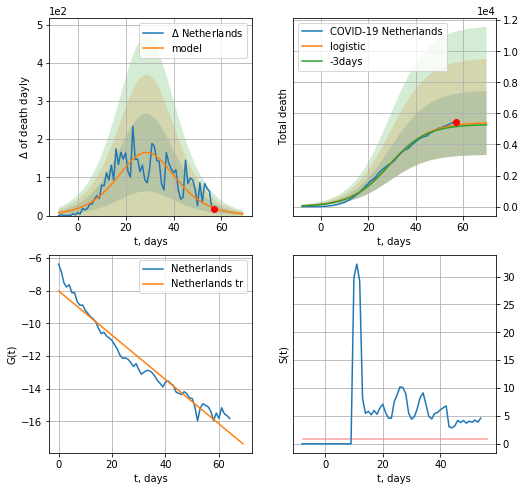

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.01936054039841194
model: logistic
coeffs:  [5.42097645e+03 1.22081423e-01 2.91757209e+01]
rational stdev:  0.3827540664306573
forecast at the end of period: +13 days
	 total death:  5384 ± 2060
trend coefficient of determination: 0.951788
 intercept: -8.017230
 slope: -0.135546


In [216]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


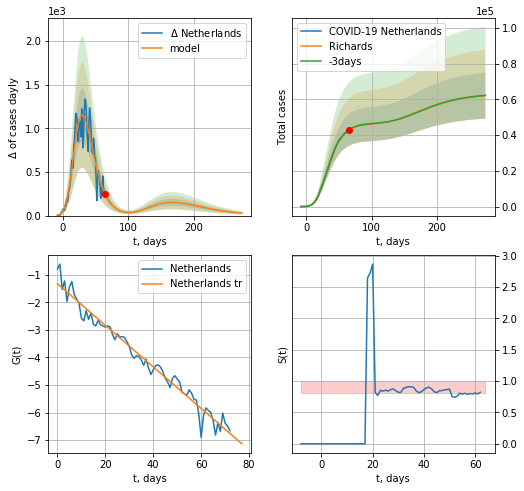

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.003155
model: Richards
coeffs: [4.64322688e+04 5.12743711e-01 3.19166534e+00 1.40864629e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.206745
forecast at the end of period: +209 days
	 deltaDaycases: 27
	 total cases: 62097 ± 12838
	 total death: 7924 ± 4914
trend coefficient of determination: 0.970574
 intercept: -1.323774
 slope: -0.075446


In [217]:
x = forecastRR('Netherlands',dfNL[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


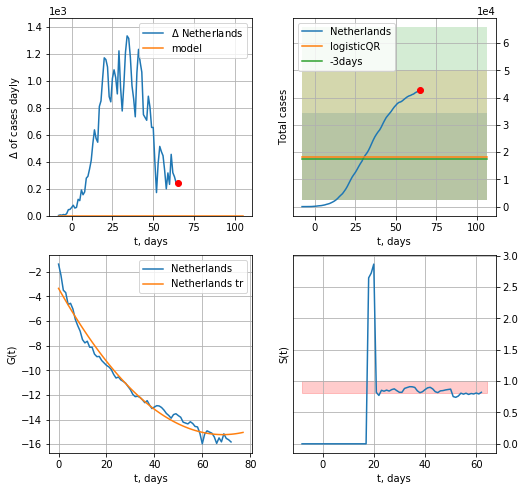

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.058604682996746246
model: logisticQR
coeffs:  [ 1.83392973e+04  6.32328905e+00 -1.29774532e+03  1.11856220e+03
 -2.55294003e+00]
rational stdev:  0.864640103625641
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  18339 ± 15856
	 total death:  2340 ± 6069
trend coefficient of determination: 0.980383
 intercept_: -3.3551004286849917
 coeffs_: [ 0.         -0.34617134  0.00252398]


In [218]:
x = forecastQR('Netherlands',dfNL[:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


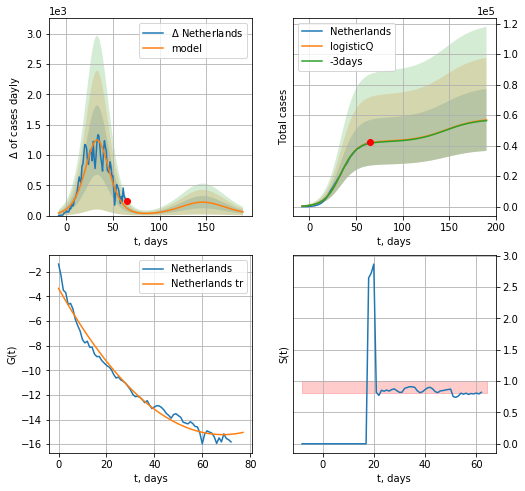

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.008022
model: logisticQ
coeffs: [ 4.27947140e+04  1.26233678e-06  3.35925070e+01 -9.21601855e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357707
forecast at the end of period: +125 days
	 deltaDaycases: 61
	 total cases: 56854 ± 20337
	 total death: 7255 ± 7785
trend coefficient of determination: 0.980383
 intercept_: -3.3551004286849917
 coeffs_: [ 0.         -0.34617134  0.00252398]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:207: RuntimeWarning: invalid value encountered in true_divide


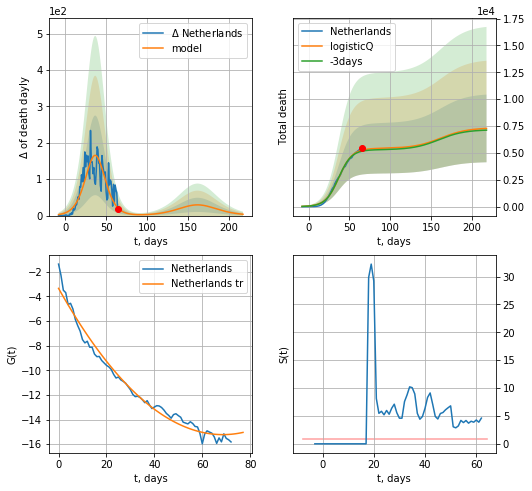

Netherlands data at: 2020-05-10
+3 day model MAPE: 0.019459
model: logisticQ
coeffs: [ 5.41756198e+03  1.06793006e-06  3.71630506e+01 -1.14474819e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.432811
forecast at the end of period: +153 days
	 total death: 7277 ± 3149
trend coefficient of determination: 0.980383
 intercept_: -3.3551004286849917
 coeffs_: [ 0.         -0.34617134  0.00252398]


In [219]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [220]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


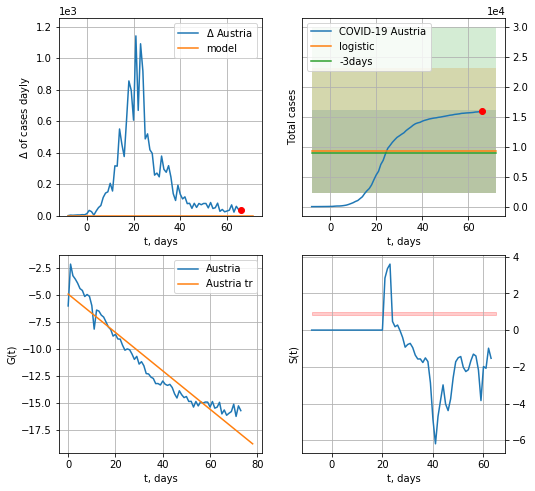

Austria data at: 2020-05-10
+3 day model MAPE: 0.03537773184220697
model: logistic
coeffs:  [ 8.69534680e+03 -2.97427948e+00  1.09523344e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7466317237398687
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  9238 ± 6897
	 total death:  359 ± 804
trend coefficient of determination: 0.918073
 intercept: -4.903640
 slope: -0.177924


In [221]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


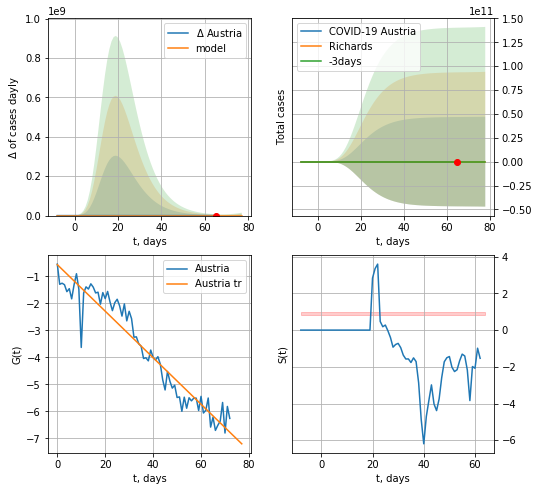

Austria data at: 2020-05-10
+3 day model MAPE: 0.002726
model: Richards
coeffs: [ 1.55490324e+04  5.66556926e+00 -9.49859115e+00  2.30663823e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 3014456.286908
forecast at the end of period: +13 days
	 deltaDaycases: 12
	 total cases: 15601 ± 47030389731
	 total death: 607 ± 5489324898
trend coefficient of determination: 0.922500
 intercept: -0.571205
 slope: -0.086054


In [222]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


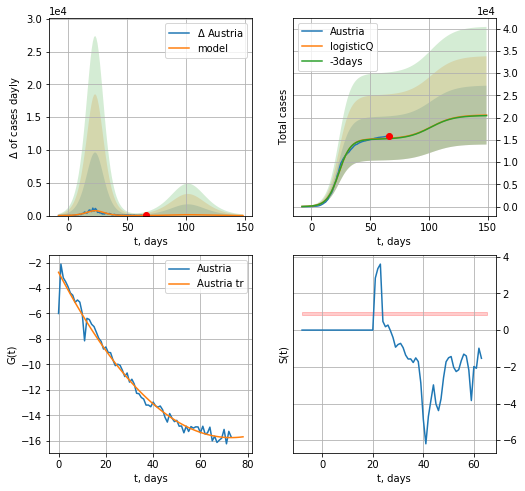

Austria data at: 2020-05-10
+3 day model MAPE: 0.006014
model: logisticQ
coeffs: [ 1.52194572e+04  1.16768538e-06  2.33659310e+01 -1.69475412e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321317
forecast at the end of period: +83 days
	 deltaDaycases: 5
	 total cases: 20560 ± 6606
	 total death: 800 ± 771
trend coefficient of determination: 0.981215
 intercept_: -2.765797139360071
 coeffs_: [ 0.         -0.35609894  0.0024409 ]


In [223]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


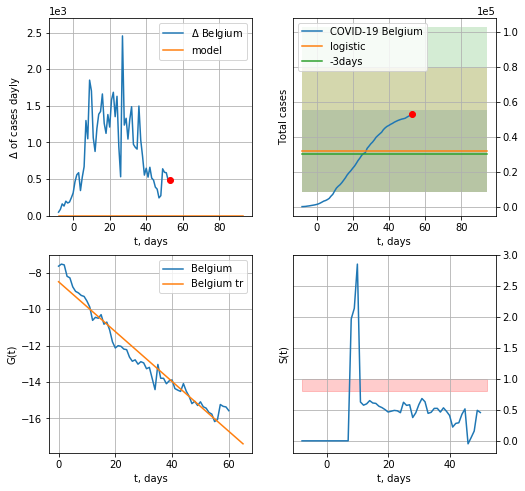

Belgium data at: 2020-05-10
+3 day model MAPE: 0.05630502175562503
model: logistic
coeffs:  [ 2.56615161e+04 -5.34998723e+00  1.97135927e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7372970577993644
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  32076 ± 23650
	 total death:  5230 ± 11568
trend coefficient of determination: 0.948849
 intercept: -8.501724
 slope: -0.136760


In [224]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
66 2020-05-06  50781   29711  8339.0
67 2020-05-07  51420   30025  8415.0
68 2020-05-08  52011   30289  8521.0
69 2020-05-09  52596   30604  8581.0
70 2020-05-10  53081   30783  8656.0


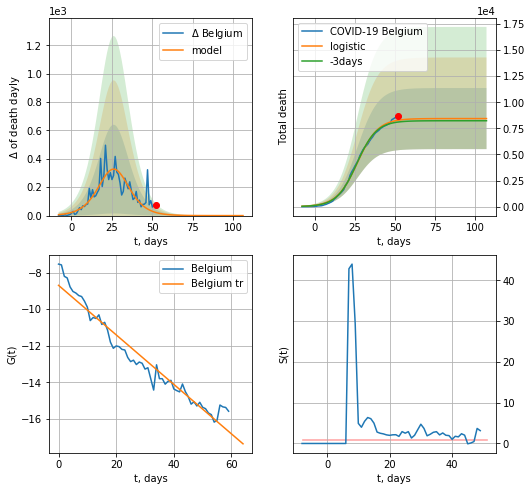

Belgium data at: 2020-05-10
+3 day model MAPE: 0.02183504315723387
model: logistic
coeffs:  [8.43787596e+03 1.55482433e-01 2.65452361e+01]
rational stdev:  0.3469243648930306
forecast at the end of period: +55 days
	 total death:  8437 ± 2927
trend coefficient of determination: 0.947412
 intercept: -8.695356
 slope: -0.135314


In [225]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


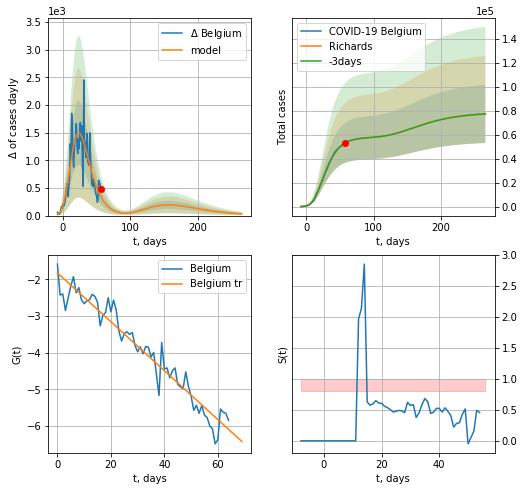

Belgium data at: 2020-05-10
+3 day model MAPE: 0.000795
model: Richards
coeffs: [ 5.77420184e+04  6.98478584e-01 -6.28998716e+00  1.06112827e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.313264
forecast at the end of period: +209 days
	 deltaDaycases: 31
	 total cases: 77394 ± 24244
	 total death: 12620 ± 11860
trend coefficient of determination: 0.936365
 intercept: -1.819160
 slope: -0.066790


In [226]:
x = forecastRR('Belgium',dfBG[5:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


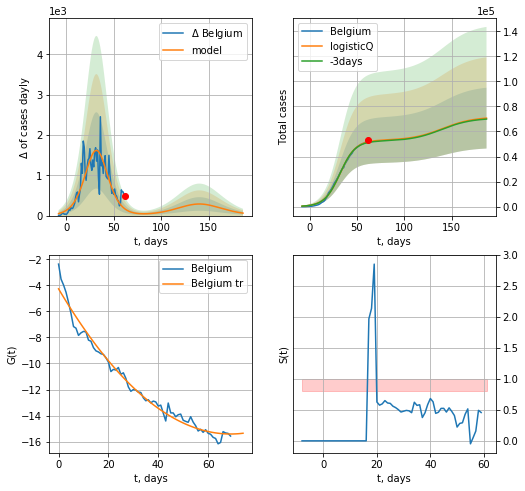

Belgium data at: 2020-05-10
+3 day model MAPE: 0.010469
model: logisticQ
coeffs: [ 5.29353863e+04  1.38568452e-06  3.22490668e+01 -8.81680871e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343541
forecast at the end of period: +125 days
	 deltaDaycases: 60
	 total cases: 70663 ± 24275
	 total death: 11523 ± 11875
trend coefficient of determination: 0.979633
 intercept_: -4.266171609688913
 coeffs_: [ 0.         -0.32308481  0.00234021]


In [227]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

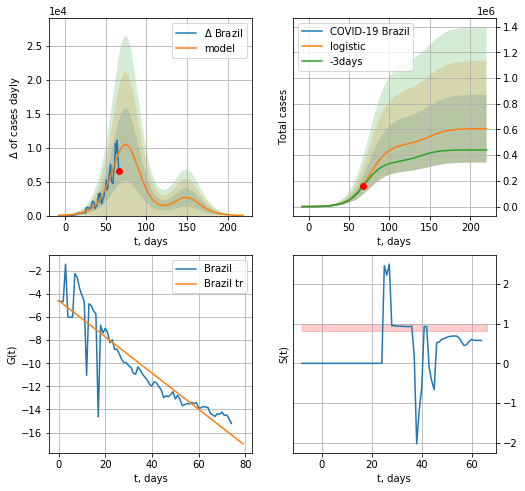

Brazil data at: 2020-05-10
+3 day model MAPE: 0.051627352265835036
model: logistic
coeffs:  [4.85314282e+05 8.62475450e-02 7.49561733e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.434673368260791
forecast at the end of period: +153 days
	 deltaDaycases:  25
	 total cases:  606354 ± 263566
	 total death:  41453 ± 54055
trend coefficient of determination: 0.836395
 intercept: -4.566836
 slope: -0.157059


In [228]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


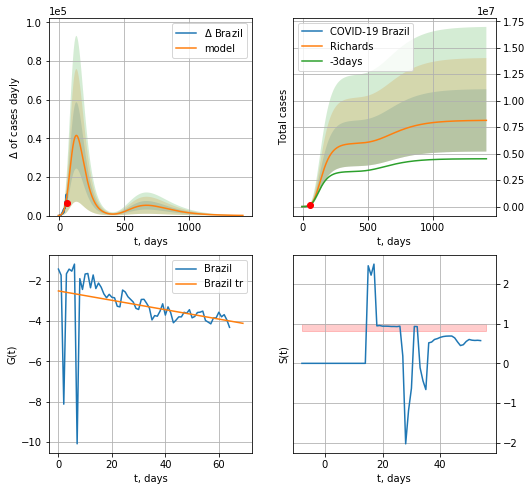

Brazil data at: 2020-05-10
+3 day model MAPE: 0.031881
model: Richards
coeffs: [5.98508397e+06 2.12384165e-01 1.01847577e+01 9.28222504e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.361357
forecast at the end of period: +1357 days
	 deltaDaycases: 98
	 total cases: 8139622 ± 2941311
	 total death: 556469 ± 603252
trend coefficient of determination: 0.107750
 intercept: -2.508231
 slope: -0.023270


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


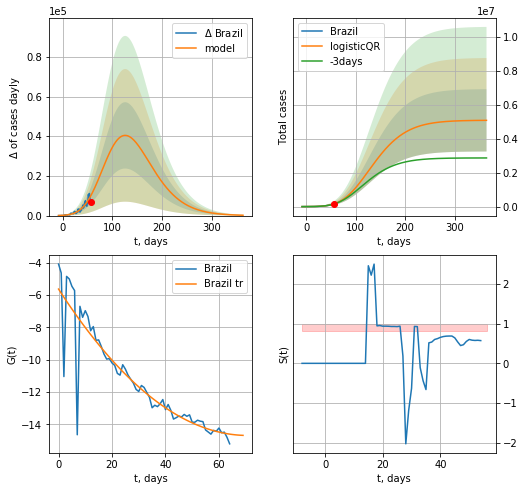

Brazil data at: 2020-05-10
+3 day model MAPE: 0.029793771832346688
model: logisticQR
coeffs:  [ 5.08341841e+06  1.80276967e-03 -2.64445950e+02 -2.64172646e+02
  1.55773060e-02]
rational stdev:  0.361047675050774
forecast at the end of period: +307 days
	 deltaDaycases:  179
	 total cases:  5078420 ± 1833551
	 total death:  347188 ± 376054
trend coefficient of determination: 0.828945
 intercept_: -5.639595175961746
 coeffs_: [ 0.         -0.25559773  0.00180623]


In [229]:
x = forecastRR('Brazil',dfBZ[10:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


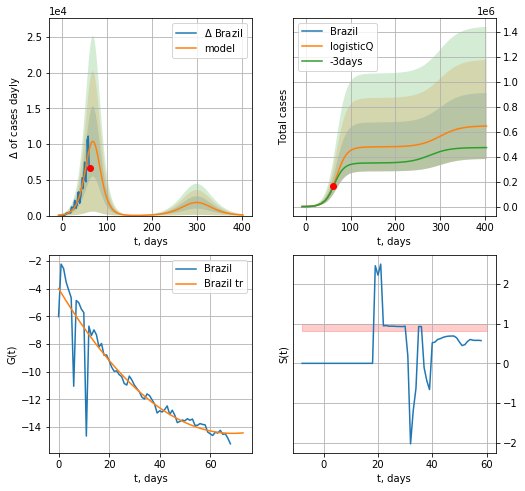

Brazil data at: 2020-05-10
+3 day model MAPE: 0.052114
model: logisticQ
coeffs: [ 4.78673290e+05  9.83430645e-06  6.86661545e+01 -8.76508568e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409781
forecast at the end of period: +342 days
	 deltaDaycases: 81
	 total cases: 646358 ± 264865
	 total death: 44188 ± 54322
trend coefficient of determination: 0.859102
 intercept_: -3.988988649315754
 coeffs_: [ 0.         -0.30311378  0.00219686]


In [230]:
x = forecastRRR('Brazil',dfBZ[6:],d1,55*7-dT,addpred=True,xcoef=koreaCoeffs)

In [231]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

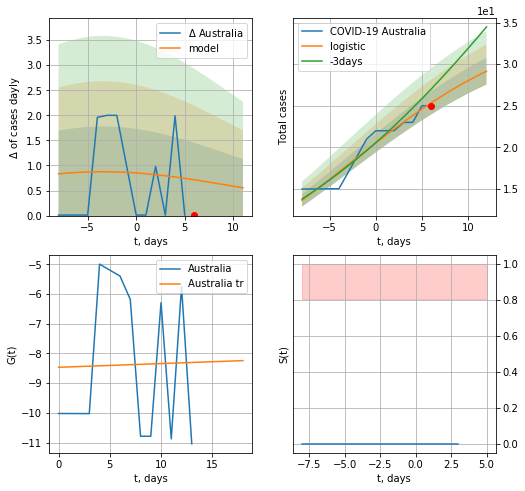

Australia data at: 2020-05-10
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


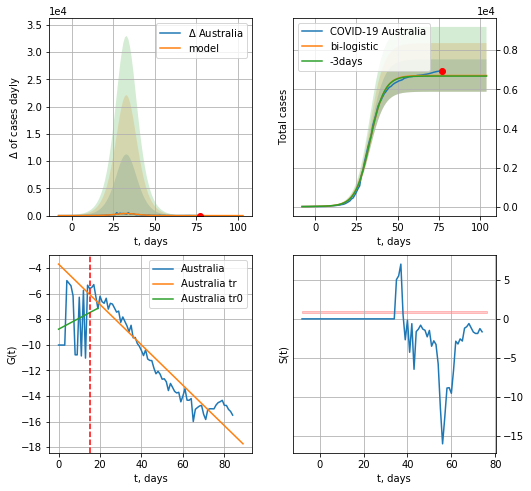

Australia data at: 2020-05-10
+3 day model MAPE: 0.004288748595875703
model: bi-logistic
coeffs:  [6.67047467e+03 2.27296100e-01 3.32875891e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.12339344942703688
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  6706 ± 827
	 total death:  93 ± 34
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.925530
 intercept: -3.705800
 slope: -0.157627


In [232]:
x = forecast('Australia',dfAS[:15],d1,7*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,10*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


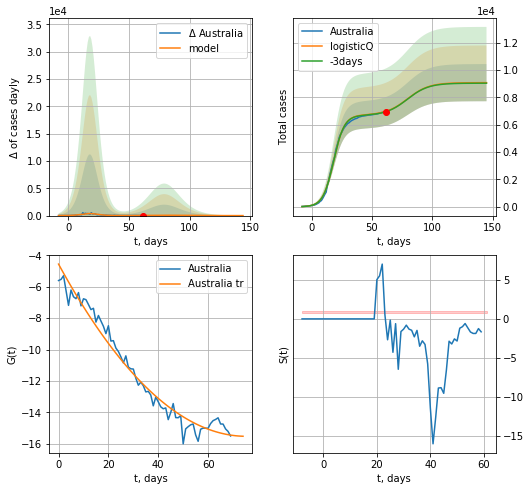

Australia data at: 2020-05-10
+3 day model MAPE: 0.003877
model: logisticQ
coeffs: [ 6.70985227e+03  2.20231643e-06  1.82330546e+01 -1.01944695e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.149669
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 9084 ± 1359
	 total death: 126 ± 56
trend coefficient of determination: 0.970817
 intercept_: -4.562999603282778
 coeffs_: [ 0.         -0.29063593  0.00192782]


In [233]:
x = forecastRRR('Australia',dfAS[15:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

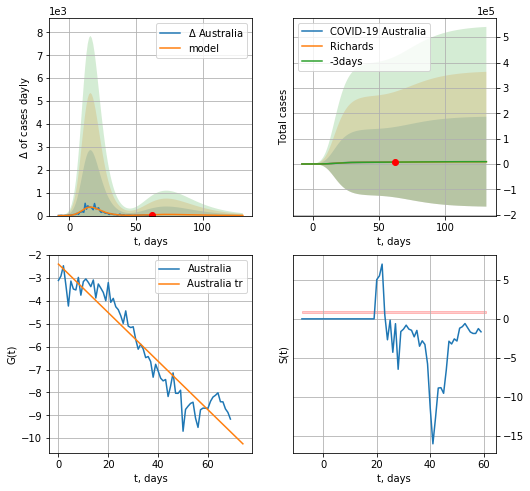

Australia data at: 2020-05-10
+3 day model MAPE: 0.006843
model: Richards
coeffs: [6.77972350e+03 5.95032187e-01 8.98118780e+00 2.84317211e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 19.350972
forecast at the end of period: +69 days
	 deltaDaycases: 5
	 total cases: 9150 ± 177078
	 total death: 127 ± 7372
trend coefficient of determination: 0.912716
 intercept: -2.389327
 slope: -0.106166


In [234]:
x = forecastRR('Australia',dfAS[15:],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)

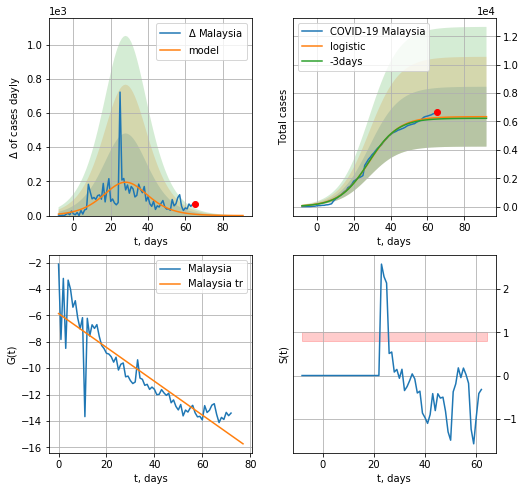

Malaysia data at: 2020-05-10
+3 day model MAPE: 0.016149664896173515
model: logistic
coeffs:  [6.34053167e+03 1.23227767e-01 2.84607838e+01]
rational stdev:  0.3328378183316032
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  6338 ± 2109
	 total death:  102 ± 101
trend coefficient of determination: 0.801061
 intercept: -5.866870
 slope: -0.128090


In [235]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


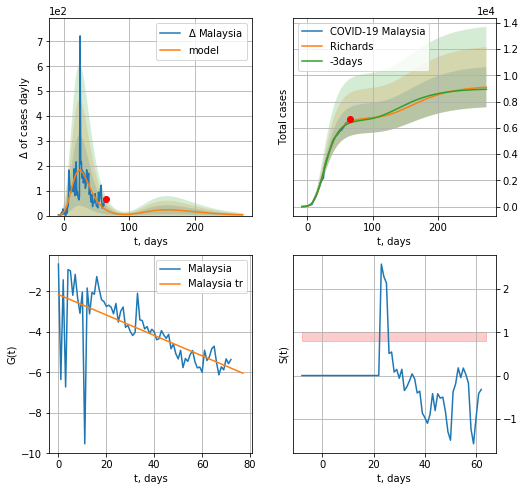

Malaysia data at: 2020-05-10
+3 day model MAPE: 0.014030
model: Richards
coeffs: [ 6.76866721e+03  8.72214576e-01 -7.28904622e+00  8.73437285e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168233
forecast at the end of period: +209 days
	 deltaDaycases: 2
	 total cases: 9105 ± 1531
	 total death: 147 ± 74
trend coefficient of determination: 0.423471
 intercept: -2.157703
 slope: -0.050469


In [237]:
x = forecastRR('Malaysia',dfML[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


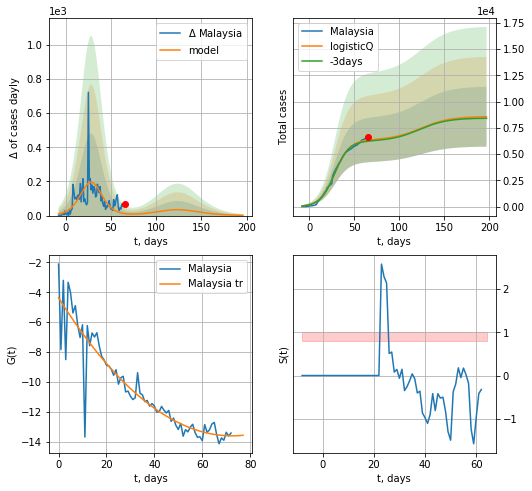

Malaysia data at: 2020-05-10
+3 day model MAPE: 0.016181
model: logisticQ
coeffs: [ 6.34028791e+03  9.78679208e-07  2.84606989e+01 -1.25856843e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332926
forecast at the end of period: +132 days
	 deltaDaycases: 1
	 total cases: 8561 ± 2850
	 total death: 138 ± 137
trend coefficient of determination: 0.854870
 intercept_: -4.36732106405351
 coeffs_: [ 0.         -0.25482852  0.00176037]


In [239]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
68 2020-05-06  1489.0     136   21.0
69 2020-05-07  1490.0     122   21.0
70 2020-05-08  1492.0     103   21.0
71 2020-05-09  1494.0     102   21.0
72 2020-05-10  1497.0      90   21.0


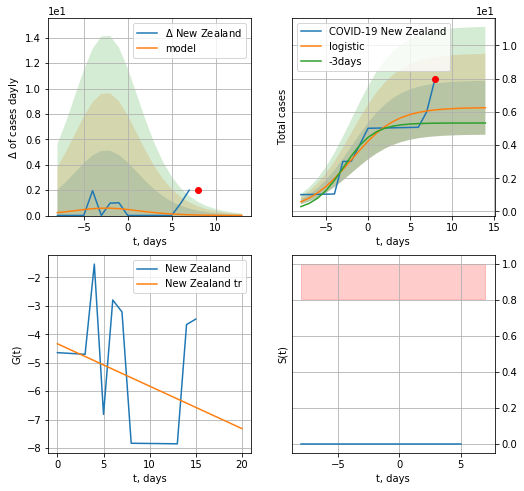

New Zealand data at: 2020-05-10
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


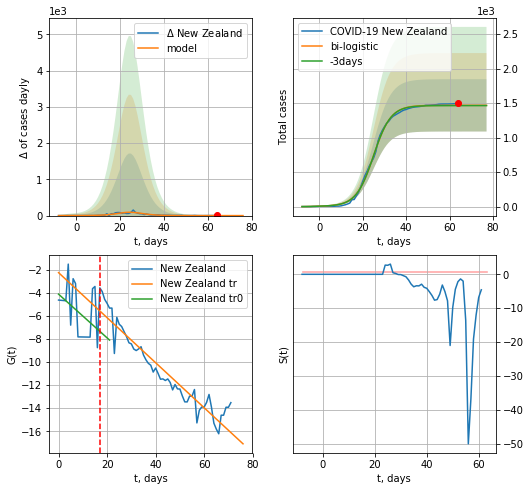

New Zealand data at: 2020-05-10
+3 day model MAPE: 0.002434454403660029
model: bi-logistic
coeffs:  [1.46245499e+03 2.50405837e-01 2.49391017e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.2580996575273318
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1468 ± 379
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.902914
 intercept: -2.268296
 slope: -0.195009


In [241]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,7*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

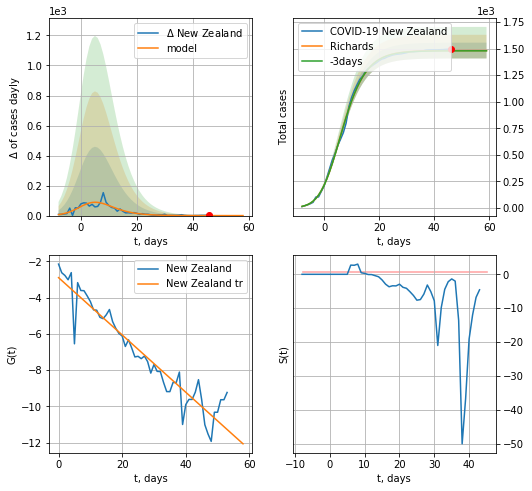

New Zealand data at: 2020-05-10
+3 day model MAPE: 0.001793
model: Richards
coeffs: [1.48146432e+03 4.75155616e-01 1.06077260e+00 4.12777602e-01]
rational stdev: 0.050093
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1481 ± 74
	 total death: 20 ± 3
trend coefficient of determination: 0.903459
 intercept: -2.898676
 slope: -0.158010


In [242]:
x = forecastRR('New Zealand',dfZL[18:],d1,8*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


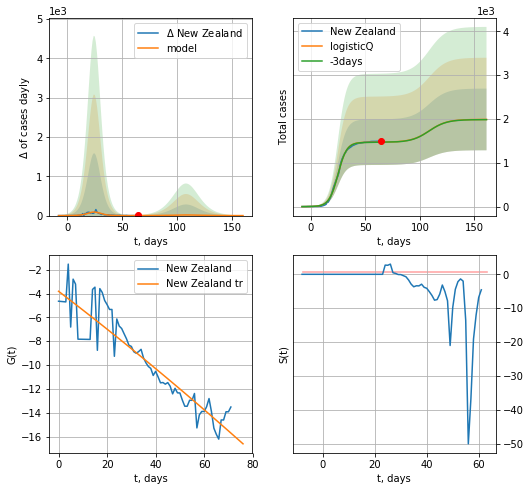

New Zealand data at: 2020-05-10
+3 day model MAPE: 0.002409
model: logisticQ
coeffs: [ 1.46933351e+03  3.54804963e-06  2.48954769e+01 -6.98279716e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353822
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 1988 ± 703
	 total death: 27 ± 28
trend coefficient of determination: 0.857811
 intercept_: -3.811649018828529
 coeffs_: [ 0.         -0.15550792 -0.00017029]


In [243]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
68 2020-05-06  19255.0   14755  112.0
69 2020-05-07  20168.0   14985  116.0
70 2020-05-08  21101.0   15496  121.0
71 2020-05-09  22052.0   15876  126.0
72 2020-05-10  22973.0   16436  131.0


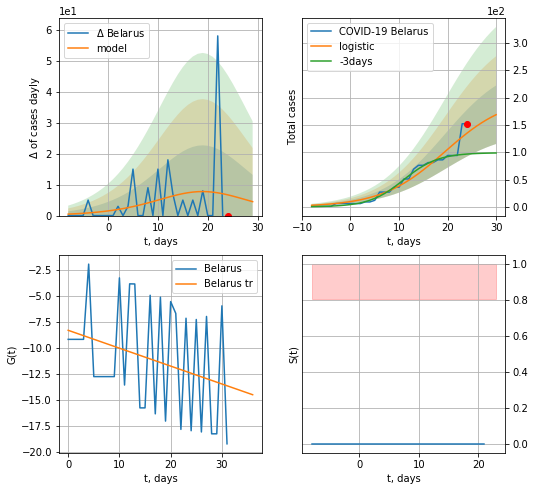

Belarus data at: 2020-05-10
+3 day model MAPE: 0.45662004942481244
model: logistic
coeffs:  [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.31755857499649554
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  168 ± 53
	 total death:  0 ± 0
trend coefficient of determination: 0.089858
 intercept: -8.339930
 slope: -0.172092


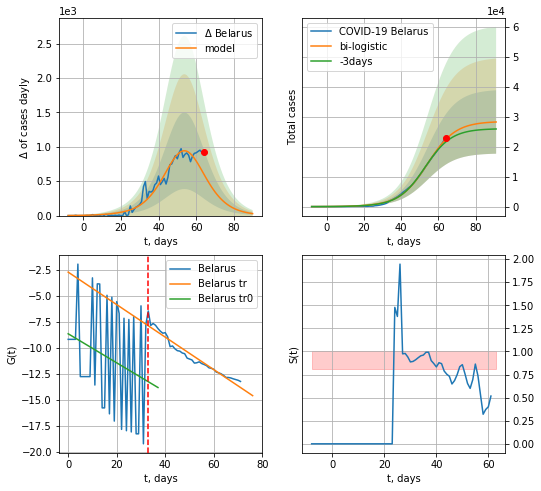

Belarus data at: 2020-05-10
+3 day model MAPE: 0.04349266217353291
model: bi-logistic
coeffs:  [2.82072162e+04 1.33779516e-01 5.42130362e+01] [2.01843698e+02 1.53900219e-01 1.94560978e+01]
rational stdev:  0.3745723366113909
forecast at the end of period: +27 days
	 deltaDaycases:  28
	 total cases:  28204 ± 10564
	 total death:  160 ± 179
bi-logistic approximation splitting point: 33
trend0 coefficient of determination: 0.064228
 intercept: -8.674644
 slope: -0.139700
trend coefficient of determination: 0.943345
 intercept: -2.744733
 slope: -0.156312


In [244]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:33],d1,7*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,10*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=33)

BR
          date    cases  active  death
68 2020-05-06  19255.0   14755  112.0
69 2020-05-07  20168.0   14985  116.0
70 2020-05-08  21101.0   15496  121.0
71 2020-05-09  22052.0   15876  126.0
72 2020-05-10  22973.0   16436  131.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


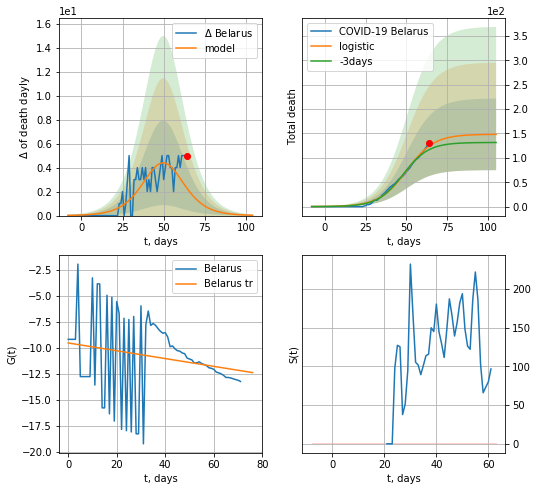

Belarus data at: 2020-05-10
+3 day model MAPE: 0.06790104277864367
model: logistic
coeffs:  [1.48427179e+02 1.18561593e-01 5.01984649e+01]
rational stdev:  0.4957987728592973
forecast at the end of period: +41 days
	 total death:  148 ± 73
trend coefficient of determination: 0.042184
 intercept: -9.558334
 slope: -0.037508


In [245]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


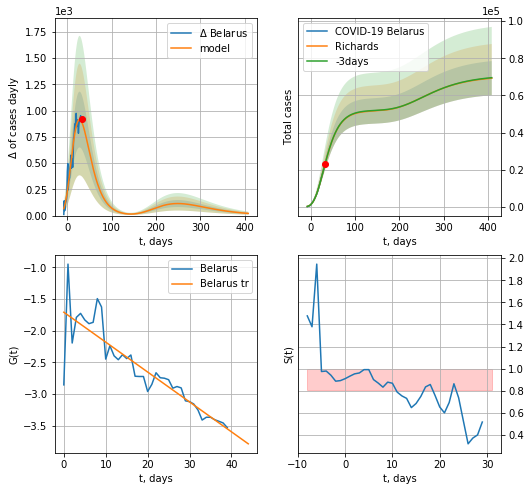

Belarus data at: 2020-05-10
+3 day model MAPE: 0.000495
model: Richards
coeffs: [ 5.17781008e+04  1.55190580e+00 -4.28997993e+01  3.14303741e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.132804
forecast at the end of period: +377 days
	 deltaDaycases: 20
	 total cases: 69272 ± 9199
	 total death: 395 ± 157
trend coefficient of determination: 0.787096
 intercept: -1.708161
 slope: -0.047261


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


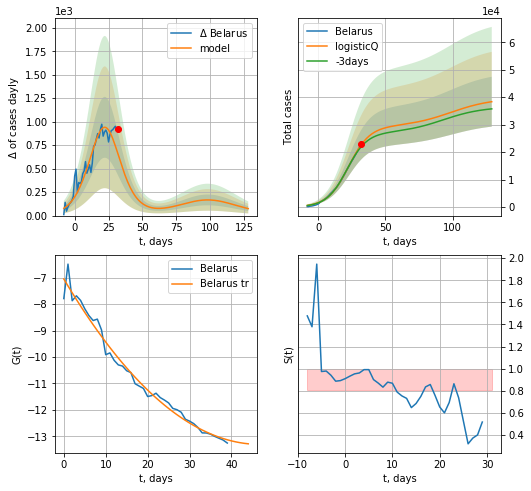

Belarus data at: 2020-05-10
+3 day model MAPE: 0.036141
model: logisticQ
coeffs: [ 2.92775430e+04  4.87905617e-06  2.26208578e+01 -2.61908812e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.236733
forecast at the end of period: +97 days
	 deltaDaycases: 74
	 total cases: 38361 ± 9081
	 total death: 218 ± 154
trend coefficient of determination: 0.981265
 intercept_: -7.046800930969155
 coeffs_: [ 0.         -0.26742241  0.00285431]


In [246]:
x = forecastRR('Belarus',dfBR[32:],d1,60*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


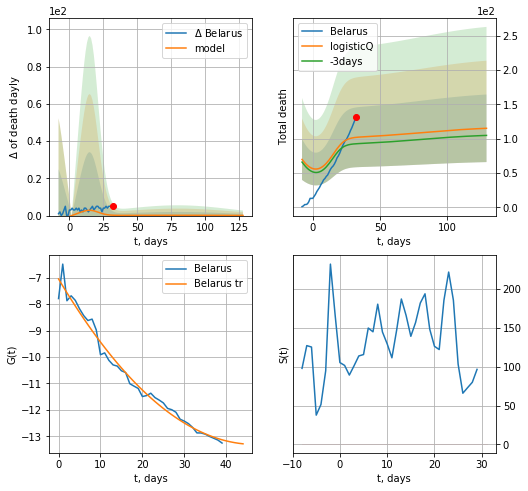

Belarus data at: 2020-05-10
+3 day model MAPE: 0.101179
model: logisticQ
coeffs: [ 8.64958232e+01  6.32520272e-03  5.94481186e+00 -1.48447264e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427840
forecast at the end of period: +97 days
	 total death: 115 ± 49
trend coefficient of determination: 0.981265
 intercept_: -7.046800930969155
 coeffs_: [ 0.         -0.26742241  0.00285431]


In [247]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

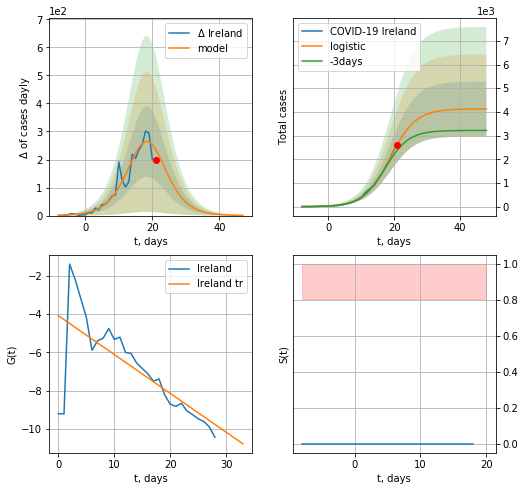

Ireland data at: 2020-05-10
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  4125 ± 1154
	 total death:  261 ± 219
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


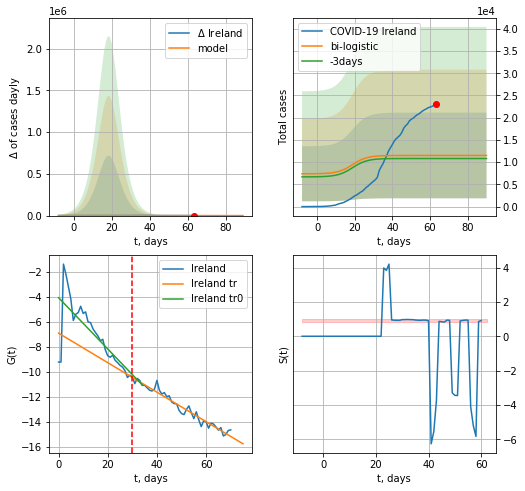

Ireland data at: 2020-05-10
+3 day model MAPE: 0.06396643770282187
model: bi-logistic
coeffs:  [5906.03181836   -6.35568995  167.0302408 ] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.837464283865195
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  11509 ± 9639
	 total death:  729 ± 1831
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.954538
 intercept: -6.899764
 slope: -0.117841


In [248]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


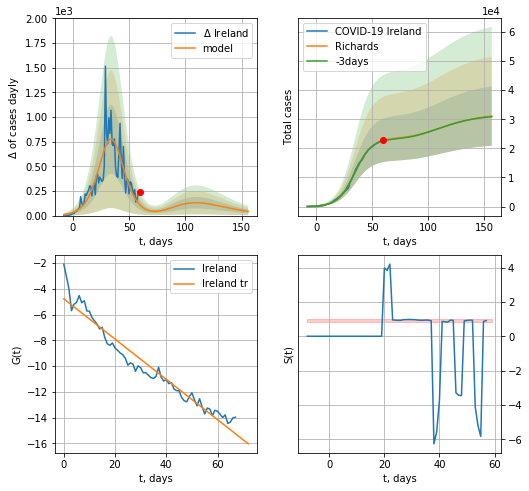

Ireland data at: 2020-05-10
+3 day model MAPE: 0.007402
model: Richards
coeffs: [2.35716280e+04 1.37752954e-01 3.39930199e+01 9.35540001e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.328143
forecast at the end of period: +97 days
	 deltaDaycases: 42
	 total cases: 31100 ± 10205
	 total death: 1971 ± 1940
trend coefficient of determination: 0.944605
 intercept: -4.779810
 slope: -0.156444


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


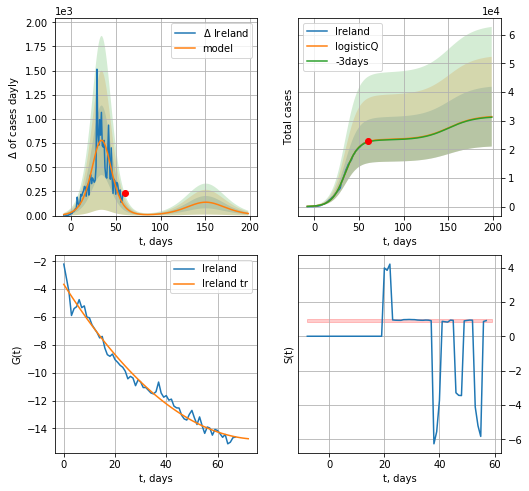

Ireland data at: 2020-05-10
+3 day model MAPE: 0.005520
model: logisticQ
coeffs: [ 2.34476396e+04  7.54154308e-06  3.46472808e+01 -1.76059362e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332377
forecast at the end of period: +139 days
	 deltaDaycases: 21
	 total cases: 31429 ± 10446
	 total death: 1992 ± 1986
trend coefficient of determination: 0.981520
 intercept_: -3.651943906785
 coeffs_: [ 0.         -0.29031499  0.00189206]


In [249]:
x = forecastRR('Ireland',dfIR[3:],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

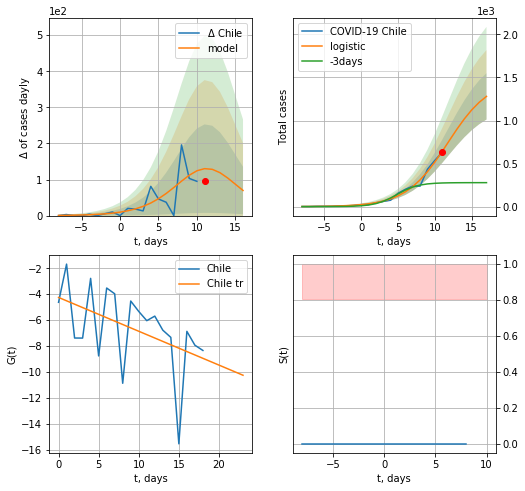

Chile data at: 2020-05-10
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +6 days
	 deltaDaycases:  69
	 total cases:  1280 ± 269
	 total death:  13 ± 8
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


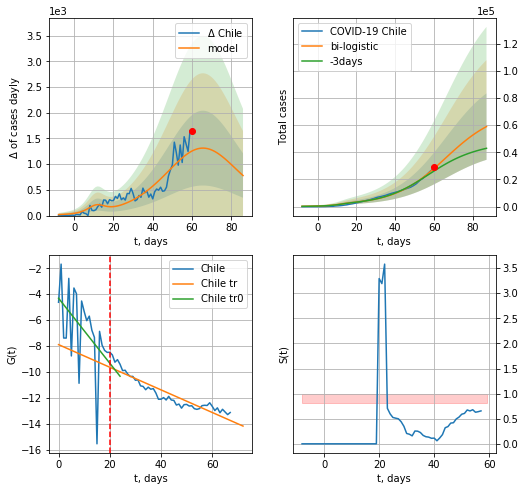

Chile data at: 2020-05-10
+3 day model MAPE: 0.08279482100878008
model: bi-logistic
coeffs:  [6.81789158e+04 7.64935102e-02 6.58970394e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.41515223578047966
forecast at the end of period: +27 days
	 deltaDaycases:  778
	 total cases:  58879 ± 24444
	 total death:  636 ± 792
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.863774
 intercept: -7.892864
 slope: -0.087318


In [250]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


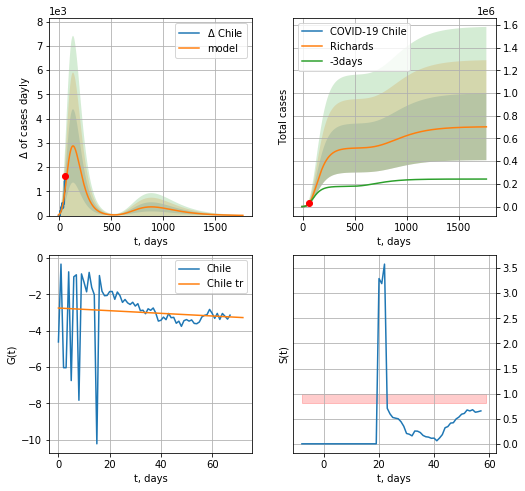

Chile data at: 2020-05-10
+3 day model MAPE: 0.068508
model: Richards
coeffs: [ 5.16635443e+05  5.72281990e-01 -1.03394274e+02  2.67856441e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.417626
forecast at the end of period: +1707 days
	 deltaDaycases: 9
	 total cases: 702027 ± 293185
	 total death: 7587 ± 9505
trend coefficient of determination: 0.008365
 intercept: -2.747380
 slope: -0.007290


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


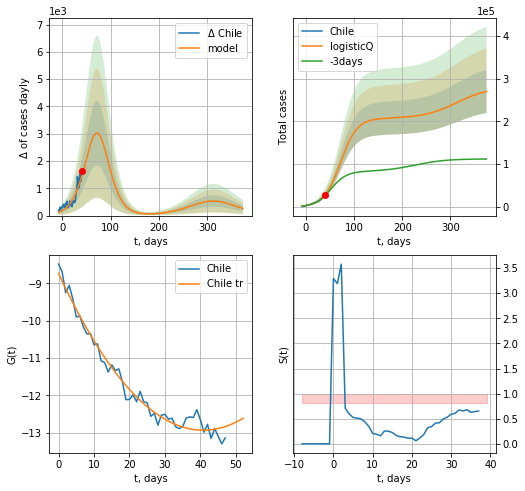

Chile data at: 2020-05-10
+3 day model MAPE: 0.058750
model: logisticQ
coeffs: [ 2.07171798e+05  1.16577292e-05  7.17715677e+01 -4.93477992e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.186383
forecast at the end of period: +335 days
	 deltaDaycases: 261
	 total cases: 270197 ± 50360
	 total death: 2920 ± 1632
trend coefficient of determination: 0.975196
 intercept_: -8.72962624980866
 coeffs_: [ 0.         -0.20600692  0.00252577]


In [251]:
x = forecastRR('Chile',dfCL[:],d1,250*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Chile',dfCL[20:],d1,54*7-dT,addpred=True,xcoef=koreaCoeffs)

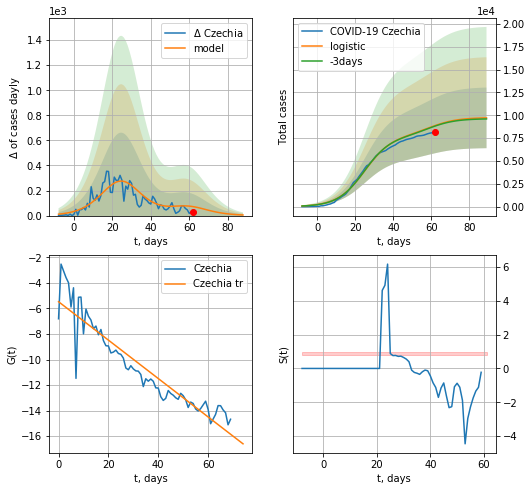

Czechia data at: 2020-05-10
+3 day model MAPE: 0.006611992852809121
model: logistic
coeffs:  [7.79895004e+03 1.40317690e-01 2.49372807e+01]
scenario coeffs:  [0.25, 1.0, 2.4]
rational stdev:  0.3415584715779871
forecast at the end of period: +27 days
	 deltaDaycases:  4
	 total cases:  9715 ± 3318
	 total death:  334 ± 342
trend coefficient of determination: 0.868432
 intercept: -5.473720
 slope: -0.150288


In [252]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=True,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


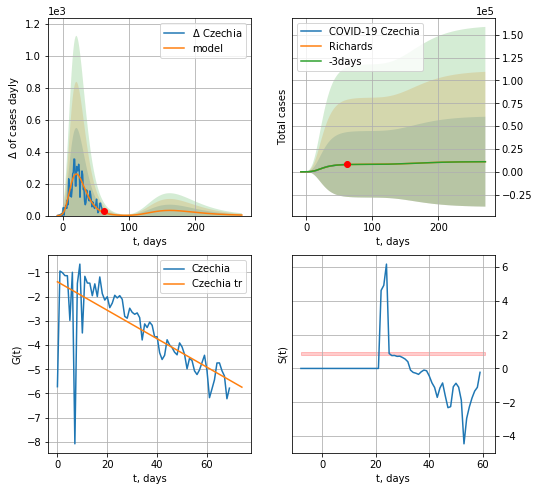

Czechia data at: 2020-05-10
+3 day model MAPE: 0.005872
model: Richards
coeffs: [ 8.21520256e+03  7.07157867e+00 -2.98350927e+01  1.22530165e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 4.441706
forecast at the end of period: +209 days
	 deltaDaycases: 3
	 total cases: 11077 ± 49202
	 total death: 381 ± 5076
trend coefficient of determination: 0.549334
 intercept: -1.384904
 slope: -0.058858


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


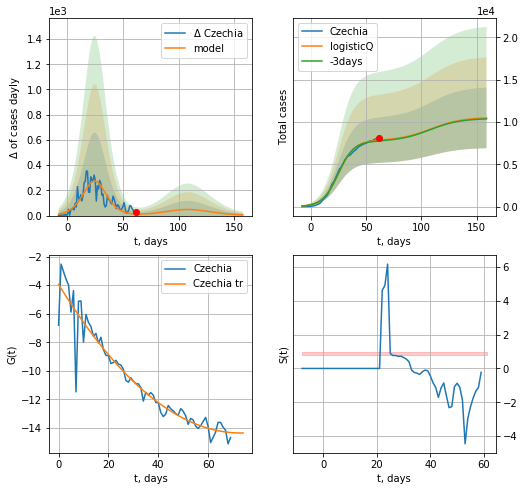

Czechia data at: 2020-05-10
+3 day model MAPE: 0.012031
model: logisticQ
coeffs: [ 7.79879082e+03  9.13647636e-07  2.49374761e+01 -1.53518890e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341642
forecast at the end of period: +97 days
	 deltaDaycases: 5
	 total cases: 10483 ± 3581
	 total death: 361 ± 369
trend coefficient of determination: 0.916270
 intercept_: -3.9489391333225683
 coeffs_: [ 0.         -0.28484802  0.00195029]


In [253]:
x = forecastRR('Czechia',dfCH[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

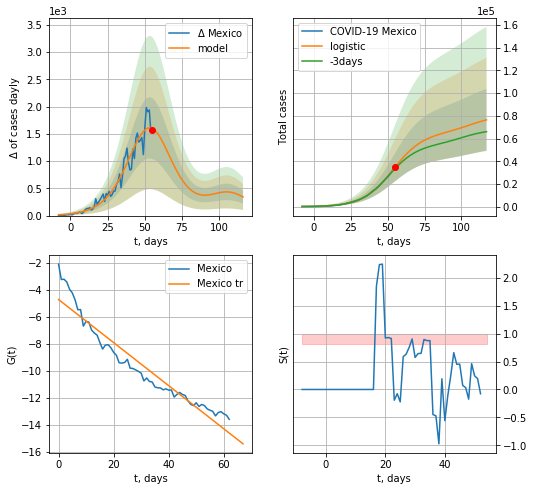

Mexico data at: 2020-05-10
+3 day model MAPE: 0.04433842758526611
model: logistic
coeffs:  [6.48854247e+04 9.88325147e-02 5.36561471e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3569585252388129
forecast at the end of period: +62 days
	 deltaDaycases:  341
	 total cases:  76483 ± 27301
	 total death:  7567 ± 8103
trend coefficient of determination: 0.921221
 intercept: -4.700765
 slope: -0.159426


In [254]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


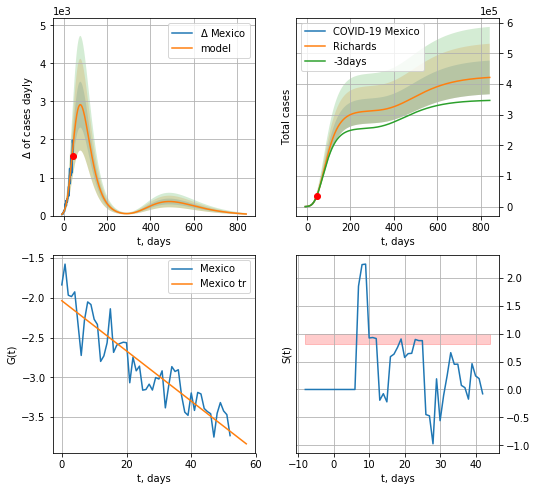

Mexico data at: 2020-05-10
+3 day model MAPE: 0.010581
model: Richards
coeffs: [ 3.13082445e+05  4.37875843e-01 -3.07279861e+01  5.94796900e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.130344
forecast at the end of period: +797 days
	 deltaDaycases: 41
	 total cases: 421815 ± 54981
	 total death: 41733 ± 16318
trend coefficient of determination: 0.841937
 intercept: -2.035229
 slope: -0.031582


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


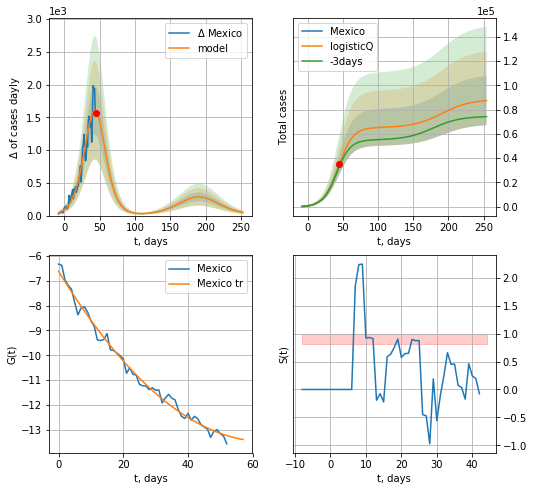

Mexico data at: 2020-05-10
+3 day model MAPE: 0.044108
model: logisticQ
coeffs: [ 6.52433757e+04  8.37156750e-06  4.37609191e+01 -1.17463091e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.231674
forecast at the end of period: +209 days
	 deltaDaycases: 46
	 total cases: 87385 ± 20245
	 total death: 8645 ± 6008
trend coefficient of determination: 0.989205
 intercept_: -6.609844052813466
 coeffs_: [ 0.         -0.21442835  0.00167199]


In [255]:
x = forecastRR('Mexico',dfMX[10:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1479.0     597   50.0  183913.0
62 2020-05-10  1479.0     601   50.0       NaN


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

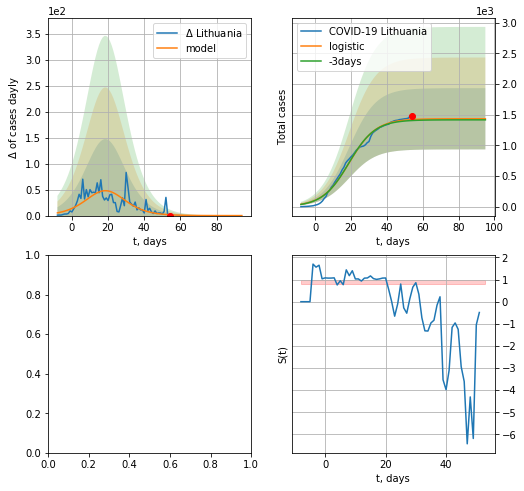

In [256]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
x = forecast('Lithuania',dfLT[:],d1,6*7-1)
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

LT
          date   cases  active  death     tests
57 2020-05-05  1428.0     662   48.0  156493.0
58 2020-05-06  1433.0     645   49.0  164088.0
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1479.0     597   50.0  183913.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


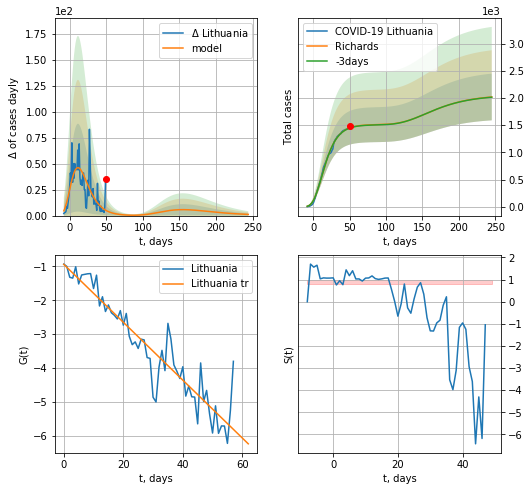

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.002326
model: Richards
coeffs: [ 1.51202021e+03  1.00944081e+01 -4.58381280e+01  8.24496149e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.212713
forecast at the end of period: +195 days
	 deltaDaycases: 1
	 total cases: 2019 ± 429
	 total death: 68 ± 43
trend coefficient of determination: 0.878699
 intercept: -0.937008
 slope: -0.085591


In [429]:
dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)
x = forecastRR('Lithuania',dfLT[3:],d1,28*7-1,addpred=True,xcoef=RkoreaCoeffs)#
#plt.grid()#

In [405]:
#np.diff(dfLT["cases"])

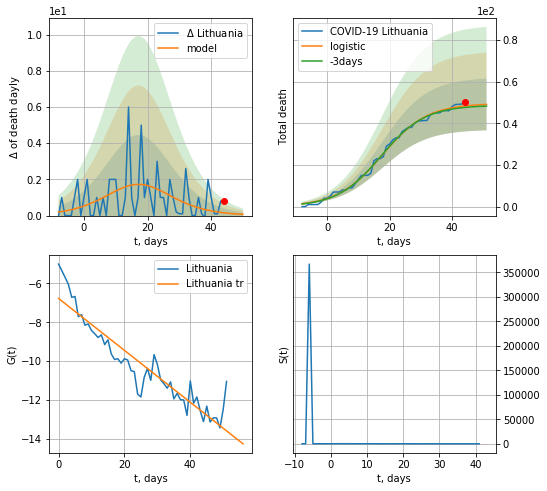

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.014861635563963804
model: logistic
coeffs:  [49.5045598   0.13958889 17.64153184]
rational stdev:  0.2529947066415788
forecast at the end of period: +7 days
	 total death:  49 ± 12
trend coefficient of determination: 0.864849
 intercept: -6.771141
 slope: -0.133705


In [406]:
x = forecast('Lithuania',dfLT[9:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


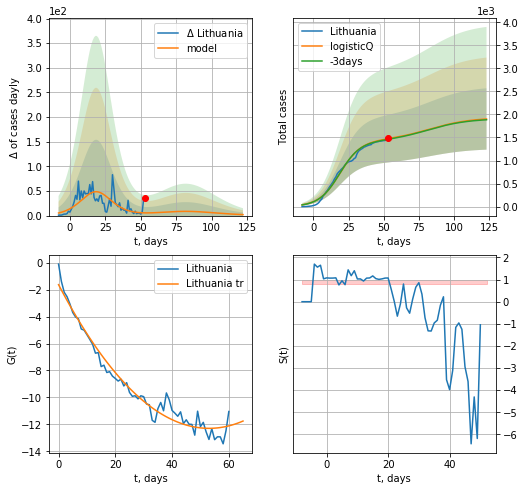

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.008856
model: logisticQ
coeffs: [ 1.42704062e+03  7.66614101e-07  1.88841509e+01 -1.75716468e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350097
forecast at the end of period: +70 days
	 deltaDaycases: 1
	 total cases: 1902 ± 665
	 total death: 64 ± 67
trend coefficient of determination: 0.965414
 intercept_: -1.631496602087263
 coeffs_: [ 0.         -0.40199829  0.00378951]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


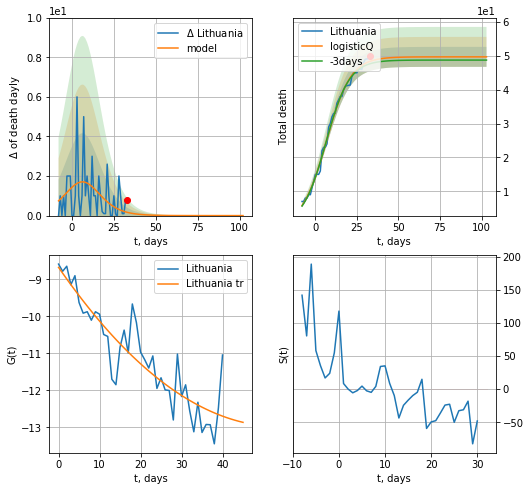

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.015478
model: logisticQ
coeffs: [ 4.97040227e+01  7.28697433e-06  6.71176744e+00 -1.88271315e+04]
rational stdev: 0.059319
forecast at the end of period: +70 days
	 total death: 49 ± 2
trend coefficient of determination: 0.807801
 intercept_: -8.67771467278656
 coeffs_: [ 0.         -0.15982811  0.00148587]


In [407]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


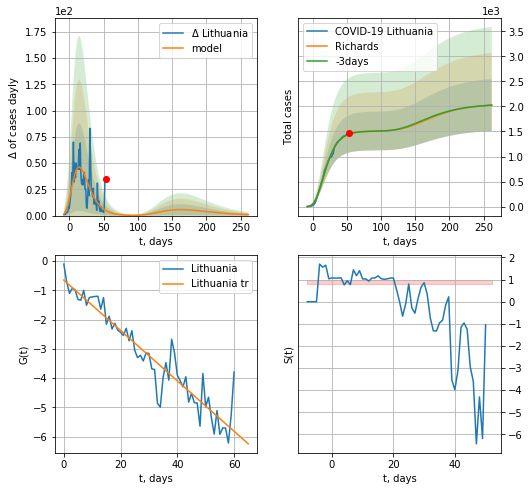

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.002376
model: Richards
coeffs: [ 1.51208006e+03  1.19098018e+01 -4.48670900e+01  6.98487591e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.256373
forecast at the end of period: +209 days
	 deltaDaycases: 0
	 total cases: 2028 ± 520
	 total death: 68 ± 52
trend coefficient of determination: 0.892907
 intercept: -0.650774
 slope: -0.086114


In [509]:
x = forecastRR('Lithuania',dfLT[:],d1,30*7-1,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


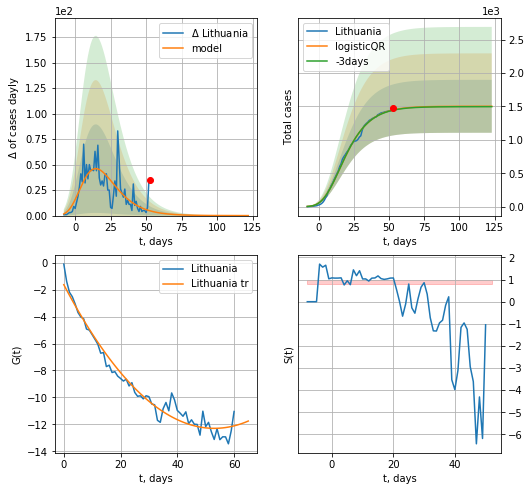

Lithuania data at: 2020-05-09
+3 day model MAPE: 0.0028145140831278385
model: logisticQR
coeffs:  [ 1.50260490e+03  5.06223940e-02 -6.98706128e+01 -1.01195923e+03
  1.48159716e-03]
rational stdev:  0.2637152455714835
forecast at the end of period: +70 days
	 deltaDaycases:  0
	 total cases:  1502 ± 396
	 total death:  50 ± 39
trend coefficient of determination: 0.965414
 intercept_: -1.631496602087263
 coeffs_: [ 0.         -0.40199829  0.00378951]


In [409]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
60 2020-05-06  3851.0     301   98.0
61 2020-05-07  3859.0     254  100.0
62 2020-05-08  3871.0     245  100.0
63 2020-05-09  3877.0     226  101.0
64 2020-05-10  3886.0     199  101.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


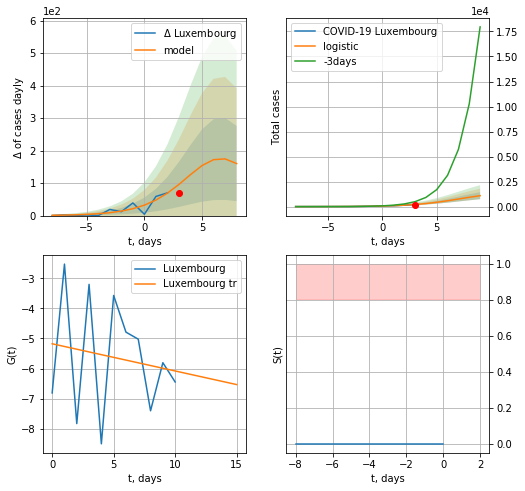

Luxembourg data at: 2020-05-10
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +6 days
	 deltaDaycases:  160
	 total cases:  1092 ± 351
	 total death:  28 ± 27
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


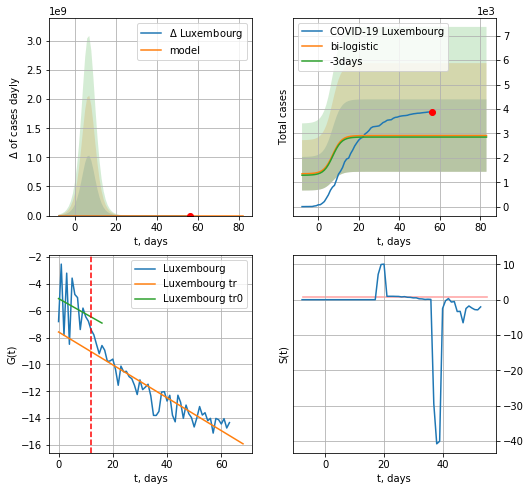

Luxembourg data at: 2020-05-10
+3 day model MAPE: 0.021355874741833522
model: bi-logistic
coeffs:  [1197.27983801   -5.32280186  214.51664723] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.5094518287927459
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2909 ± 1482
	 total death:  75 ± 114
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.851949
 intercept: -7.583439
 slope: -0.122472


In [257]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,7*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,10*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


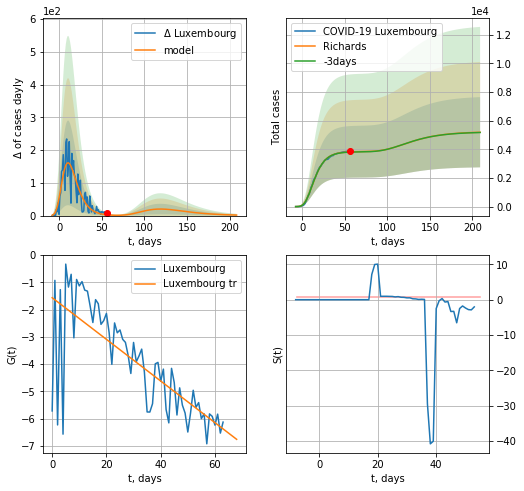

Luxembourg data at: 2020-05-10
+3 day model MAPE: 0.003750
model: Richards
coeffs: [ 3.83724893e+03  1.70957227e+01 -3.26114536e+01  6.70221809e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.472132
forecast at the end of period: +153 days
	 deltaDaycases: 1
	 total cases: 5187 ± 2449
	 total death: 134 ± 189
trend coefficient of determination: 0.567946
 intercept: -1.566985
 slope: -0.076285


In [258]:
x = forecastRR("Luxembourg",dfLX[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


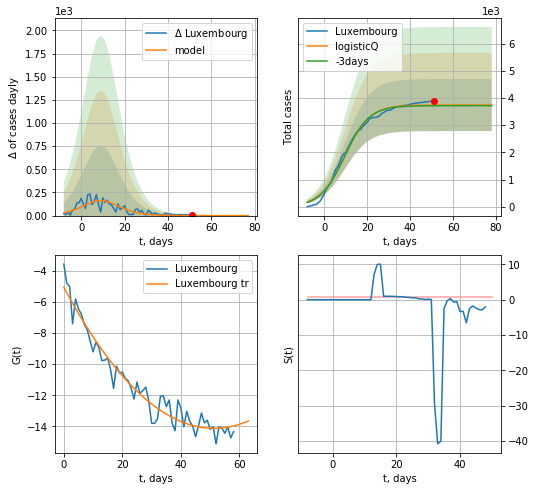

Luxembourg data at: 2020-05-10
+3 day model MAPE: 0.006641
model: logisticQ
coeffs: [ 3.74031068e+03  1.00631034e-06  9.53642114e+00 -1.72644016e+05]
rational stdev: 0.255753
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 3740 ± 956
	 total death: 97 ± 74
trend coefficient of determination: 0.946895
 intercept_: -5.055668770937524
 coeffs_: [ 0.         -0.35316588  0.00344033]


In [259]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,10*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
67 2020-05-06  27172.0  24369.0  1618.0
68 2020-05-07  27982.0  25211.0  1654.0
69 2020-05-08  28818.0  23681.0  1704.0
70 2020-05-09  29071.0  23921.0  1717.0
71 2020-05-10  29559.0  23999.0  2127.0


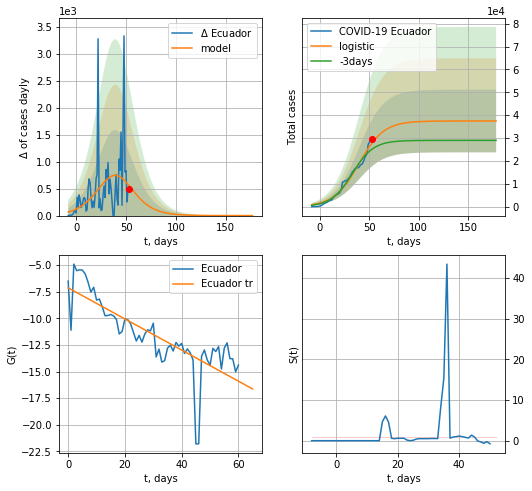

Ecuador data at: 2020-05-10
+3 day model MAPE: 0.11799165438603722
model: logistic
coeffs:  [3.74641544e+04 7.98605425e-02 3.95711526e+01]
rational stdev:  0.36579642529547535
forecast at the end of period: +125 days
	 deltaDaycases:  0
	 total cases:  37463 ± 13704
	 total death:  2695 ± 2957
trend coefficient of determination: 0.629113
 intercept: -7.142120
 slope: -0.146020


In [260]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[10:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


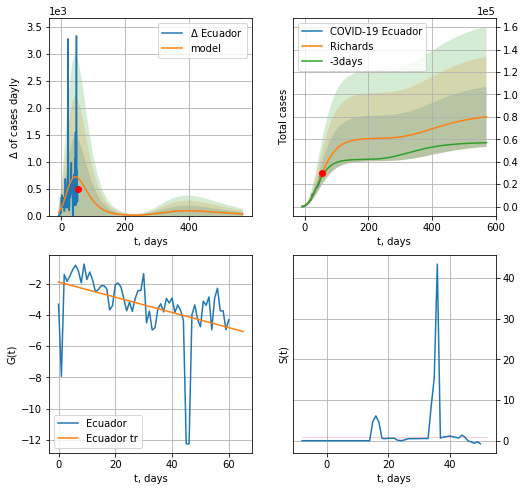

Ecuador data at: 2020-05-10
+3 day model MAPE: 0.080637
model: Richards
coeffs: [ 6.09456328e+04  1.62577426e+00 -7.57544863e+01  1.99200160e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.334003
forecast at the end of period: +517 days
	 deltaDaycases: 31
	 total cases: 80022 ± 26727
	 total death: 5758 ± 5769
trend coefficient of determination: 0.172769
 intercept: -1.900649
 slope: -0.048594


In [261]:
x = forecastRR("Ecuador",dfED[10:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


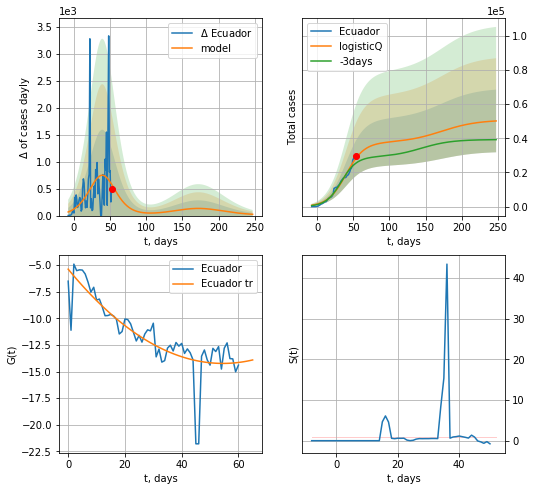

Ecuador data at: 2020-05-10
+3 day model MAPE: 0.116129
model: logisticQ
coeffs: [ 3.74434347e+04  7.82327858e-07  3.95563230e+01 -1.02065353e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365779
forecast at the end of period: +195 days
	 deltaDaycases: 23
	 total cases: 50097 ± 18324
	 total death: 3604 ± 3954
trend coefficient of determination: 0.693997
 intercept_: -5.3874948961407005
 coeffs_: [ 0.         -0.32449186  0.00297481]


In [262]:
x = forecastRRR("Ecuador",dfED[10:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
71 2020-05-06  5573.0    1821  252.0
72 2020-05-07  5673.0    1918  255.0
73 2020-05-08  5738.0    1478  260.0
74 2020-05-09  5880.0    1615  265.0
75 2020-05-10  5962.0    1695  267.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


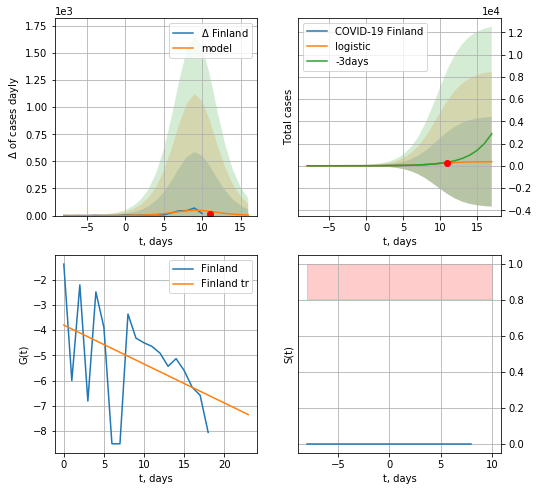

Finland data at: 2020-05-10
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  366 ± 4039
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


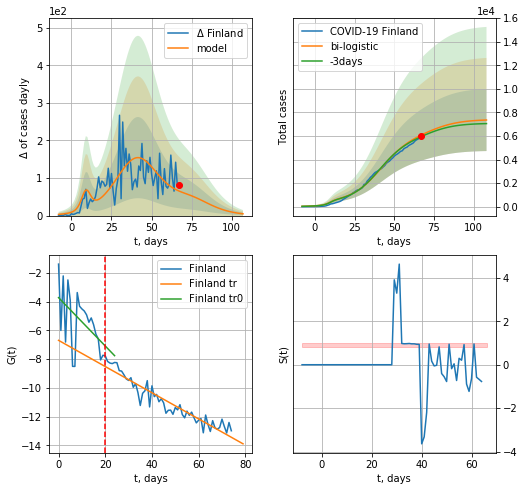

Finland data at: 2020-05-10
+3 day model MAPE: 0.022679994031326086
model: bi-logistic
coeffs:  [5.62007232e+03 1.06866370e-01 4.14815987e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.35835478747154703
forecast at the end of period: +41 days
	 deltaDaycases:  4
	 total cases:  7354 ± 2635
	 total death:  329 ± 353
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.900310
 intercept: -6.688935
 slope: -0.091116


In [263]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


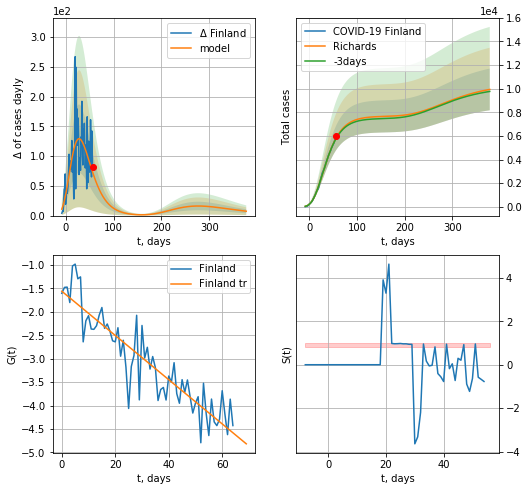

Finland data at: 2020-05-10
+3 day model MAPE: 0.009187
model: Richards
coeffs: [ 7.66787121e+03  2.86076547e+00 -6.08470262e+01  1.61357738e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.177550
forecast at the end of period: +321 days
	 deltaDaycases: 7
	 total cases: 9933 ± 1763
	 total death: 444 ± 236
trend coefficient of determination: 0.820720
 intercept: -1.561419
 slope: -0.047171


In [264]:
x = forecastRR("Finland",dfFI[10:],d1,52*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


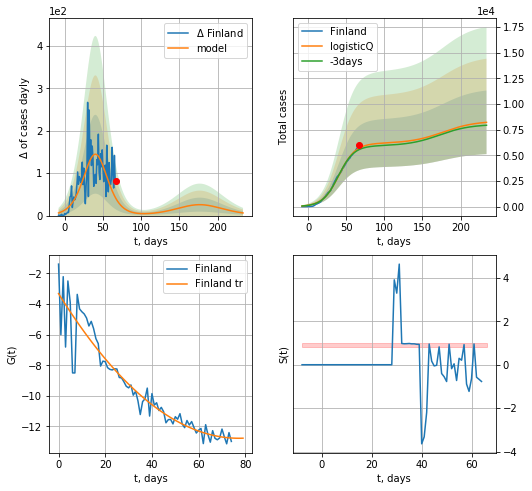

Finland data at: 2020-05-10
+3 day model MAPE: 0.026605
model: logisticQ
coeffs: [ 6.16055148e+03  9.91783939e-07  4.05710851e+01 -9.46128955e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.377481
forecast at the end of period: +167 days
	 deltaDaycases: 6
	 total cases: 8204 ± 3097
	 total death: 367 ± 415
trend coefficient of determination: 0.894424
 intercept_: -3.313332334324789
 coeffs_: [ 0.         -0.24501844  0.00158671]


In [265]:
x = forecastRRR("Finland",dfFI[:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

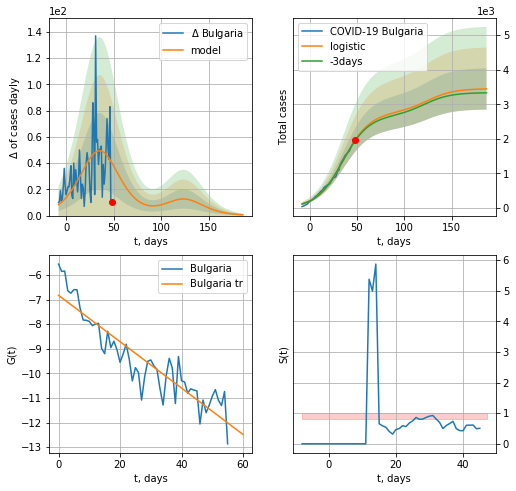

Bulgaria data at: 2020-05-10
+3 day model MAPE: 0.011205921192704893
model: logistic
coeffs:  [2.76162995e+03 7.14992089e-02 3.55633003e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.17359603400356557
forecast at the end of period: +139 days
	 deltaDaycases:  0
	 total cases:  3444 ± 597
	 total death:  159 ± 82
trend coefficient of determination: 0.836693
 intercept: -6.829783
 slope: -0.094228


In [266]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


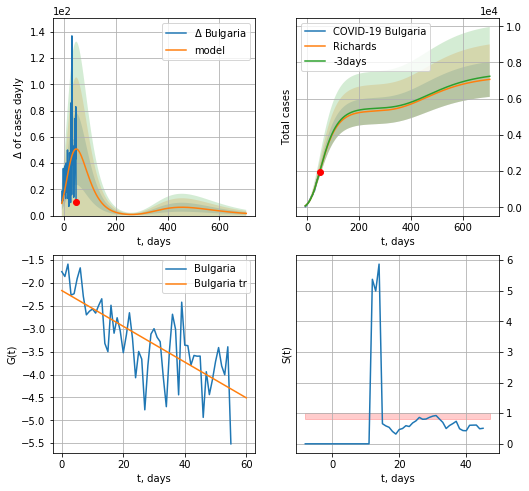

Bulgaria data at: 2020-05-10
+3 day model MAPE: 0.003091
model: Richards
coeffs: [ 5.32965162e+03  8.49706561e-01 -8.40190780e+01  3.09555731e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.136693
forecast at the end of period: +657 days
	 deltaDaycases: 1
	 total cases: 7065 ± 965
	 total death: 327 ± 134
trend coefficient of determination: 0.560125
 intercept: -2.164981
 slope: -0.039083


In [267]:
x = forecastRR('Bulgaria',dfBL[5:],d1,100*7-dT,shift=1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


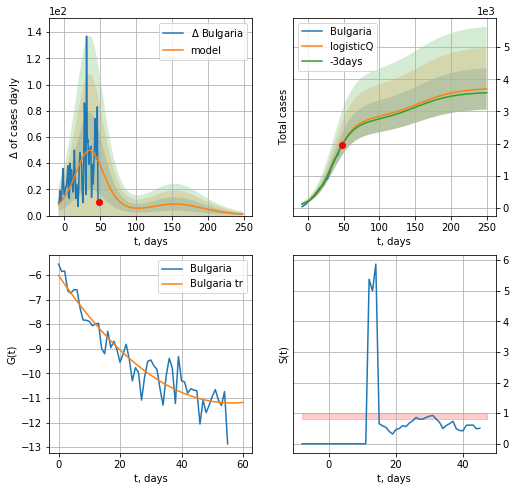

Bulgaria data at: 2020-05-10
+3 day model MAPE: 0.010854
model: logisticQ
coeffs: [ 2.75617920e+03  3.16967520e-06  3.55063799e+01 -2.25639018e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.173783
forecast at the end of period: +202 days
	 deltaDaycases: 1
	 total cases: 3701 ± 643
	 total death: 171 ± 89
trend coefficient of determination: 0.889602
 intercept_: -6.020060007437223
 coeffs_: [ 0.         -0.18422288  0.0016365 ]


In [268]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date  cases  active  death
69 2020-05-06   2992   165.0   55.0
70 2020-05-07   3000   161.0   55.0
71 2020-05-08   3004   161.0   56.0
72 2020-05-09   3009   159.0   56.0
73 2020-05-10   3015   163.0   56.0


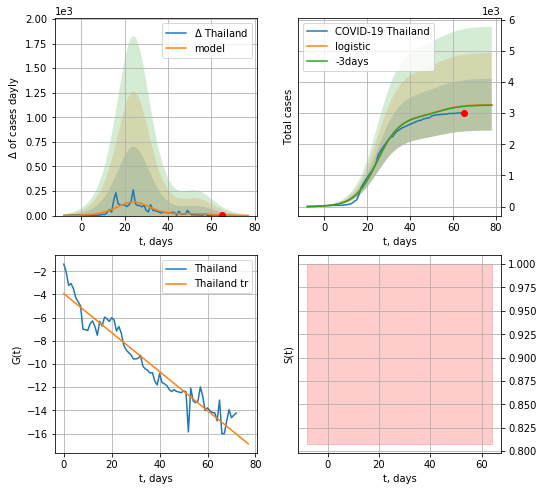

Thailand data at: 2020-05-10
+3 day model MAPE: 0.005107044111973483
model: logistic
coeffs:  [2.91097429e+03 1.90205572e-01 2.46168276e+01]
scenario coeffs:  [0.125, 1.0, 2.2]
rational stdev:  0.2542092180503764
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  3270 ± 831
	 total death:  60 ± 45
trend coefficient of determination: 0.926923
 intercept: -3.930712
 slope: -0.168206


In [269]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=True,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [270]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


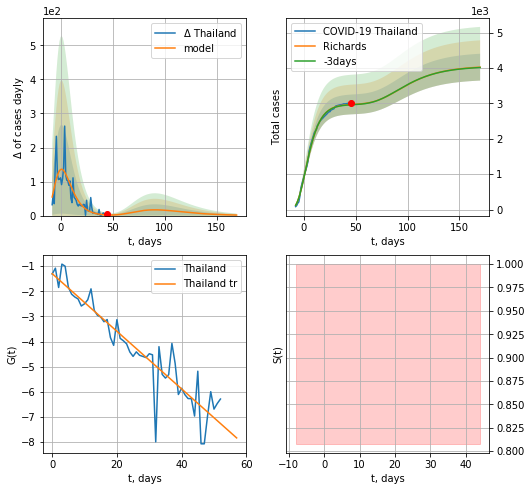

Thailand data at: 2020-05-10
+3 day model MAPE: 0.002946
model: Richards
coeffs: [ 2.98263463e+03  1.43617842e+01 -3.65992474e+01  8.68903707e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.094258
forecast at the end of period: +125 days
	 deltaDaycases: 1
	 total cases: 4026 ± 379
	 total death: 74 ± 20
trend coefficient of determination: 0.866875
 intercept: -1.296978
 slope: -0.114737


In [271]:
x = forecastRR("Thailand",dfTH[20:],d1,24*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


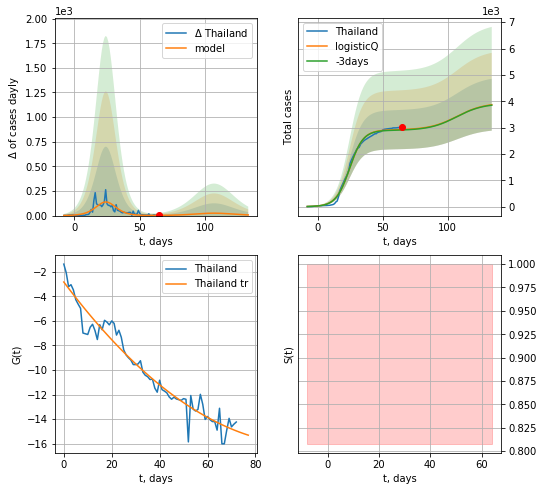

Thailand data at: 2020-05-10
+3 day model MAPE: 0.005928
model: logisticQ
coeffs: [ 2.91091695e+03  3.94004203e-06  2.46177626e+01 -4.82199487e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.254526
forecast at the end of period: +69 days
	 deltaDaycases: 6
	 total cases: 3867 ± 984
	 total death: 71 ± 54
trend coefficient of determination: 0.945948
 intercept_: -2.8426779392334343
 coeffs_: [ 0.         -0.26016923  0.00127737]


In [272]:
x = forecastRRR("Thailand",dfTH[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)

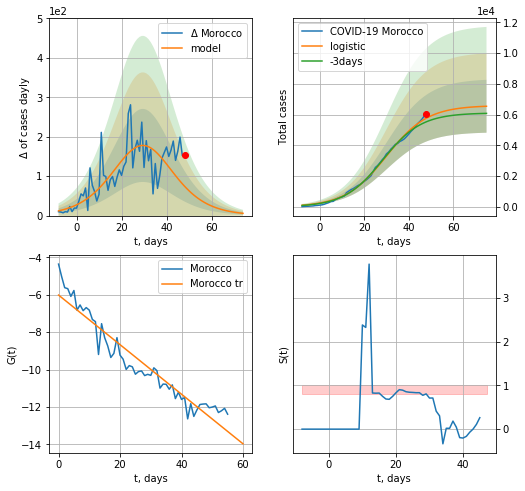

Morocco data at: 2020-05-10
+3 day model MAPE: 0.04522670474784702
model: logistic
coeffs:  [6.59203627e+03 1.07996896e-01 2.99466607e+01]
rational stdev:  0.2628596855123883
forecast at the end of period: +27 days
	 deltaDaycases:  5
	 total cases:  6541 ± 1719
	 total death:  202 ± 159
trend coefficient of determination: 0.915709
 intercept: -6.017515
 slope: -0.132618


In [273]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


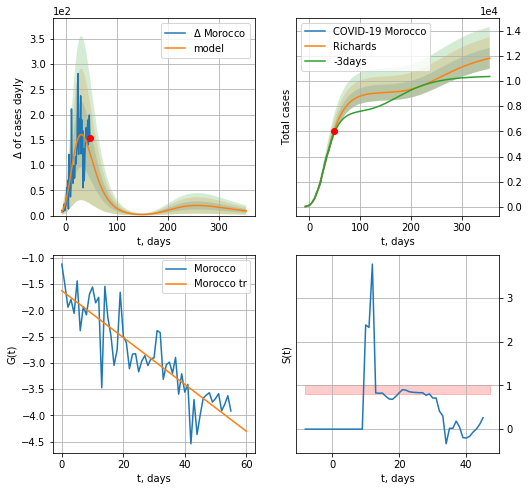

Morocco data at: 2020-05-10
+3 day model MAPE: 0.032446
model: Richards
coeffs: [ 9.10730267e+03  1.80026511e+00 -4.37373175e+01  2.69801913e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.070461
forecast at the end of period: +307 days
	 deltaDaycases: 9
	 total cases: 11804 ± 831
	 total death: 366 ± 77
trend coefficient of determination: 0.768232
 intercept: -1.625438
 slope: -0.044580


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


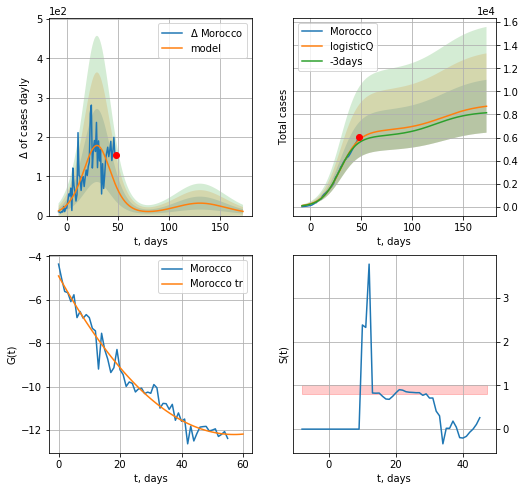

Morocco data at: 2020-05-10
+3 day model MAPE: 0.044850
model: logisticQ
coeffs: [ 6.58930884e+03  2.45387563e-06  2.99388852e+01 -4.39938175e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.263069
forecast at the end of period: +125 days
	 deltaDaycases: 10
	 total cases: 8712 ± 2291
	 total death: 270 ± 213
trend coefficient of determination: 0.970553
 intercept_: -4.908471003591641
 coeffs_: [ 0.         -0.25588057  0.00224146]


In [274]:
x = forecastRR("Morocco",dfMR[5:],d1,50*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR("Morocco",dfMR[5:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

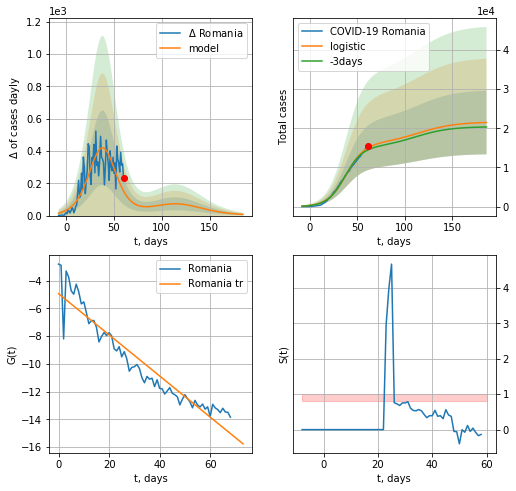

Romania data at: 2020-05-10
+3 day model MAPE: 0.036690691471448364
model: logistic
coeffs:  [1.60102921e+04 1.03691532e-01 3.82989380e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.3785625514112115
forecast at the end of period: +125 days
	 deltaDaycases:  7
	 total cases:  21476 ± 8130
	 total death:  1343 ± 1525
trend coefficient of determination: 0.903568
 intercept: -4.936535
 slope: -0.148200


In [275]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


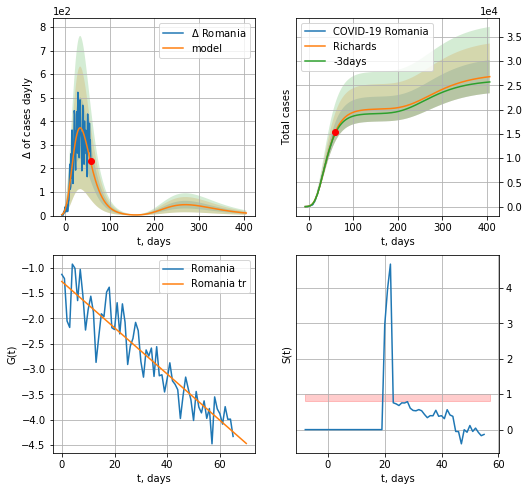

Romania data at: 2020-05-10
+3 day model MAPE: 0.017520
model: Richards
coeffs: [ 2.01238479e+04  3.63747688e+00 -5.07257804e+01  1.39239726e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.127650
forecast at the end of period: +349 days
	 deltaDaycases: 10
	 total cases: 26766 ± 3416
	 total death: 1674 ± 641
trend coefficient of determination: 0.859508
 intercept: -1.272887
 slope: -0.045677


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


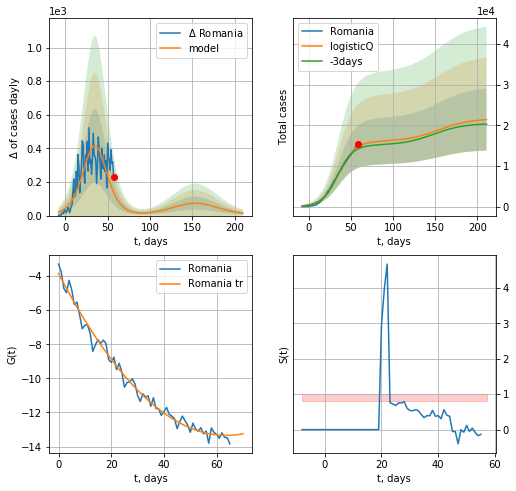

Romania data at: 2020-05-10
+3 day model MAPE: 0.037537
model: logisticQ
coeffs: [ 1.60193060e+04  1.05528875e-06  3.53138525e+01 -9.80748189e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354818
forecast at the end of period: +153 days
	 deltaDaycases: 14
	 total cases: 21416 ± 7599
	 total death: 1339 ± 1425
trend coefficient of determination: 0.986177
 intercept_: -3.8497446370773876
 coeffs_: [ 0.         -0.29820789  0.00234161]


In [276]:
x = forecastRR("Romania",dfRM[8:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecastRRR("Romania",dfRM[8:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [277]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
88 2020-05-06  1064763  420214  111849.0
89 2020-05-07  1074908  416066  113018.0
90 2020-05-08  1085278  412975  114289.0
91 2020-05-09  1093386  409685  115049.0
92 2020-05-10  1099414  406223  115622.0


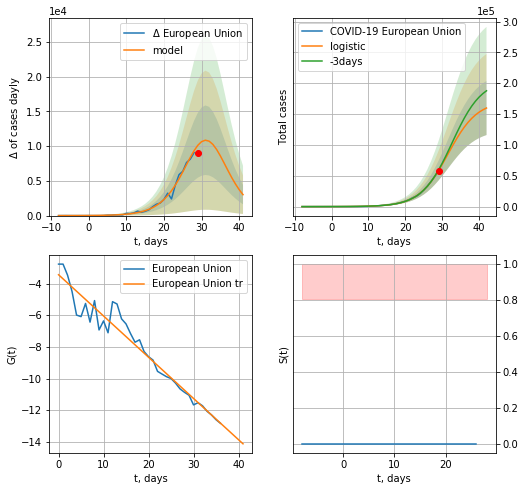

European Union data at: 2020-05-10
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +13 days
	 deltaDaycases:  3013
	 total cases:  159830 ± 43812
	 total death:  16808 ± 13822
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


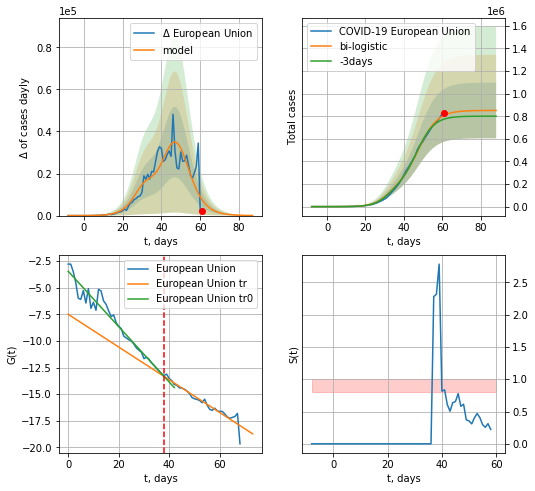

European Union data at: 2020-05-10
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +27 days
	 deltaDaycases:  44
	 total cases:  851555 ± 246543
	 total death:  89555 ± 77784
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


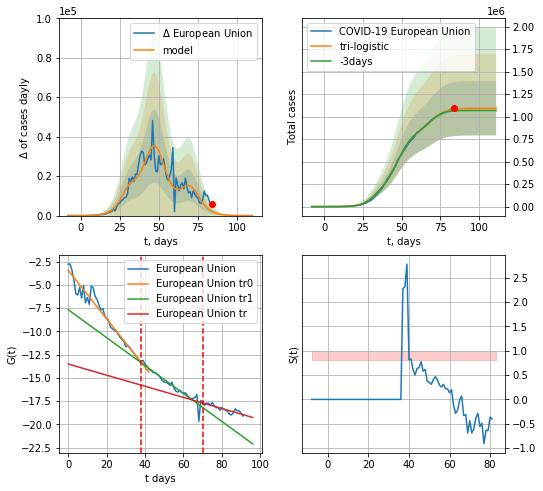

European Union data at: 2020-05-10
+3 day model MAPE: 0.018928846938836053
model: tri-logistic
coeffs:  [2.41240502e+05 2.28860843e-01 7.01890651e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.27573805307932026
forecast at the end of period: +27 days
	 deltaDaycases:  5
	 total cases:  1092971 ± 301373
	 total death:  114944 ± 95083
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.774214
 intercept: -13.515394
 slope: -0.059819


In [278]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


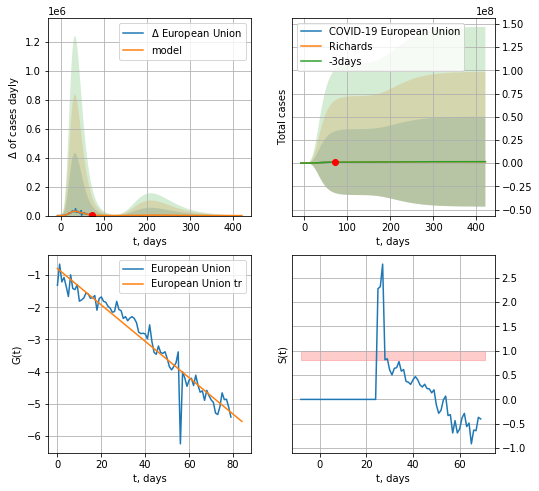

European Union data at: 2020-05-10
+3 day model MAPE: 0.005579
model: Richards
coeffs: [ 1.15621321e+06  4.60668753e+00 -2.64757814e+01  1.52629798e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 30.770500
forecast at the end of period: +349 days
	 deltaDaycases: 62
	 total cases: 1572663 ± 48391639
	 total death: 165392 ± 15267583
trend coefficient of determination: 0.930997
 intercept: -0.794221
 slope: -0.056672


In [279]:
x = forecastRR("European Union",dfEU[12:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


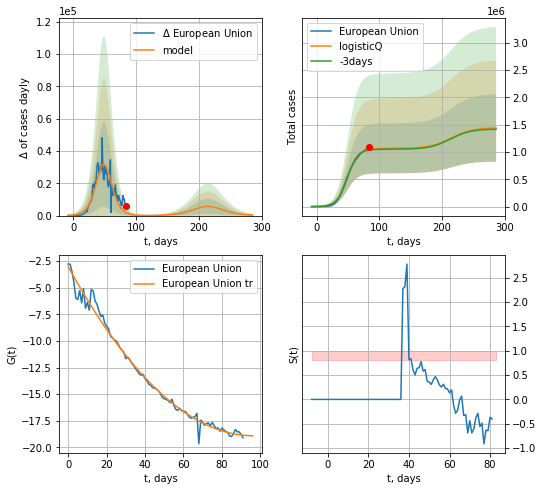

European Union data at: 2020-05-10
+3 day model MAPE: 0.014665
model: logisticQ
coeffs: [ 1.06723721e+06  8.75328586e-07  4.91830248e+01 -1.36486210e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428665
forecast at the end of period: +202 days
	 deltaDaycases: 307
	 total cases: 1440190 ± 617359
	 total death: 151460 ± 194776
trend coefficient of determination: 0.987850
 intercept_: -3.00027060523178
 coeffs_: [ 0.         -0.32955283  0.00170564]


In [280]:
x = forecastRRR("European Union",dfEU[:],d1,35*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


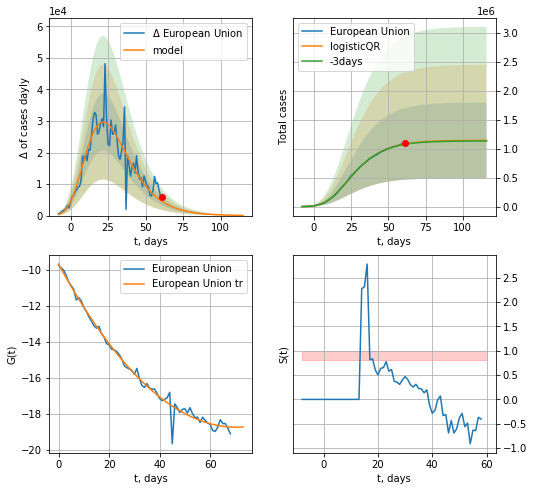

European Union data at: 2020-05-10
+3 day model MAPE: 0.006134008677216607
model: logisticQR
coeffs:  [ 1.14542538e+06  2.06620686e-02 -6.65831368e+01 -8.88844481e+02
  3.41430057e-03]
rational stdev:  0.5712222255843048
forecast at the end of period: +55 days
	 deltaDaycases:  70
	 total cases:  1144622 ± 653834
	 total death:  120376 ± 206284
trend coefficient of determination: 0.986921
 intercept_: -9.668443936319006
 coeffs_: [ 0.         -0.25830952  0.00183711]


In [281]:
x = forecastQR("European Union",dfEU[23:],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,2.5,1.,1])

In [282]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [283]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [284]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [285]:
#dfIC[:]

IC
          date   cases  active  death
66 2020-05-06  1799.8      39  10.00
67 2020-05-07  1801.0      36  10.00
68 2020-05-08  1801.2      26  10.01
69 2020-05-09  1801.3      18  10.02
70 2020-05-10  1801.0      18  10.00


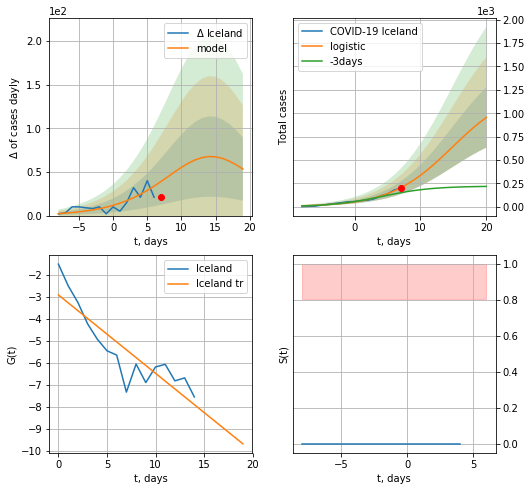

Iceland data at: 2020-05-10
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +13 days
	 deltaDaycases:  53
	 total cases:  955 ± 322
	 total death:  5 ± 5
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: invalid value encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

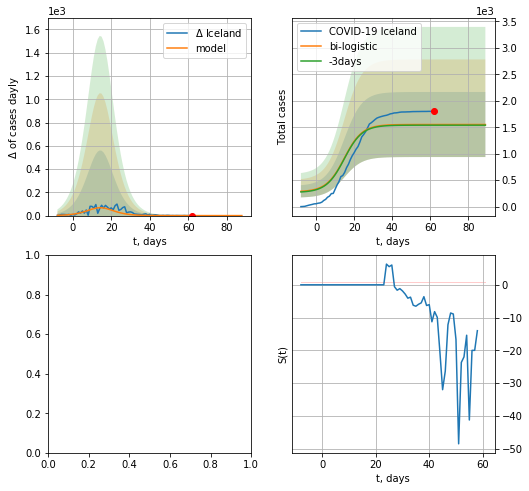

In [286]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


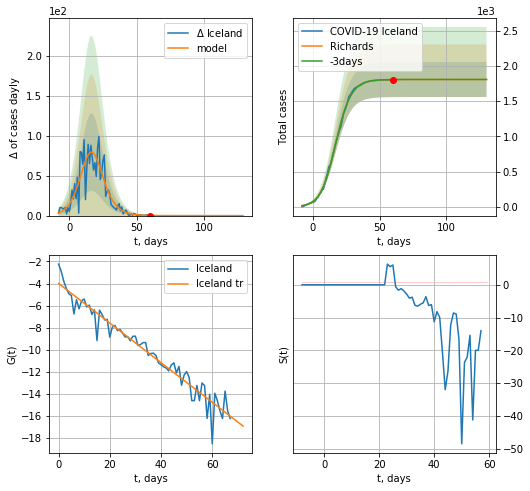

Iceland data at: 2020-05-09
+3 day model MAPE: 0.000327
model: Richards
coeffs: [1.80572371e+03 1.95559306e-01 1.60706106e+01 8.62430569e-01]
rational stdev: 0.137707
forecast at the end of period: +70 days
	 deltaDaycases: 0
	 total cases: 1805 ± 248
	 total death: 10 ± 4
trend coefficient of determination: 0.941507
 intercept: -3.991718
 slope: -0.180000


In [530]:
x = forecastRR("Iceland",dfIC[1:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


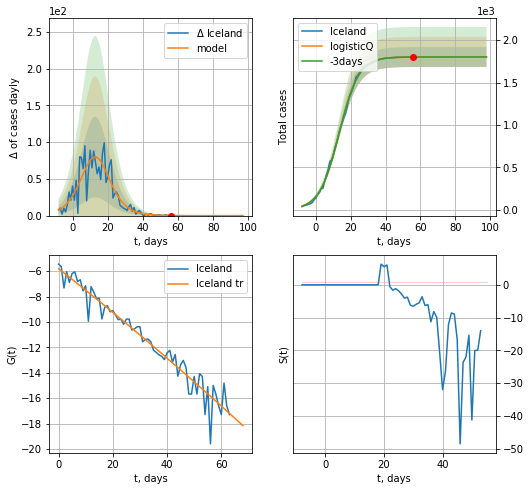

Iceland data at: 2020-05-09
+3 day model MAPE: 0.000029
model: logisticQ
coeffs: [ 1.80196106e+03  9.52672363e-06  1.33193786e+01 -1.85987822e+04]
rational stdev: 0.065620
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 1801 ± 118
	 total death: 10 ± 1
trend coefficient of determination: 0.940651
 intercept_: -5.797807936004534
 coeffs_: [ 0.         -0.16825284 -0.0002015 ]


In [298]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


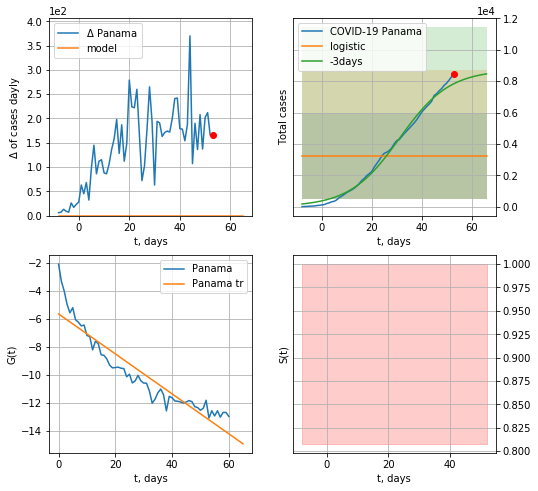

Panama data at: 2020-05-10
+3 day model MAPE: 0.5900204059687679
model: logistic
coeffs:  [ 3.24616130e+03 -2.18908872e+00  8.18749231e+01]
rational stdev:  0.843142183497019
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  3246 ± 2736
	 total death:  93 ± 235
trend coefficient of determination: 0.870122
 intercept: -5.653436
 slope: -0.142665


In [287]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


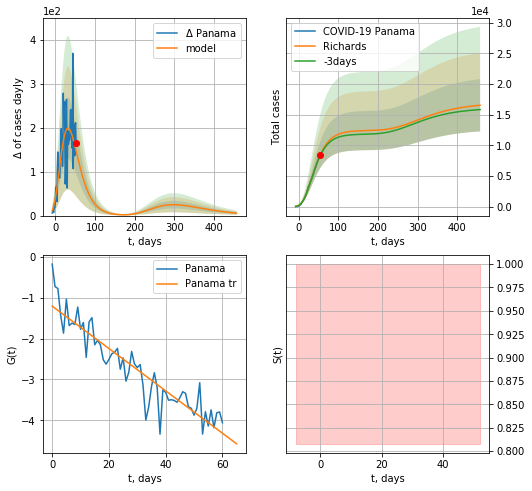

Panama data at: 2020-05-10
+3 day model MAPE: 0.014604
model: Richards
coeffs: [ 1.24345228e+04  3.06577323e+00 -6.41444736e+01  1.43345791e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.257679
forecast at the end of period: +405 days
	 deltaDaycases: 5
	 total cases: 16546 ± 4263
	 total death: 477 ± 368
trend coefficient of determination: 0.851617
 intercept: -1.208840
 slope: -0.051763


In [288]:
x = forecastRR("Panama",dfPM[:],d1,64*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


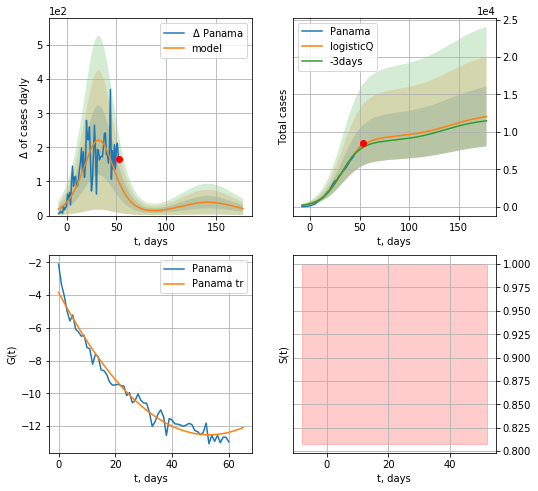

Panama data at: 2020-05-10
+3 day model MAPE: 0.034995
model: logisticQ
coeffs: [ 9.27196164e+03  1.14179143e-06  3.26375978e+01 -8.32685776e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331559
forecast at the end of period: +125 days
	 deltaDaycases: 20
	 total cases: 12052 ± 3996
	 total death: 348 ± 346
trend coefficient of determination: 0.971928
 intercept_: -3.82743711875285
 coeffs_: [ 0.         -0.32839504  0.0030958 ]


In [289]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

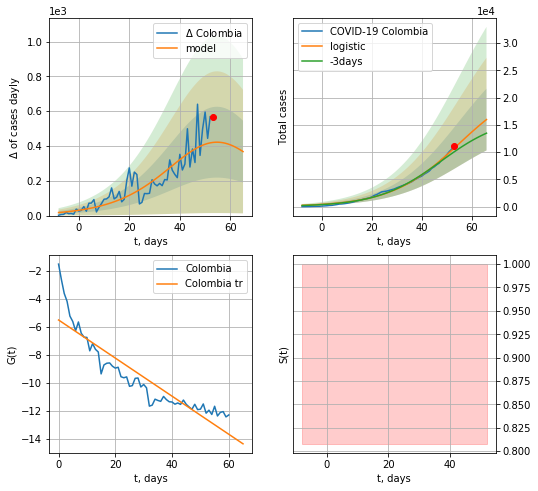

Colombia data at: 2020-05-10
+3 day model MAPE: 0.07540635536305706
model: logistic
coeffs:  [2.32407188e+04 7.26175600e-02 5.51831109e+01]
rational stdev:  0.35462240296810843
forecast at the end of period: +13 days
	 deltaDaycases:  367
	 total cases:  15963 ± 5660
	 total death:  668 ± 710
trend coefficient of determination: 0.832338
 intercept: -5.495369
 slope: -0.136141


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


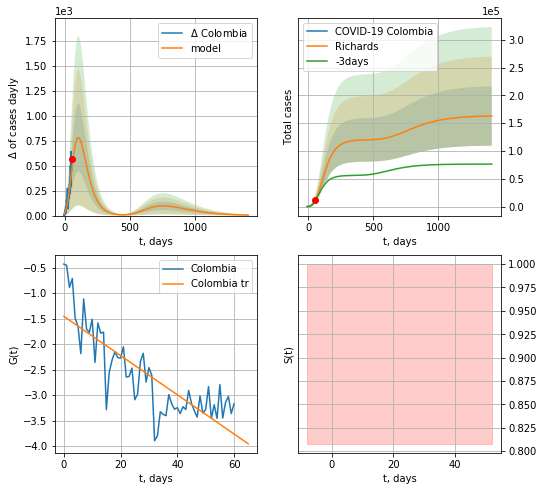

Colombia data at: 2020-05-10
+3 day model MAPE: 0.052644
model: Richards
coeffs: [ 1.20278024e+05  8.29309881e-01 -1.11429311e+02  2.14929365e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.327314
forecast at the end of period: +1357 days
	 deltaDaycases: 4
	 total cases: 163061 ± 53372
	 total death: 6824 ± 6700
trend coefficient of determination: 0.668145
 intercept: -1.453524
 slope: -0.038492


In [290]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


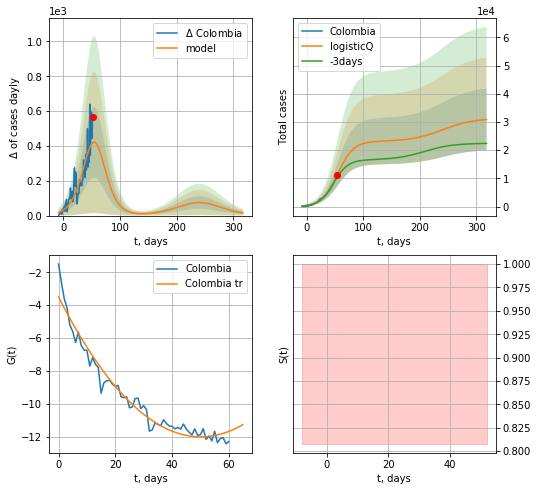

Colombia data at: 2020-05-10
+3 day model MAPE: 0.075090
model: logisticQ
coeffs: [ 2.31275899e+04  3.14658921e-06  5.50544806e+01 -2.30906341e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354643
forecast at the end of period: +265 days
	 deltaDaycases: 15
	 total cases: 30872 ± 10948
	 total death: 1292 ± 1374
trend coefficient of determination: 0.959737
 intercept_: -3.5021726936205813
 coeffs_: [ 0.         -0.33887586  0.00337921]


In [291]:
x = forecastRRR("Colombia",dfCB[:],d1,44*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
63 2020-05-06  4997.0  2324.0  476.0
64 2020-05-07  5182.0  2376.0  483.0
65 2020-05-08  5369.0  2414.0  488.0
66 2020-05-09  5558.0  2518.0  494.0
67 2020-05-10  5723.0  2543.0  502.0


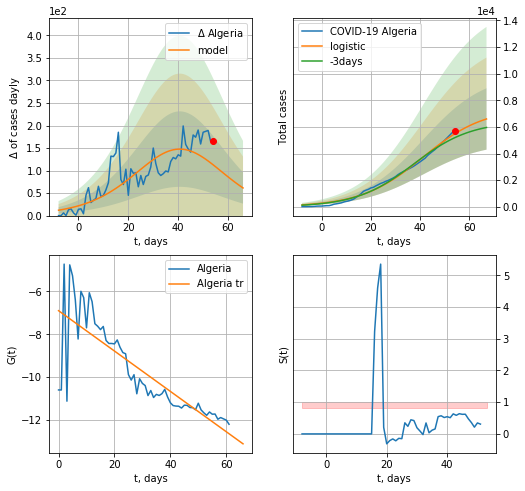

Algeria data at: 2020-05-10
+3 day model MAPE: 0.06062332316610927
model: logistic
coeffs:  [7.44272015e+03 7.93537481e-02 4.11268370e+01]
rational stdev:  0.3490180192692767
forecast at the end of period: +13 days
	 deltaDaycases:  61
	 total cases:  6596 ± 2302
	 total death:  578 ± 605
trend coefficient of determination: 0.679667
 intercept: -6.899983
 slope: -0.094102


In [292]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


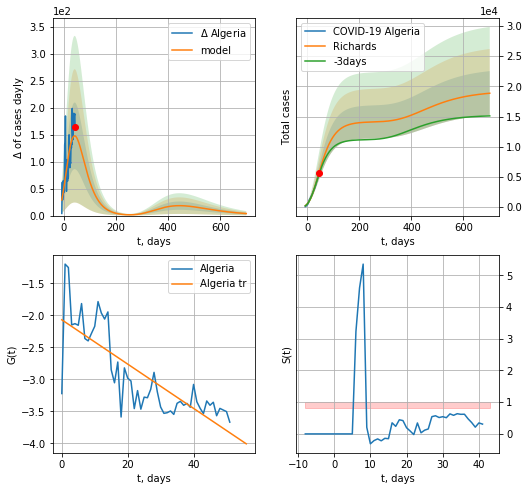

Algeria data at: 2020-05-10
+3 day model MAPE: 0.037162
model: Richards
coeffs: [ 1.41341444e+04  2.03971467e+00 -1.06935380e+02  1.40570776e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.194105
forecast at the end of period: +657 days
	 deltaDaycases: 3
	 total cases: 18859 ± 3660
	 total death: 1654 ± 963
trend coefficient of determination: 0.636530
 intercept: -2.067743
 slope: -0.034621


In [293]:
x = forecastRR("Algeria",dfAR[15:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


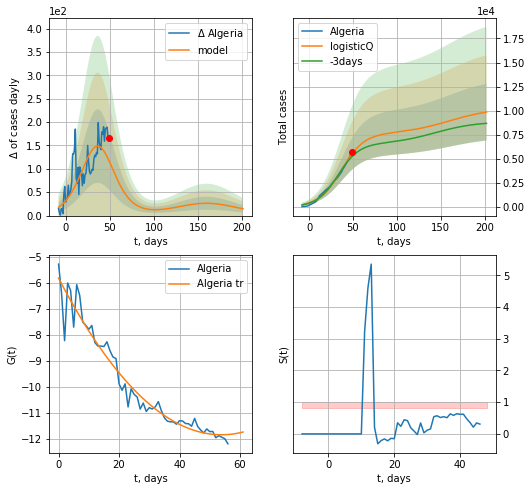

Algeria data at: 2020-05-10
+3 day model MAPE: 0.056729
model: logisticQ
coeffs: [ 7.60072273e+03  1.32181139e-06  3.67255010e+01 -5.88216763e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299232
forecast at the end of period: +153 days
	 deltaDaycases: 14
	 total cases: 9855 ± 2949
	 total death: 864 ± 775
trend coefficient of determination: 0.947425
 intercept_: -5.810838559428023
 coeffs_: [ 0.         -0.22418889  0.00208075]


In [294]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

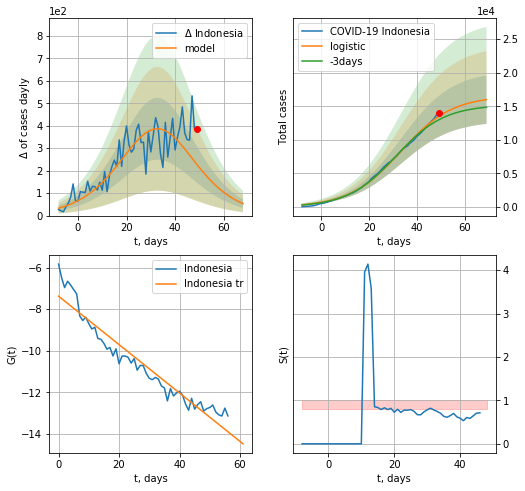

Indonesia data at: 2020-05-10
+3 day model MAPE: 0.04110540580045992
model: logistic
coeffs:  [1.65632427e+04 9.33706274e-02 3.32206985e+01]
rational stdev:  0.22562629578746343
forecast at the end of period: +20 days
	 deltaDaycases:  53
	 total cases:  15996 ± 3609
	 total death:  1109 ± 750
trend coefficient of determination: 0.925281
 intercept: -7.375777
 slope: -0.116512


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


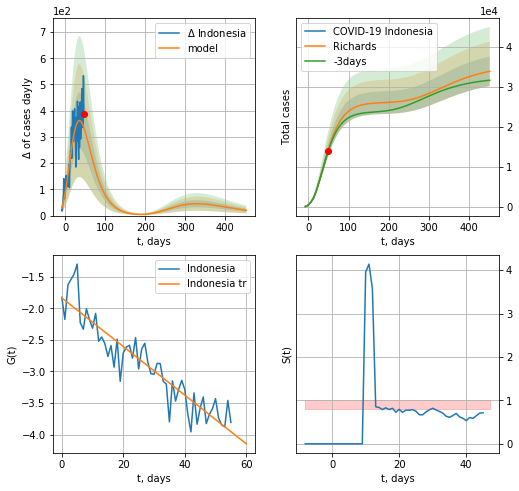

Indonesia data at: 2020-05-10
+3 day model MAPE: 0.015834
model: Richards
coeffs: [ 2.61180475e+04  1.67201521e+00 -6.27098585e+01  2.28095633e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.109092
forecast at the end of period: +405 days
	 deltaDaycases: 20
	 total cases: 33873 ± 3695
	 total death: 2348 ± 768
trend coefficient of determination: 0.851572
 intercept: -1.835021
 slope: -0.038532


In [295]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,64*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


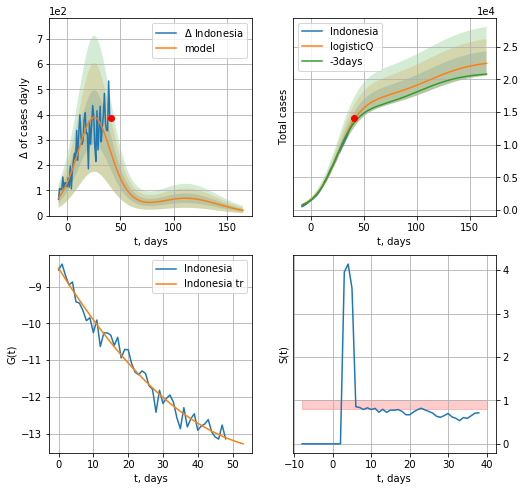

Indonesia data at: 2020-05-10
+3 day model MAPE: 0.035323
model: logisticQ
coeffs: [ 1.69352287e+04  7.65026647e-06  2.57944372e+01 -1.18280897e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.082860
forecast at the end of period: +125 days
	 deltaDaycases: 20
	 total cases: 22452 ± 1860
	 total death: 1556 ± 386
trend coefficient of determination: 0.976529
 intercept_: -8.498096761291745
 coeffs_: [ 0.         -0.15239164  0.00117496]


In [296]:
x = forecastRRR("Indonesia",dfIE[13:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


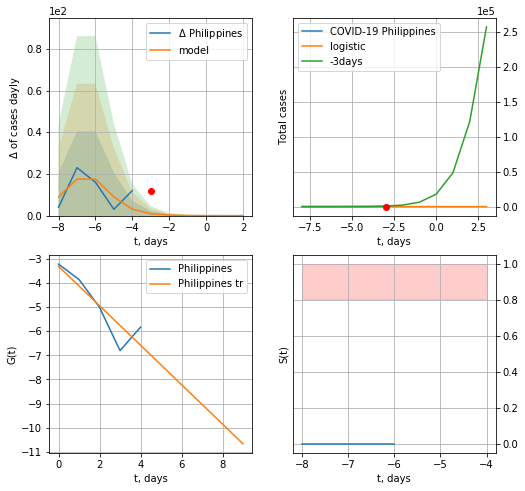

Philippines data at: 2020-05-10
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


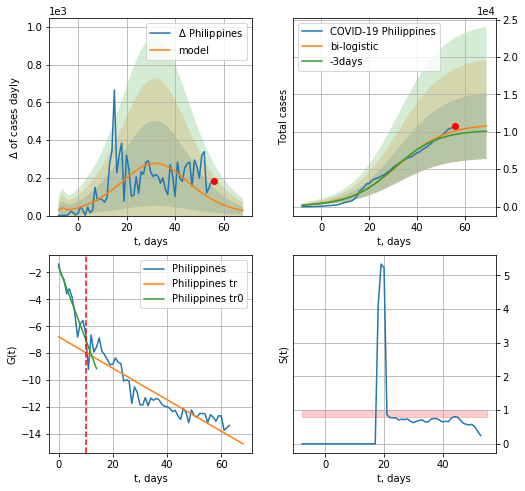

Philippines data at: 2020-05-10
+3 day model MAPE: 0.0514676065807898
model: bi-logistic
coeffs:  [1.09710708e+04 1.01234832e-01 3.22149929e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.40992556983578404
forecast at the end of period: +13 days
	 deltaDaycases:  26
	 total cases:  10773 ± 4416
	 total death:  717 ± 881
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.842540
 intercept: -6.781183
 slope: -0.116908


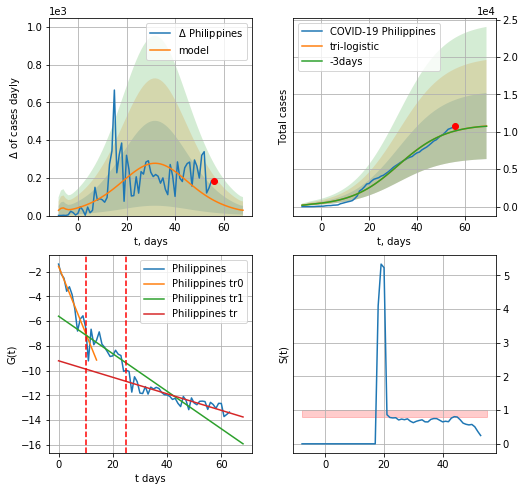

Philippines data at: 2020-05-10
+3 day model MAPE: 2.1816783990809468e-10
model: tri-logistic
coeffs:  [34.7738377   1.48591532 70.80975687] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.09710708e+04
  1.01234832e-01  3.22149929e+01]
forecast rational stdev:  0.4099255698357692
forecast at the end of period: +13 days
	 deltaDaycases:  28
	 total cases:  10776 ± 4417
	 total death:  717 ± 881
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.772849
 intercept: -9.208848
 slope: -0.066858


In [297]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,7*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


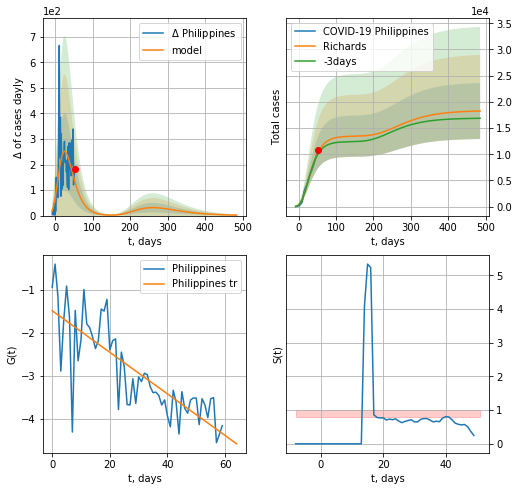

Philippines data at: 2020-05-10
+3 day model MAPE: 0.032657
model: Richards
coeffs: [ 1.34742868e+04  5.08938332e+00 -6.46369781e+01  1.00181861e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.293039
forecast at the end of period: +433 days
	 deltaDaycases: 1
	 total cases: 18260 ± 5350
	 total death: 1216 ± 1069
trend coefficient of determination: 0.651519
 intercept: -1.482989
 slope: -0.048501


In [298]:
x = forecastRR("Philippines",dfPH[4:],d1,68*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


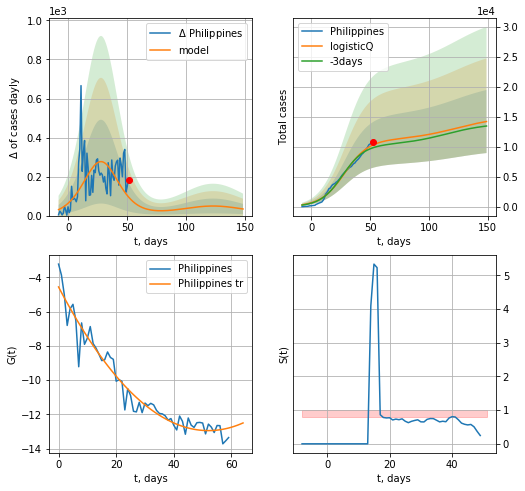

Philippines data at: 2020-05-10
+3 day model MAPE: 0.048772
model: logisticQ
coeffs: [ 1.11253204e+04  9.10397009e-07  2.82842597e+01 -1.08560201e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370519
forecast at the end of period: +97 days
	 deltaDaycases: 33
	 total cases: 14207 ± 5264
	 total death: 946 ± 1051
trend coefficient of determination: 0.945671
 intercept_: -4.554064919074316
 coeffs_: [ 0.         -0.32302001  0.00310622]


In [299]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
67 2020-05-06   2663    1142  147.0
68 2020-05-07   2678    1156  148.0
69 2020-05-08   2691    1167  150.0
70 2020-05-09   2710    1185  151.0
71 2020-05-10   2716    1191  151.0


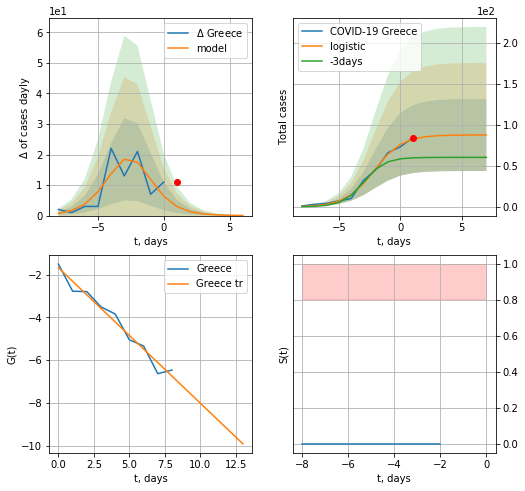

Greece data at: 2020-05-10
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


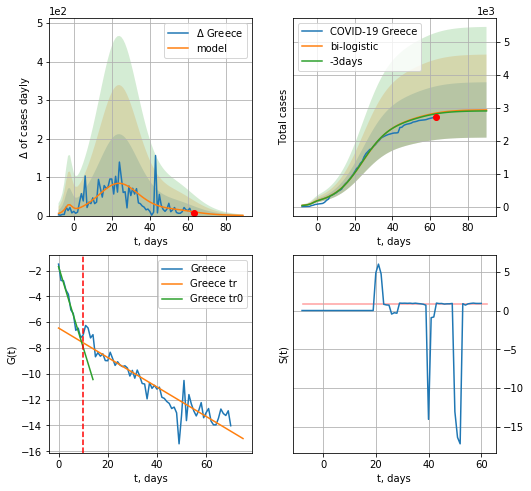

Greece data at: 2020-05-10
+3 day model MAPE: 0.008011585578096935
model: bi-logistic
coeffs:  [2.53366362e+03 1.31482071e-01 2.41133906e+01] [87.54984336  0.87627722 -2.15069813]
scenario coeffs:  [0.125, 1.0, 2.3]
rational stdev:  0.28620465989157934
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2934 ± 839
	 total death:  163 ± 139
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.860315
 intercept: -6.455388
 slope: -0.114154


In [300]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,7*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=True,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


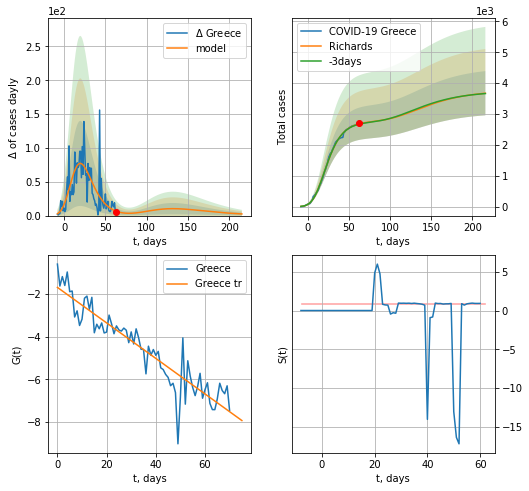

Greece data at: 2020-05-10
+3 day model MAPE: 0.004571
model: Richards
coeffs: [ 2.76318075e+03  4.86803129e-01 -1.52486942e+00  1.68931871e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.194892
forecast at the end of period: +153 days
	 deltaDaycases: 2
	 total cases: 3673 ± 715
	 total death: 204 ± 119
trend coefficient of determination: 0.851438
 intercept: -1.682607
 slope: -0.083224


In [301]:
x = forecastRR("Greece",dfGC[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


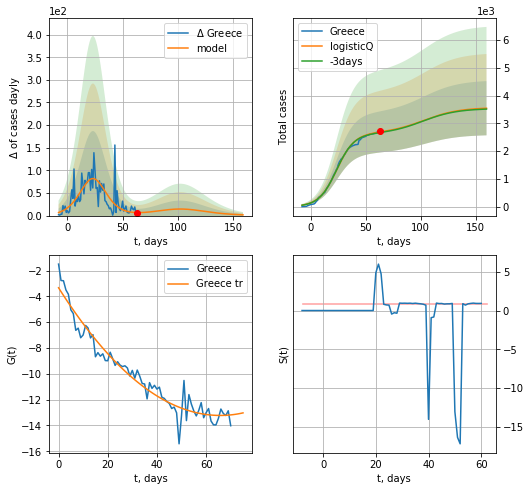

Greece data at: 2020-05-10
+3 day model MAPE: 0.008552
model: logisticQ
coeffs: [ 2.63789802e+03  1.02926158e-06  2.35560133e+01 -1.19918235e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275396
forecast at the end of period: +97 days
	 deltaDaycases: 1
	 total cases: 3546 ± 976
	 total death: 197 ± 162
trend coefficient of determination: 0.940622
 intercept_: -3.3357064054461585
 coeffs_: [ 0.         -0.30107303  0.00229103]


In [302]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
61 2020-05-06   3150    1966  383.0
62 2020-05-07   3178    1921  392.0
63 2020-05-08   3213    1904  405.0
64 2020-05-09   3263    1917  413.0
65 2020-05-10   3263    1917  413.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

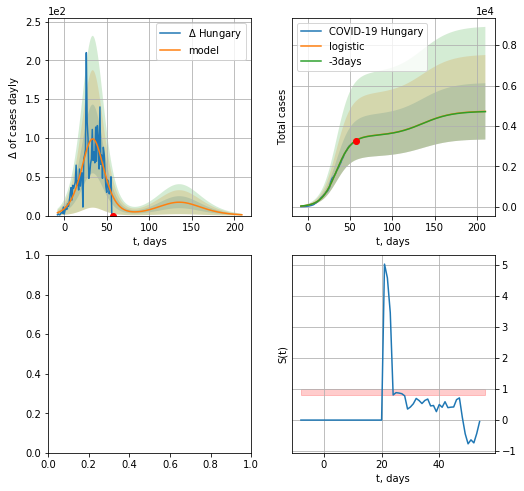

In [303]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


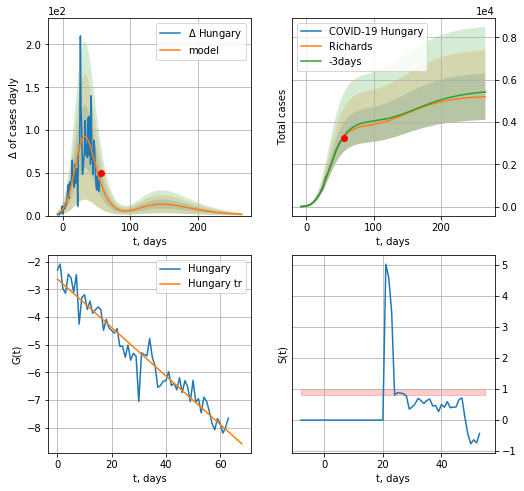

Hungary data at: 2020-05-09
+3 day model MAPE: 0.015731
model: Richards
coeffs: [3.85435179e+03 1.83787009e-01 2.22799205e+01 4.29244529e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.211323
forecast at the end of period: +210 days
	 deltaDaycases: 1
	 total cases: 5195 ± 1097
	 total death: 657 ± 416
trend coefficient of determination: 0.937285
 intercept: -2.628163
 slope: -0.087551


In [546]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


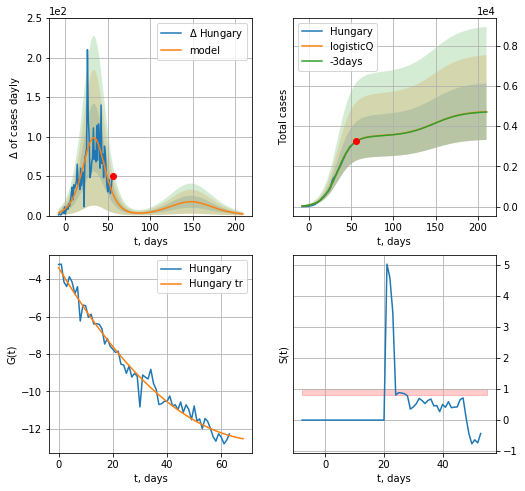

Hungary data at: 2020-05-09
+3 day model MAPE: 0.002547
model: logisticQ
coeffs: [ 3.51118191e+03  2.95310905e-06  3.39612551e+01 -3.80108288e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.297328
forecast at the end of period: +154 days
	 deltaDaycases: 2
	 total cases: 4718 ± 1402
	 total death: 597 ± 532
trend coefficient of determination: 0.977444
 intercept_: -3.3860665792807136
 coeffs_: [ 0.         -0.24262581  0.00159169]


In [320]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


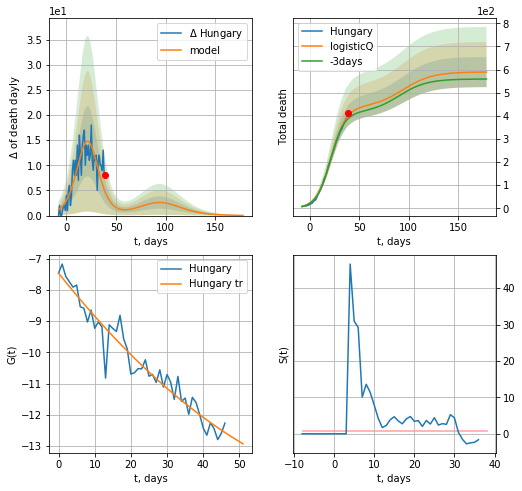

Hungary data at: 2020-05-09
+3 day model MAPE: 0.034351
model: logisticQ
coeffs: [ 4.35419122e+02  5.87957304e-05  2.16268216e+01 -2.27650628e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.110468
forecast at the end of period: +140 days
	 total death: 589 ± 65
trend coefficient of determination: 0.937990
 intercept_: -7.466922761764399
 coeffs_: [ 0.         -0.14544714  0.00075136]


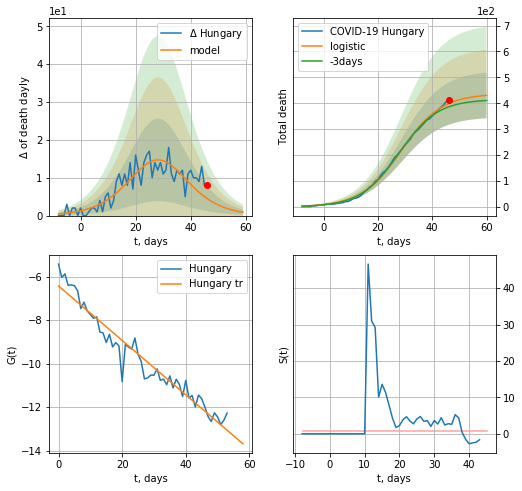

Hungary data at: 2020-05-09
+3 day model MAPE: 0.034169606354157486
model: logistic
coeffs:  [4.36838390e+02 1.34755330e-01 2.86653541e+01]
rational stdev:  0.20467306288059445
forecast at the end of period: +14 days
	 total death:  430 ± 88
trend coefficient of determination: 0.940182
 intercept: -6.432020
 slope: -0.124987


In [321]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
59 2020-05-06  484.0      72    5.0
60 2020-05-07  486.0      68    5.0
61 2020-05-08  489.0      65    5.0
62 2020-05-09  490.0      58    5.0
63 2020-05-10  496.0      58    5.0


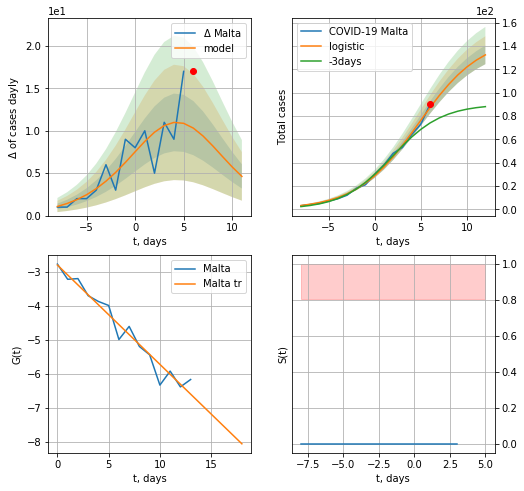

Malta data at: 2020-05-10
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +6 days
	 deltaDaycases:  4
	 total cases:  132 ± 7
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


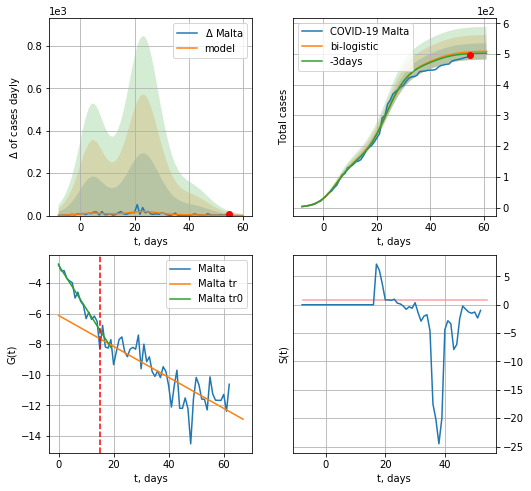

Malta data at: 2020-05-10
+3 day model MAPE: 0.011294214695907885
model: bi-logistic
coeffs:  [3.21649479e+02 2.34267047e-01 2.37480560e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.05221843394226469
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  509 ± 26
	 total death:  5 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.679449
 intercept: -6.127967
 slope: -0.101147


In [305]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


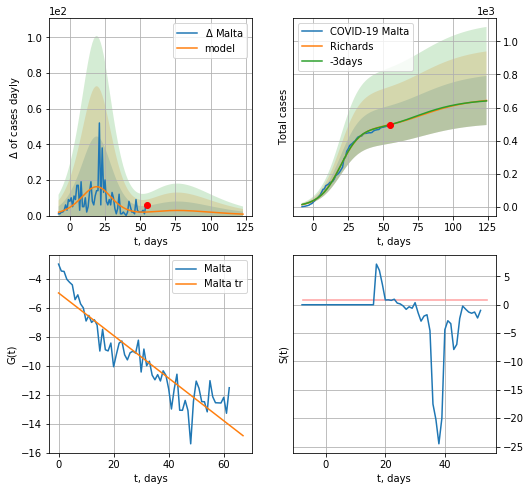

Malta data at: 2020-05-10
+3 day model MAPE: 0.000974
model: Richards
coeffs: [4.85017829e+02 1.21849216e-01 2.04951353e+01 1.14453640e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.230056
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 642 ± 147
	 total death: 6 ± 4
trend coefficient of determination: 0.849288
 intercept: -4.965828
 slope: -0.147254


In [306]:
x = forecastRR("Malta",dfMT[:],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


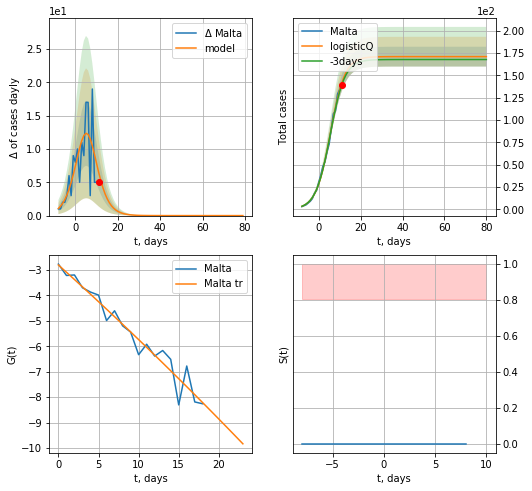

Malta data at: 2020-05-10
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


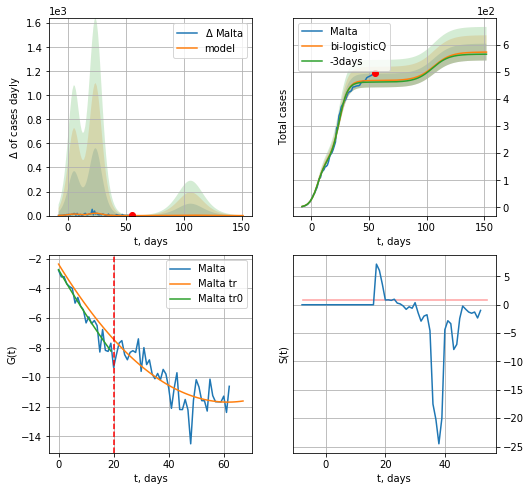

Malta data at: 2020-05-10
+3 day model MAPE: 0.012382
model: bi-logisticQ
coeffs: [ 2.96421894e+02  1.27722806e-06  2.43825711e+01 -2.05225390e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.054097
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 572 ± 30
	 total death: 5 ± 0
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.659550
 intercept_: -2.3519380566256416
 coeffs_: [ 0.         -0.30389308  0.00247213]


In [307]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
57 2020-05-06   1429   642.0   25.0
58 2020-05-07   1445   613.0   26.0
59 2020-05-08   1455   524.0   26.0
60 2020-05-09   1457   490.0   26.0
61 2020-05-10   1457   490.0   26.0


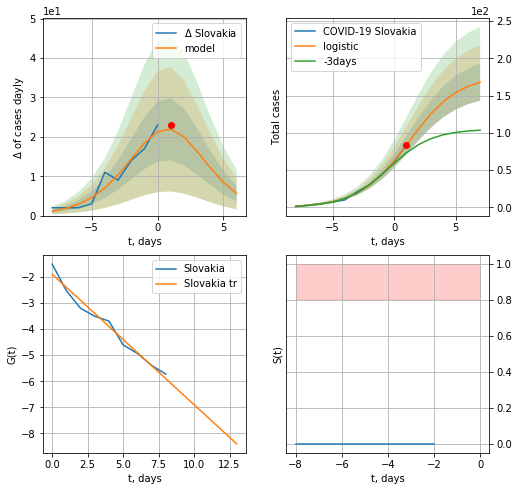

Slovakia data at: 2020-05-10
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +6 days
	 deltaDaycases:  5
	 total cases:  167 ± 24
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

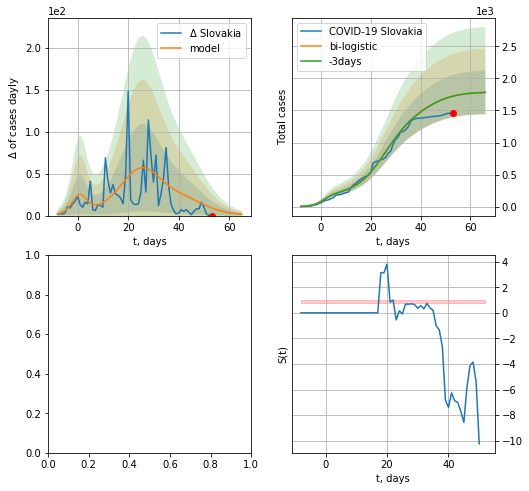

In [308]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


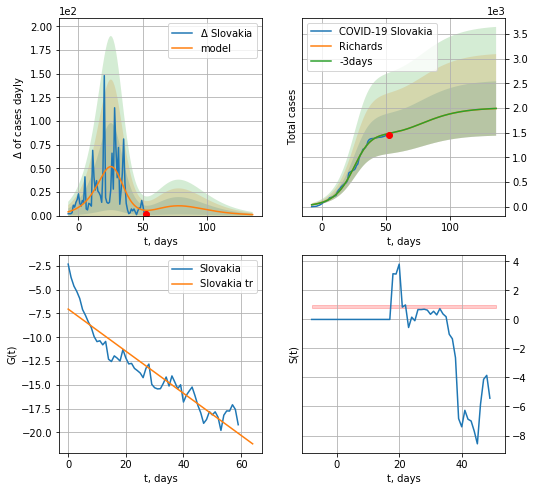

Slovakia data at: 2020-05-09
+3 day model MAPE: 0.000493
model: Richards
coeffs: [1.47229443e+03 9.92300640e-02 2.87546760e+01 1.73101574e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.277094
forecast at the end of period: +84 days
	 deltaDaycases: 1
	 total cases: 1988 ± 550
	 total death: 35 ± 29
trend coefficient of determination: 0.878260
 intercept: -7.037632
 slope: -0.221424


In [551]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=True,xcoef=RkoreaCoeffs)

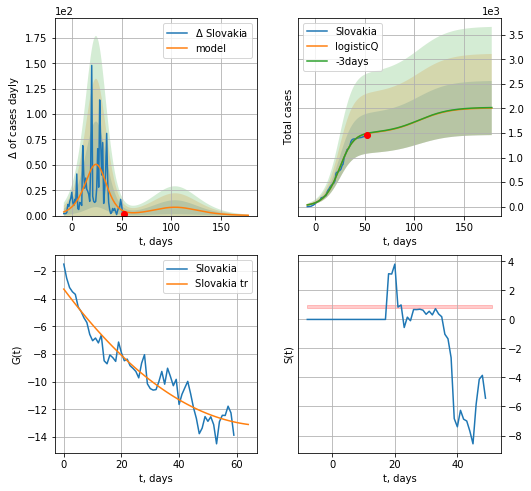

Slovakia data at: 2020-05-09
+3 day model MAPE: 0.003693
model: logisticQ
coeffs: [ 1.48665625e+03  5.64983925e-04  2.38052172e+01 -2.14960101e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.274293
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 2008 ± 550
	 total death: 35 ± 28
trend coefficient of determination: 0.911586
 intercept_: -3.3105954374051088
 coeffs_: [ 0.         -0.27864029  0.00196368]


In [401]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
62 2020-05-06  1448.0  1103.0   99.0
63 2020-05-07  1449.0  1103.0   99.0
64 2020-05-08  1450.0  1098.0  100.0
65 2020-05-09  1454.0  1098.0  101.0
66 2020-05-10  1457.0  1099.0  102.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


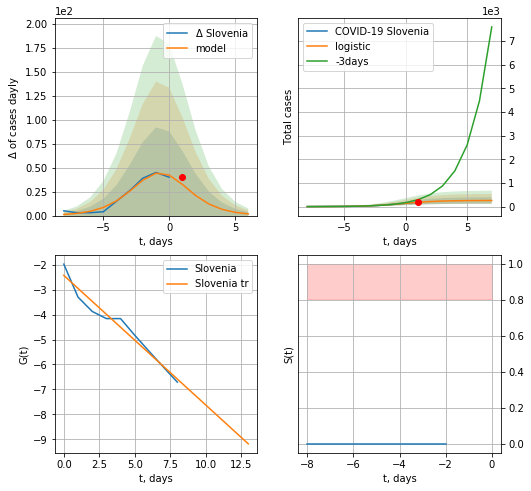

Slovenia data at: 2020-05-10
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  259 ± 137
	 total death:  18 ± 28
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


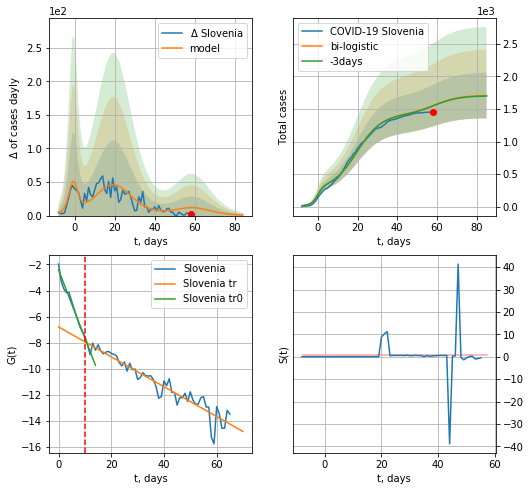

Slovenia data at: 2020-05-10
+3 day model MAPE: 0.0024873483858197576
model: bi-logistic
coeffs:  [1.16074277e+03 1.59219671e-01 1.97247501e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20552539927595384
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1707 ± 350
	 total death:  119 ± 73
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.907220
 intercept: -6.787456
 slope: -0.114508


In [310]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


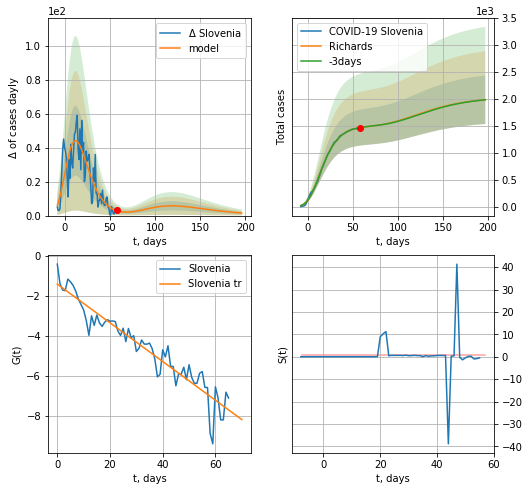

Slovenia data at: 2020-05-10
+3 day model MAPE: 0.001518
model: Richards
coeffs: [ 1.49491676e+03  6.81892666e-01 -1.18406734e+01  1.24698045e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.227130
forecast at the end of period: +139 days
	 deltaDaycases: 1
	 total cases: 1982 ± 450
	 total death: 138 ± 94
trend coefficient of determination: 0.901435
 intercept: -1.404327
 slope: -0.096675


In [311]:
x = forecastRR("Slovenia",dfSV[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp


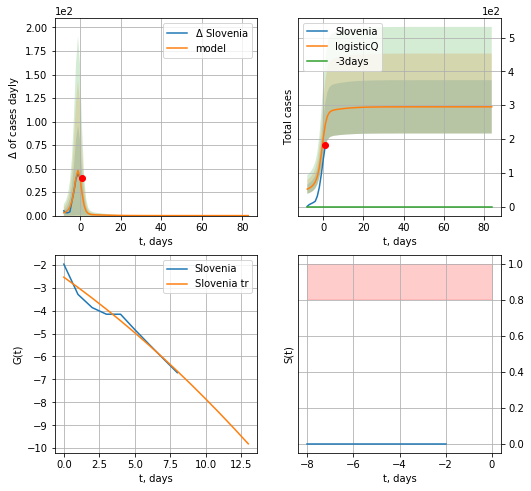

Slovenia data at: 2020-05-10
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


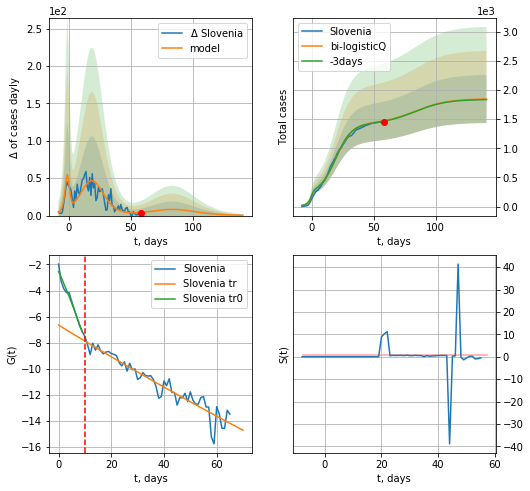

Slovenia data at: 2020-05-10
+3 day model MAPE: 0.004693
model: bi-logisticQ
coeffs: [ 1.20534834e+03  8.85940746e-07  1.91761185e+01 -1.73899871e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.223293
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 1845 ± 412
	 total death: 129 ± 86
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.907438
 intercept_: -6.650625741433389
 coeffs_: [ 0.00000000e+00 -1.23483191e-01  1.19779066e-04]


In [312]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
57 2020-05-06   9791  7617.0  203.0
58 2020-05-07   9848  7482.0  206.0
59 2020-05-08   9943  7281.0  209.0
60 2020-05-09  10032  7087.0  213.0
61 2020-05-10  10114  6893.0  215.0


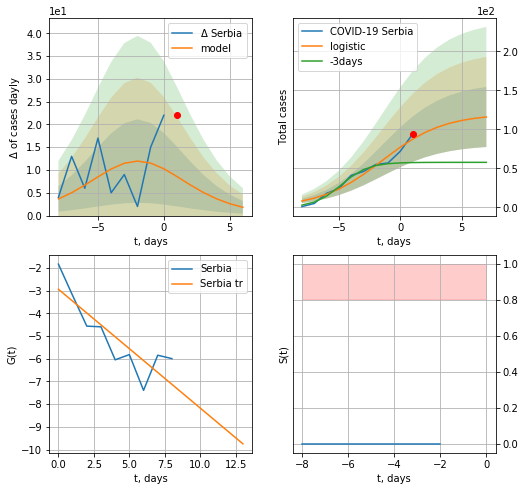

Serbia data at: 2020-05-10
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +6 days
	 deltaDaycases:  1
	 total cases:  115 ± 38
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


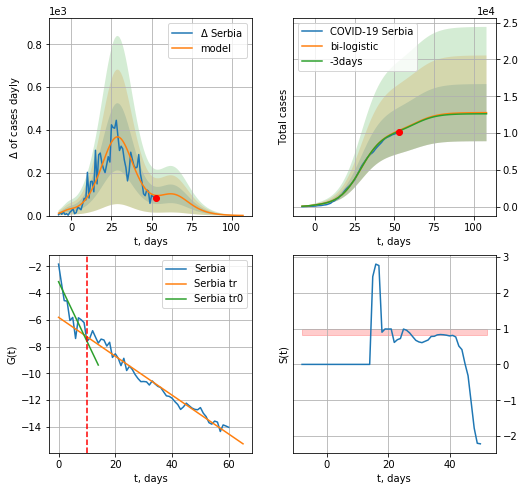

Serbia data at: 2020-05-10
+3 day model MAPE: 0.008113819763424427
model: bi-logistic
coeffs:  [1.01218744e+04 1.44558090e-01 2.91690834e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.3042088164024967
forecast at the end of period: +55 days
	 deltaDaycases:  0
	 total cases:  12767 ± 3884
	 total death:  271 ± 247
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.973453
 intercept: -5.810013
 slope: -0.145493


In [314]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


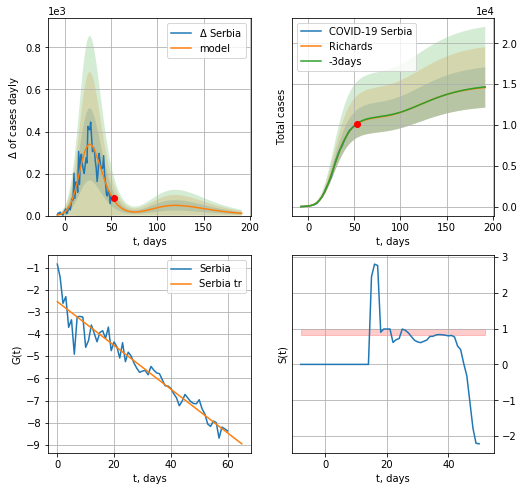

Serbia data at: 2020-05-10
+3 day model MAPE: 0.003693
model: Richards
coeffs: [1.09548167e+04 2.59318676e-01 1.79691444e+01 3.85601811e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.169411
forecast at the end of period: +139 days
	 deltaDaycases: 10
	 total cases: 14598 ± 2473
	 total death: 310 ± 157
trend coefficient of determination: 0.932975
 intercept: -2.537834
 slope: -0.098704


In [315]:
x = forecastRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


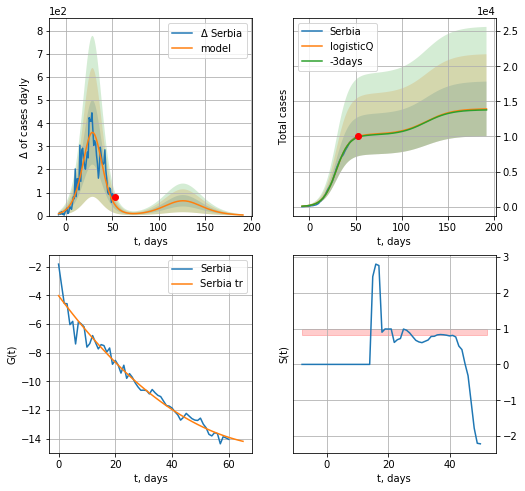

Serbia data at: 2020-05-10
+3 day model MAPE: 0.008349
model: logisticQ
coeffs: [ 1.03073609e+04  2.52007681e-06  2.90658770e+01 -5.54586240e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279909
forecast at the end of period: +139 days
	 deltaDaycases: 2
	 total cases: 13921 ± 3896
	 total death: 295 ± 247
trend coefficient of determination: 0.971097
 intercept_: -4.028985684355255
 coeffs_: [ 0.         -0.2657431   0.00168743]


In [316]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
67 2020-05-06   2119   433.0   85.0
68 2020-05-07   2125   398.0   86.0
69 2020-05-08   2161   386.0   86.0
70 2020-05-09   2176   363.0   87.0
71 2020-05-10   2187   333.0   90.0


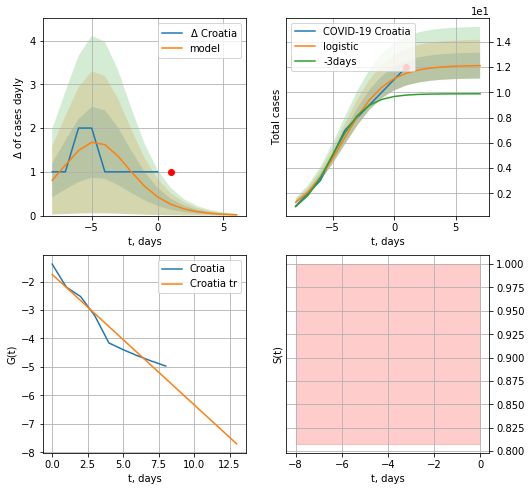

Croatia data at: 2020-05-10
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


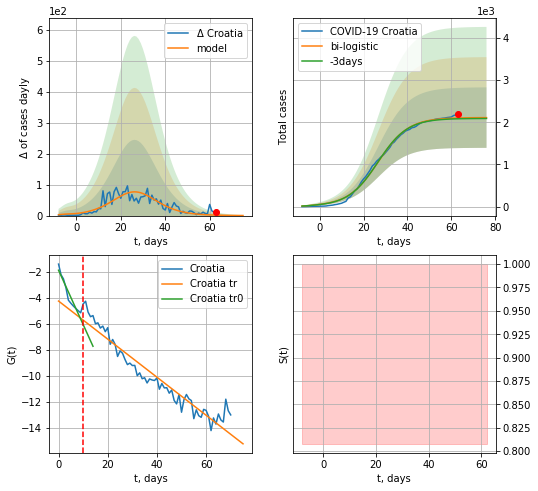

Croatia data at: 2020-05-10
+3 day model MAPE: 0.009118861930580324
model: bi-logistic
coeffs:  [2.10097653e+03 1.46034866e-01 2.67014950e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.33962704759663903
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  2111 ± 717
	 total death:  86 ± 87
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.920867
 intercept: -4.227145
 slope: -0.146388


In [318]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


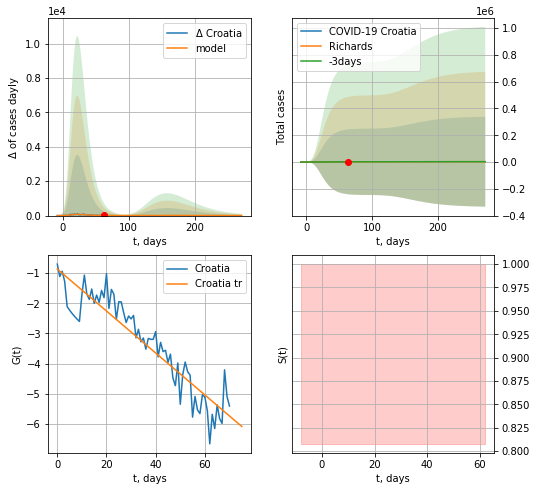

Croatia data at: 2020-05-10
+3 day model MAPE: 0.003055
model: Richards
coeffs: [ 2.21742867e+03  6.40105356e+00 -2.45662502e+01  1.40981399e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 111.603594
forecast at the end of period: +209 days
	 deltaDaycases: 0
	 total cases: 2997 ± 334503
	 total death: 123 ± 41181
trend coefficient of determination: 0.855417
 intercept: -0.866811
 slope: -0.069488


In [319]:
x = forecastRR("Croatia",dfCT[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


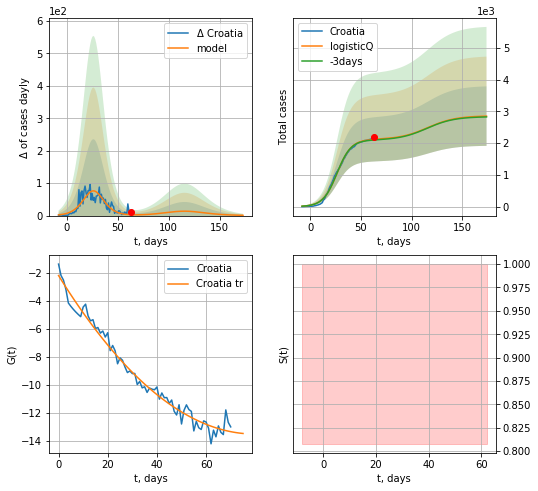

Croatia data at: 2020-05-10
+3 day model MAPE: 0.008978
model: logisticQ
coeffs: [ 2.11569352e+03  1.10152885e-06  2.66169659e+01 -1.30868457e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328486
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 2854 ± 937
	 total death: 117 ± 115
trend coefficient of determination: 0.978478
 intercept_: -2.2006774476402606
 coeffs_: [ 0.         -0.2829785   0.00177272]


In [320]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
61 2020-05-06   7588    5304  469.0
62 2020-05-07   7981    5612  482.0
63 2020-05-08   8476    6028  503.0
64 2020-05-09   8964    6448  514.0
65 2020-05-10   9400    6800  525.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


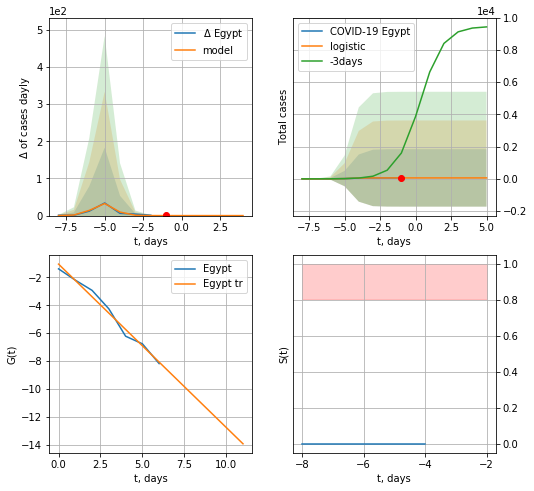

Egypt data at: 2020-05-10
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


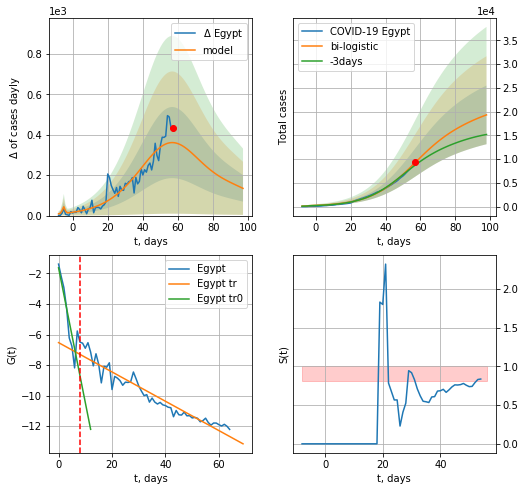

Egypt data at: 2020-05-10
+3 day model MAPE: 0.06896287254129149
model: bi-logistic
coeffs:  [1.74773868e+04 7.94094061e-02 5.62106740e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.31967904969981503
forecast at the end of period: +41 days
	 deltaDaycases:  134
	 total cases:  19321 ± 6176
	 total death:  1079 ± 1034
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.924662
 intercept: -6.531342
 slope: -0.096111


In [321]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


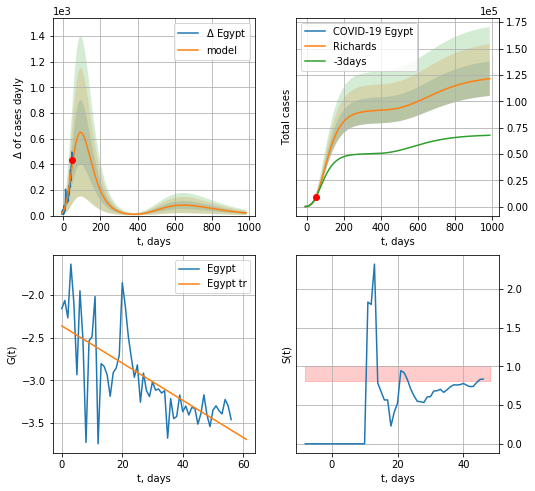

Egypt data at: 2020-05-10
+3 day model MAPE: 0.046094
model: Richards
coeffs: [ 9.15265348e+04  4.62208742e-01 -6.64456158e+01  4.25863378e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134670
forecast at the end of period: +937 days
	 deltaDaycases: 20
	 total cases: 121475 ± 16359
	 total death: 6784 ± 2740
trend coefficient of determination: 0.498951
 intercept: -2.363857
 slope: -0.021773


In [322]:
x = forecastRR("Egypt",dfEG[8:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


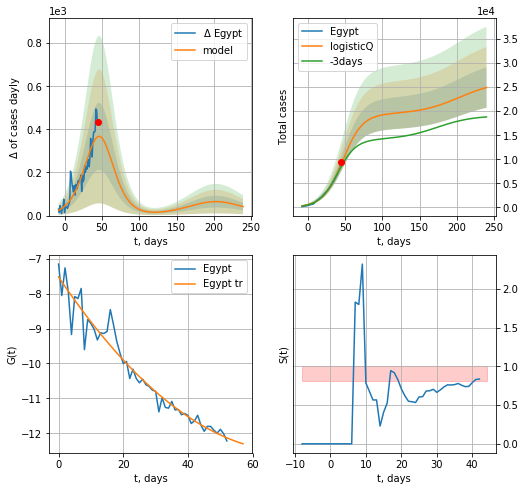

Egypt data at: 2020-05-10
+3 day model MAPE: 0.071501
model: logisticQ
coeffs: [ 1.94025598e+04  1.72120887e-05  4.65836325e+01 -4.34907202e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.168635
forecast at the end of period: +195 days
	 deltaDaycases: 41
	 total cases: 24910 ± 4200
	 total death: 1391 ± 703
trend coefficient of determination: 0.944778
 intercept_: -7.521727336018175
 coeffs_: [ 0.         -0.13802166  0.00095049]


In [323]:
x = forecastRRR("Egypt",dfEG[12:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
64 2020-05-06   2480   776.0  102.0
65 2020-05-07   2543   815.0  102.0
66 2020-05-08   2603   838.0  104.0
67 2020-05-09   2679   870.0  107.0
68 2020-05-10   2767   924.0  109.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


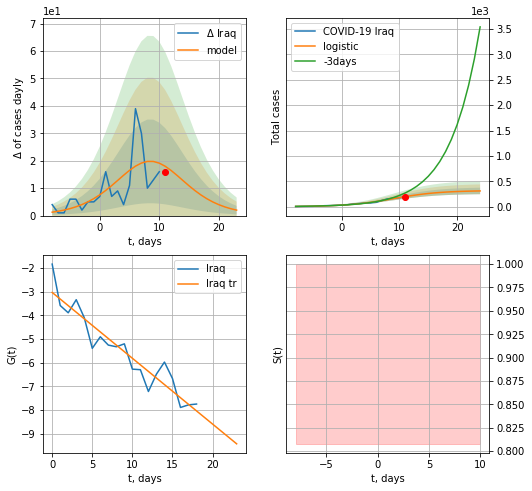

Iraq data at: 2020-05-10
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +13 days
	 deltaDaycases:  1
	 total cases:  309 ± 64
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


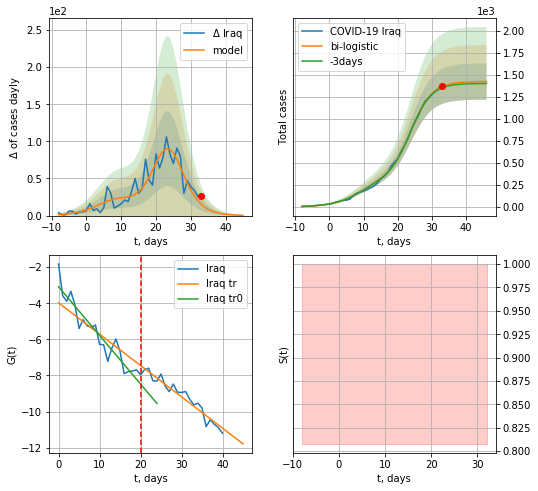

Iraq data at: 2020-05-10
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  1424 ± 207
	 total death:  56 ± 24
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


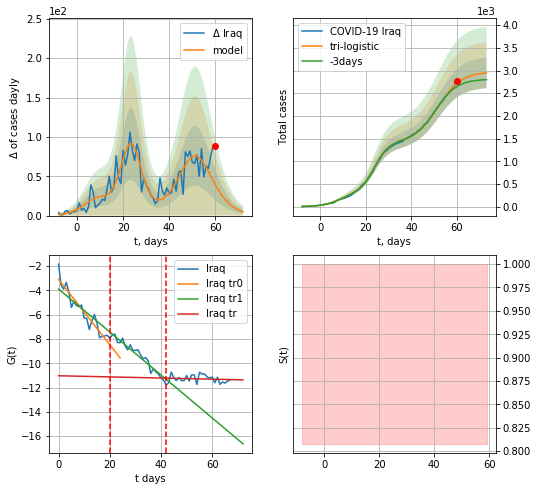

Iraq data at: 2020-05-10
+3 day model MAPE: 0.03023294014705344
model: tri-logistic
coeffs:  [1.54577448e+03 1.96436769e-01 5.17354771e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.11452717676269135
forecast at the end of period: +13 days
	 deltaDaycases:  4
	 total cases:  2948 ± 337
	 total death:  116 ± 39
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.012784
 intercept: -11.029217
 slope: -0.004680


In [324]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


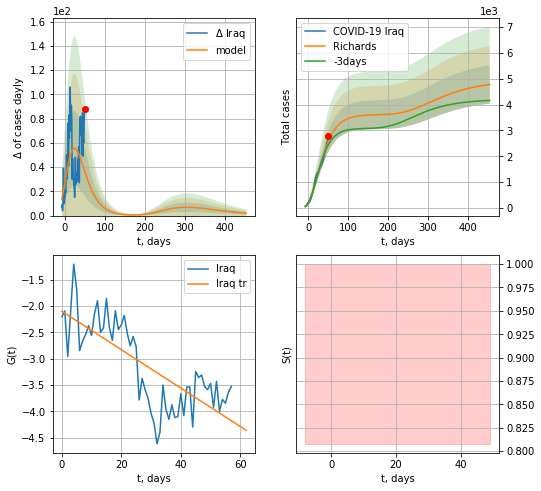

Iraq data at: 2020-05-10
+3 day model MAPE: 0.054228
model: Richards
coeffs: [ 3.61086705e+03  4.43567421e+00 -8.68681207e+01  9.45860377e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.155658
forecast at the end of period: +405 days
	 deltaDaycases: 1
	 total cases: 4774 ± 743
	 total death: 188 ± 87
trend coefficient of determination: 0.574516
 intercept: -2.097115
 slope: -0.036495


In [325]:
x = forecastRR("Iraq",dfIQ[10:],d1,64*7-dT,addpred=True,xcoef=RkoreaCoeffs)


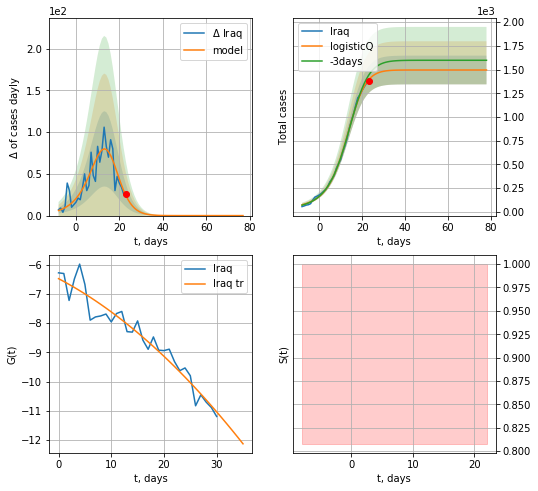

Iraq data at: 2020-05-10
+3 day model MAPE: 0.037622
model: logisticQ
coeffs: [ 1.49506808e+03  3.17947912e-03  1.23994223e+01 -5.37356409e+01]
rational stdev: 0.101331
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 1495 ± 151
	 total death: 58 ± 17
trend coefficient of determination: 0.935701
 intercept_: -6.475161114969037
 coeffs_: [ 0.         -0.094783   -0.00191217]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


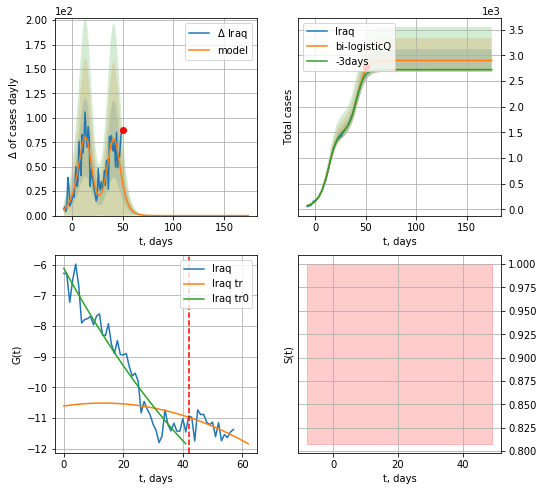

Iraq data at: 2020-05-10
+3 day model MAPE: 0.038895
model: bi-logisticQ
coeffs: [ 1.40427630e+03  7.60444725e-06  4.17324332e+01 -2.94636843e+04]
rational stdev: 0.075179
forecast at the end of period: +125 days
	 deltaDaycases: 0
	 total cases: 2899 ± 217
	 total death: 114 ± 25
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.938502
 intercept_: -6.116864757771229
 coeffs_: [ 0.         -0.176838    0.00090835]
trend coefficient of determination: 0.338055
 intercept_: -10.607973180401089
 coeffs_: [ 0.          0.01461594 -0.00055615]


In [326]:
x = forecastRRR("Iraq",dfIQ[10:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [327]:
#len(dfAR)

AR
          date   cases  active  death
63 2020-05-06  4997.0  2324.0  476.0
64 2020-05-07  5182.0  2376.0  483.0
65 2020-05-08  5369.0  2414.0  488.0
66 2020-05-09  5558.0  2518.0  494.0
67 2020-05-10  5723.0  2543.0  502.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


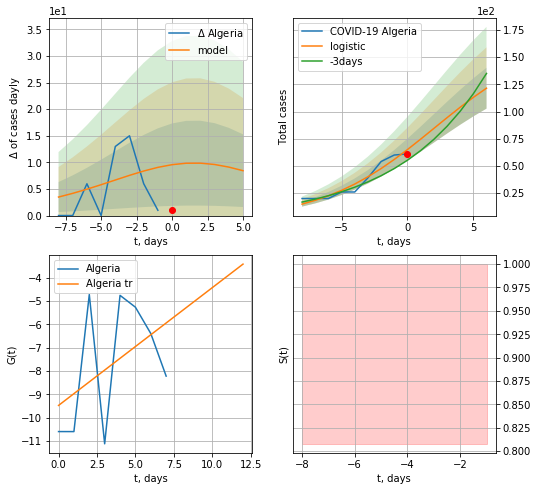

Algeria data at: 2020-05-10
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +6 days
	 deltaDaycases:  8
	 total cases:  121 ± 18
	 total death:  10 ± 4
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


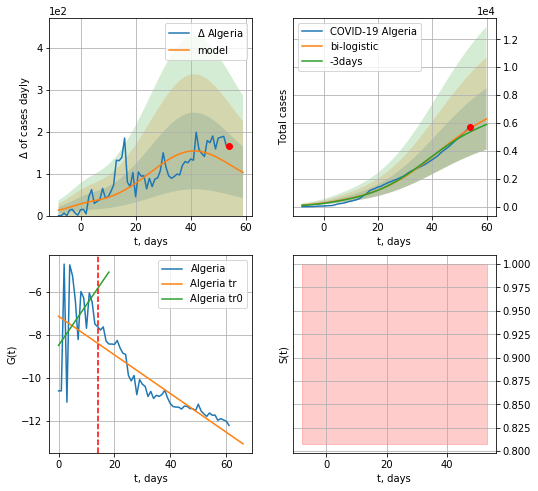

Algeria data at: 2020-05-10
+3 day model MAPE: 0.051129592975086714
model: bi-logistic
coeffs:  [7.08467295e+03 8.45870265e-02 4.10982951e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.34865863245856776
forecast at the end of period: +6 days
	 deltaDaycases:  102
	 total cases:  6298 ± 2195
	 total death:  552 ± 577
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.868412
 intercept: -7.142130
 slope: -0.089549


In [328]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


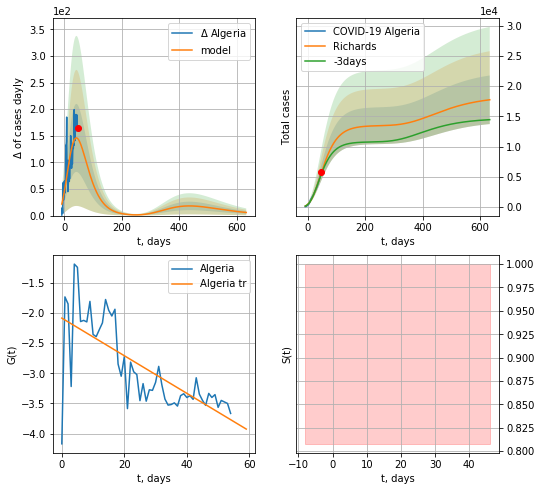

Algeria data at: 2020-05-10
+3 day model MAPE: 0.038317
model: Richards
coeffs: [ 1.34838670e+04  2.16718795e+00 -1.01738964e+02  1.36672581e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.226566
forecast at the end of period: +587 days
	 deltaDaycases: 5
	 total cases: 17755 ± 4022
	 total death: 1557 ± 1058
trend coefficient of determination: 0.512584
 intercept: -2.088125
 slope: -0.031105


In [329]:
x = forecastRR("Algeria",dfAR[12:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


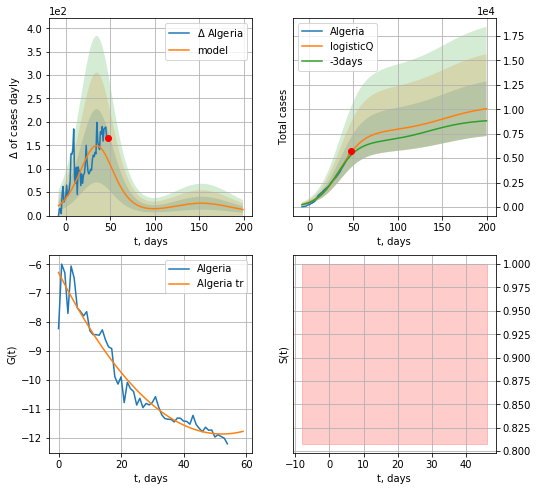

Algeria data at: 2020-05-10
+3 day model MAPE: 0.054658
model: logisticQ
coeffs: [ 7.70392288e+03  1.72023949e-06  3.51120729e+01 -4.46358671e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277047
forecast at the end of period: +153 days
	 deltaDaycases: 12
	 total cases: 10050 ± 2784
	 total death: 881 ± 732
trend coefficient of determination: 0.939170
 intercept_: -6.285891834199292
 coeffs_: [ 0.         -0.21308172  0.00203652]


In [330]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
55 2020-05-06  883.0   572.0   15.0
56 2020-05-07  889.0   474.0   15.0
57 2020-05-08  891.0   476.0   15.0
58 2020-05-09  892.0   476.0   15.0
59 2020-05-10  898.0   481.0   16.0


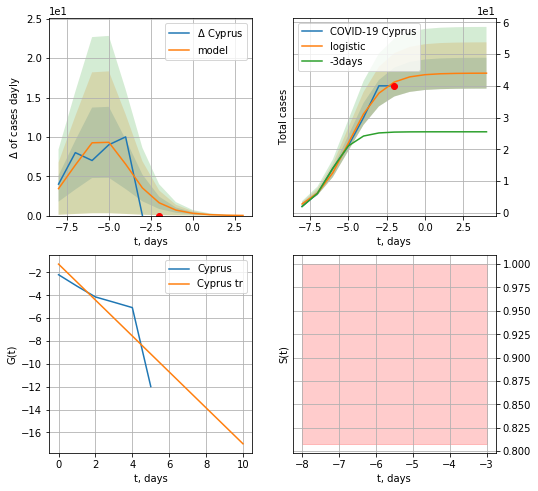

Cyprus data at: 2020-05-10
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  43 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


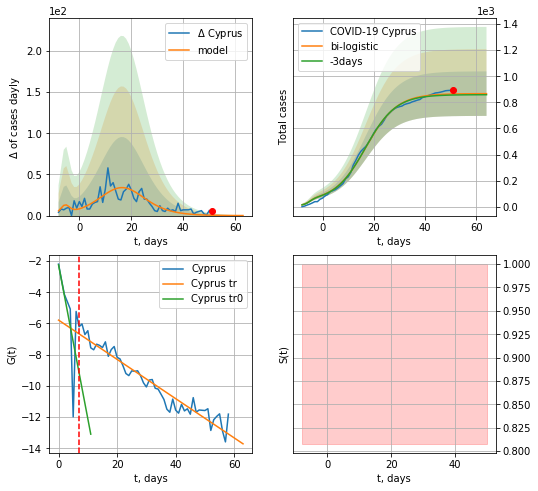

Cyprus data at: 2020-05-10
+3 day model MAPE: 0.0092677330121831
model: bi-logistic
coeffs:  [8.23106565e+02 1.65434051e-01 1.69192279e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19651877473857224
forecast at the end of period: +13 days
	 deltaDaycases:  0
	 total cases:  866 ± 170
	 total death:  15 ± 8
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.932623
 intercept: -5.784104
 slope: -0.125811


In [331]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,7*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


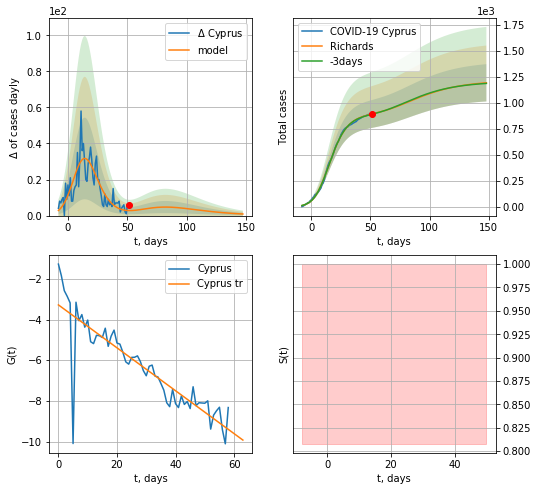

Cyprus data at: 2020-05-10
+3 day model MAPE: 0.002822
model: Richards
coeffs: [8.93169303e+02 2.44610501e-01 8.56989689e+00 4.87682152e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.150248
forecast at the end of period: +97 days
	 deltaDaycases: 0
	 total cases: 1194 ± 179
	 total death: 21 ± 9
trend coefficient of determination: 0.763018
 intercept: -3.282719
 slope: -0.105400


In [332]:
x = forecastRR("Cyprus",dfCP[:],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


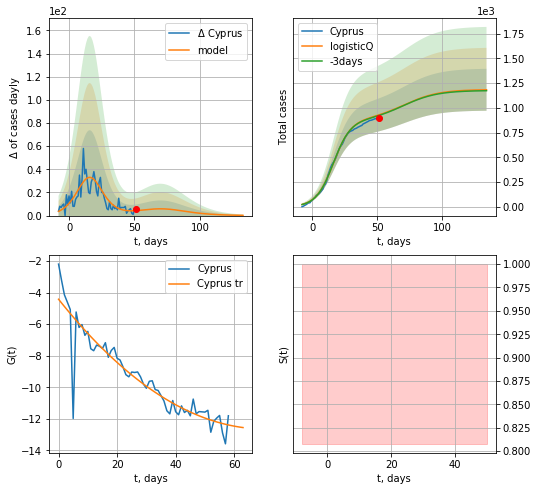

Cyprus data at: 2020-05-10
+3 day model MAPE: 0.006161
model: logisticQ
coeffs: [ 8.74985776e+02  1.99037222e-06  1.62029273e+01 -7.51003989e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.179097
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 1182 ± 211
	 total death: 21 ± 11
trend coefficient of determination: 0.847993
 intercept_: -4.422968554421251
 coeffs_: [ 0.         -0.23339085  0.00165534]


In [333]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
60 2020-05-06  54817  35757.0  1533.0
61 2020-05-07  58526  38511.0  1627.0
62 2020-05-08  61847  41121.0  1714.0
63 2020-05-09  65015  42955.0  1814.0
64 2020-05-10  67307  44069.0  1889.0


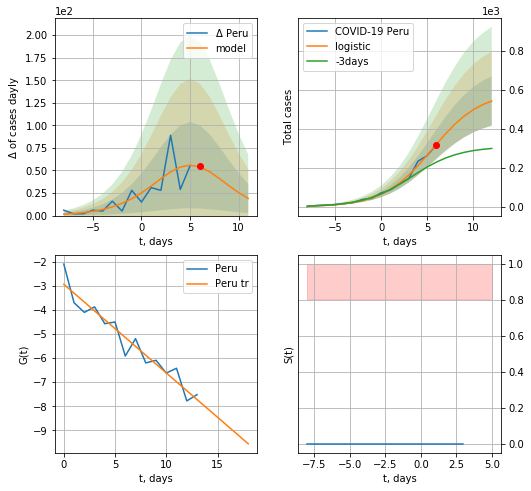

Peru data at: 2020-05-10
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +6 days
	 deltaDaycases:  19
	 total cases:  542 ± 126
	 total death:  15 ± 10
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


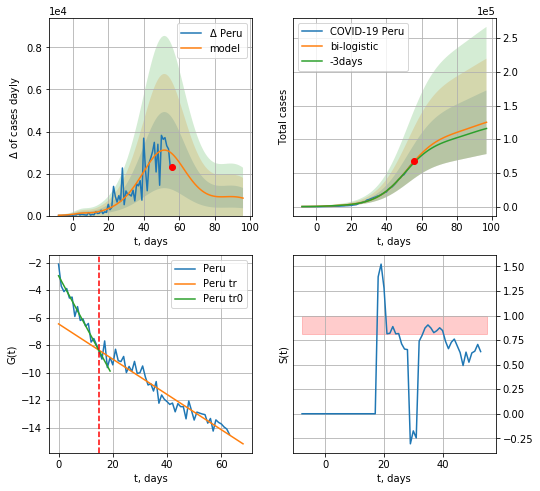

Peru data at: 2020-05-10
+3 day model MAPE: 0.02972350285966619
model: bi-logistic
coeffs:  [1.08986323e+05 1.13429314e-01 5.20077308e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37700338680290807
forecast at the end of period: +41 days
	 deltaDaycases:  830
	 total cases:  125124 ± 47172
	 total death:  3511 ± 3970
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.933857
 intercept: -6.452625
 slope: -0.128401


In [334]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


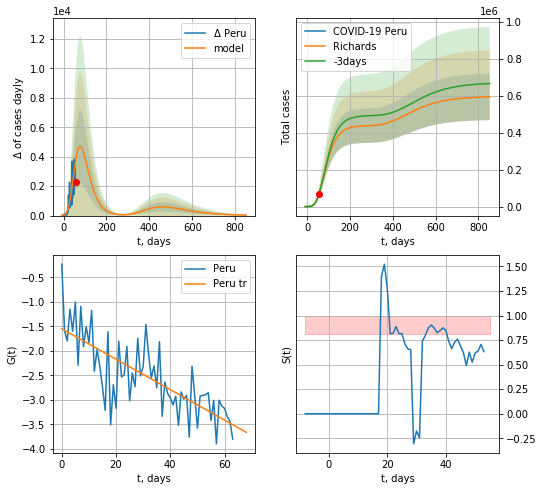

Peru data at: 2020-05-10
+3 day model MAPE: 0.006399
model: Richards
coeffs: [ 4.38357188e+05  7.83703652e-01 -3.20149124e+01  3.79307761e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.212185
forecast at the end of period: +797 days
	 deltaDaycases: 29
	 total cases: 594260 ± 126093
	 total death: 16678 ± 10616
trend coefficient of determination: 0.557295
 intercept: -1.547669
 slope: -0.031112


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


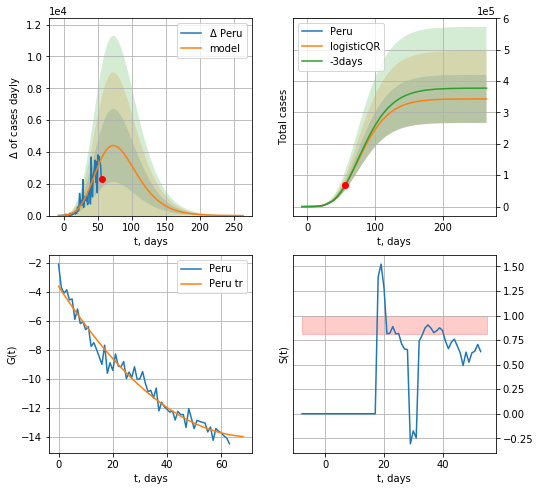

Peru data at: 2020-05-10
+3 day model MAPE: 0.005799146488204485
model: logisticQR
coeffs:  [ 3.43059161e+05  7.81938442e-03 -1.77923353e+02 -2.45503459e+02
  7.89792459e-03]
rational stdev:  0.22286821155002756
forecast at the end of period: +209 days
	 deltaDaycases:  2
	 total cases:  343021 ± 76448
	 total death:  9627 ± 6436
trend coefficient of determination: 0.969293
 intercept_: -3.6307130184003658
 coeffs_: [ 0.         -0.28975852  0.00202001]


In [335]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


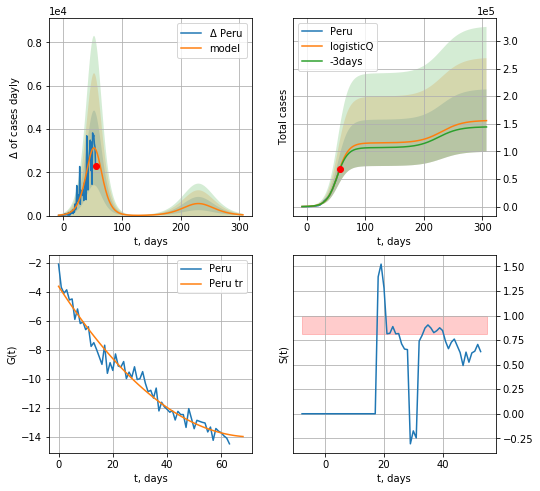

Peru data at: 2020-05-10
+3 day model MAPE: 0.023181
model: logisticQ
coeffs: [ 1.15421143e+05  5.42853234e-06  5.28748883e+01 -1.99193665e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363553
forecast at the end of period: +251 days
	 deltaDaycases: 34
	 total cases: 155676 ± 56596
	 total death: 4369 ± 4765
trend coefficient of determination: 0.969293
 intercept_: -3.6307130184003658
 coeffs_: [ 0.         -0.28975852  0.00202001]


In [336]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,42*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
67 2020-05-06  53025  35909.0  1785.0
68 2020-05-07  56409  37729.0  1890.0
69 2020-05-08  59765  39882.0  1986.0
70 2020-05-09  62939  41472.0  2109.0
71 2020-05-10  67259  44078.0  2212.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


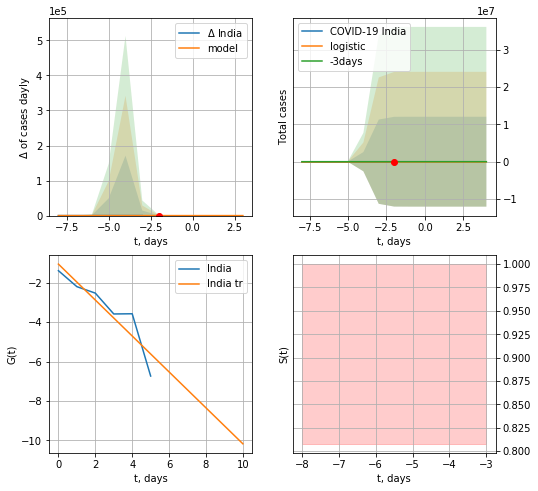

India data at: 2020-05-10
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +6 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


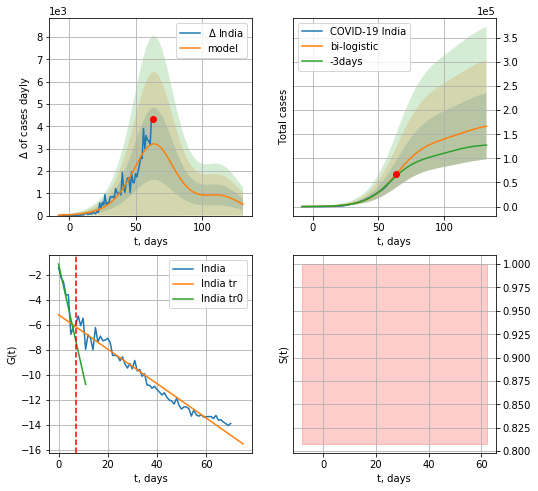

India data at: 2020-05-10
+3 day model MAPE: 0.06840671471639106
model: bi-logistic
coeffs:  [1.38439641e+05 9.21172683e-02 6.41533669e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4117791875095893
forecast at the end of period: +69 days
	 deltaDaycases:  508
	 total cases:  166611 ± 68607
	 total death:  5479 ± 6768
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.958477
 intercept: -5.163869
 slope: -0.137756


In [337]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,7*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


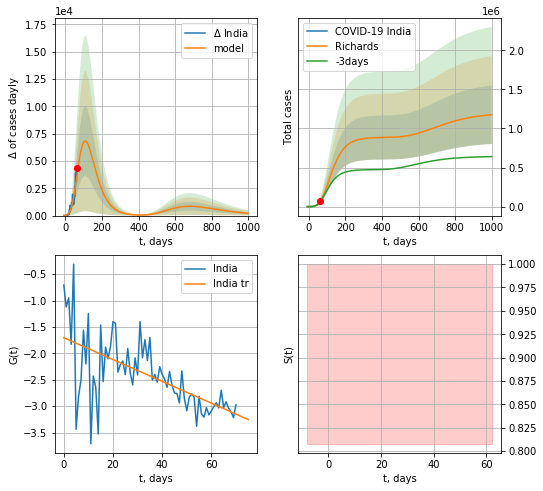

India data at: 2020-05-10
+3 day model MAPE: 0.039863
model: Richards
coeffs: [ 8.86043310e+05  1.01736140e+00 -7.39035266e+01  2.07671541e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.318271
forecast at the end of period: +937 days
	 deltaDaycases: 208
	 total cases: 1176810 ± 374545
	 total death: 38702 ± 36953
trend coefficient of determination: 0.384272
 intercept: -1.704486
 slope: -0.020663


In [338]:
x = forecastRR("India",dfID[:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


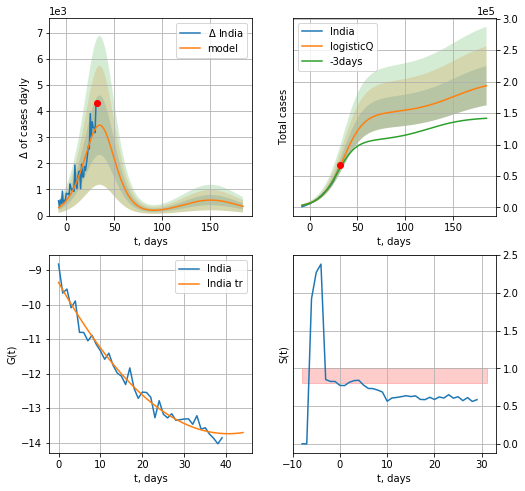

India data at: 2020-05-10
+3 day model MAPE: 0.060134
model: logisticQ
coeffs: [ 1.49835846e+05  1.12412495e-04  3.45899534e+01 -7.83864888e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.160891
forecast at the end of period: +153 days
	 deltaDaycases: 352
	 total cases: 193506 ± 31133
	 total death: 6364 ± 3071
trend coefficient of determination: 0.976113
 intercept_: -9.35701584665997
 coeffs_: [ 0.         -0.21678367  0.00267802]


In [339]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
63 2020-05-06  5208.0  3411.0  273.0
64 2020-05-07  5371.0  3488.0  282.0
65 2020-05-08  5611.0  3659.0  293.0
66 2020-05-09  5776.0  3748.0  300.0
67 2020-05-10  6034.0  3972.0  305.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


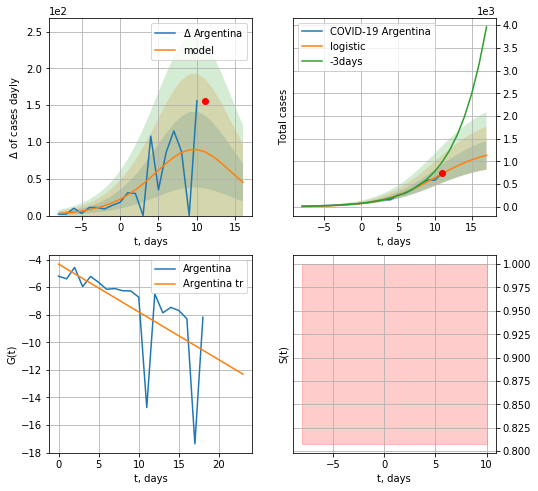

Argentina data at: 2020-05-10
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +6 days
	 deltaDaycases:  45
	 total cases:  1136 ± 315
	 total death:  57 ± 47
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


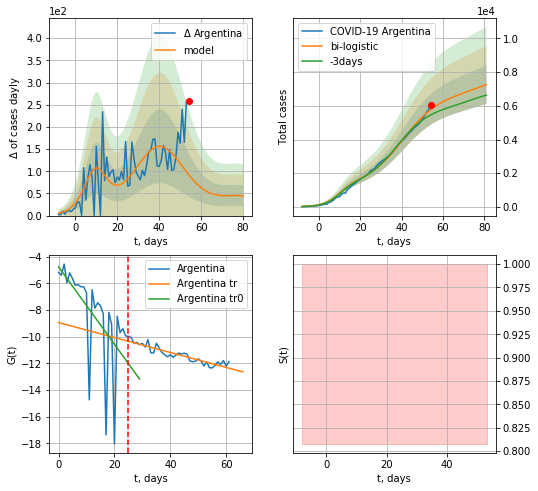

Argentina data at: 2020-05-10
+3 day model MAPE: 0.06182296163973963
model: bi-logistic
coeffs:  [5.34866208e+03 1.15700837e-01 4.06607561e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.15720399093287932
forecast at the end of period: +27 days
	 deltaDaycases:  44
	 total cases:  7261 ± 1141
	 total death:  367 ± 173
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.835956
 intercept: -8.942896
 slope: -0.055996


In [340]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


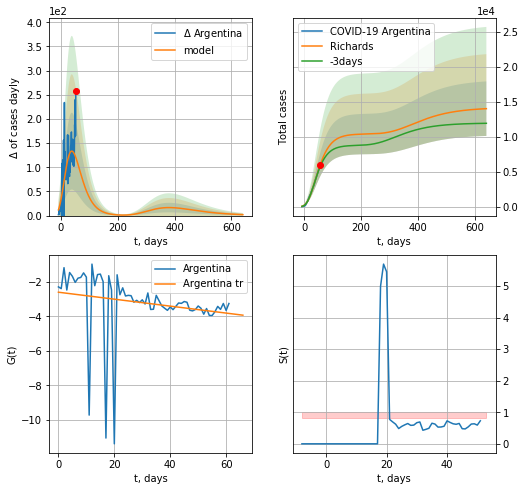

Argentina data at: 2020-05-10
+3 day model MAPE: 0.039631
model: Richards
coeffs: [ 1.04288074e+04  3.16335944e+00 -8.94616472e+01  1.10514098e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.277974
forecast at the end of period: +587 days
	 deltaDaycases: 1
	 total cases: 14042 ± 3903
	 total death: 709 ± 591
trend coefficient of determination: 0.037069
 intercept: -2.593615
 slope: -0.020176


In [341]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,90*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


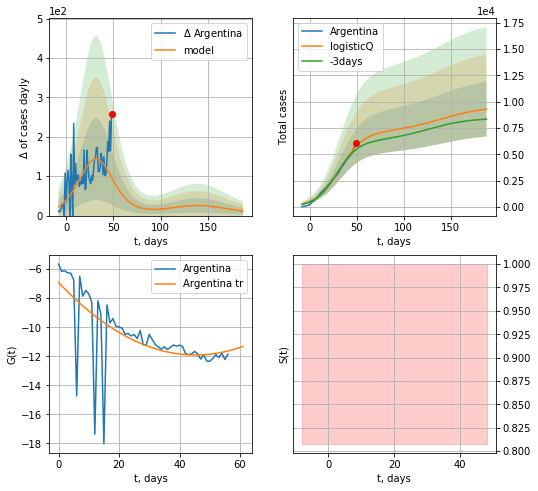

Argentina data at: 2020-05-10
+3 day model MAPE: 0.055946
model: logisticQ
coeffs: [ 7.08703758e+03  1.39732677e-06  3.19981333e+01 -5.76732680e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279805
forecast at the end of period: +139 days
	 deltaDaycases: 11
	 total cases: 9289 ± 2599
	 total death: 469 ± 393
trend coefficient of determination: 0.385772
 intercept_: -6.917598399760885
 coeffs_: [ 0.         -0.22040747  0.00243277]


In [342]:
x = forecastRRR('Argentina',dfAG[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


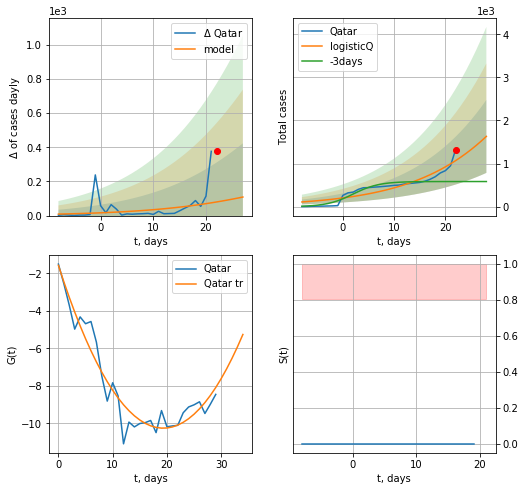

Qatar data at: 2020-05-10
+3 day model MAPE: 0.969413
model: logisticQ
coeffs: [ 1.17152185e+04  1.38701641e-05  5.07935568e+01 -5.73629534e+03]
rational stdev: 0.519403
forecast at the end of period: +6 days
	 deltaDaycases: 108
	 total cases: 1630 ± 846
	 total death: 1 ± 1
trend coefficient of determination: 0.927713
 intercept_: -1.5731660703847918
 coeffs_: [ 0.         -0.89771885  0.02321841]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


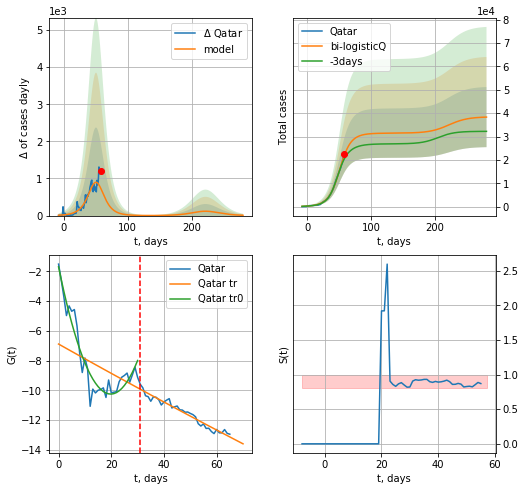

Qatar data at: 2020-05-10
+3 day model MAPE: 0.079151
model: bi-logisticQ
coeffs: [ 1.97381104e+04  4.16806725e-06  5.08980320e+01 -3.21584893e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335842
forecast at the end of period: +223 days
	 deltaDaycases: 8
	 total cases: 38317 ± 12868
	 total death: 23 ± 23
bi-logisticQ approximation splitting point: 31
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]
trend coefficient of determination: 0.953664
 intercept_: -6.888618799940304
 coeffs_: [ 0.00000000e+00 -9.97932285e-02  5.38612133e-05]


In [343]:
vL=31
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


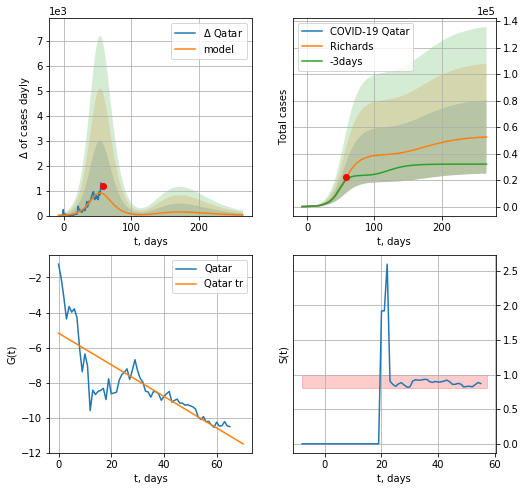

Qatar data at: 2020-05-10
+3 day model MAPE: 0.107486
model: Richards
coeffs: [3.92162732e+04 1.13470283e-01 5.09687557e+01 7.55844475e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.526949
forecast at the end of period: +209 days
	 deltaDaycases: 24
	 total cases: 52563 ± 27698
	 total death: 32 ± 50
trend coefficient of determination: 0.672198
 intercept: -5.178280
 slope: -0.090255


In [344]:
x = forecastRR('Qatar',dfQR[:].fillna(0),d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [345]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
81 2020-05-06  15738.0   12222  157.0
82 2020-05-07  16240.0   12503  165.0
83 2020-05-08  16793.0   12782  174.0
84 2020-05-09  17417.0   12937  185.0
85 2020-05-10  18198.0   13196  198.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


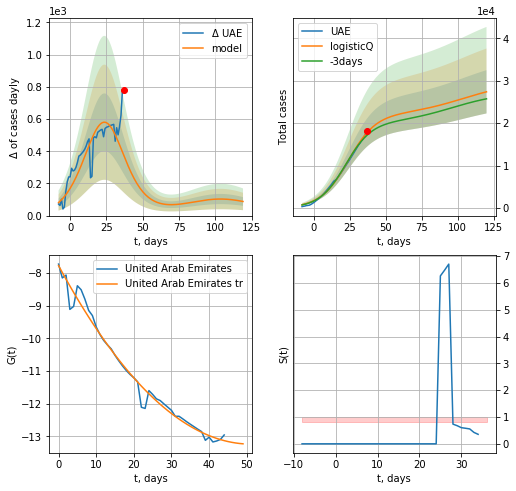

UAE data at: 2020-05-10
+3 day model MAPE: 0.038921
model: logisticQ
coeffs: [ 2.19745769e+04  2.59171634e-06  2.39296477e+01 -4.03503409e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.186143
forecast at the end of period: +83 days
	 deltaDaycases: 87
	 total cases: 27386 ± 5097
	 total death: 297 ± 165
trend coefficient of determination: 0.980804
 intercept_: -7.776123805337868
 coeffs_: [ 0.         -0.21348792  0.002086  ]


In [346]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


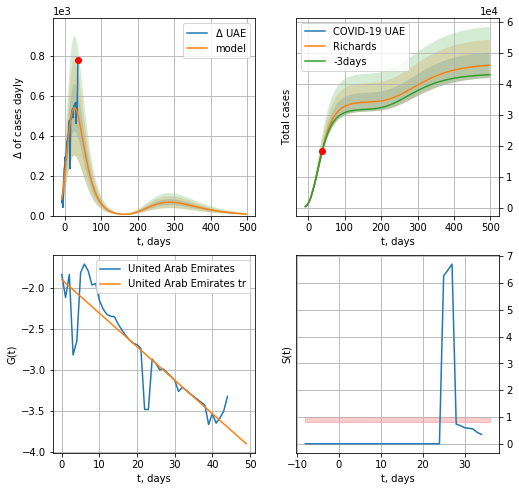

UAE data at: 2020-05-10
+3 day model MAPE: 0.015145
model: Richards
coeffs: [ 3.42262912e+04  2.44411955e+00 -6.58444716e+01  1.77234573e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.089521
forecast at the end of period: +461 days
	 deltaDaycases: 7
	 total cases: 46093 ± 4126
	 total death: 501 ± 134
trend coefficient of determination: 0.819469
 intercept: -1.898251
 slope: -0.040854


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


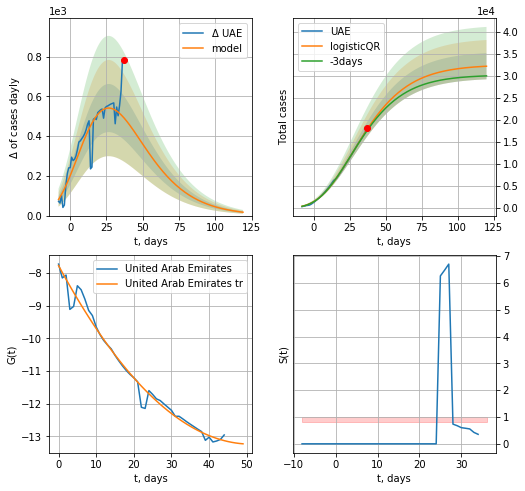

UAE data at: 2020-05-10
+3 day model MAPE: 0.0160319626017386
model: logisticQR
coeffs:  [ 3.25670564e+04  7.45400295e-03 -1.03635833e+02 -8.48275790e+02
  6.04752745e-03]
rational stdev:  0.09236923889835798
forecast at the end of period: +83 days
	 deltaDaycases:  16
	 total cases:  32258 ± 2979
	 total death:  350 ± 96
trend coefficient of determination: 0.980804
 intercept_: -7.776123805337868
 coeffs_: [ 0.         -0.21348792  0.002086  ]


In [347]:
x = forecastRR('UAE',dfUAE[40:],d1,72*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [348]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
64 2020-05-06  31938.0   24946  209.0
65 2020-05-07  33731.0   25714  219.0
66 2020-05-08  35432.0   26083  229.0
67 2020-05-09  37136.0   26753  239.0
68 2020-05-10  39048.0   27345  246.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


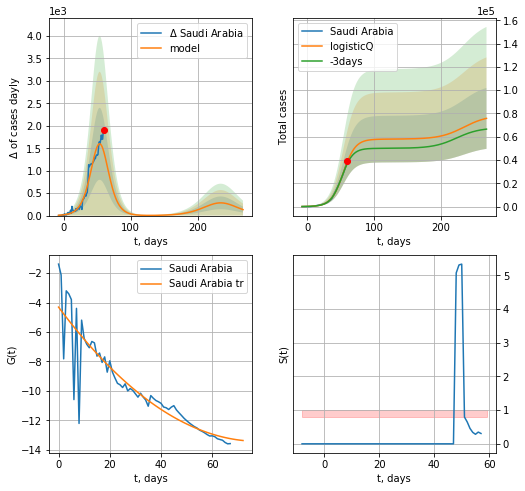

Saudi Arabia data at: 2020-05-10
+3 day model MAPE: 0.042231
model: logisticQ
coeffs: [ 5.79447651e+04  1.16961006e-05  5.39196650e+01 -9.38906799e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345525
forecast at the end of period: +209 days
	 deltaDaycases: 133
	 total cases: 75751 ± 26174
	 total death: 477 ± 494
trend coefficient of determination: 0.821880
 intercept_: -4.309497035059383
 coeffs_: [ 0.         -0.23370599  0.00149636]


In [349]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


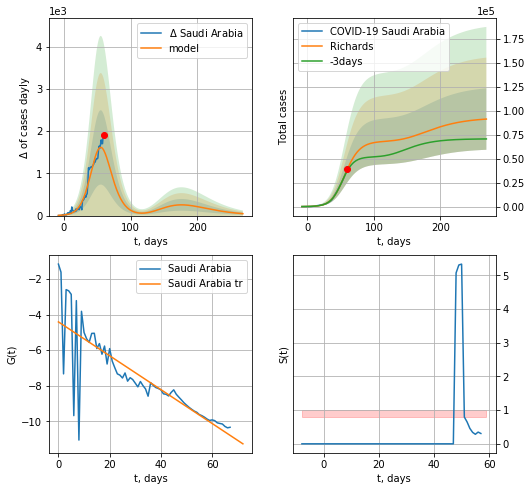

Saudi Arabia data at: 2020-05-10
+3 day model MAPE: 0.045404
model: Richards
coeffs: [6.81520497e+04 1.23962410e-01 5.14876840e+01 6.91408067e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.350882
forecast at the end of period: +209 days
	 deltaDaycases: 45
	 total cases: 91253 ± 32019
	 total death: 574 ± 604
trend coefficient of determination: 0.683549
 intercept: -4.413925
 slope: -0.095007


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


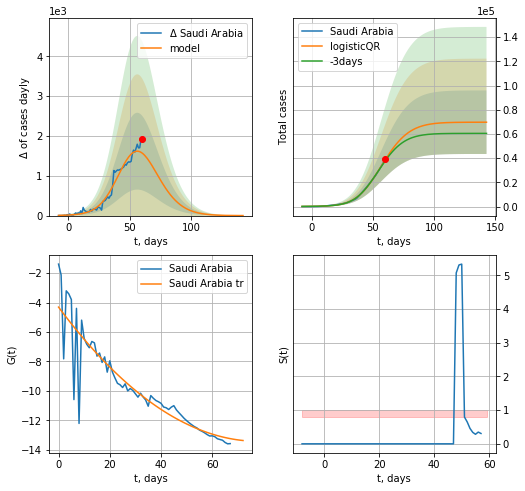

Saudi Arabia data at: 2020-05-10
+3 day model MAPE: 0.026374023778957083
model: logisticQR
coeffs:  [ 6.97621245e+04  4.18195266e-03 -5.35195901e+00 -2.80863172e+01
  1.11540410e-01]
rational stdev:  0.3763509884961958
forecast at the end of period: +83 days
	 deltaDaycases:  0
	 total cases:  69757 ± 26253
	 total death:  439 ± 495
trend coefficient of determination: 0.821880
 intercept_: -4.309497035059383
 coeffs_: [ 0.         -0.23370599  0.00149636]


In [350]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


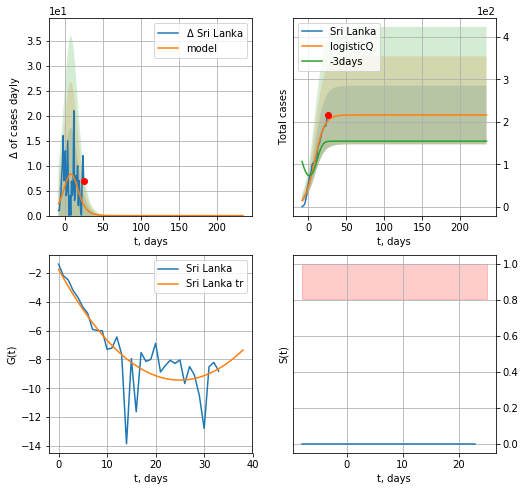

Sri Lanka data at: 2020-05-10
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +209 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


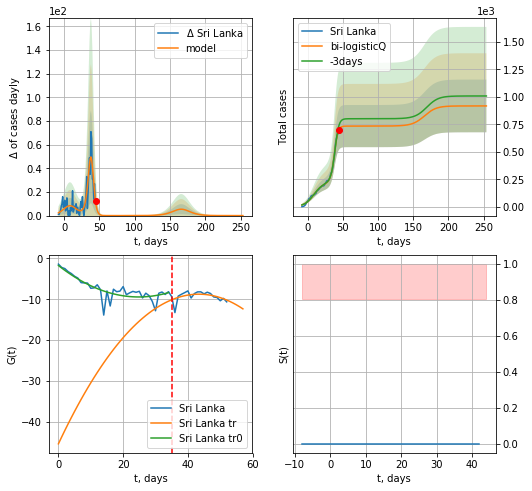

Sri Lanka data at: 2020-05-10
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +209 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 9 ± 7
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [351]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

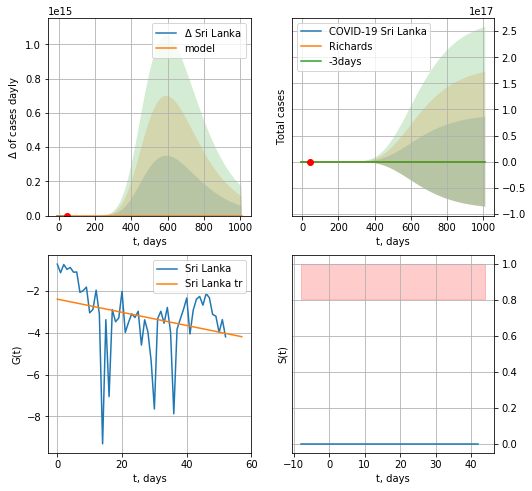

Sri Lanka data at: 2020-05-10
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 205193802976327.718750
forecast at the end of period: +965 days
	 deltaDaycases: 0
	 total cases: 419 ± 86043167279159328
	 total death: 4 ± 2462325635715932
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


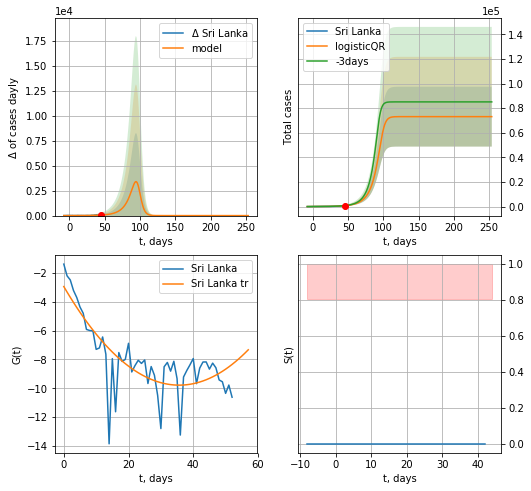

Sri Lanka data at: 2020-05-10
+3 day model MAPE: 0.05518169076740634
model: logisticQR
coeffs:  [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev:  0.33242925378994026
forecast at the end of period: +209 days
	 deltaDaycases:  0
	 total cases:  73133 ± 24311
	 total death:  762 ± 759
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [352]:
x = forecastRR('Sri Lanka',dfSri[:],d1,144*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active  death
64 2020-05-01  18092.0   11207  417.0
65 2020-05-02  19022.0   11813  437.0
66 2020-05-03  20084.0   12443  457.0
67 2020-05-04  20941.0   13047  476.0
68 2020-05-05  22049.0   13714  514.0


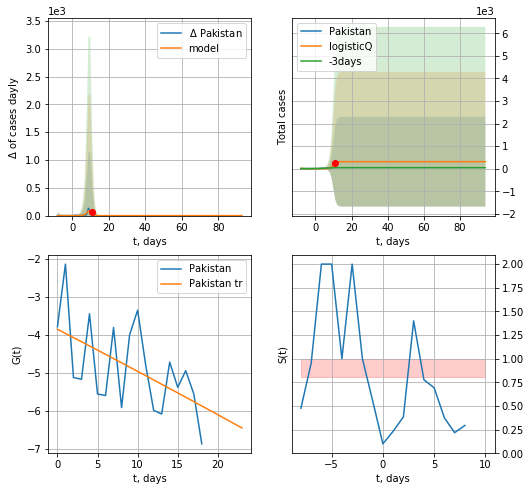

Pakistan data at: 2020-05-10
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


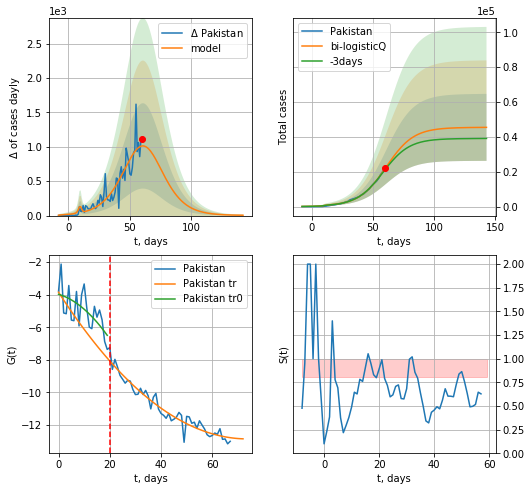

Pakistan data at: 2020-05-10
+3 day model MAPE: 0.033918
model: bi-logisticQ
coeffs: [ 4.51325915e+04  5.22299699e-06  6.10158487e+01 -1.71298715e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422516
forecast at the end of period: +83 days
	 deltaDaycases: 5
	 total cases: 45477 ± 19215
	 total death: 980 ± 1242
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.936260
 intercept_: -3.856647542116999
 coeffs_: [ 0.         -0.24367244  0.00165147]


In [353]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


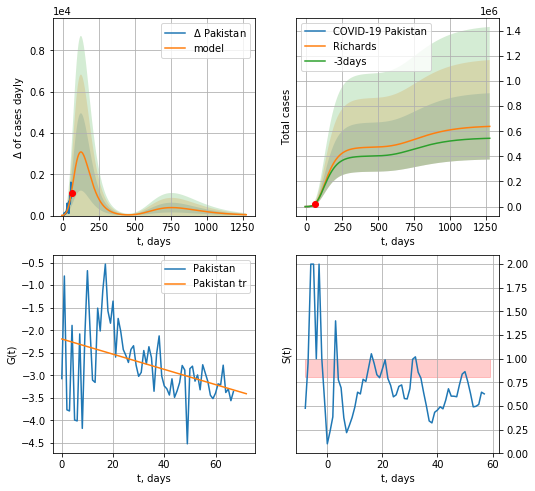

Pakistan data at: 2020-05-10
+3 day model MAPE: 0.010298
model: Richards
coeffs: [ 4.73826893e+05  4.89052373e-01 -5.79454179e+01  3.68149466e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.413337
forecast at the end of period: +1217 days
	 deltaDaycases: 41
	 total cases: 638635 ± 263971
	 total death: 13767 ± 17071
trend coefficient of determination: 0.166507
 intercept: -2.193701
 slope: -0.016865


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


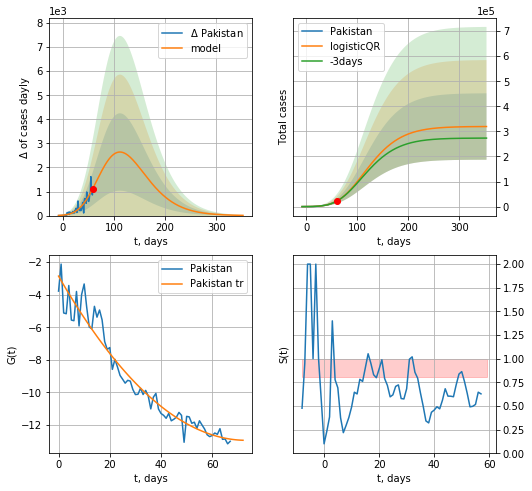

Pakistan data at: 2020-05-10
+3 day model MAPE: 0.009863654797638451
model: logisticQR
coeffs:  [ 3.19689653e+05  2.08656275e-03 -2.01471109e+02 -4.07580892e+02
  1.30756770e-02]
rational stdev:  0.41470182955252466
forecast at the end of period: +293 days
	 deltaDaycases:  8
	 total cases:  319443 ± 132473
	 total death:  6886 ± 8566
trend coefficient of determination: 0.943285
 intercept_: -2.866456132174452
 coeffs_: [ 0.         -0.27440734  0.00187034]


In [354]:
x = forecastRR('Pakistan',dfPS[:],d1,180*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active  death
55 2020-05-02   8790.0    8438    175
56 2020-05-03   9455.0    8215    177
57 2020-05-04  10143.0    8752    182
58 2020-05-05  10929.0    9343    183
59 2020-05-06  11719.0   10130    186


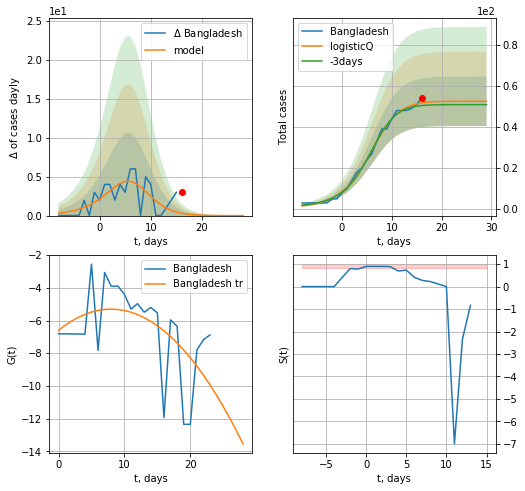

Bangladesh data at: 2020-05-10
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:288: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


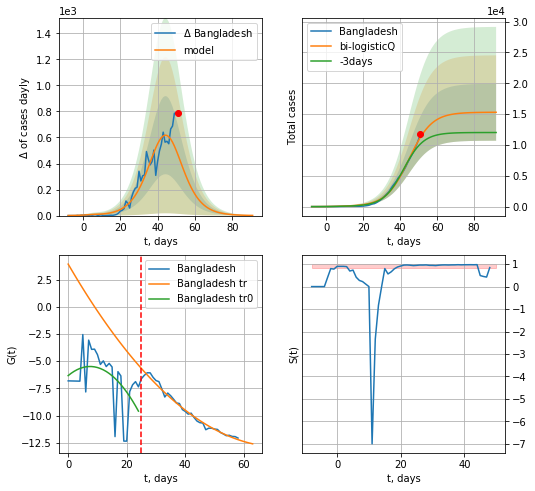

Bangladesh data at: 2020-05-10
+3 day model MAPE: 0.121997
model: bi-logisticQ
coeffs: [ 1.52576917e+04  4.82282721e-06  4.47207282e+01 -3.35831063e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301595
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 15304 ± 4615
	 total death: 238 ± 215
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.980575
 intercept_: 3.92534182185733
 coeffs_: [ 0.         -0.4635868   0.00319602]


In [355]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


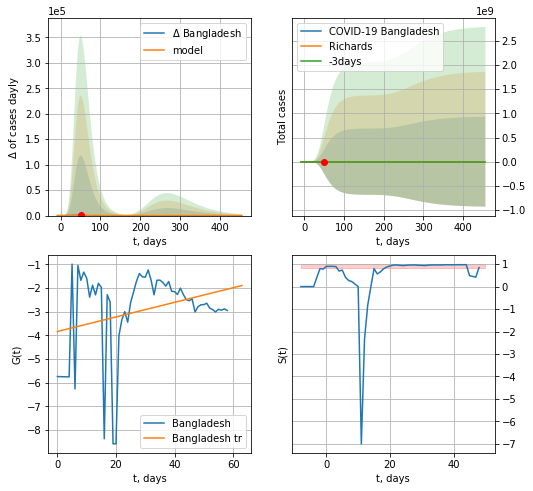

Bangladesh data at: 2020-05-10
+3 day model MAPE: 0.055506
model: Richards
coeffs: [ 3.07100009e+04  2.17207180e+00 -1.32880171e+01  2.61159639e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 22375.959220
forecast at the end of period: +405 days
	 deltaDaycases: 5
	 total cases: 41553 ± 929801614
	 total death: 646 ± 43364608
trend coefficient of determination: 0.086669
 intercept: -3.832533
 slope: 0.030849


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


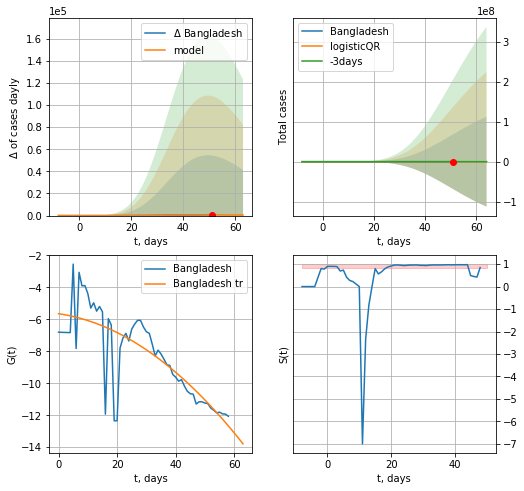

Bangladesh data at: 2020-05-10
+3 day model MAPE: 0.059514524812985733
model: logisticQR
coeffs:  [ 2.70091422e+04  3.12884912e-02 -7.41561616e+01 -2.11791577e+02
  5.24797657e-03]
rational stdev:  5991.5632608904825
forecast at the end of period: +13 days
	 deltaDaycases:  473
	 total cases:  18747 ± 112324765
	 total death:  291 ± 5230634
trend coefficient of determination: 0.630447
 intercept_: -5.653904656846626
 coeffs_: [ 0.         -0.02628648 -0.00163203]


In [356]:
x = forecastRR('Bangladesh',dfBN[:],d1,64*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Bangladesh',dfBN[:],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [12]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=13:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13]
1:"Country,Other"
2:"TotalCases"
3:"NewCases"
4:"TotalDeaths"
5:"NewDeaths"
6:"TotalRecovered"
7:"ActiveCases"
8:"Serious,Critical"
9:"Tot Cases/1M pop"
10:"Deaths/1M pop"
11:"TotalTests"
12:"Tests/
1M pop
"
13:"Continent"
[461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461, 461]


In [13]:
df.head(10)

,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,"1,086,442",North America,\nNorth America\n,,"+2,029",122,"17,683",,"1,498,794","90,109","322,243",,
1,"816,138",Europe,\nEurope\n,,,,"13,992",,"1,628,576","152,740","659,698",,
2,"185,161",South America,\nSouth America\n,,119,4,"10,114",,"310,189","16,388","108,640",,
3,"275,484",Asia,\nAsia\n,,832,8,"4,987",,"669,565","22,197","371,884",,
4,"39,768",Africa,\nAfrica\n,,2,,235,,"64,752","2,301","22,683",,
5,782,Australia/Oceania,\nOceania\n,,10,,20,,"8,549",118,"7,649",,
6,55,,\n\n,,,,4,,721,15,651,,
7,"2,403,830",All,World,36.4,"+2,992",134,"47,035",,"4,181,146","283,868","1,493,448",,536
8,"1,030,515",North America,USA,244,,,"16,514","28,533","1,367,638","80,787","256,336","9,444,525","4,132"
9,"61,603",Europe,Spain,569,,,"1,650","52,781","264,663","26,621","176,439","2,467,761","5,661"


In [14]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[3]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[7]:"Testsper1Mpop",df.columns[12]:"TotCasesper1Mpop"})
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,086,442",North America,\nNorth America\n,,"+2,029",122,"17,683",,"1,498,794","90,109","322,243",,
1,"816,138",Europe,\nEurope\n,,,,"13,992",,"1,628,576","152,740","659,698",,
2,"185,161",South America,\nSouth America\n,,119,4,"10,114",,"310,189","16,388","108,640",,
3,"275,484",Asia,\nAsia\n,,832,8,"4,987",,"669,565","22,197","371,884",,
4,"39,768",Africa,\nAfrica\n,,2,,235,,"64,752","2,301","22,683",,


In [15]:
df[df["Country"]=="Lithuania"]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
91,601,Europe,Lithuania,18,,,17,"67,558","1,479",50,828,"183,913",543
323,601,Europe,Lithuania,18,35,1,17,"67,558","1,479",50,828,"183,913",543


In [16]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

230


In [17]:
df.head(24)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,"1,086,442",North America,\nNorth America\n,,"+2,029",122,"17,683",,"1,498,794","90,109","322,243",,
1,"816,138",Europe,\nEurope\n,,,,"13,992",,"1,628,576","152,740","659,698",,
2,"185,161",South America,\nSouth America\n,,119,4,"10,114",,"310,189","16,388","108,640",,
3,"275,484",Asia,\nAsia\n,,832,8,"4,987",,"669,565","22,197","371,884",,
4,"39,768",Africa,\nAfrica\n,,2,,235,,"64,752","2,301","22,683",,
5,782,Australia/Oceania,\nOceania\n,,10,,20,,"8,549",118,"7,649",,
6,55,,\n\n,,,,4,,721,15,651,,
7,"2,403,830",All,World,36.4,"+2,992",134,"47,035",,"4,181,146","283,868","1,493,448",,536
8,"1,030,515",North America,USA,244,,,"16,514","28,533","1,367,638","80,787","256,336","9,444,525","4,132"
9,"61,603",Europe,Spain,569,,,"1,650","52,781","264,663","26,621","176,439","2,467,761","5,661"


In [18]:
df.at[10, 'TotalRecovered'] = 0
df.at[22, 'TotalRecovered'] = 0
#df.at[12, 'TotalRecovered'] = 0


In [19]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,\nNorth America\n,NaN,2029.0,122.0,17683.0,NaN,1498794,90109.0,322243.0,NaN,NaN
1,816138,Europe,\nEurope\n,NaN,NaN,NaN,13992.0,NaN,1628576,152740.0,659698.0,NaN,NaN
2,185161,South America,\nSouth America\n,NaN,119.0,4.0,10114.0,NaN,310189,16388.0,108640.0,NaN,NaN
3,275484,Asia,\nAsia\n,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
4,39768,Africa,\nAfrica\n,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN
5,782,Australia/Oceania,\nOceania\n,NaN,10.0,NaN,20.0,NaN,8549,118.0,7649.0,NaN,NaN
6,55,,\n\n,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
7,2403830,All,World,36.4,2992.0,134.0,47035.0,NaN,4181146,283868.0,1493448.0,NaN,536.0
8,1030515,North America,USA,244.0,NaN,NaN,16514.0,28533.0,1367638,80787.0,256336.0,9444525.0,4132.0
9,61603,Europe,Spain,569.0,NaN,NaN,1650.0,52781.0,264663,26621.0,176439.0,2467761.0,5661.0


In [20]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,275484,Asia,Total:,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
226,39768,Africa,Total:,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN
227,782,Australia/Oceania,Total:,NaN,10.0,NaN,20.0,NaN,8549,118.0,7649.0,NaN,NaN
228,55,,Total:,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,406223,Europe,European Union,259.678532,0.0,0.0,9374.0,30668.973018,1099414,115622.0,577319.0,13655376.0,2469.203214


In [21]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,North America,NaN,2029.0,122.0,17683.0,NaN,1498794,90109.0,322243.0,NaN,NaN
1,816138,Europe,Europe,NaN,NaN,NaN,13992.0,NaN,1628576,152740.0,659698.0,NaN,NaN
2,185161,South America,South America,NaN,119.0,4.0,10114.0,NaN,310189,16388.0,108640.0,NaN,NaN
3,275484,Asia,Asia,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
4,39768,Africa,Africa,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN


In [22]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [23]:
#df

In [24]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,1086442,North America,North America,NaN,2029.0,122.0,17683.0,NaN,1498794,90109.0,322243.0,NaN,NaN
1,816138,Europe,Europe,NaN,NaN,NaN,13992.0,NaN,1628576,152740.0,659698.0,NaN,NaN
2,185161,South America,South America,NaN,119.0,4.0,10114.0,NaN,310189,16388.0,108640.0,NaN,NaN
3,275484,Asia,Asia,NaN,832.0,8.0,4987.0,NaN,669565,22197.0,371884.0,NaN,NaN
4,39768,Africa,Africa,NaN,2.0,NaN,235.0,NaN,64752,2301.0,22683.0,NaN,NaN
5,782,Australia/Oceania,Oceania,NaN,10.0,NaN,20.0,NaN,8549,118.0,7649.0,NaN,NaN
7,2403830,All,World,36.4,2992.0,134.0,47035.0,NaN,4181146,283868.0,1493448.0,NaN,536.0
8,1030515,North America,USA,244.0,NaN,NaN,16514.0,28533.0,1367638,80787.0,256336.0,9444525.0,4132.0
9,61603,Europe,Spain,569.0,NaN,NaN,1650.0,52781.0,264663,26621.0,176439.0,2467761.0,5661.0
10,186984,Europe,UK,469.0,NaN,NaN,1559.0,26829.0,219183,31855.0,0.0,1821280.0,3229.0


In [25]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [26]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Latvia LV
Belarus BR
Slovenia SV
Luxembourg LX
USA US
Netherlands NL
Argentina AG
Bulgaria BL
Panama PM
World World
UK GB
UAE UAE
Ukraine Ukr
Iceland IC
New Zealand ZL
Egypt EG
Czechia CH
Portugal PT
Colombia CB
Ireland IR
Malta MT
Algeria AR
Slovakia SL
Qatar QR
Austria AT
Belgium BG
India ID
Cyprus CP
Thailand TH
Norway NG
France FR
Saudi Arabia SA
Germany GR
Denmark DK
Canada CA
Croatia CT
Australia AS
Malaysia ML
Philippines PH
Japan JP
Morocco MR
Switzerland SZ
Mexico MX
Greece GC
China CN
Iran IN
Indonesia IE
Peru PU
Lithuania LT
Ecuador ED
Israel IS
Russia RS
Turkey TR
Poland PL
Spain SP
Iraq IQ
Serbia SB
European Union EU
Italy IT
Sweden SW
Singapore SG
Chile CL
Pakistan PK
Brazil BZ
Finland FI
Hungary HG
S. Korea KR
Romania RM
Estonia ES


In [27]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-10,1498794,1086442,90109.0
Europe
Europe 2020-05-10,1628576,816138,152740.0
South America
South America 2020-05-10,310189,185161,16388.0
Asia
Asia 2020-05-10,669565,275484,22197.0
Africa
Africa 2020-05-10,64752,39768,2301.0
Oceania
Oceania 2020-05-10,8549,782,118.0
World
World 2020-05-10,4181146,2403830,283868.0
USA
USA 2020-05-10,1367638,1030515,80787.0
Spain
Spain 2020-05-10,264663,61603,26621.0
UK
UK 2020-05-10,219183,186984,31855.0
Italy
Italy 2020-05-10,219070,83324,30560.0
Russia
Russia 2020-05-10,209688,173467,1915.0
France
France 2020-05-10,176970,94373,26380.0
Germany
Germany 2020-05-10,171879,18710,7569.0
Brazil
Brazil 2020-05-10,162699,86619,11123.0
Turkey
Turkey 2020-05-10,138657,42180,3786.0
Iran
Iran 2020-05-10,107603,14820,6640.0
Canada
Canada 2020-05-10,68848,31882,4870.0
Peru
Peru 2020-05-10,67307,44069,1889.0
India
India 2020-05-10,67259,44078,2212.0
Belgium
Belgium 2020-05-10,53081,30783,8656.0
Netherlands
Netherlands 2020-05-10,42

Papua New Guinea
Papua New Guinea 2020-05-10,8,0,nan
British Virgin Islands
British Virgin Islands 2020-05-10,7,2,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-05-10,6,6,nan
St. Barth
St. Barth 2020-05-10,6,0,nan
Western Sahara
Western Sahara 2020-05-10,6,1,nan
Anguilla
Anguilla 2020-05-10,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-10,1,1,nan
China
China 2020-05-10,82918,141,4633.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
Total:
Total: 2020-05-10,1498794,1086442,90109.0
European Union
European Union 2020-05-10,1099414,406223,115622.0


In [28]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [29]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaLV.csv 2020-05-10,939,457,18.0

append data/coronaBR.csv 2020-05-10,22973,16436,131.0

append data/coronaSV.csv 2020-05-10,1457,1099,102.0

append data/coronaLX.csv 2020-05-10,3886,199,101.0

append data/coronaUS.csv 2020-05-10,1367638,1030515,80787.0

append data/coronaNL.csv 2020-05-10,42627,36937,5440.0

append data/coronaAG.csv 2020-05-10,6034,3972,305.0

append data/coronaBL.csv 2020-05-10,1965,1430,91.0

append data/coronaPM.csv 2020-05-10,8448,3517,244.0

append data/coronaWorld.csv 2020-05-10,4181146,2403830,283868.0

append data/coronaGB.csv 2020-05-10,219183,186984,31855.0

append data/coronaUAE.csv 2020-05-10,18198,13196,198.0

append data/coronaUkr.csv 2020-05-10,15232,11781,391.0

append data/coronaIC.csv 2020-05-10,1801,18,10.0

append data/coronaZL.csv 2020-05-10,1497,90,21.0

append data/coronaEG.csv 2020-05-10,9400,6800,525.0

append data/coronaCH.csv 2020-05-10,8123,3369,280.0

append data/coronaPT.csv 2020-05-10,27581,23897,1135.0

append data/coron

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [388]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

46574143.0 5988.240974079407


In [389]:
TT/7.7776e3

5988.240974079407

In [390]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

30357.676352957562

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [364]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

28256.034758895305

In [468]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [381]:
#dfAll

In [365]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

5918.354150378018

In [393]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh"
]

In [394]:
len(CList)

67

In [398]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4063285040

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

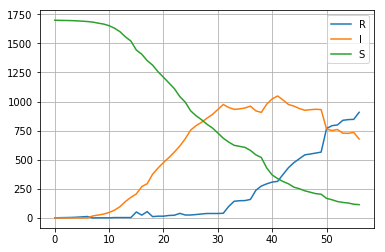

In [798]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

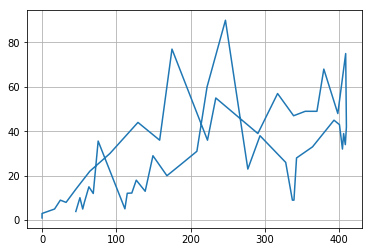

In [799]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

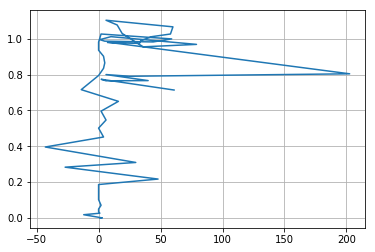

In [800]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

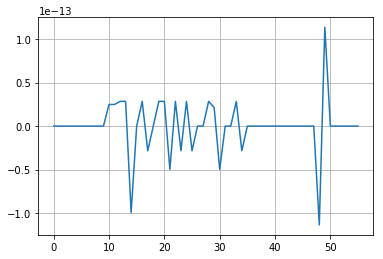

In [801]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [978]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [1044]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[ 42.58270028 912.65637216]


In [1045]:
55*19

1045

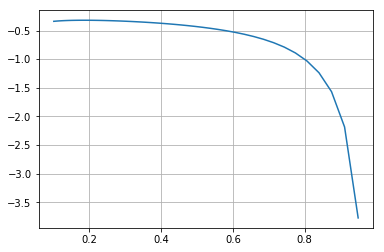

In [1046]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

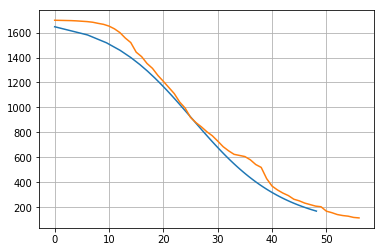

In [1059]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

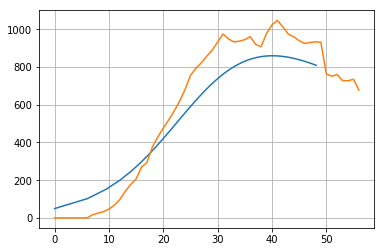

In [1058]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

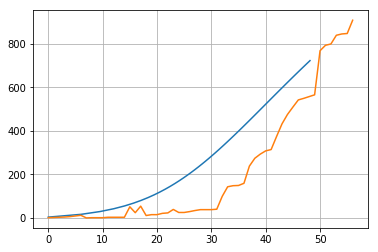

In [1060]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [992]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1006]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

array([0.12589254, 0.16378937, 0.2130941 , 0.2772408 , 0.36069727,
       0.46927625, 0.61054023, 0.79432823])

In [1005]:
10**0.1

1.2589254117941673

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125